# <span style='color: gold'>P6 - Classifiez automatiquement des biens de consommation</span>

![logo_projet.png](logo_projet.png)

Le but de ce projet est de réaliser une première étude de faisabilité d'un moteur de classification d'articles pour une marketplace e-commerce. L'étude sera basée sur l'image et la description d'article pour l'automatisation de l'attribution de la catégorie de l'article.

Voici les contraintes : 

Afin d’extraire les features **texte**, il sera nécessaire de mettre en œuvre :
- Deux approches de type “bag-of-words”, comptage simple de mots et Tf-idf 
- Une approche de type word/sentence embedding classique avec Word2Vec (ou Glove ou FastText) 
- Une approche de type word/sentence embedding avec BERT 
- Une approche de type word/sentence embedding avec USE (Universal Sentence Encoder)
  
Afin d’extraire les features **image**, il sera nécessaire de mettre en œuvre :
- Un algorithme de type SIFT / ORB / SURF ;
- Un algorithme de type CNN Transfer Learning.

# <font color="gold">Sommaire</font> 

1. [Import Librairies](#section_1) .
2. [Dataset](#section_2) 
   - 2.1 [Categories](#section_2_1)
   - 2.2 [Pre-processing](#section_2_2).    
3. [Analyse Exploratoire](#section_3)     
   - 3.1 [Pré-traitement](#section_3_1)    
   - 3.2 [Bag Of Word](#section_3_2)      
       - 3.2.1 [Countvectorizer](#section_3_2_1)      
       - 3.2.2 [Tf-idf](#section_3_2_2)    
   - 3.3 [Word Embedding](#section_3_3)         
      - 3.3.1 [Word2Vec](#section_3_3_1)  
      - 3.3.2 [Bidirectional Encoder Representations from Transformers BERT](#section_3_3_2)    
      - 3.3.3 [Universal Sentence Encoder USE](#section_3_3_3) 
       
4. [Feature Extraction - Word & Text Embeddings](#section_4)           
   - 4.1 [BOW - Bags of words - CountVectorizer](#section_4_1)    
   - 4.2 [BOW - TfidfVectorizer](#section_4_2)   
   - 4.3 [Word2vec](#section_4_3) 
   - 4.4 [BERT](#section_4_4)
   - 4.5 [USE](#section_4_5) 
    
5. [IMAGES - Données Images](#section_5) 
    - 5.1 [Analyse des données images](#section_5_1)
    - 5.2 [Pré-traitement images](#section_5_2)
    - 5.3 [Features Extraction](#section_5_3)
        - 5.3.1 [Algorithme SIFT](#section_5_3_1)
        - 5.3.2 [Algorithme ORB](#section_5_3_2)
    - 5.4 [Convolutional Neural Networks (CNN) transfer learning](#section_5_4)
        - 5.4.1 [VGG16](#section_5_4_1)
        - 5.4.2 [VGG19](#section_5_4_2)
        - 5.4.3 [InceptionV3](#section_5_4_3)
        - 5.4.4 [Combinaison des meilleurs résultats des approches texte et image](#section_5_4_4)
        
6. [Classification Supervisée](#section_6)   
    - 6.1 [NLP : Word & Text Embeddings](#section_6_1)
        - 6.1.1 [BERT](#section_6_1_1)
           - 6.1.1.1 [RoBERTa large model(nli-mean-tokens)](#section_6_1_1_1)
        - 6.1.2 [CountVectorizer](#section_6_1_2)
        - 6.1.3 [TfIdfVectorizer](#section_6_1_3)
        - 6.1.4 [USE](#section_6_1_4)  
           - 6.1.4.1 [universal-sentence-encoder/3](#section_6_1_4_1)
    - 6.2 [Convolutional Neural Networks (CNN) transfer learning](#section_6_2)
        - 6.2.1 [VGG19](#section_6_2_1)
        - 6.2.2 [InceptionV3](#section_6_2_2)


In [1]:
# Chargement des librairies
import datetime
import time
import sys
import os
import string
import json
from datetime import datetime
from IPython.display import display, HTML
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

# Réduction dimension
from sklearn.manifold import TSNE
# Traitement images
from PIL import Image as Image_PIL, ImageOps, ImageFilter
import cv2
from scipy.ndimage import gaussian_filter

import numpy as np
import pandas as pd
import fonctions_data
import texthero as hero
import cprint
import matplotlib as mpl
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import module_name
from module_name import *


# Algorithmes de classification supervisée
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import LinearSVC
from sklearn.multiclass import OneVsRestClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB 
from sklearn.svm import SVC
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.cluster import MiniBatchKMeans

# Feature extraction
import seaborn as sns
import sklearn
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, \
    HashingVectorizer

# Traitement de text
import texthero as hero
from texthero import preprocessing
import nltk
import gensim
from nltk.corpus import stopwords
from nltk import word_tokenize, FreqDist
from stop_words import get_stop_words
from gensim.models import Word2Vec
import multiprocessing

# Réduction dimension
from sklearn.decomposition import PCA, TruncatedSVD
from sklearn import decomposition
from sklearn.manifold import TSNE
from sklearn.model_selection import train_test_split

# BERT
import transformers
from sentence_transformers import SentenceTransformer

# USE
import tensorflow as tf
from tensorflow.keras.preprocessing import image
import tensorflow_hub as hub
from sklearn.manifold import TSNE

# Clustering
from sklearn.cluster import KMeans
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, precision_score
from sklearn.metrics import adjusted_rand_score, silhouette_score, homogeneity_score, recall_score, f1_score

# normalisation, encoding
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder

# Warnings
import warnings
warnings.filterwarnings('ignore')

# Versions
print('Version des librairies utilisées :')
#print('jyquickhelper         : ' + jyquickhelper.__version__)
print('Python                : ' + sys.version)
print('NumPy                 : ' + np.version.full_version)
print('Pandas                : ' + pd.__version__)
print('Matplotlib            : ' + mpl.__version__)
print('Seaborn               : ' + sns.__version__)
print('Sklearn               : ' + sklearn.__version__)
print('Outils dataframe      : ' + fonctions_data.__version__)
now = datetime.now().isoformat()
print('Lancé le           : ' + now)

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\yanni\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


Version des librairies utilisées :
Python                : 3.8.8 (default, Apr 13 2021, 15:08:03) [MSC v.1916 64 bit (AMD64)]
NumPy                 : 1.24.4
Pandas                : 1.5.3
Matplotlib            : 3.7.5
Seaborn               : 0.13.2
Sklearn               : 1.3.0
Outils dataframe      : 0.0.0
Lancé le           : 2024-03-29T12:34:43.175469


## <span style='background:PowderBlue' id="#section_2">2. Dataset</span>

In [2]:
# Nombre aléatoire pour la reproductibilité des résultats
seed = 21

In [243]:
# Chargement du jeu de données
#P6_Classification_auto_biens_consommation\
data = pd.read_csv('Data/Flipkart/flipkart_com-ecommerce_sample_1050.csv')

In [244]:
# Taille : nombre de lignes/colonnes
nRow, nVar = data.shape
print(f'Le jeu de données contient {nRow} lignes et {nVar} variables.')

Le jeu de données contient 1050 lignes et 15 variables.


In [80]:
data.head(2)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."


-------------------------------------------------------------
Type de variable pour chacune des variables



uniq_id                     object
crawl_timestamp             object
product_url                 object
product_name                object
product_category_tree       object
pid                         object
retail_price               float64
discounted_price           float64
image                       object
is_FK_Advantage_product       bool
description                 object
product_rating              object
overall_rating              object
brand                       object
product_specifications      object
dtype: object

,Nombre par type de variable,% des types de variable
object,12,80.000000
float64,2,13.330000
bool,1,6.670000


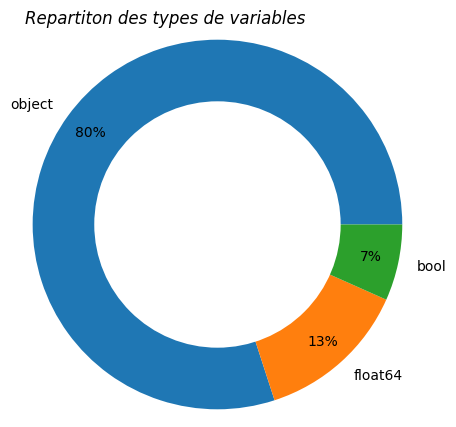

In [10]:
# Types des variables
fonctions_data.affichage_types_var(data, True, True, True)

In [11]:
# Résumé des variables qualitatives
fonctions_data.detail_type_var(data, type_var='cat')

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
type,object,object,object,object,object,object,object,bool,object,object,object,object,object
nb_nan,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,338.0,1.0
%_nan,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,32.190476,0.095238
count,1050,1050,1050,1050,1050,1050,1050,1050,1050,1050,1050,712,1049
unique,1050,149,1050,1050,642,1050,1050,2,1050,27,27,490,984
top,55b85ea15a1536d46b7190ad6fff8ce7,2015-12-01 12:40:44 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Bed Linen >> Blankets, Qu...",CRNEG7BKMFFYHQ8Z,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,PRINT SHAPES,"{""product_specification""=>[{""key""=>""Type"", ""va..."
freq,1,150,1,1,56,1,1,993,1,889,889,11,22


In [13]:
# Résumé des variables qualitatives
fonctions_data.detail_type_var(data, type_var='num')

,retail_price,discounted_price
type,float64,float64
nb_nan,1.0,1.0
%_nan,0.095238,0.095238
count,1049.0,1049.0
mean,2186.197331,1584.527169
std,7639.229411,7475.09968
min,35.0,35.0
25%,555.0,340.0
50%,999.0,600.0
75%,1999.0,1199.0


Valeurs manquantes :341 NaN pour 15750 données (2.17 %)
-------------------------------------------------------------
Nombre et pourcentage de valeurs manquantes par variable



,Nombres de valeurs manquantes,% de valeurs manquantes
brand,338,32.19
retail_price,1,0.10
discounted_price,1,0.10
product_specifications,1,0.10


-------------------------------------------------------------
Heatmap de visualisation des valeurs manquantes


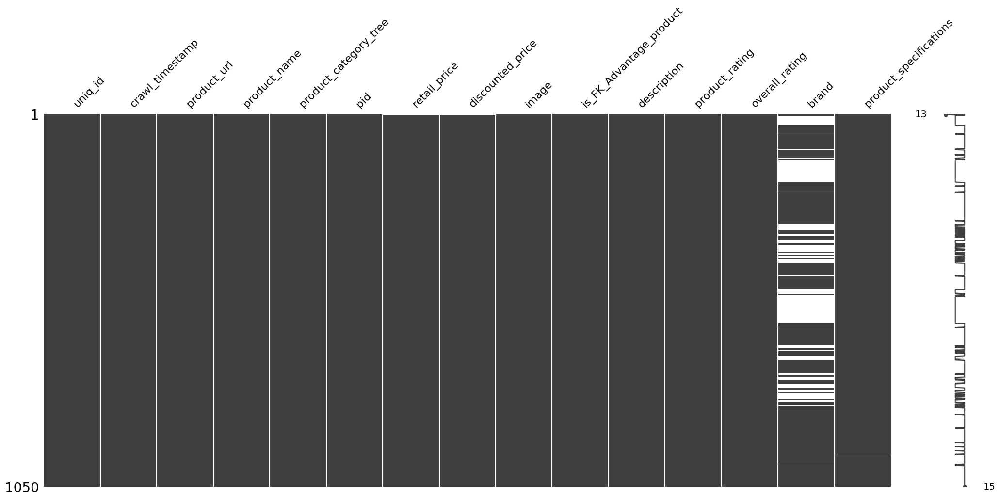

In [16]:
# Visualisation des données manquantes dans le dataset
fonctions_data.get_val_manq(data, True, True)

### <span style='background:orange'>2.1 Catégories</span>

In [245]:
# Sample checking

data['product_category_tree'][843]

'["Computers >> Laptop Accessories >> USB Gadgets >> Epresent USB Gadgets"]'

In [246]:
# Nombre de catégories en profondeur

ser_depth = data['product_category_tree'].apply(lambda x: x.count('>>'))
max_depth = ser_depth.max()
max_depth

6

In [8]:
# printing number of categories in each level and a sample
display(df_cat_level.nunique(), df_cat_level.sample(3))

cat_level_0      7
cat_level_1     62
cat_level_2    243
cat_level_3    460
cat_level_4    596
cat_level_5    633
dtype: int64

,cat_level_0,cat_level_1,cat_level_2,cat_level_3,cat_level_4,cat_level_5
760,Watches,Watches/Wrist Watches,Watches/Wrist Watches/Luba Wrist Watches,Watches/Wrist Watches/Luba Wrist Watches/,Watches/Wrist Watches/Luba Wrist Watches//,Watches/Wrist Watches/Luba Wrist Watches///
932,Home Furnishing,Home Furnishing/Bed Linen,"Home Furnishing/Bed Linen/Blankets, Quilts & D...","Home Furnishing/Bed Linen/Blankets, Quilts & D...","Home Furnishing/Bed Linen/Blankets, Quilts & D...","Home Furnishing/Bed Linen/Blankets, Quilts & D..."
420,Computers,Computers/Network Components,Computers/Network Components/Routers,Computers/Network Components/Routers/D-Link Ro...,Computers/Network Components/Routers/D-Link Ro...,Computers/Network Components/Routers/D-Link Ro...


**Visualisation des des produits par catégorie**

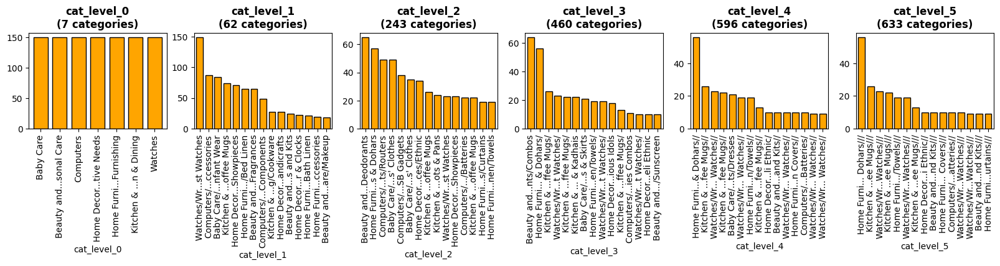

In [26]:
shorten_label = 10
n_first = 15
fig = plt.figure(figsize=(20,2))
for i, col in enumerate(df_cat_level.columns,1):
    # plot the graphs
    ax = fig.add_subplot(1,len(df_cat_level.columns), i)
    ser = df_cat_level.groupby(col).size().sort_values(ascending=False)
    ser[0:n_first].plot.bar(width=0.75, color='orange', ec='k', ax=ax)
    # shorten the labels
    thr = int(shorten_label)
    lab_x = [item.get_text() for item in ax.get_xticklabels()]
    short_lab_x = [s[:thr]+'...'+s[-thr:] if len(s)>thr else s for s in lab_x]
    ax.axes.set_xticklabels(short_lab_x)
    # set title
    ax.set_title(col+f'\n({ser.shape[0]} categories)', fontweight='bold')

Le seul niveau qui présente un ensemble équilibré d'objets est le niveau 0, avec 7 catégories. Renommons ces 7 catégories

In [248]:
df_cat_level['category'] = \
    df_cat_level['cat_level_0'].replace({'Home Furnishing': 'Furnishing',
                                         'Baby Care': 'Baby', 
                                         'Watches': 'Watches',
                                         'Home Decor & Festive Needs': 'Decor',
                                         'Kitchen & Dining': 'Kitchen',
                                         'Beauty and Personal Care': 'Beauty',
                                         'Computers': 'Computers'})

**Descriptions des catégories utiles avec le champ 'category'**

In [249]:
# Extract only useful data

data_work = pd.concat([df_cat_level['category'],
                         data[['product_name', 'brand', 'image', 'product_category_tree',
                  'description', 'product_specifications']]], axis=1)

In [11]:
data_work.head(2)

,category,product_name,brand,image,product_category_tree,description,product_specifications
0,Furnishing,Elegance Polyester Multicolor Abstract Eyelet ...,Elegance,55b85ea15a1536d46b7190ad6fff8ce7.jpg,"[""Home Furnishing >> Curtains & Accessories >>...",Key Features of Elegance Polyester Multicolor ...,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,Baby,Sathiyas Cotton Bath Towel,Sathiyas,7b72c92c2f6c40268628ec5f14c6d590.jpg,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Specifications of Sathiyas Cotton Bath Towel (...,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [12]:
data_work.loc[77]['product_name']

'Giorgio Armani SMOOTH SILK LIP PENCIL 12'

In [13]:
data_work.loc[77]['description']

'Giorgio Armani SMOOTH SILK LIP PENCIL 12 (Soyeux 12) Price: Rs. 1,710 Glides on smoothly and defines the look of your lips with gorgeous colour.,Specifications of Giorgio Armani SMOOTH SILK LIP PENCIL 12 (Soyeux 12) Lip Liner Details Dual-tipped No Shade Soyeux 12 Waterproof No Smudge-free No Size 1.14 In the Box 1 Lip Pencil'

In [14]:
data_work.loc[77]['product_specifications']

'{"product_specification"=>[{"key"=>"Dual-tipped", "value"=>"No"}, {"key"=>"Shade", "value"=>"Soyeux 12"}, {"key"=>"Waterproof", "value"=>"No"}, {"key"=>"Smudge-free", "value"=>"No"}, {"key"=>"Size", "value"=>"1.14"}, {"value"=>"1 Lip Pencil"}]}'

In [15]:
data_work.loc[77]['brand']

'Giorgio Armani'

In [250]:
# creation d'un corpus de toutes les descriptions
corpus = ' '.join(data_work['description'].values)
print("total nb of words in the whole corpus: ", len(corpus.split()))

total nb of words in the whole corpus:  80013


In [251]:
# Encoage des categories
lab_encod = LabelEncoder()
data_work["label"] = lab_encod.fit_transform(data_work["category"])
cat_code = data_work["label"].to_list()

### <span style='background:orange'>2.2 Pré-processing</span>

In [252]:
# Stopwords et lettres simples
english_sw = nltk.corpus.stopwords.words('english')
single_let_sw = list(string.ascii_lowercase)
sw = list(set(english_sw + single_let_sw))

In [18]:
#import spacy.cli 
#spacy.cli.download("en_core_web_md")

In [253]:
# Racinisation ou lemmatisation
from nltk.stem.snowball import EnglishStemmer
import spacy
import spacy.cli

stemmer = EnglishStemmer()
#lemmatizer = spacy.load('en', disable=['parser', 'ner'])
lemmatizer = spacy.cli.download("en_core_web_md")

✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_md')


**Fonction de nettoyage (Lemmatisation, Stemmatisation)**

In [255]:
data_work['brand'] = data_work['brand'].apply(str) 
data_work['product_specifications'] = data_work['product_specifications'].apply(str)

In [256]:
# Fonctiion de transformation (nettoyage de tokenisation) sur les produits et descriptions

data_work['desc_clean'] = \
    data_work['description'].apply(lambda x: \
                                     fonctions_data.tokenize_clean(x,
                                                    stopwords=sw,
                                                    keep_tags=['NN','JJ'],
                                                    stemmer=None,
                                                    lemmatizer=None))\
                               .apply(lambda x: ' '.join(x))

data_work['pname_clean'] = \
    data_work['product_name'].apply(lambda x: \
                                     fonctions_data.tokenize_clean(x,
                                                    stopwords=sw,
                                                    keep_tags=['NN','JJ'],
                                                    stemmer=None,
                                                    lemmatizer=None))\
                              .apply(lambda x: ' '.join(x))

data_work['brand_clean'] = \
    data_work['brand'].apply(lambda x: \
                                     fonctions_data.tokenize_clean(x,
                                                    stopwords=sw,
                                                    keep_tags=['NN','JJ'],
                                                    stemmer=None,
                                                    lemmatizer=None))\
                              .apply(lambda x: ' '.join(x))

data_work['prod_spec_clean'] = \
    data_work['product_specifications'].apply(lambda x: \
                                     fonctions_data.tokenize_clean(x,
                                                    stopwords=sw,
                                                    keep_tags=['NN','JJ'],
                                                    stemmer=None,
                                                    lemmatizer=None))\
                              .apply(lambda x: ' '.join(x))

In [23]:
data_work.loc[79, 'product_name']

'florence9 baby cap red checks Cap'

In [24]:
data_work.loc[79, 'pname_clean']

'florence baby cap red cap'

In [25]:
data_work.loc[79, 'desc_clean']

'key florence baby cap red red florence baby cap red cap number pack fabric cotton type baby cap red general casual ideal baby boy baby girl additional style code baby cap red'

**Lemmatisation - noms produits, description, et brand**

In [257]:
# Fonction de transformation: lemmatisation sur les produits et descriptions

data_work['desc_lem'] = \
    data_work['description'].apply(lambda x: \
                                     fonctions_data.tokenize_clean(x,
                                                    stopwords=sw,
                                                    keep_tags=['NN','JJ'],
                                                    stemmer=None,
                                                    lemmatizer=lemmatizer))\
                               .apply(lambda x: ' '.join(x))

data_work['pname_lem'] = \
    data_work['product_name'].apply(lambda x: \
                                     fonctions_data.tokenize_clean(x,
                                                    stopwords=sw,
                                                    keep_tags=['NN','JJ'],
                                                    stemmer=None,
                                                    lemmatizer=lemmatizer))\
                              .apply(lambda x: ' '.join(x))

data_work['brand_lem'] = \
    data_work['brand'].apply(lambda x: \
                                     fonctions_data.tokenize_clean(x,
                                                    stopwords=sw,
                                                    keep_tags=['NN','JJ'],
                                                    stemmer=None,
                                                    lemmatizer=lemmatizer))\
                              .apply(lambda x: ' '.join(x))

data_work['prod_spec_lem'] = \
    data_work['product_specifications'].apply(lambda x: \
                                     fonctions_data.tokenize_clean(x,
                                                    stopwords=sw,
                                                    keep_tags=['NN','JJ'],
                                                    stemmer=None,
                                                    lemmatizer=lemmatizer))\
                              .apply(lambda x: ' '.join(x))

**Racinisation - noms produits, description, et brand**

In [258]:
# Fonction de transformation: racinisation sur les produits et descriptions

data_work['desc_stem'] = \
    data_work['description'].apply(lambda x: \
                                     fonctions_data.tokenize_clean(x,
                                                    stopwords=sw,
                                                    keep_tags=['NN','JJ'],
                                                    stemmer=stemmer,
                                                    lemmatizer=None))\
                               .apply(lambda x: ' '.join(x))

data_work['pname_stem'] = \
    data_work['product_name'].apply(lambda x: \
                                     fonctions_data.tokenize_clean(x,
                                                    stopwords=sw,
                                                    keep_tags=['NN','JJ'],
                                                    stemmer=stemmer,
                                                    lemmatizer=None))\
                              .apply(lambda x: ' '.join(x))

data_work['brand_stem'] = \
    data_work['brand'].apply(lambda x: \
                                     fonctions_data.tokenize_clean(x,
                                                    stopwords=sw,
                                                    keep_tags=['NN','JJ'],
                                                    stemmer=stemmer,
                                                    lemmatizer=None))\
                              .apply(lambda x: ' '.join(x))

data_work['prod_spec_stem'] = \
    data_work['product_specifications'].apply(lambda x: \
                                     fonctions_data.tokenize_clean(x,
                                                    stopwords=sw,
                                                    keep_tags=['NN','JJ'],
                                                    stemmer=stemmer,
                                                    lemmatizer=None))\
                              .apply(lambda x: ' '.join(x))

In [259]:
data_work[['prod_spec_clean', 'prod_spec_stem',
           'prod_spec_lem']].head(5)

,prod_spec_clean,prod_spec_stem,prod_spec_lem
0,product specification key brand value elegance...,product specif key brand valu eleg key valu do...,product specification key brand value elegance...
1,product specification key machine washable val...,product specif key machin washabl valu key mat...,product specification key machine washable val...
2,product specification key material value cotto...,product specif key materi valu cotton key desi...,product specification key material value cotto...
3,product specification key brand value royal fa...,product specif key brand valu royal fashion ke...,product specification key brand value royal fa...
4,product specification key machine washable val...,product specif key machin washabl valu key bra...,product specification key machine washable val...


## <span style='background:PowderBlue'>3. Analyse exploratoire</span>

Comparaons les fréquences des mots les plus fréquents

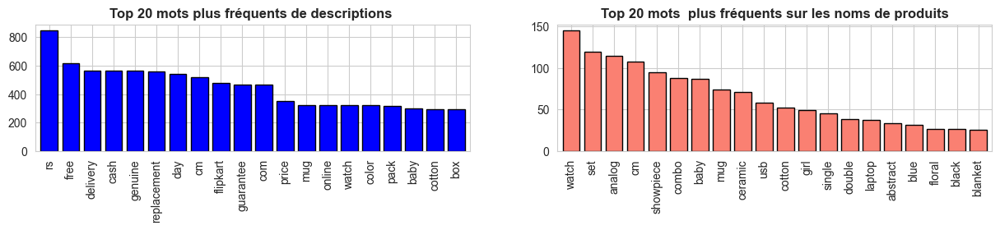

In [171]:
# création d'un corpus sur les decriptions et produits netoyées
corpus_desc = ' '.join(data_work['desc_clean'].values)
corpus_pname = ' '.join(data_work['pname_clean'].values)

# tokenisation des mots sur le corpus néttoyé
tokenizer = nltk.RegexpTokenizer(r'[a-z]+')
li_words_desc = tokenizer.tokenize(corpus_desc.lower())
li_words_pname = tokenizer.tokenize(corpus_pname.lower())

# Comptage de le fréquence de chaque mot
ser_freq_desc = pd.Series(nltk.FreqDist(li_words_desc))
ser_freq_pname = pd.Series(nltk.FreqDist(li_words_pname))

fig = plt.figure(figsize=(15,2))

# Graphe des mots les plus fréquents
ax = fig.add_subplot(1,2,1)
ser_freq_desc.sort_values(ascending=False)[0:20].plot.bar(width=0.8,
                                                          color='blue',
                                                          ec='k',
                                                          ax=ax)
ax.set_title("Top 20 mots plus fréquents de descriptions ", fontweight='bold')
ax = fig.add_subplot(1,2,2)
ser_freq_pname.sort_values(ascending=False)[0:20].plot.bar(width=0.8,
                                                           color='salmon',
                                                           ec='k',
                                                           ax=ax)
ax.set_title("Top 20 mots  plus fréquents sur les noms de produits", fontweight='bold')
plt.show()

**WordCloud par catégorie**

Visualisation des mots les plus fréquents pour chacune des 7 catégories après le pré-traitement de la variable 'description'

Mots les plus fréquents de la catégorie : Furnishing


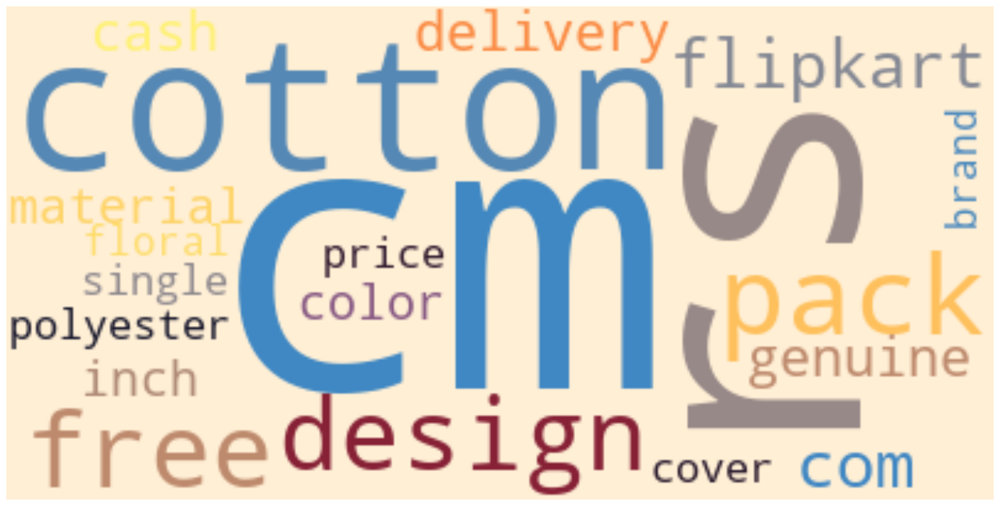

Mots les plus fréquents de la catégorie : Baby


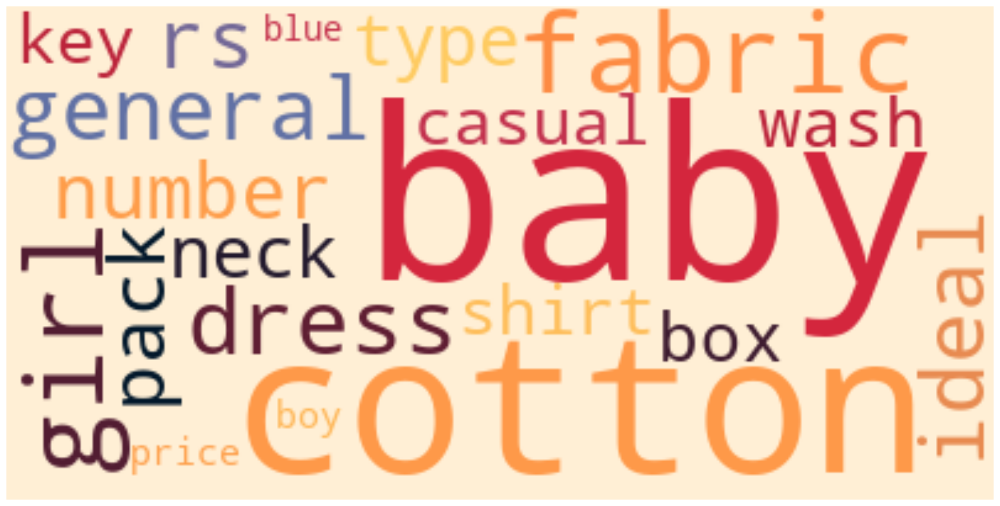

Mots les plus fréquents de la catégorie : Watches


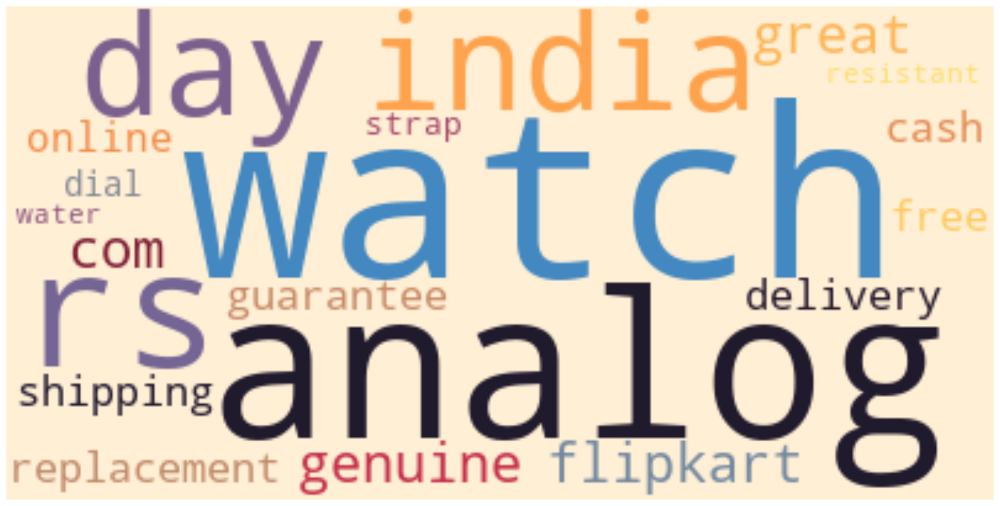

Mots les plus fréquents de la catégorie : Decor


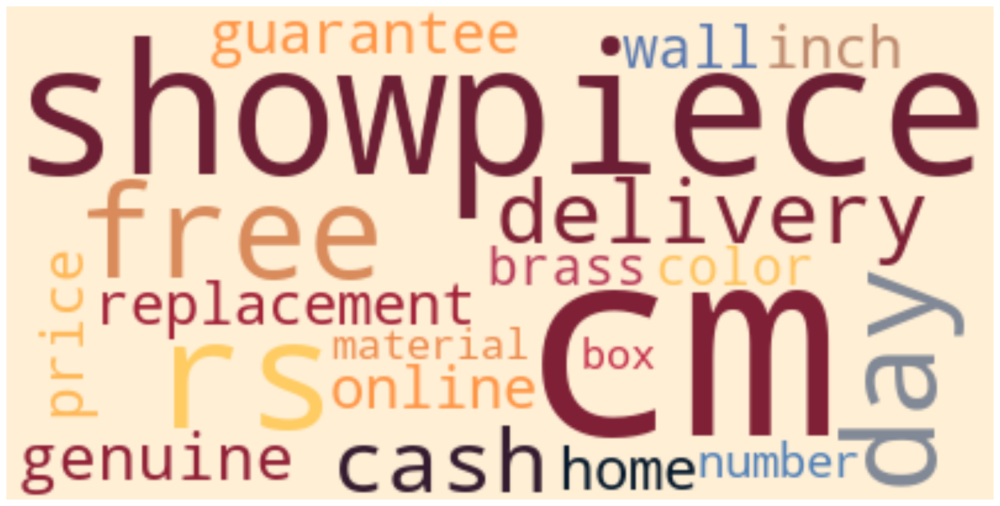

Mots les plus fréquents de la catégorie : Kitchen


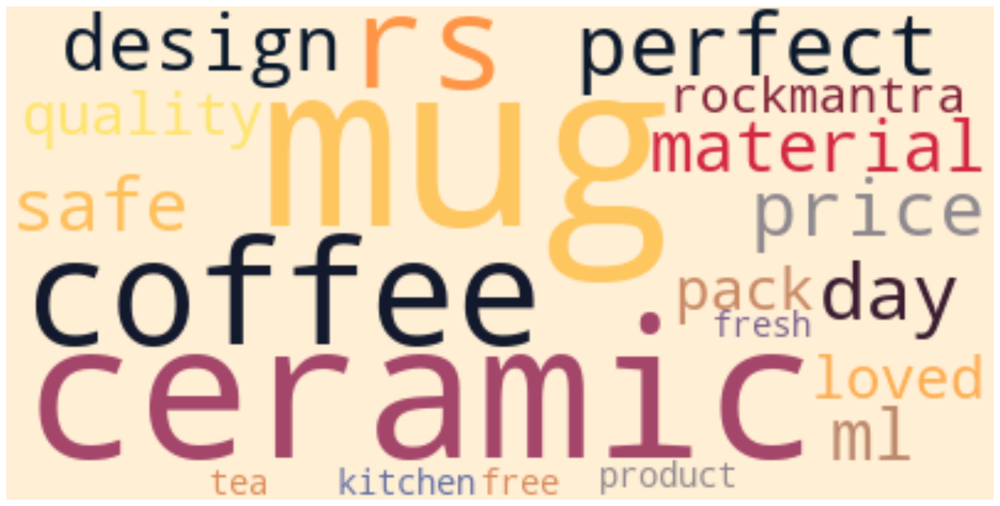

Mots les plus fréquents de la catégorie : Beauty


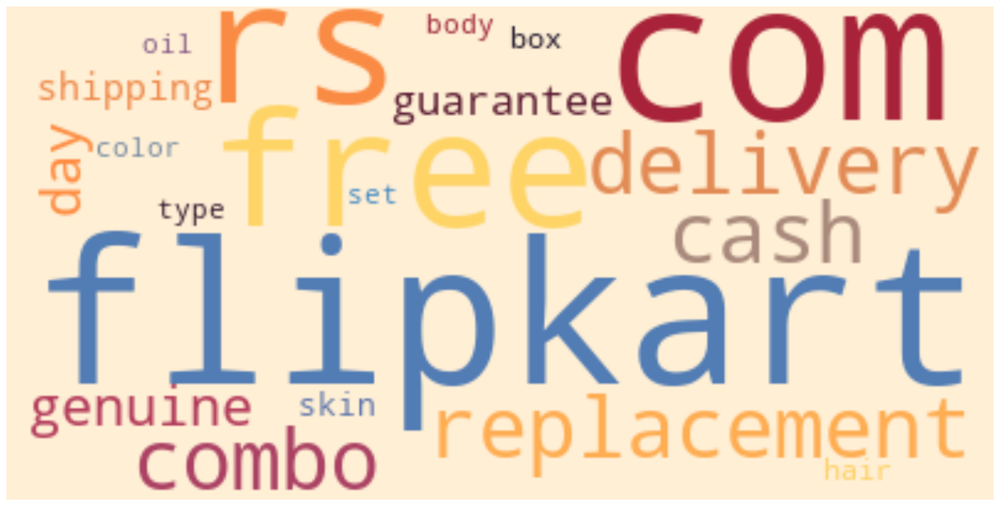

Mots les plus fréquents de la catégorie : Computers


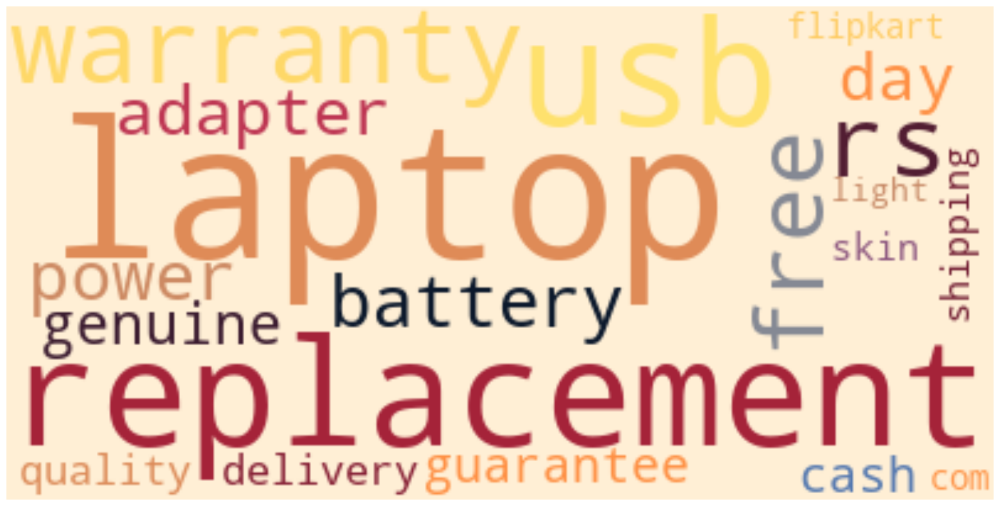

In [173]:
fonctions_data.affiche_wordcloud_hue(df_desc_cat, 'desc_clean',
                                  'category', 20)

Mots les plus fréquents de la catégorie : Furnishing


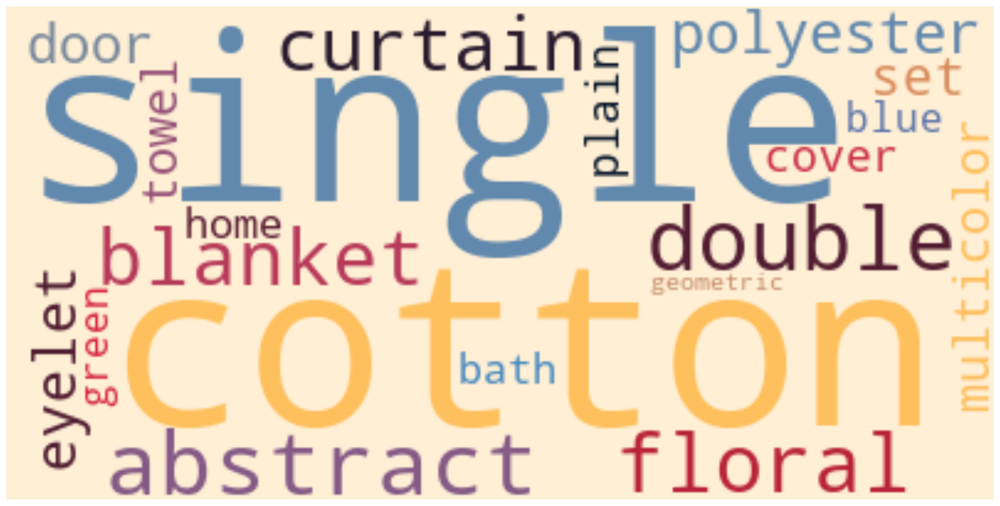

Mots les plus fréquents de la catégorie : Baby


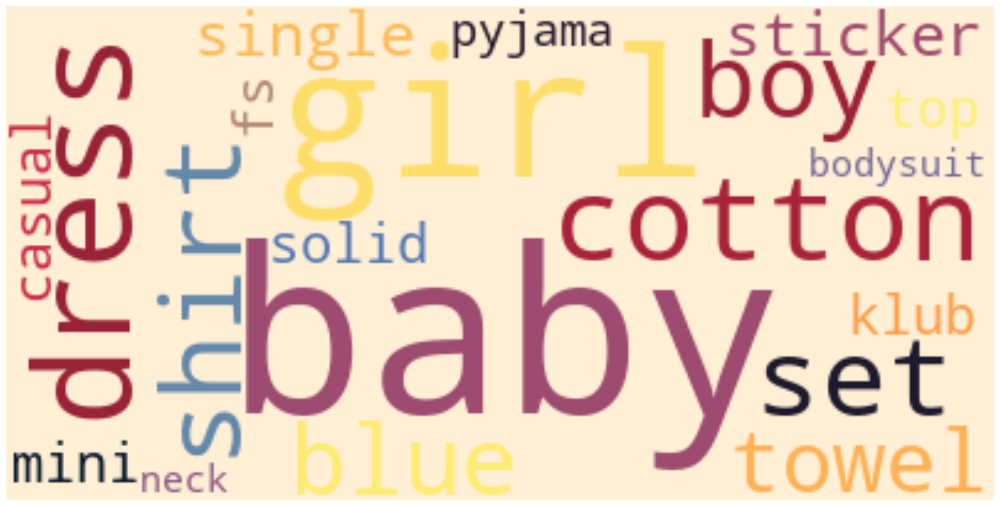

Mots les plus fréquents de la catégorie : Watches


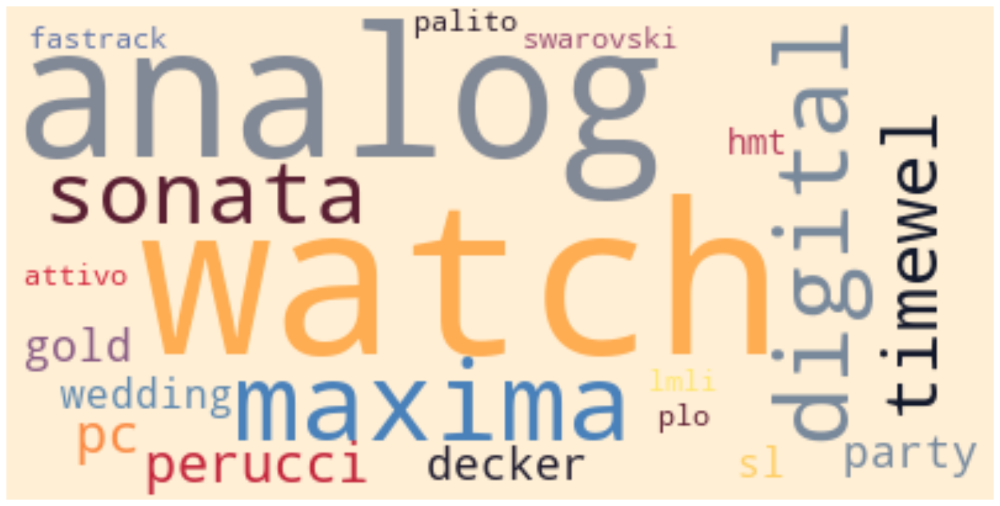

Mots les plus fréquents de la catégorie : Decor


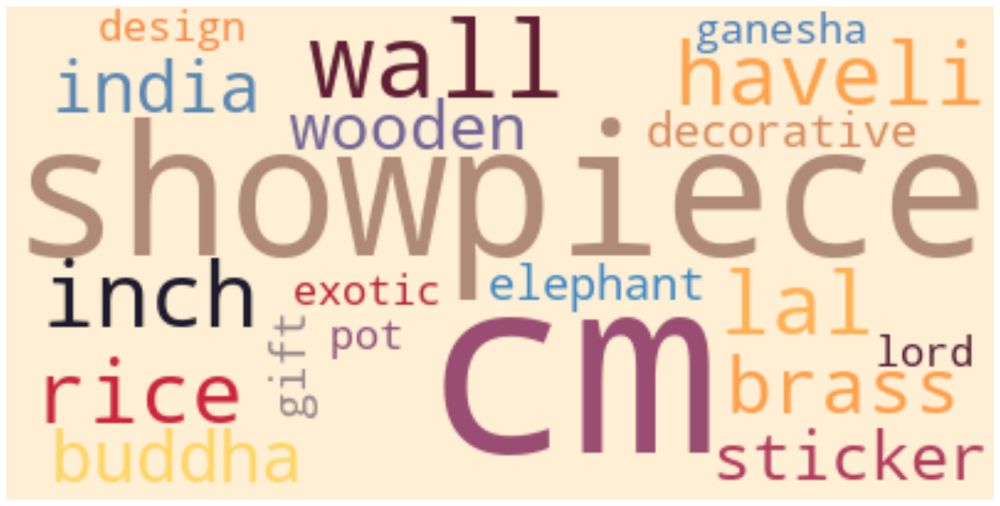

Mots les plus fréquents de la catégorie : Kitchen


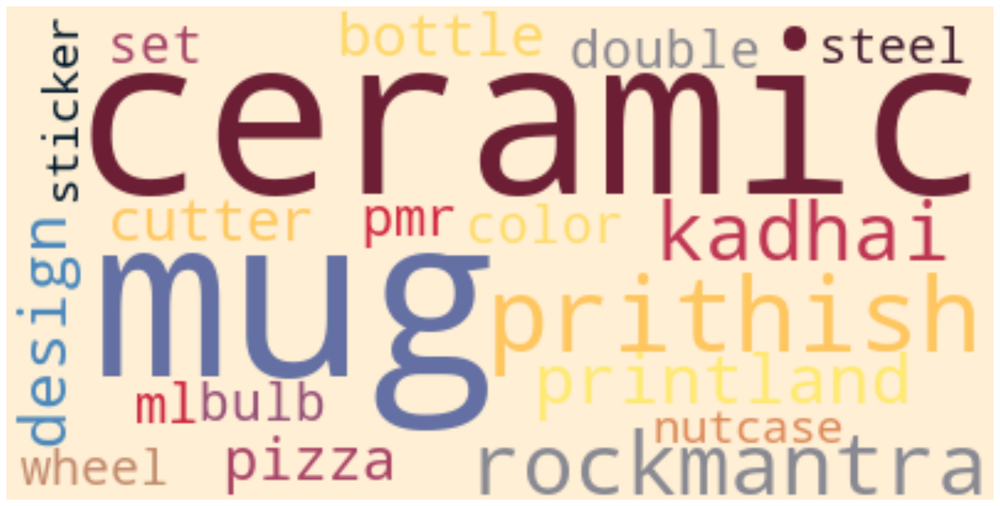

Mots les plus fréquents de la catégorie : Beauty


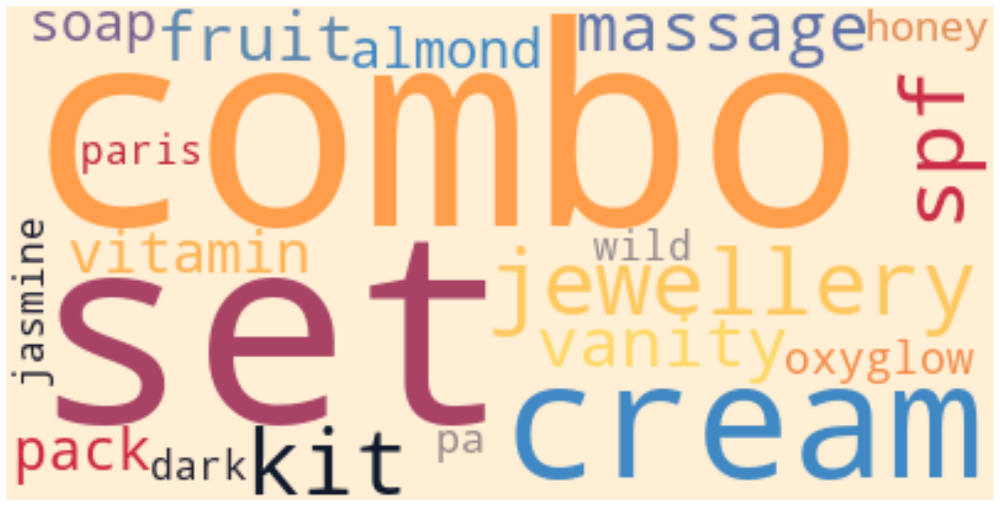

Mots les plus fréquents de la catégorie : Computers


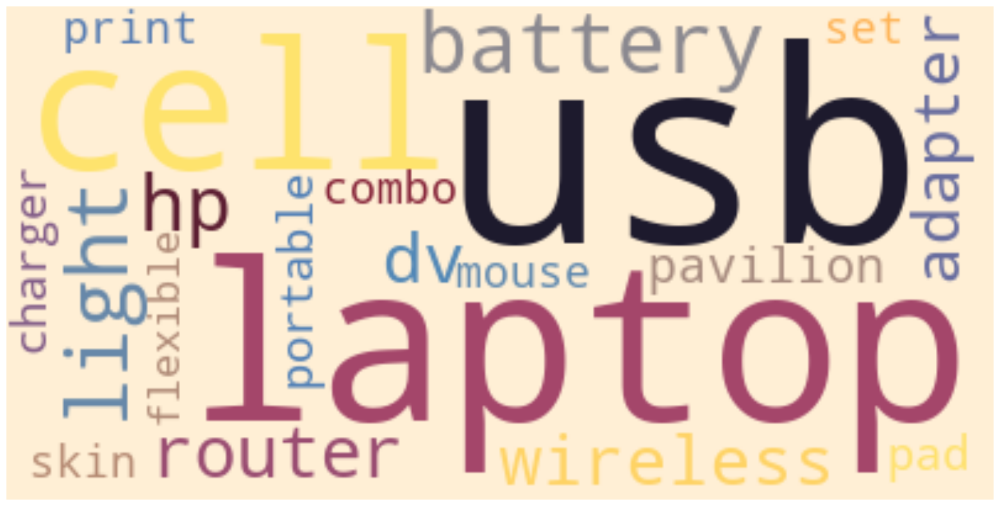

In [174]:
fonctions_data.affiche_wordcloud_hue(df_desc_cat, 'pname_clean',
                                  'category', 20)

**Fréquence des 50 mots les plus fréquents dans la description des produits**

In [175]:
# Préparation du dataframe de travail
# ---------------------------------------------------------------------
# Fréquence de tous les mots de tous les produits dans la description
# nettoyée ?
texte = ''
sentence = ' '.join([texte + row for row in df_desc_cat['desc_clean']])
tokens = nltk.word_tokenize(sentence)
fdist = FreqDist(tokens)
# Constitution du dataframe de travail
df_freq_clean = pd.DataFrame({'Mot': fdist.keys(),
                              'Frequence': fdist.values()}) \
                .sort_values(['Frequence'], ascending=False)
nb_tot = df_freq_clean['Frequence'].count()
df_freq_clean['%_frequence'] = \
    round((df_freq_clean['Frequence'])*100/nb_tot, 2)

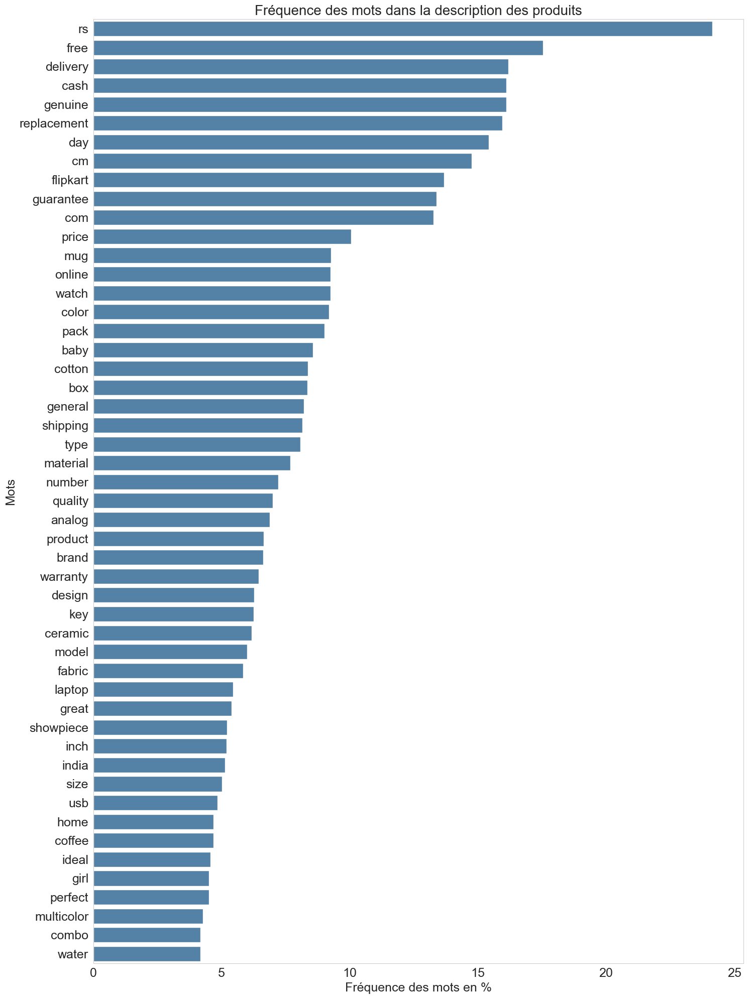

In [176]:
# Visualisation des 50 mots les plus fréquents dans description
# ---------------------------------------------------------------------
# Barplot de répartition
data_visu = df_freq_clean.head(50)
# Préparation de la liste des 50 mots les plus fréquents
liste_50_mots_desc = data_visu['Mot'].to_list()
sns.set_style("whitegrid")
plt.figure(figsize=(15, 20))
sns.barplot(x=data_visu['%_frequence'],
            y=data_visu['Mot'],
            data=data_visu,
            color='SteelBlue')
plt.title('Fréquence des mots dans la description des produits',
          fontsize=20)
plt.xlabel('Fréquence des mots en %', fontsize=18)
plt.ylabel('Mots', fontsize=18)
plt.xticks(fontsize=18)
plt.yticks(fontsize=18)
plt.grid(False)
plt.tight_layout()
plt.show()

## <span style='background:PowderBlue'>4. Feature extraction - Word & Text Embeddings</span>

### <span style='background:orange'>4.1 BOW - Bags of words - CountVectorizer</span>

***Note*** :
***
- CountVectorizer convertit une collection de documents texte en une matrice de comptage de tokens : les occurrences des tokens dans chaque document. 
- Cette implémentation produit une représentation éparse, creuse du nombre de tokens.

**Hyperparamètres** :
- **stop_words** : Étant donné que CountVectorizer ne compte que les occurrences de chaque mot de son vocabulaire, des mots extrêmement courants comme " le ", " et ", etc. deviendront des caractéristiques très importantes alors qu'ils ajoutent peu de sens au texte.
- **ngram_range** : Un n-gram est juste une chaîne de n mots à la suite. Par exemple, la phrase 'I am Groot' contient les 2-grammes 'I am' et 'am Groot'.
- **min_df**, **max_df** : Ce sont les fréquences minimales et maximales des documents que les mots/n-grammes doivent avoir pour être utilisés comme caractéristiques.
- **max_features** : Ce paramètre est assez explicite. Le CountVectorizer choisira les mots/caractéristiques qui apparaissent le plus fréquemment dans son vocabulaire et laissera tomber tout le reste.

In [36]:
title = 'TSNE_CV_ACP_DESC_LEM'

In [37]:
data_cat = data_work['category']

In [38]:
data_desc = data_work['description']
data_desc[24]

'fastrack 38015PL01 Analog Watch  - For Men, Boys - Buy fastrack 38015PL01 Analog Watch  - For Men, Boys  38015PL01 Online at Rs.2495 in India Only at Flipkart.com. Stainless steel back cover. Hybrid case construction for a sportier and more rugged look with increased shock resistance. High precision quartz analogue movement. - Great Discounts, Only Genuine Products, 30 Day Replacement Guarantee, Free Shipping. Cash On Delivery!'

**Traitement variable origine**

**description** - variable brut

In [39]:
data_desc_c = data_desc.copy()

df_desc_cv = fonctions_data.vectorize_text_data(data_desc_c, CountVectorizer())
df_desc_cv_acp = fonctions_data.acp(df_desc_cv)
df_desc_cv_acp_tsne = fonctions_data.tsne(df_desc_cv_acp, 40)
df_desc_cv_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_desc_cv_acp_tsne, data_cat)                            

(1050, 6053)
Nombre de features après réduction ACP pour 99.0% de variance : 614
-----------------------------------------
 ARI  : 0.3307
 Homogénéité  : 0.4221
-----------------------------------------


**description** - lemmatisée

In [40]:
data_desc_lem = data_work['desc_lem']
data_desc_lem[24]

'fastrack pl analog watch fastrack pl analog watch online rs india flipkart com stainless steel hybrid case construction rugged look increased shock resistance high precision quartz analogue movement great genuine day replacement guarantee free shipping cash delivery'

(1050, 3503)
Nombre de features après réduction ACP pour 99.0% de variance : 560
-----------------------------------------
 ARI  : 0.43
 Homogénéité  : 0.5399
-----------------------------------------


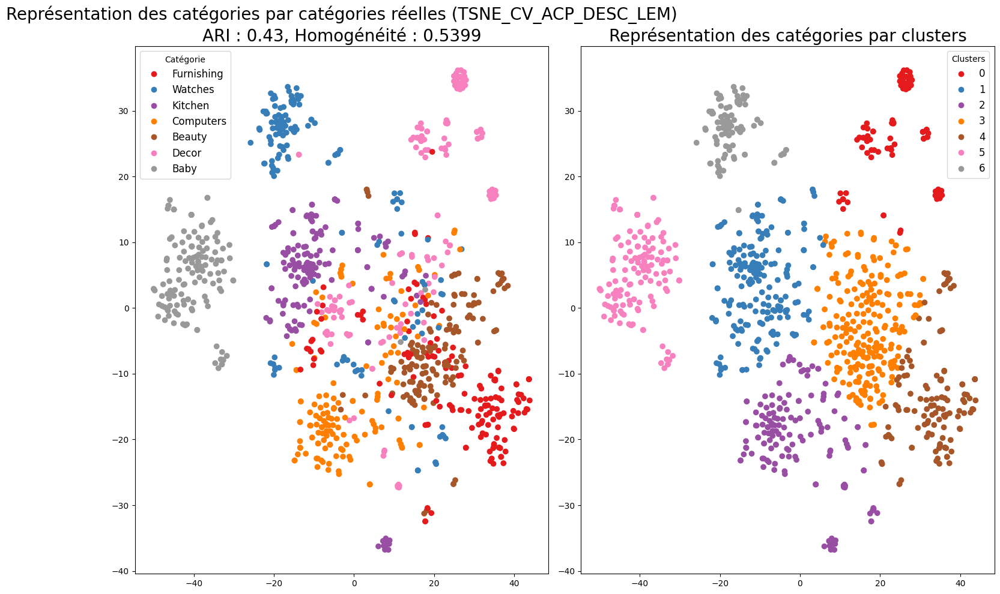

In [41]:
data_desc_lem_c = data_desc_lem.copy()

df_desc_lem_cv = fonctions_data.vectorize_text_data(data_desc_lem, CountVectorizer())
df_desc_lem_cv_acp = fonctions_data.acp(df_desc_lem_cv)
df_desc_lem_cv_acp_tsne = fonctions_data.tsne(df_desc_lem_cv_acp, 40)
df_desc_lem_cv_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_desc_lem_cv_acp_tsne, data_cat)  
fonctions_data.affiche_projection_par_clusters(df_desc_lem_cv_acp_tsne_km, labels, ARI, Homogeneite, title)

- On constate deja la formation des groupes, avec un indicateur de similarité de 43 %, et un degré d'homogénéité de 54 %, la confirmation des résultats devra etre effectué via l'extraction des features. 

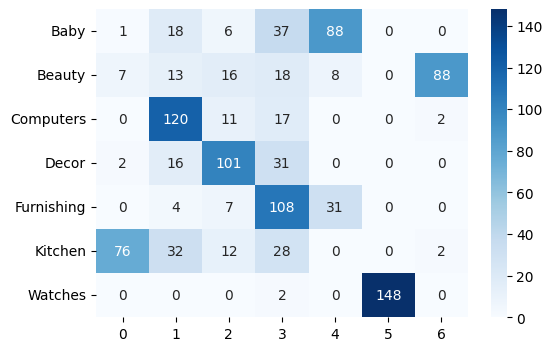

In [177]:
fonctions_data.conf_mat(df_desc_lem_cv_acp_tsne_km['label'], df_desc_lem_cv_acp_tsne_km['cluster_id'])

**nom_produit** - lemmatisée

In [224]:
title = 'TSNE_CV_ACP_PROD_LEM'

In [182]:
data_prod_lem = data_work['pname_lem']
data_prod_lem[24]

'fastrack pl analog watch'

(1050, 1617)
Nombre de features après réduction ACP pour 99.0% de variance : 748
-----------------------------------------
 ARI  : 0.3326
 Homogénéité  : 0.4524
-----------------------------------------


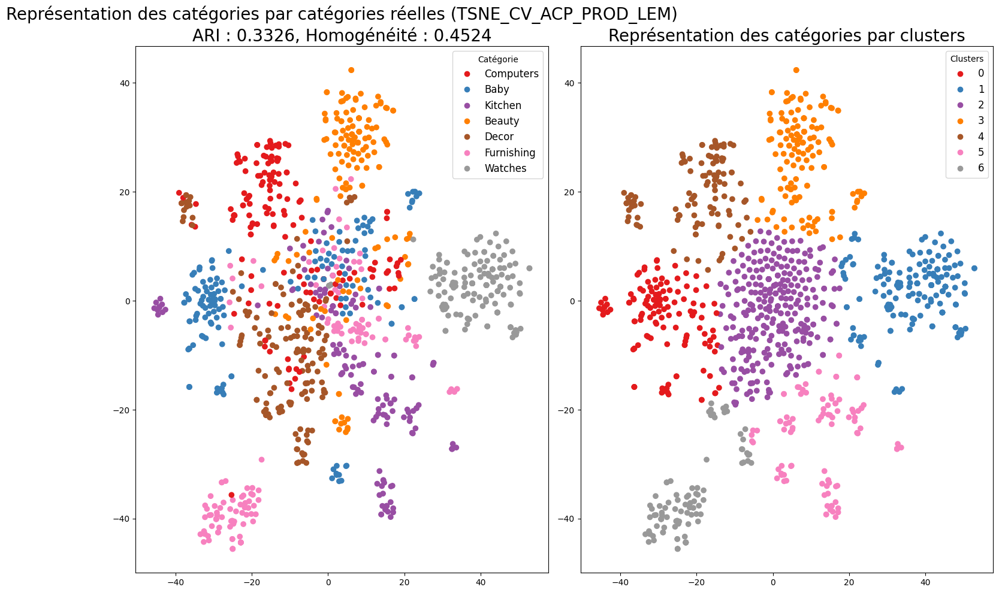

In [225]:
data_prod_lem_c = data_prod_lem.copy()

df_prod_lem_cv = fonctions_data.vectorize_text_data(data_prod_lem_c, CountVectorizer())
df_prod_lem_cv_acp = fonctions_data.acp(df_prod_lem_cv)
df_prod_lem_cv_acp_tsne = fonctions_data.tsne(df_prod_lem_cv_acp, 40)
df_prod_lem_cv_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_prod_lem_cv_acp_tsne, data_cat)  
fonctions_data.affiche_projection_par_clusters(df_prod_lem_cv_acp_tsne_km, labels, ARI, Homogeneite, title)

- Le score ARI est assez faible (0.33), ainsi que le degré d'homogénéité (0.45)
- La combinaison CountVectorizer + ACP + nom du produit + lemmatisés, ne parvient pas à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (61%).

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,0.803571,0.600000,0.687023,150.000000
1,0.586466,0.520000,0.551237,150.000000
2,0.730000,0.486667,0.584000,150.000000
3,0.755396,0.700000,0.726644,150.000000
4,0.263889,0.506667,0.347032,150.000000
5,0.755102,0.493333,0.596774,150.000000
6,0.805556,0.966667,0.878788,150.000000
accuracy,0.610476,0.610476,0.610476,0.610476
macro avg,0.671426,0.610476,0.624500,1050.000000
weighted avg,0.671426,0.610476,0.624500,1050.000000


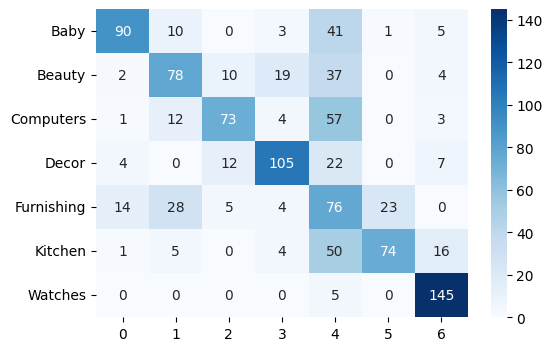

In [211]:
fonctions_data.conf_mat_metrics(df_prod_lem_cv_acp_tsne_km)

**specification_produit** - lemmatisée

In [69]:
title = 'TSNE_ACP_CV_PRODS_LEM'

In [70]:
data_prods_lem = data_work['prod_spec_lem']
data_prods_lem[2]

'product specification key material value cotton key design value shuvam key brand value key value key type value face towel key model name value shuvam key ideal value key model id value shuvam key size value small key color value key weight value key length value inch key width value inch key number package value key package value piece face towel set'

(1050, 2638)
Nombre de features après réduction ACP pour 99.0% de variance : 393
-----------------------------------------
 ARI  : 0.3138
 Homogénéité  : 0.4562
-----------------------------------------


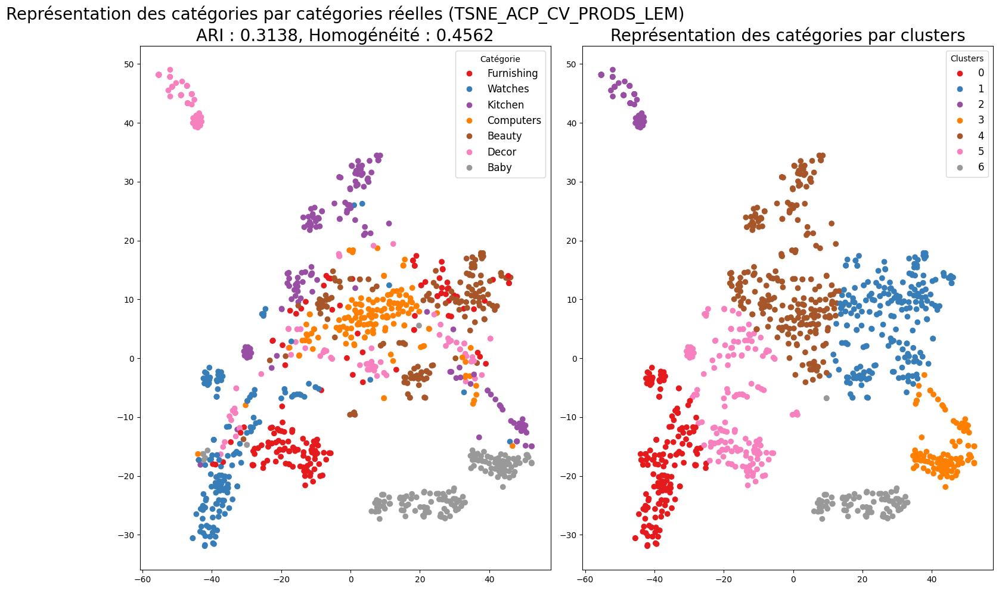

In [71]:
data_prods_lem_c = data_prods_lem.copy()

df_prods_lem_cv = fonctions_data.vectorize_text_data(data_prods_lem_c, CountVectorizer())
df_prods_lem_cv_acp = fonctions_data.acp(df_prods_lem_cv)
df_prods_lem_cv_acp_tsne = fonctions_data.tsne(df_prods_lem_cv_acp, 40)
df_prods_lem_cv_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_prods_lem_cv_acp_tsne, data_cat)  
fonctions_data.affiche_projection_par_clusters(df_prods_lem_cv_acp_tsne_km, labels, ARI, Homogeneite, title)

- Le score ARI est assez faible (0.31), ainsi que le degré d'homogénéité (0.46)
- La combinaison CountVectorizer + ACP + specialisation_produit + lemmatisés, ne parvient pas à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (59%).

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,0.512500,0.546667,0.529032,150.000000
1,0.719512,0.786667,0.751592,150.000000
2,0.380392,0.646667,0.479012,150.000000
3,0.000000,0.000000,0.000000,150.000000
4,0.490991,0.726667,0.586022,150.000000
5,1.000000,0.486667,0.654709,150.000000
6,0.801136,0.940000,0.865031,150.000000
accuracy,0.590476,0.590476,0.590476,0.590476
macro avg,0.557790,0.590476,0.552200,1050.000000
weighted avg,0.557790,0.590476,0.552200,1050.000000


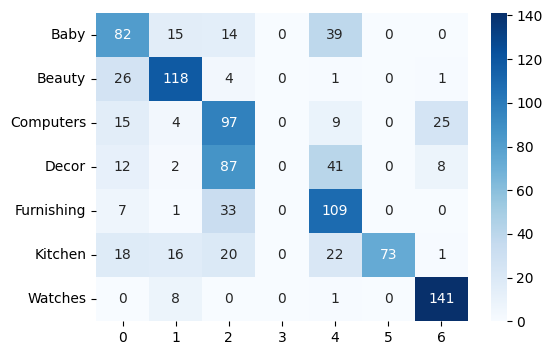

In [72]:
fonctions_data.conf_mat_metrics(df_prods_lem_cv_acp_tsne_km)

**description** - racinisée

In [231]:
data_desc_stem = data_work['desc_stem']
data_desc_stem[2]

'key eurospa cotton terri face towel size small height inch gsm eurospa cotton terri face towel piec face towel assort price rs eurospa soft cotton export qualiti soft textur care skin bath lot renown last famous fine absorb soft durabl product cotton suscept product color pictur size wash care wash cold water flat dri wash first use size face towel cms cms eurospa cotton terri face towel piec face towel bath towel materi cotton terri design shuvam general brand eurospa gsm type face towel model name ideal boy id shuvam size small color length inch inch box number packag packag piec face towel set'

In [233]:
data_desc_stem_c = data_desc_stem.copy()

df_desc_stem_cv = fonctions_data.vectorize_text_data(data_desc_stem_c, CountVectorizer())
df_desc_stem_cv_acp = fonctions_data.acp(df_desc_stem_cv)
df_desc_stem_cv_acp_tsne = fonctions_data.tsne(df_desc_stem_cv_acp, 40)
df_desc_stem_cv_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_desc_stem_cv_acp_tsne, data_cat)  

(1050, 3260)
Nombre de features après réduction ACP pour 99.0% de variance : 556
-----------------------------------------
 ARI  : 0.3879
 Homogénéité  : 0.5047
-----------------------------------------


**nom_produit** - racinisée

In [234]:
data_prod_stem = data_work['pname_stem']
data_prod_stem[2]

'eurospa cotton terri face towel set'

In [235]:
data_prod_stem_c = data_prod_stem.copy()

df_prod_stem_cv = fonctions_data.vectorize_text_data(data_prod_stem_c, CountVectorizer())
df_prod_stem_cv_acp = fonctions_data.acp(df_prod_stem_cv)
df_prod_stem_cv_acp_tsne = fonctions_data.tsne(df_prod_stem_cv_acp, 40)
df_prod_stem_cv_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_prod_stem_cv_acp_tsne, data_cat)  

(1050, 1595)
Nombre de features après réduction ACP pour 99.0% de variance : 746
-----------------------------------------
 ARI  : 0.3281
 Homogénéité  : 0.4325
-----------------------------------------


**specification_produit** - racinisée

In [58]:
title = 'TSNE_ACP_CV_PRODS_STEM'

In [59]:
data_prods_stem = data_work['prod_spec_stem']
data_prods_stem[2]

'product specif key materi valu cotton key design valu shuvam key brand valu key valu key type valu face towel key model name valu shuvam key ideal valu key model id valu shuvam key size valu small key color valu key weight valu key length valu inch key width valu inch key number packag valu key packag valu piec face towel set'

(1050, 2544)
Nombre de features après réduction ACP pour 99.0% de variance : 388
-----------------------------------------
 ARI  : 0.3086
 Homogénéité  : 0.4469
-----------------------------------------


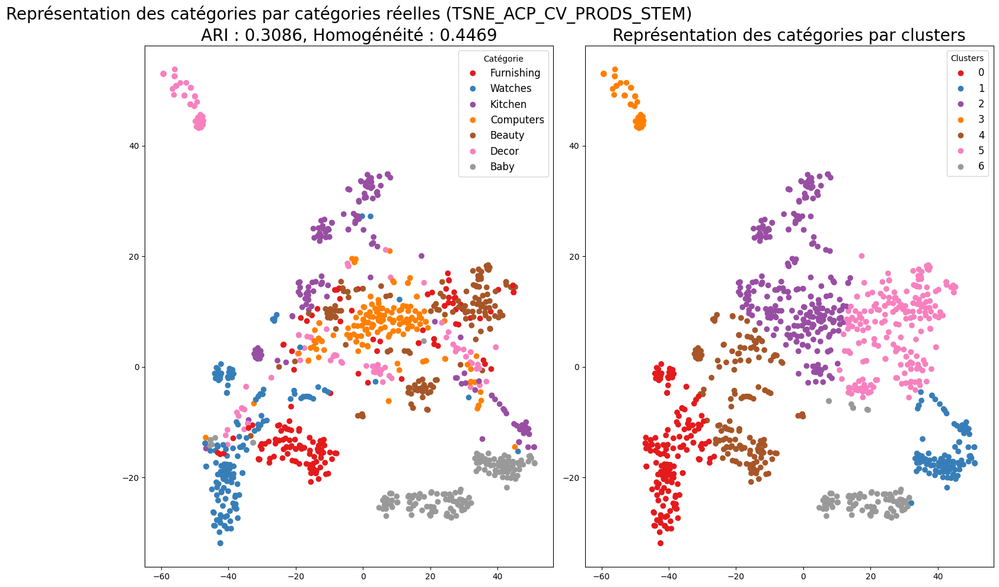

In [60]:
data_prods_stem_c = data_prods_stem.copy()

df_prods_stem_cv = fonctions_data.vectorize_text_data(data_prods_stem_c, CountVectorizer())
df_prods_stem_cv_acp = fonctions_data.acp(df_prods_stem_cv)
df_prods_stem_cv_acp_tsne = fonctions_data.tsne(df_prods_stem_cv_acp, 40)
df_prods_stem_cv_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_prods_stem_cv_acp_tsne, data_cat)  
fonctions_data.affiche_projection_par_clusters(df_prods_stem_cv_acp_tsne_km, labels, ARI, Homogeneite, title)

,precision,recall,f1-score,support
0,0.506329,0.533333,0.519481,150.000000
1,0.714286,0.800000,0.754717,150.000000
2,0.373541,0.640000,0.471744,150.000000
3,0.000000,0.000000,0.000000,150.000000
4,0.485981,0.693333,0.571429,150.000000
5,1.000000,0.486667,0.654709,150.000000
6,0.783333,0.940000,0.854545,150.000000
accuracy,0.584762,0.584762,0.584762,0.584762
macro avg,0.551924,0.584762,0.546661,1050.000000
weighted avg,0.551924,0.584762,0.546661,1050.000000


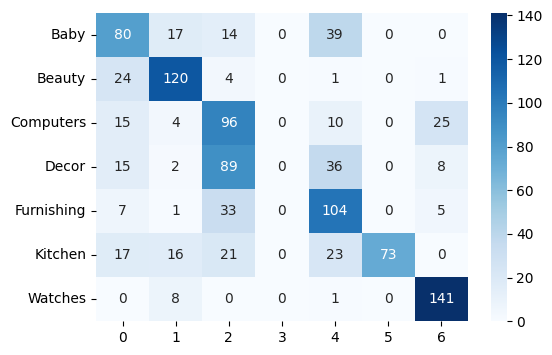

In [61]:
fonctions_data.conf_mat_metrics(df_prods_stem_cv_acp_tsne_km)

### <span style='background:orange'>4.2. BOW - TfidfVectorizer</span>

- Une transformation tf-idf (term frequency-inverse document frequency), permet de pondérer les fréquences d’apparition des termes par leur nombre d’occurrences dans l’ensemble des documents.
- La pondération tf-idf permet de contrebalancer l’importance d’un mot utilisé très fréquemment dans tous les documents du corpus par rapport aux termes plus spécifiques à certains documents. 
- TF-IDF est un produit de deux parties :
    - TF (Term Frequency) - Elle est définie comme le nombre de fois qu'un mot apparaît dans une phrase donnée.
    - IDF (Inverse Document Frequency) - Il est défini comme le logarithme à la base e du nombre total de documents divisé par les documents dans lesquels le mot apparaît.   

**description** - lemmatisée

In [268]:
title = 'TSNE_TFIDF_ACP_DESC_LEM'

(1050, 3503)
Nombre de features après réduction ACP pour 99.0% de variance : 789
-----------------------------------------
 ARI  : 0.468
 Homogénéité  : 0.5547
-----------------------------------------


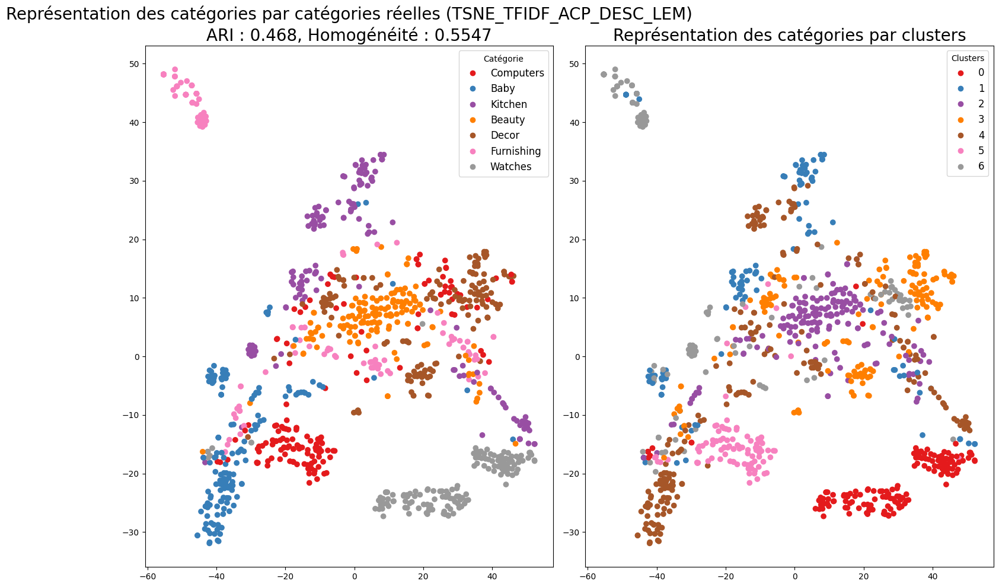

In [266]:
data_desc_lem_c = data_desc_lem.copy()

df_desc_lem_tf = fonctions_data.vectorize_text_data(data_desc_lem_c, TfidfVectorizer())
df_desc_lem_tf_acp = fonctions_data.acp(df_desc_lem_tf)
df_desc_lem_tf_acp_tsne = fonctions_data.tsne(df_desc_lem_tf_acp, 40)
df_desc_lem_tf_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_desc_lem_tf_acp_tsne, data_cat)  
fonctions_data.affiche_projection_par_clusters(df_prods_lem_cv_acp_tsne_km, labels, ARI, Homogeneite, title)

- Le score ARI est moyen (0.47), ainsi que le degré d'homogénéité (0.55)
- La combinaison TfIdfVectorizer + ACP + description + lemmatisés, ne parvient pas à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (69,4%).

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,0.957447,0.600000,0.737705,150.000000
1,0.391705,0.566667,0.463215,150.000000
2,0.685484,0.566667,0.620438,150.000000
3,0.773006,0.840000,0.805112,150.000000
4,0.768750,0.820000,0.793548,150.000000
5,0.503546,0.473333,0.487973,150.000000
6,0.986755,0.993333,0.990033,150.000000
accuracy,0.694286,0.694286,0.694286,0.694286
macro avg,0.723813,0.694286,0.699718,1050.000000
weighted avg,0.723813,0.694286,0.699718,1050.000000


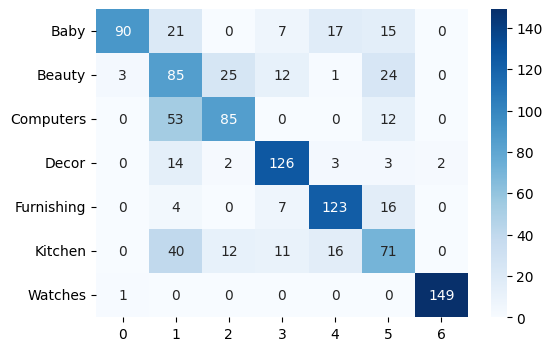

In [254]:
fonctions_data.conf_mat_metrics(df_desc_lem_tf_acp_tsne_km)

**nom_produit** - lemmatisée

In [247]:
data_prod_lem_c = data_prod_lem.copy()

df_prod_lem_tf = fonctions_data.vectorize_text_data(data_prod_lem_c, TfidfVectorizer())
df_prod_lem_tf_acp = fonctions_data.acp(df_prod_lem_tf)
df_prod_lem_tf_acp_tsne = fonctions_data.tsne(df_prod_lem_tf_acp, 40)
df_prod_lem_tf_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_prod_lem_tf_acp_tsne, data_cat)  

(1050, 1617)
Nombre de features après réduction ACP pour 99.0% de variance : 785
-----------------------------------------
 ARI  : 0.4073
 Homogénéité  : 0.4765
-----------------------------------------


**specification_produit** - lemmatisée

(1050, 2638)
Nombre de features après réduction ACP pour 99.0% de variance : 736
-----------------------------------------
 ARI  : 0.4685
 Homogénéité  : 0.5743
-----------------------------------------


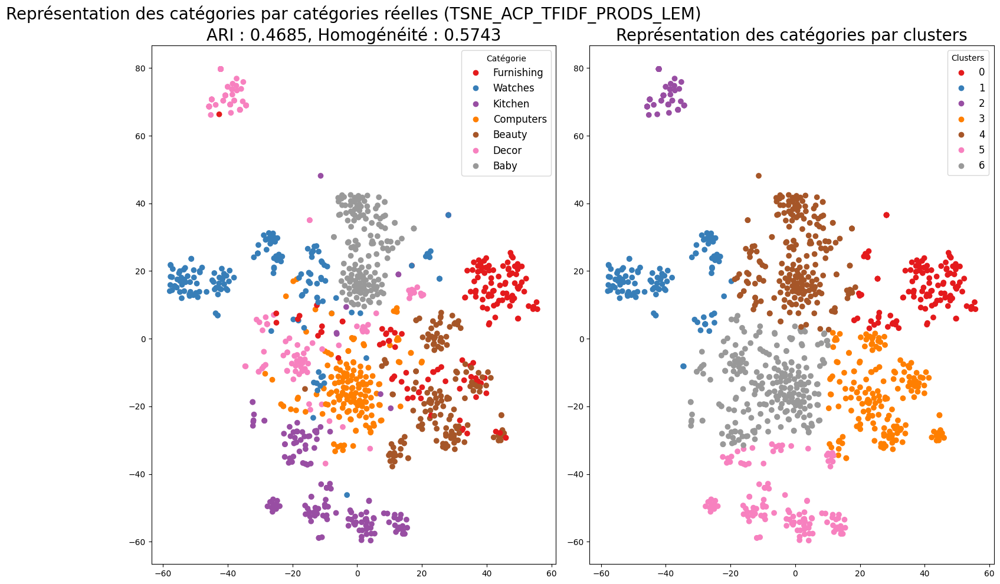

In [79]:
title = 'TSNE_ACP_TFIDF_PRODS_LEM'
data_prods_lem_c = data_prods_lem.copy()

df_prods_lem_tf = fonctions_data.vectorize_text_data(data_prods_lem_c, TfidfVectorizer())
df_prods_lem_tf_acp = fonctions_data.acp(df_prods_lem_tf)
df_prods_lem_tf_acp_tsne = fonctions_data.tsne(df_prods_lem_tf_acp, 40)
df_prods_lem_tf_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_prods_lem_tf_acp_tsne, data_cat)  
fonctions_data.affiche_projection_par_clusters(df_prods_lem_tf_acp_tsne_km, labels, ARI, Homogeneite, title)

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,0.726496,0.566667,0.636704,150.00000
1,0.845455,0.620000,0.715385,150.00000
2,0.849206,0.713333,0.775362,150.00000
3,0.525424,0.826667,0.642487,150.00000
4,0.687861,0.793333,0.736842,150.00000
5,0.986667,0.493333,0.657778,150.00000
6,0.704225,1.000000,0.826446,150.00000
accuracy,0.716190,0.716190,0.716190,0.71619
macro avg,0.760762,0.716190,0.713001,1050.00000
weighted avg,0.760762,0.716190,0.713001,1050.00000


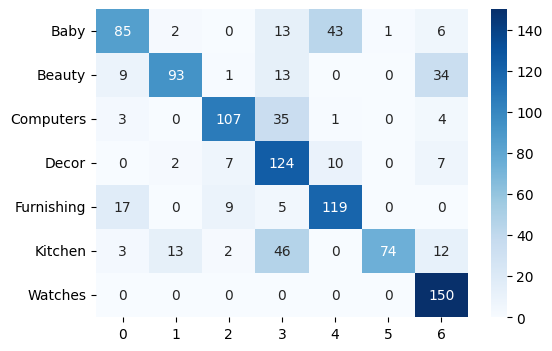

In [80]:
fonctions_data.conf_mat_metrics(df_prods_lem_tf_acp_tsne_km)

**description** - racinisée

In [249]:
data_desc_stem_c = data_desc_stem.copy()

df_desc_stem_tf = fonctions_data.vectorize_text_data(data_desc_stem_c, TfidfVectorizer())
df_desc_stem_tf_acp = fonctions_data.acp(df_desc_stem_tf)
df_desc_stem_tf_acp_tsne = fonctions_data.tsne(df_desc_stem_tf_acp, 40)
df_desc_stem_tf_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_desc_stem_tf_acp_tsne, data_cat)  

(1050, 3260)
Nombre de features après réduction ACP pour 99.0% de variance : 786
-----------------------------------------
 ARI  : 0.4367
 Homogénéité  : 0.5235
-----------------------------------------


**nom_produit** - racinisée

In [250]:
data_prod_stem_c = data_prod_stem.copy()

df_prod_stem_tf = fonctions_data.vectorize_text_data(data_prod_stem_c, TfidfVectorizer())
df_prod_stem_tf_acp = fonctions_data.acp(df_prod_stem_tf)
df_prod_stem_tf_acp_tsne = fonctions_data.tsne(df_prod_stem_tf_acp, 40)
df_prod_stem_tf_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_prod_stem_tf_acp_tsne, data_cat)  

(1050, 1595)
Nombre de features après réduction ACP pour 99.0% de variance : 783
-----------------------------------------
 ARI  : 0.3824
 Homogénéité  : 0.4639
-----------------------------------------


**specification_produit** - racicnisée

(1050, 2544)
-----------------------------------------
 ARI  : 0.4452
 Homogénéité  : 0.5517
-----------------------------------------


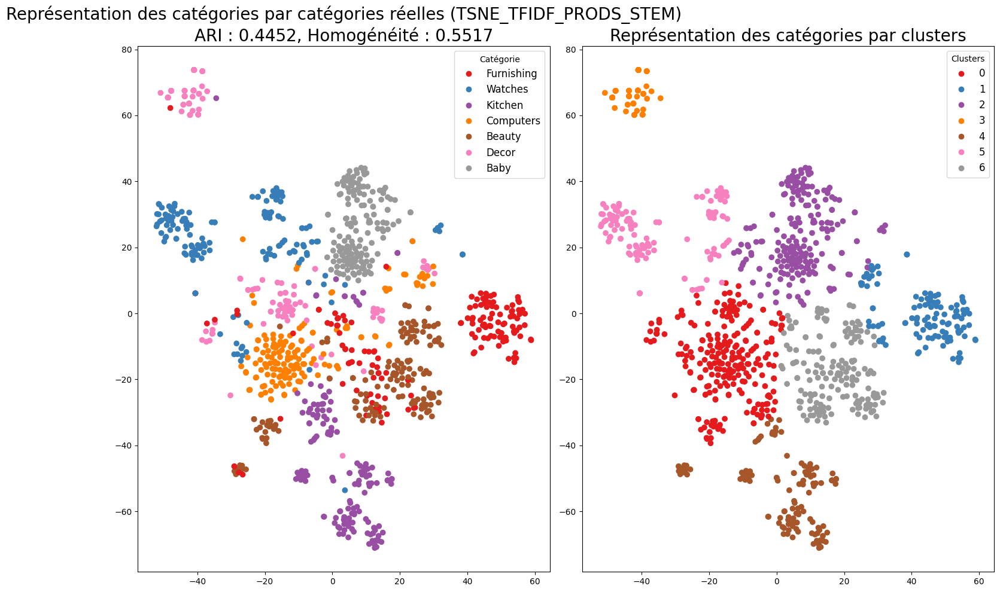

In [85]:
title = 'TSNE_TFIDF_PRODS_STEM'
data_prods_stem_c = data_prods_stem.copy()

df_prods_stem_tf = fonctions_data.vectorize_text_data(data_prods_stem_c, TfidfVectorizer())
df_prods_stem_tf_acp_tsne = fonctions_data.tsne(df_prods_stem_tf, 40)
df_prods_stem_tf_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_prods_stem_tf_acp_tsne, data_cat)  
fonctions_data.affiche_projection_par_clusters(df_prods_stem_tf_acp_tsne_km, labels, ARI, Homogeneite, title)

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,0.648855,0.566667,0.604982,150.000000
1,0.954545,0.700000,0.807692,150.000000
2,0.989474,0.626667,0.767347,150.000000
3,0.439655,0.680000,0.534031,150.000000
4,0.668317,0.900000,0.767045,150.000000
5,0.973684,0.493333,0.654867,150.000000
6,0.735294,1.000000,0.847458,150.000000
accuracy,0.709524,0.709524,0.709524,0.709524
macro avg,0.772832,0.709524,0.711918,1050.000000
weighted avg,0.772832,0.709524,0.711918,1050.000000


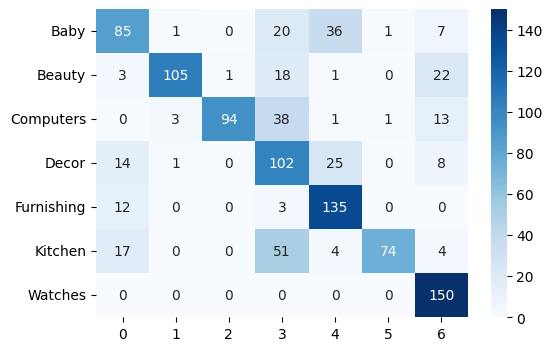

In [83]:
fonctions_data.conf_mat_metrics(df_prods_stem_tf_acp_tsne_km)

#### tfidf : nettoyage supplémentaire avec seuil de fréquence des mots

In [568]:
data_desc_lem_c = data_desc_lem.copy()

df_desc_lem_tf_freq = fonctions_data.vectorize_text_data(data_desc_lem_c, TfidfVectorizer(max_df=0.75, min_df=0.005))
df_desc_lem_tf_acp_freq = fonctions_data.acp(df_desc_lem_tf_freq)
df_desc_lem_tf_acp_tsne_freq = fonctions_data.tsne(df_desc_lem_tf_acp_freq, 20)
df_desc_lem_tf_acp_tsne_km_freq, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_desc_lem_tf_acp_tsne_freq, data_cat)  

(1050, 603)
Nombre de features après réduction ACP pour 99.0% de variance : 379
-----------------------------------------
 ARI  : 0.4805
 Homogénéité  : 0.5836
-----------------------------------------


(1050, 603)
-----------------------------------------
 ARI  : 0.5267
 Homogénéité  : 0.6165
-----------------------------------------


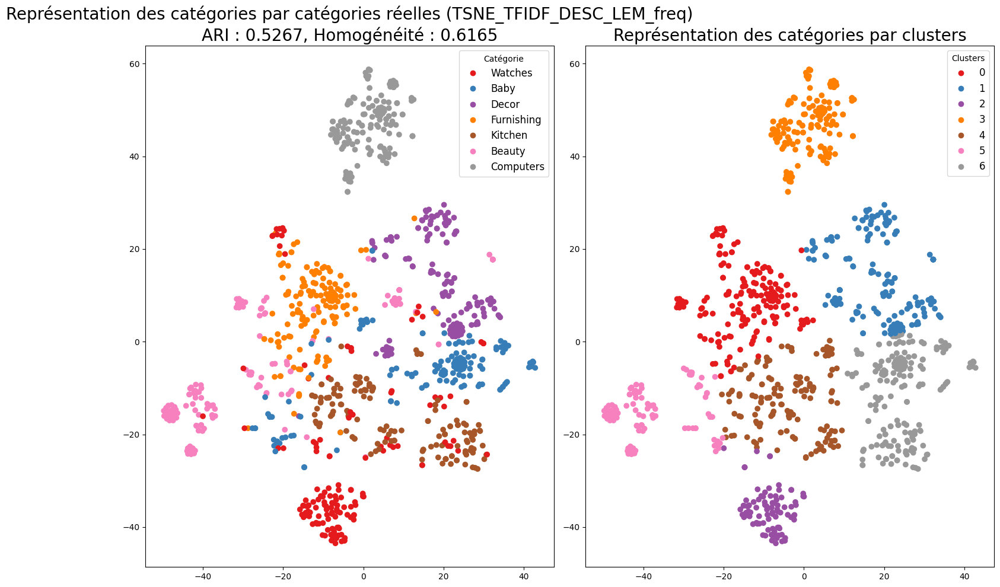

In [569]:
# Sans ACP
title = 'TSNE_TFIDF_DESC_LEM_freq'
df_desc_lem_tf_freq = fonctions_data.vectorize_text_data(data_desc_lem_c, TfidfVectorizer(max_df=0.75, min_df=0.005))
df_desc_lem_tf_tsne_freq = fonctions_data.tsne(df_desc_lem_tf_freq, 40)
df_desc_lem_tf_tsne_km_freq, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_desc_lem_tf_tsne_freq, data_cat)  
fonctions_data.affiche_projection_par_clusters(df_desc_lem_tf_tsne_km_freq, labels, ARI, Homogeneite, title)

- Le score ARI assez bon (0.53), ainsi que le degré d'homogénéité (0.62)
- La combinaison TfIdfVectorizer + description + lemmatisés + freq de mots, ne parvient pas exactement à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (72,3%).

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,0.967742,0.600000,0.740741,150.000000
1,0.512953,0.660000,0.577259,150.000000
2,0.767442,0.880000,0.819876,150.000000
3,0.723164,0.853333,0.782875,150.000000
4,0.496815,0.520000,0.508143,150.000000
5,0.796296,0.573333,0.666667,150.000000
6,1.000000,1.000000,1.000000,150.000000
accuracy,0.726667,0.726667,0.726667,0.726667
macro avg,0.752059,0.726667,0.727937,1050.000000
weighted avg,0.752059,0.726667,0.727937,1050.000000


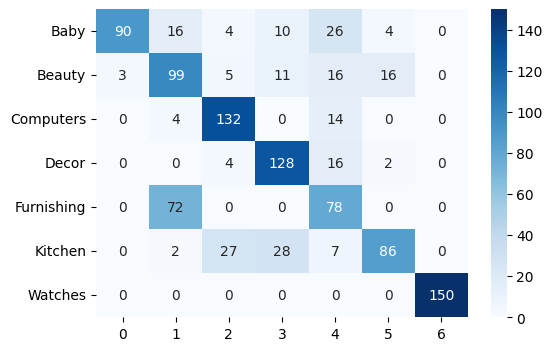

In [270]:
fonctions_data.conf_mat_metrics(df_desc_lem_tf_tsne_km_freq)

### <span style='background:orange'>4.3. Word2vec</span>

**nom_produit** - brut

In [ ]:
text_dim = 300

In [214]:
# Description Lemmatisée word2vec a besoin d'une liste de liste
data_vec = data_work['product_name']
data_work['product_name_token'] = \
    [word_tokenize(str(row)) for row in
     data_vec]
data_token = data_work['product_name_token'].copy()

In [215]:
# Instanciation du modèle
w2v_model_pname = Word2Vec(data_token, vector_size=300, window=5, min_count=1, workers=4)
# Construit le vocabulaire à partir d'une séquence de mots et
# initialise ainsi le modèle.
w2v_model_pname.build_vocab(data_token,
                               progress_per=10000)
# Entraînement du modèle
w2v_model_pname.train(data_token,
                         total_examples=w2v_model_pname.corpus_count,
                         epochs=30, report_delay=1)

(194529, 237870)

In [216]:
# Vectorisation
vector_w2v_pname = fonctions_data.word2vec_vectorisation(data_vec,
                                                        text_dim,
                                                        w2v_model_pname)
# Dataframe pour réduction de dimension
df_w2v_pname = pd.DataFrame(vector_w2v_pname)

Nombre de features après réduction ACP pour 99.0% de variance : 6
-----------------------------------------
 ARI  : 0.6344
 Homogénéité  : 0.7403
-----------------------------------------


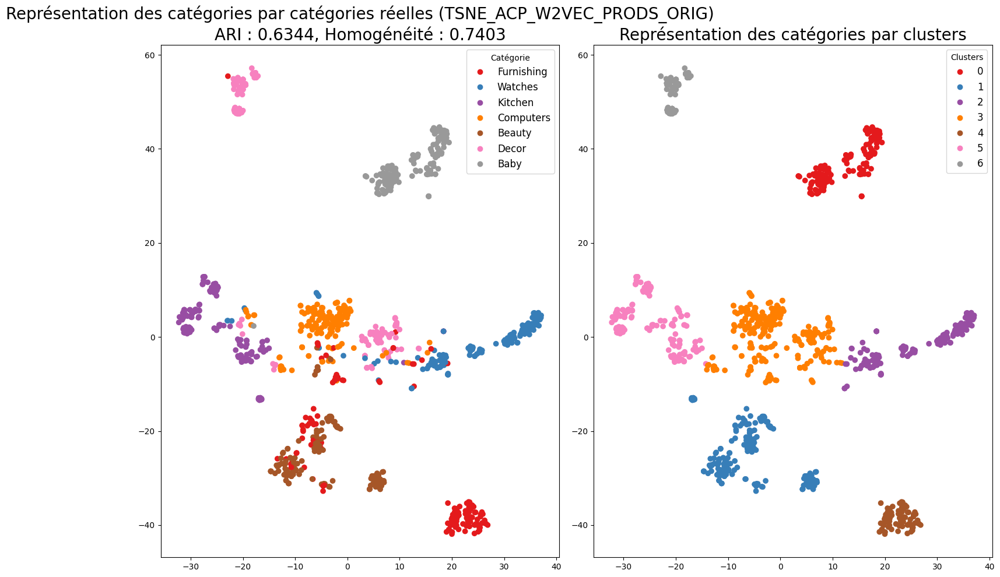

In [217]:
title = 'TSNE_ACP_W2VEC_PRODS_ORIG'
df_w2v_pname_acp = fonctions_data.acp(df_w2v_pname)
df_w2v_pname_acp_tsne = fonctions_data.tsne(df_w2v_prods_lem_acp, 40)
df_w2v_pname_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_w2v_pname_acp_tsne, data_cat)  
fonctions_data.affiche_projection_par_clusters(df_w2v_pname_acp_tsne_km, labels, ARI, Homogeneite, title)

- Le score ARI est bon (0.63), ainsi que le degré d'homogénéité (0.74)
- La combinaison Word2Vec + TfIdfVectorizer + ACP + nom_produit , parvient pas à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (81%).

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,1.000000,0.553333,0.712446,150.000000
1,0.910345,0.880000,0.894915,150.000000
2,0.865385,0.900000,0.882353,150.000000
3,0.553785,0.926667,0.693267,150.000000
4,0.738220,0.940000,0.826979,150.000000
5,0.986667,0.493333,0.657778,150.000000
6,1.000000,0.993333,0.996656,150.000000
accuracy,0.812381,0.812381,0.812381,0.812381
macro avg,0.864914,0.812381,0.809199,1050.000000
weighted avg,0.864914,0.812381,0.809199,1050.000000


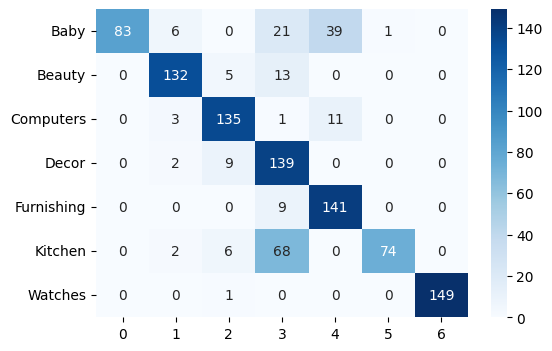

In [218]:
fonctions_data.conf_mat_metrics(df_w2v_pname_acp_tsne_km)

**produit_specifications** - lemmatisée

In [106]:
# Description Lemmatisée word2vec a besoin d'une liste de liste
data_vec = data_work['prod_spec_lem']
data_work['prod_spec_lem_token'] = \
    [word_tokenize(str(row)) for row in
     data_vec]
data_token = data_work['prod_spec_lem_token'].copy()

In [107]:
# Instanciation du modèle
w2v_model_prods_lem = Word2Vec(data_token, vector_size=300, window=5, min_count=1, workers=4)
# Construit le vocabulaire à partir d'une séquence de mots et
# initialise ainsi le modèle.
w2v_model_prods_lem.build_vocab(data_token,
                               progress_per=10000)
# Entraînement du modèle
w2v_model_prods_lem.train(data_token,
                         total_examples=w2v_model_prods_lem.corpus_count,
                         epochs=30, report_delay=1)

(852543, 1800000)

In [108]:
# Vectorisation
vector_w2v_prods_lem = wofonctions_data.rd2vec_vectorisation(data_vec,
                                                        text_dim,
                                                        w2v_model_prods_lem)
# Dataframe pour réduction de dimension
df_w2v_prods_lem = pd.DataFrame(vector_w2v_prods_lem)

Nombre de features après réduction ACP pour 99.0% de variance : 17
-----------------------------------------
 ARI  : 0.5179
 Homogénéité  : 0.6312
-----------------------------------------


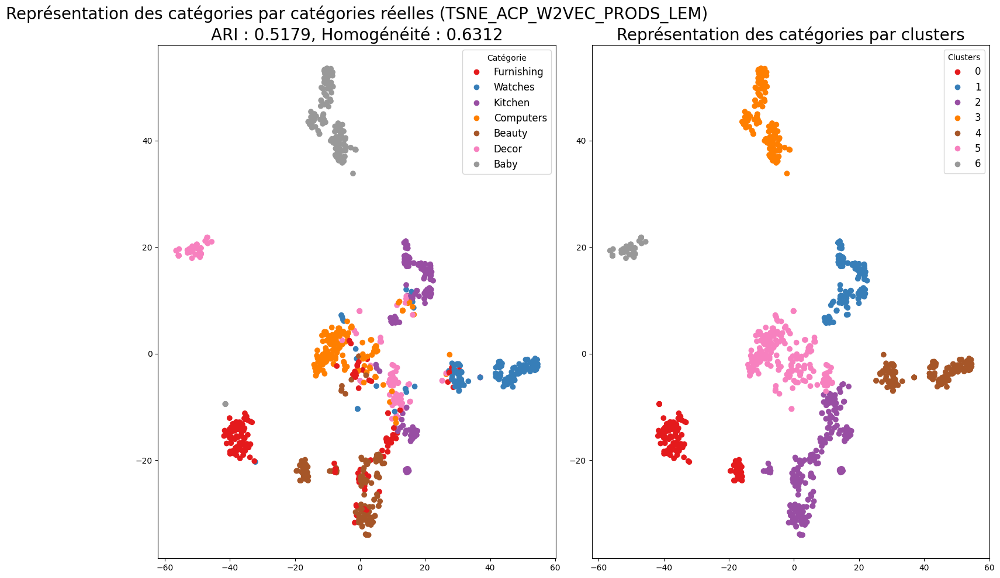

In [109]:
title = 'TSNE_ACP_W2VEC_PRODS_LEM'
df_w2v_prods_lem_acp = fonctions_data.acp(df_w2v_prods_lem)
df_w2v_prods_lem_acp_tsne = fonctions_data.tsne(df_w2v_prods_lem_acp, 40)
df_w2v_prods_lem_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_w2v_prods_lem_acp_tsne, data_cat)  
fonctions_data.affiche_projection_par_clusters(df_w2v_prods_lem_acp_tsne_km, labels, ARI, Homogeneite, title)

- Le score ARI est assez bon (0.52), ainsi que le degré d'homogénéité (0.663)
- La combinaison Word2Vec + TfIdfVectorizer + ACP + description + lemmatisés , ne parvient pas exactement à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (74%).

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,0.674603,0.566667,0.615942,150.00
1,0.908451,0.860000,0.883562,150.00
2,0.851240,0.686667,0.760148,150.00
3,0.618182,0.906667,0.735135,150.00
4,0.472973,0.700000,0.564516,150.00
5,1.000000,0.493333,0.660714,150.00
6,1.000000,0.966667,0.983051,150.00
accuracy,0.740000,0.740000,0.740000,0.74
macro avg,0.789350,0.740000,0.743295,1050.00
weighted avg,0.789350,0.740000,0.743295,1050.00


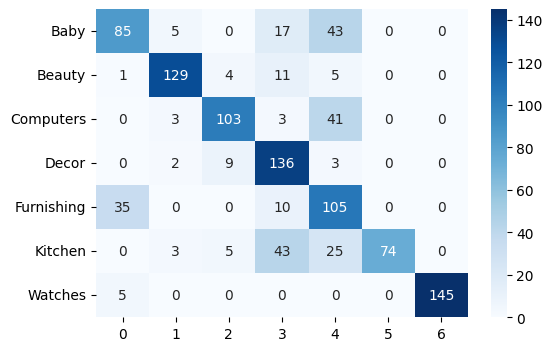

In [110]:
fonctions_data.conf_mat_metrics(df_w2v_prods_lem_acp_tsne_km)

**Word2Vec avec Skip gram**

In [111]:
# Instanciation du modèle
w2v_model_prods_lem = Word2Vec(data_token, vector_size=300, window=5, min_count=1, workers=4, sg = 1)
# Construit le vocabulaire à partir d'une séquence de mots et
# initialise ainsi le modèle.
w2v_model_prods_lem.build_vocab(data_token,
                               progress_per=10000)
# Entraînement du modèle
w2v_model_prods_lem.train(data_token,
                         total_examples=w2v_model_prods_lem.corpus_count,
                         epochs=30, report_delay=1)

(851997, 1800000)

In [113]:
# Vectorisation
vector_w2v_prods_lem = fonctions_data.word2vec_vectorisation(data_vec,
                                                        text_dim,
                                                        w2v_model_prods_lem)
# Dataframe pour réduction de dimension
df_w2v_prods_lem = pd.DataFrame(vector_w2v_prods_lem)

In [114]:
df_w2v_prods_lem_acp = fonctions_data.acp(df_w2v_prods_lem)
df_w2v_prods_lem_acp_tsne = fonctions_data.tsne(df_w2v_prods_lem_acp, 40)
df_w2v_prods_lem_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_w2v_prods_lem_acp_tsne, data_cat)  

Nombre de features après réduction ACP pour 99.0% de variance : 40
-----------------------------------------
 ARI  : 0.6344
 Homogénéité  : 0.7403
-----------------------------------------


**produit_specifications** - racinisée

In [115]:
# Description Lemmatisée word2vec a besoin d'une liste de liste
data_vec = data_work['prod_spec_stem']
data_work['prod_spec_stem_token'] = \
    [word_tokenize(str(row)) for row in
     data_vec]
data_token = data_work['prod_spec_stem_token'].copy()

In [116]:
# Instanciation du modèle
w2v_model_prods_stem = Word2Vec(data_token, vector_size=300, window=5, min_count=1, workers=4)
# Construit le vocabulaire à partir d'une séquence de mots et
# initialise ainsi le modèle.
w2v_model_prods_stem.build_vocab(data_token,
                               progress_per=10000)
# Entraînement du modèle
w2v_model_prods_stem.train(data_token,
                         total_examples=w2v_model_prods_stem.corpus_count,
                         epochs=30, report_delay=1)

(849272, 1799700)

In [117]:
# Vectorisation
vector_w2v_prods_stem = fonctions_data.word2vec_vectorisation(data_vec,
                                                        text_dim,
                                                        w2v_model_prods_lem)
# Dataframe pour réduction de dimension
df_w2v_prods_stem = pd.DataFrame(vector_w2v_prods_stem)

Nombre de features après réduction ACP pour 99.0% de variance : 43
-----------------------------------------
 ARI  : 0.6121
 Homogénéité  : 0.7163
-----------------------------------------


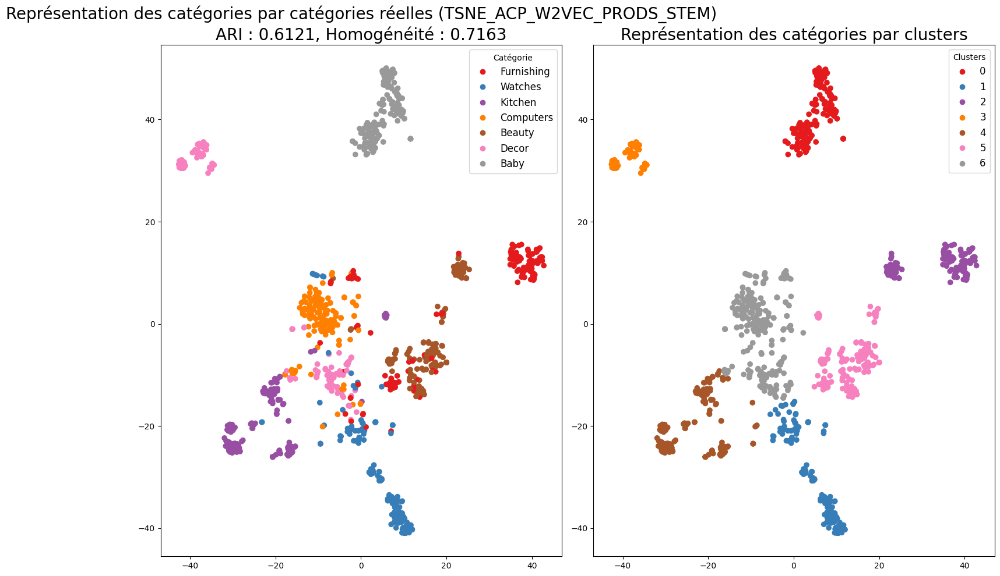

In [118]:
title = 'TSNE_ACP_W2VEC_PRODS_STEM'
df_w2v_prods_stem_acp = fonctions_data.acp(df_w2v_prods_stem)
df_w2v_prods_stem_acp_tsne = fonctions_data.tsne(df_w2v_prods_stem_acp, 40)
df_w2v_prods_stem_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_w2v_prods_stem_acp_tsne, data_cat)  
fonctions_data.affiche_projection_par_clusters(df_w2v_prods_stem_acp_tsne_km, labels, ARI, Homogeneite, title)

- Le score ARI est assez bon (0.61), ainsi que le degré d'homogénéité (0.716)
- La combinaison Word2Vec + TfIdfVectorizer + ACP + description + lemmatisés , ne parvient pas exactement à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (79%).

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,0.705882,0.560000,0.624535,150.000000
1,0.897260,0.873333,0.885135,150.000000
2,0.894737,0.906667,0.900662,150.000000
3,0.578947,0.953333,0.720403,150.000000
4,0.685185,0.740000,0.711538,150.000000
5,1.000000,0.493333,0.660714,150.000000
6,1.000000,1.000000,1.000000,150.000000
accuracy,0.789524,0.789524,0.789524,0.789524
macro avg,0.823145,0.789524,0.786141,1050.000000
weighted avg,0.823145,0.789524,0.786141,1050.000000


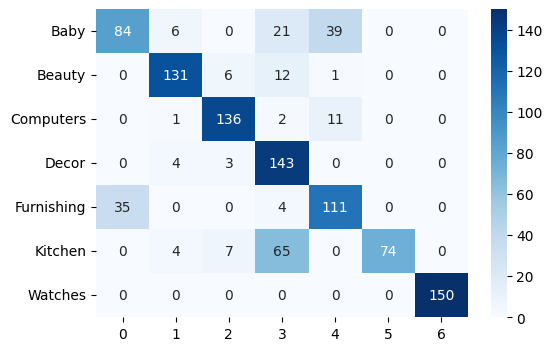

In [119]:
fonctions_data.conf_mat_metrics(df_w2v_prods_stem_acp_tsne_km)

**Word2Vec avec Skip gram**

In [120]:
# Instanciation du modèle
w2v_model_prods_stem = Word2Vec(data_token, vector_size=300, window=5, min_count=1, workers=4, sg = 1)
# Construit le vocabulaire à partir d'une séquence de mots et
# initialise ainsi le modèle.
w2v_model_prods_stem.build_vocab(data_token,
                               progress_per=10000)
# Entraînement du modèle
w2v_model_prods_stem.train(data_token,
                         total_examples=w2v_model_prods_stem.corpus_count,
                         epochs=30, report_delay=1)

(849954, 1799700)

In [121]:
# Vectorisation
vector_w2v_prods_stem =fonctions_data.word2vec_vectorisation(data_vec,
                                                        text_dim,
                                                        w2v_model_prods_stem)
# Dataframe pour réduction de dimension
df_w2v_prods_stem = pd.DataFrame(vector_w2v_prods_stem)

In [122]:
df_w2v_prods_stem_acp = fonctions_data.acp(df_w2v_prods_stem)
df_w2v_prods_stem_acp_tsne = fonctions_data.tsne(df_w2v_prods_stem_acp, 40)
df_w2v_prods_stem_acp_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_w2v_prods_stem_acp_tsne, data_cat)  

Nombre de features après réduction ACP pour 99.0% de variance : 40
-----------------------------------------
 ARI  : 0.6071
 Homogénéité  : 0.7197
-----------------------------------------


### <span style='background:orange'>4.4. BERT</span>

**nom_produit** - brut

In [208]:
# Variable dont on veut extraire les features
data_work['product_name'] = \
    data_work['product_name'].fillna('').astype(str)
df_pname = data_work['product_name']

**Modélisation**

In [209]:
# Instanciation du modèle
bert_pname = SentenceTransformer('roberta-large')
# Encodage
vector_roberta_pname = \
    bert_pname.encode(df_pname, show_progress_bar=False)

Some weights of RobertaModel were not initialized from the model checkpoint at C:\Users\yanni/.cache\torch\sentence_transformers\roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [210]:
vector_roberta_pname

array([[ 0.02632075, -0.01798778, -0.41005176, ..., -0.02043196,
         0.06263011,  0.10622946],
       [-0.02048348, -0.02765791, -0.33608183, ...,  0.08561511,
         0.08903083,  0.0429517 ],
       [ 0.01000335, -0.02403259, -0.39179373, ...,  0.04039324,
         0.14689721,  0.03684083],
       ...,
       [ 0.19458081, -0.06444005, -0.31950793, ...,  0.08140856,
         0.05041226,  0.06334802],
       [ 0.12979262, -0.06283251, -0.3203022 , ..., -0.0780363 ,
         0.09259146,  0.11677026],
       [ 0.10915783, -0.03143369, -0.2482375 , ...,  0.0237981 ,
         0.07390513,  0.04089151]], dtype=float32)

In [211]:
# Dataframe pour réduction de dimension
df_vector_bert_pname = pd.DataFrame(vector_roberta_pname)

df_vector_bert_pname_acp = fonctions_data.acp(df_vector_bert_pname)
tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_bert_tf_pname = tsne_red.fit_transform(df_vector_bert_pname_acp)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_bert_tf_pname.shape[1]+1, 1)]
df_bert_pname_tf_tsne = pd.DataFrame(X_tsne_bert_tf_pname, index=data_work.index, columns=columns)

Nombre de features après réduction ACP pour 99.0% de variance : 463


-----------------------------------------
 ARI  : 0.5242
 Homogénéité  : 0.5993
-----------------------------------------


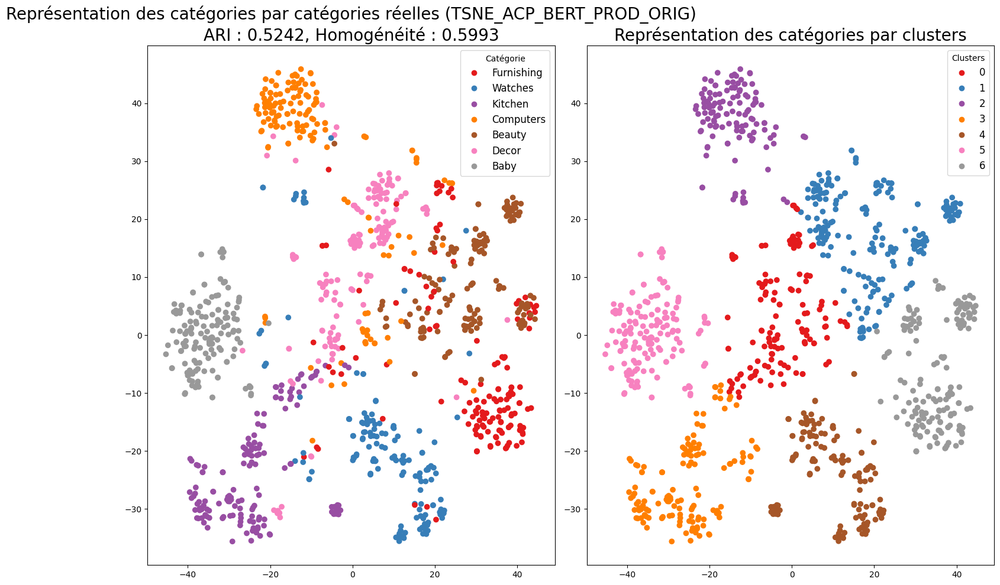

In [212]:
title = 'TSNE_ACP_BERT_PROD_ORIG'

df_bert_pname_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_bert_pname_tf_tsne, data_cat) 
fonctions_data.affiche_projection_par_clusters(df_bert_pname_tf_tsne_km, labels, ARI, Homogeneite, title)

- Le score ARI est assez bon (0.52), ainsi que le degré d'homogénéité (0.59)
- La combinaison Bert + TfIdfVectorizer + ACP + nom_produit, ne parvient à exactement à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (72 %).

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,0.651899,0.686667,0.668831,150.00000
1,0.872180,0.773333,0.819788,150.00000
2,0.861111,0.826667,0.843537,150.00000
3,0.849206,0.713333,0.775362,150.00000
4,0.444444,0.586667,0.505747,150.00000
5,0.545455,0.480000,0.510638,150.00000
6,0.943396,1.000000,0.970874,150.00000
accuracy,0.723810,0.723810,0.723810,0.72381
macro avg,0.738242,0.723810,0.727825,1050.00000
weighted avg,0.738242,0.723810,0.727825,1050.00000


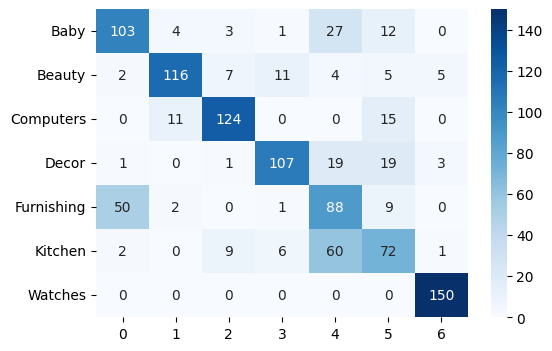

In [213]:
fonctions_data.conf_mat_metrics(df_bert_pname_tf_tsne_km)

**description** - lemmatisée

In [136]:
# Variable dont on veut extraire les features
data_work['desc_lem'] = \
    data_work['desc_lem'].fillna('').astype(str)
df_desc_lem = data_work['desc_lem']

**Modelisation**

In [137]:
# Instanciation du modèle
bert_desc_lem = SentenceTransformer('roberta-large')
# Encodage
vector_roberta_desc_lem = \
    bert_desc_lem.encode(df_desc_lem, show_progress_bar=False)

No sentence-transformers model found with name C:\Users\yanni/.cache\torch\sentence_transformers\roberta-large. Creating a new one with MEAN pooling.
Some weights of RobertaModel were not initialized from the model checkpoint at C:\Users\yanni/.cache\torch\sentence_transformers\roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [138]:
vector_roberta_desc_lem

array([[ 0.13219593,  0.13296142, -0.16766298, ..., -0.03023243,
         0.21516581,  0.22969559],
       [ 0.06780027,  0.04406194, -0.2635082 , ...,  0.10796814,
         0.32131448,  0.2160854 ],
       [ 0.09092533,  0.06303669, -0.23283333, ...,  0.12606661,
         0.24960145,  0.3056344 ],
       ...,
       [ 0.16384974, -0.03307249, -0.3026373 , ...,  0.19631582,
        -0.04838611, -0.02835465],
       [ 0.13173246, -0.00418322, -0.23444536, ...,  0.12524909,
         0.11137257, -0.03057999],
       [ 0.10344062,  0.02197616, -0.2601143 , ...,  0.109731  ,
        -0.00935114, -0.06204622]], dtype=float32)

In [140]:
# Dataframe pour réduction de dimension
df_vector_bert_desc_lem = pd.DataFrame(vector_roberta_desc_lem)

df_vector_bert_desc_lem_acp = fonctions_data.acp(df_vector_bert_desc_lem)
tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_bert_tf_desc_lem = tsne_red.fit_transform(df_vector_bert_desc_lem_acp)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_bert_tf_desc_lem.shape[1]+1, 1)]
df_bert_desc_lem_tf_tsne = pd.DataFrame(X_tsne_bert_tf_desc_lem, index=data_work.index, columns=columns)

Nombre de features après réduction ACP pour 99.0% de variance : 369


-----------------------------------------
 ARI  : 0.391
 Homogénéité  : 0.5182
-----------------------------------------


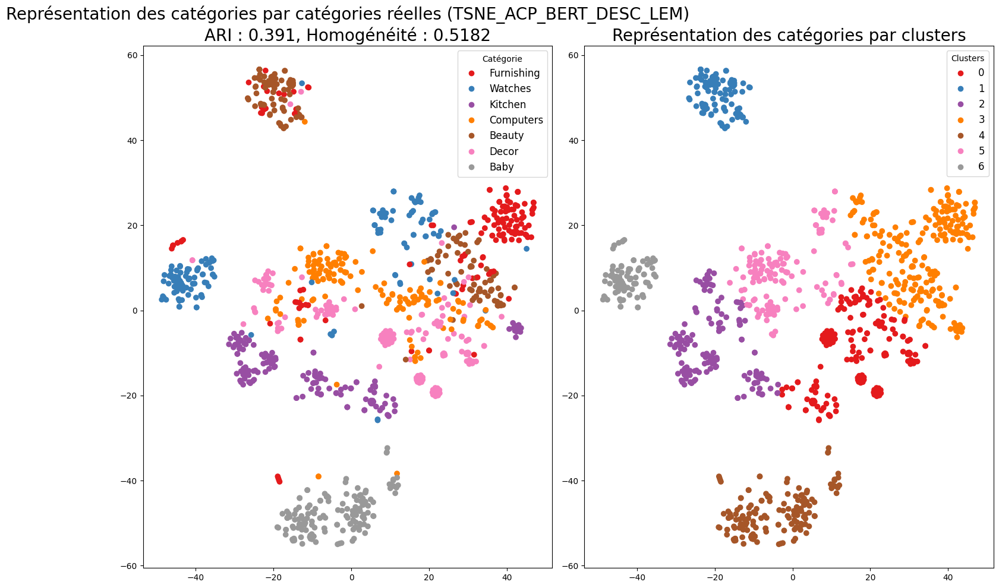

In [148]:
title = 'TSNE_ACP_BERT_DESC_LEM'

df_bert_desc_lem_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_bert_desc_lem_tf_tsne, data_cat) 
fonctions_data.affiche_projection_par_clusters(df_bert_desc_lem_tf_tsne_km, labels, ARI, Homogeneite, title)

**produit_specifications** - lemmatisée

In [142]:
# Variable dont on veut extraire les features
data_work['prod_spec_lem'] = \
    data_work['prod_spec_lem'].fillna('').astype(str)
df_prods_lem = data_work['prod_spec_lem']

**Modélisation**

In [143]:
# Instanciation du modèle
bert_prods_lem = SentenceTransformer('roberta-large')
# Encodage
vector_roberta_prods_lem = \
    bert_prods_lem.encode(df_prods_lem, show_progress_bar=False)

No sentence-transformers model found with name C:\Users\yanni/.cache\torch\sentence_transformers\roberta-large. Creating a new one with MEAN pooling.
Some weights of RobertaModel were not initialized from the model checkpoint at C:\Users\yanni/.cache\torch\sentence_transformers\roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [144]:
vector_roberta_prods_lem

array([[ 0.23720412, -0.20199165, -0.14418574, ..., -0.12327318,
         0.0381667 ,  0.10098483],
       [ 0.13280065, -0.12202819, -0.25144374, ...,  0.03208804,
         0.09513631,  0.10217821],
       [ 0.17613137, -0.1258876 , -0.26937947, ..., -0.01436785,
         0.03875981,  0.17766756],
       ...,
       [ 0.30604035, -0.03538117, -0.23064789, ..., -0.08283453,
         0.14643477,  0.1700236 ],
       [ 0.23717573, -0.07844844, -0.19513683, ..., -0.10321238,
         0.1833131 ,  0.19972135],
       [ 0.3039556 , -0.03547793, -0.23775563, ..., -0.07354901,
        -0.00743082,  0.07031865]], dtype=float32)

In [145]:
# Dataframe pour réduction de dimension
df_vector_bert_prods_lem = pd.DataFrame(vector_roberta_prods_lem)

df_vector_bert_prods_lem_acp = fonctions_data.acp(df_vector_bert_prods_lem)

tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_bert_tf_prods_lem = tsne_red.fit_transform(df_vector_bert_prods_lem_acp)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_bert_tf_prods_lem.shape[1]+1, 1)]
df_bert_prods_lem_tf_tsne = pd.DataFrame(X_tsne_bert_tf_prods_lem, index=data_work.index, columns=columns)

Nombre de features après réduction ACP pour 99.0% de variance : 328


-----------------------------------------
 ARI  : 0.5683
 Homogénéité  : 0.6724
-----------------------------------------


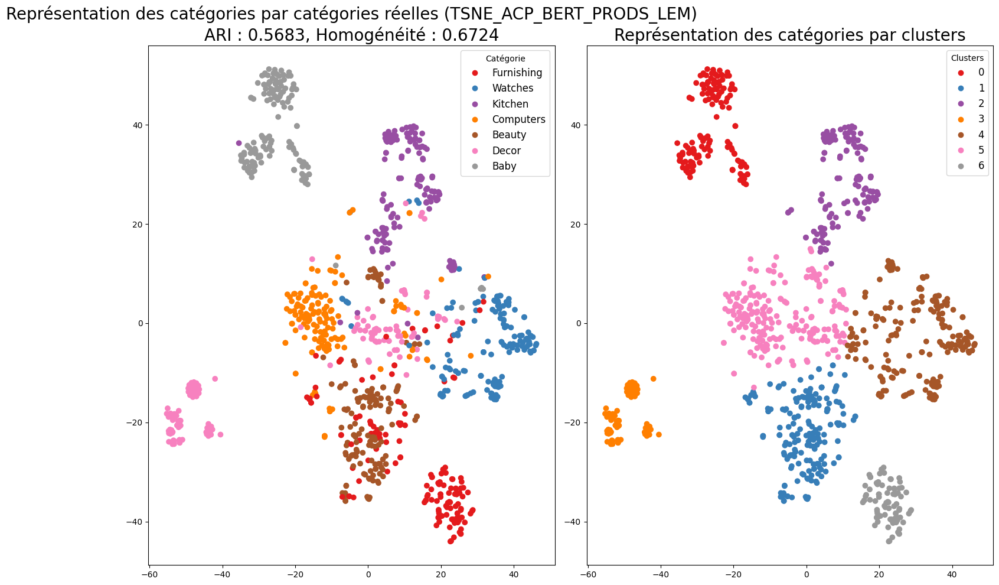

In [147]:
title = 'TSNE_ACP_BERT_PRODS_LEM'
df_bert_prods_lem_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_bert_prods_lem_tf_tsne, data_cat) 
fonctions_data.affiche_projection_par_clusters(df_bert_prods_lem_tf_tsne_km, labels, ARI, Homogeneite, title)

**produit_specifications** - racinisée

In [149]:
# Variable dont on veut extraire les features
data_work['prod_spec_stem'] = \
    data_work['prod_spec_stem'].fillna('').astype(str)
df_prods_stem = data_work['prod_spec_stem']

**Modélisation**

In [150]:
# Instanciation du modèle
bert_prods_stem = SentenceTransformer('roberta-large')
# Encodage
vector_roberta_prods_stem = \
    bert_prods_stem.encode(df_prods_stem, show_progress_bar=False)

No sentence-transformers model found with name C:\Users\yanni/.cache\torch\sentence_transformers\roberta-large. Creating a new one with MEAN pooling.
Some weights of RobertaModel were not initialized from the model checkpoint at C:\Users\yanni/.cache\torch\sentence_transformers\roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [151]:
vector_roberta_prods_stem

array([[ 0.1711503 , -0.19407022, -0.13797437, ...,  0.08570353,
         0.19117   ,  0.16879429],
       [ 0.13674174, -0.1645638 , -0.16638348, ...,  0.19445874,
         0.21972704,  0.18423295],
       [ 0.20943993, -0.16969097, -0.22600903, ...,  0.17844562,
         0.20841314,  0.19421141],
       ...,
       [ 0.2292815 , -0.1813185 , -0.19545901, ...,  0.1064876 ,
         0.23404373,  0.18335947],
       [ 0.1788721 , -0.18727893, -0.16460164, ...,  0.0953389 ,
         0.25018314,  0.19246055],
       [ 0.27091256, -0.18354705, -0.14472236, ...,  0.03473605,
         0.09458712,  0.17482321]], dtype=float32)

In [152]:
# Dataframe pour réduction de dimension
df_vector_bert_prods_stem = pd.DataFrame(vector_roberta_prods_stem)

df_vector_bert_prods_stem_acp = fonctions_data.acp(df_vector_bert_prods_stem)

tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_bert_tf_prods_stem = tsne_red.fit_transform(df_vector_bert_prods_stem_acp)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_bert_tf_prods_stem.shape[1]+1, 1)]
df_bert_prods_stem_tf_tsne = pd.DataFrame(X_tsne_bert_tf_prods_stem, index=data_work.index, columns=columns)

Nombre de features après réduction ACP pour 99.0% de variance : 336


-----------------------------------------
 ARI  : 0.508
 Homogénéité  : 0.6114
-----------------------------------------


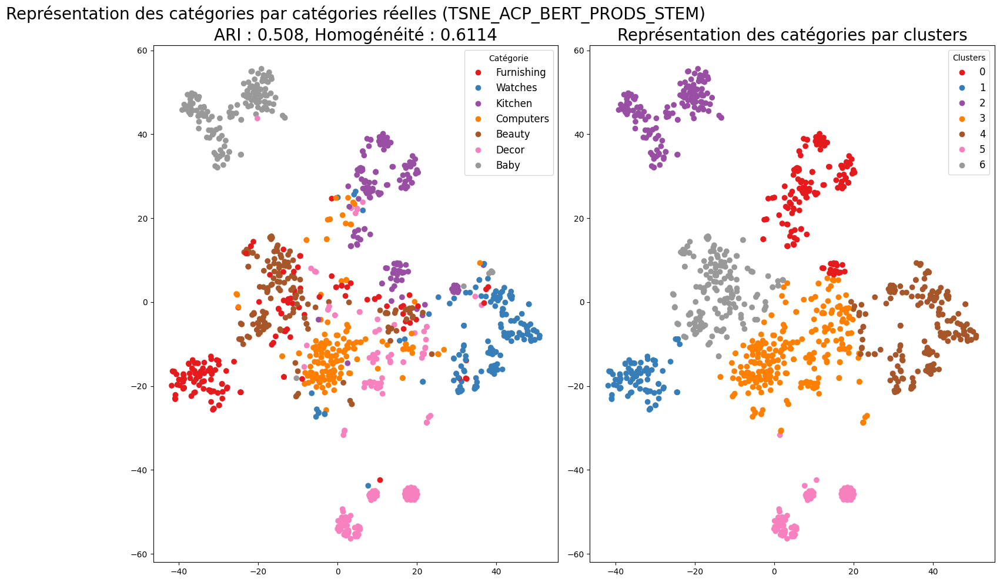

In [153]:
title = 'TSNE_ACP_BERT_PRODS_STEM'
df_bert_prods_stem_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_bert_prods_stem_tf_tsne, data_cat) 
fonctions_data.affiche_projection_par_clusters(df_bert_prods_stem_tf_tsne_km, labels, ARI, Homogeneite, title)

### <span style='background:orange'>4.5. USE</span>

**description** - lemmatisée

In [157]:
# Suppression des waring, info
tf.get_logger().setLevel('ERROR')

In [160]:
use_module_url = 'https://tfhub.dev/google/universal-sentence-encoder/3'

**Modelisation**

In [161]:
# Chargement du modèle
use_model_prod_orig = hub.load(use_module_url)
print('Module %s Chargé' % use_module_url)

Module https://tfhub.dev/google/universal-sentence-encoder/3 Chargé


In [190]:
vector_use_desc_lem = use_model_prod_orig(df_desc_lem)

In [193]:
vector_use_desc_lem_outputs = vector_use_desc_lem['outputs'].numpy()
vector_use_desc_lem_outputs

array([[-0.05436435, -0.05044528,  0.01847512, ...,  0.041538  ,
         0.05256531, -0.03384351],
       [-0.03168174, -0.02172026, -0.01253382, ...,  0.02603686,
         0.04548982,  0.03226286],
       [-0.05487311, -0.00230782, -0.033884  , ...,  0.04553097,
        -0.04454522, -0.04658087],
       ...,
       [-0.03667296, -0.06210892, -0.06787084, ...,  0.00351099,
        -0.02656717, -0.03408793],
       [-0.01628286, -0.05467406,  0.015009  , ...,  0.02106182,
        -0.01692948, -0.03201395],
       [-0.05165637, -0.04829301, -0.00482606, ...,  0.04193441,
        -0.0099245 , -0.01465913]], dtype=float32)

**Reduction de dimension (TSNE)**

In [194]:
# Dataframe pour réduction de dimension
df_vector_use_desc_lem_outputs = pd.DataFrame(vector_use_desc_lem_outputs)

df_vector_bert_desc_lem_acp = fonctions_data.acp(df_vector_use_desc_lem_outputs)

tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_use_tf_desc_lem = tsne_red.fit_transform(df_vector_bert_desc_lem_acp)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_use_tf_desc_lem.shape[1]+1, 1)]
df_use_desc_use_tf_tsne = pd.DataFrame(X_tsne_use_tf_desc_lem, index=data_work.index, columns=columns)

Nombre de features après réduction ACP pour 99.0% de variance : 320


-----------------------------------------
 ARI  : 0.4558
 Homogénéité  : 0.5838
-----------------------------------------


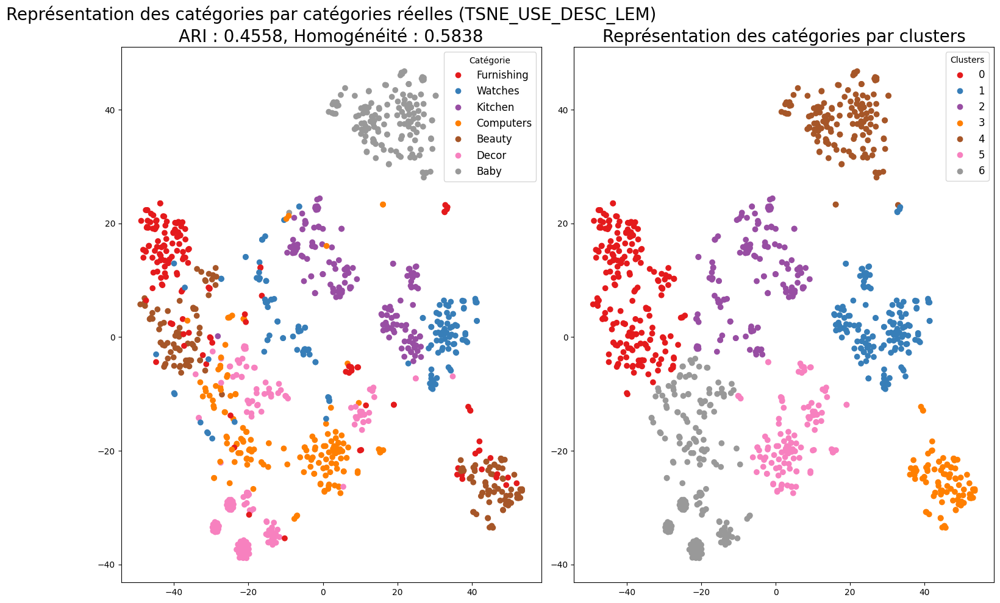

In [195]:
title = 'TSNE_USE_DESC_LEM'
df_use_desc_lem_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_use_desc_use_tf_tsne, data_cat) 
fonctions_data.affiche_projection_par_clusters(df_use_desc_lem_tf_tsne_km, labels, ARI, Homogeneite, title)

**description** - racinisée

In [309]:
vector_use_desc_stem = use_model_prod_orig(data_desc_stem)

**Reduction de dimension (TSNE)**

In [310]:
tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_use_tf_desc_stem = tsne_red.fit_transform(vector_use_desc_stem)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_use_tf_desc_stem.shape[1]+1, 1)]
df_use_desc_stem_tf_tsne = pd.DataFrame(X_tsne_use_tf_desc_stem, index=data_work.index, columns=columns)

In [312]:
title = 'TSNE_USE_DESC_STEM'
df_use_desc_stem_tf_tsne_km, ARI, Homogeneite, labels =  kmeans(df_use_desc_stem_tf_tsne, data_cat) 

-----------------------------------------
 ARI  : 0.4275
 Homogénéité  : 0.5654
-----------------------------------------


**description** - brut

In [333]:
vector_use_desc = use_model_prod_orig(data_work['description'])

**Reduction de dimension (TSNE)**

In [334]:
tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_use_tf_desc = tsne_red.fit_transform(vector_use_desc)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_use_tf_desc.shape[1]+1, 1)]
df_use_desc_tf_tsne = pd.DataFrame(X_tsne_use_tf_desc, index=data_work.index, columns=columns)

In [335]:
df_use_desc_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_use_desc_tf_tsne, data_cat) 

-----------------------------------------
 ARI  : 0.4467
 Homogénéité  : 0.5819
-----------------------------------------


**description** - brut

In [314]:
vector_use_desc = use_model_prod_orig(data_desc)

**Reduction de dimension (TSNE)**

In [315]:
tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_use_tf_desc = tsne_red.fit_transform(vector_use_desc)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_use_tf_desc.shape[1]+1, 1)]
df_use_desc_tf_tsne = pd.DataFrame(X_tsne_use_tf_desc, index=data_work.index, columns=columns)

In [316]:
#title = 'TSNE_USE_DESC_STEM'
df_use_desc_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_use_desc_tf_tsne, data_cat) 

-----------------------------------------
 ARI  : 0.4467
 Homogénéité  : 0.5819
-----------------------------------------


**nom_produit** - lemmatisée

In [317]:
vector_use_prod_lem = use_model_prod_orig(data_prod_lem)

**Reduction de dimension (TSNE)**

In [318]:
tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_use_tf_prod_lem = tsne_red.fit_transform(vector_use_prod_lem)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_use_tf_prod_lem.shape[1]+1, 1)]
df_use_prod_lem_tf_tsne = pd.DataFrame(X_tsne_use_tf_prod_lem, index=data_work.index, columns=columns)

In [319]:
df_use_prod_lem_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_use_prod_lem_tf_tsne, data_cat) 

-----------------------------------------
 ARI  : 0.579
 Homogénéité  : 0.6429
-----------------------------------------


**nom_produit** - racinisée

In [320]:
vector_use_prod_stem = use_model_prod_orig(data_prod_stem)

**Reduction de dimension (TSNE)**

In [321]:
tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_use_tf_prod_stem = tsne_red.fit_transform(vector_use_prod_stem)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_use_tf_prod_stem.shape[1]+1, 1)]
df_use_prod_stem_tf_tsne = pd.DataFrame(X_tsne_use_tf_prod_stem, index=data_work.index, columns=columns)

In [322]:
df_use_prod_stem_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_use_prod_stem_tf_tsne, data_cat) 

-----------------------------------------
 ARI  : 0.5915
 Homogénéité  : 0.6284
-----------------------------------------


**nom_produit** - nettoyé

In [327]:
vector_use_prod_cl = use_model_prod_orig(data_work['pname_clean'])

**Reduction de dimension (TSNE)**

In [328]:
tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_use_tf_prod_cl = tsne_red.fit_transform(vector_use_prod_cl)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_use_tf_prod_cl.shape[1]+1, 1)]
df_use_prod_cl_tf_tsne = pd.DataFrame(X_tsne_use_tf_prod_cl, index=data_work.index, columns=columns)

In [329]:
df_use_prod_cl_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_use_prod_cl_tf_tsne, data_cat) 

-----------------------------------------
 ARI  : 0.579
 Homogénéité  : 0.6429
-----------------------------------------


**nom_produit** - brut

In [196]:
vector_use_prod = use_model_prod_orig(data_work['product_name'])

In [198]:
vector_use_prod_outputs = vector_use_prod['outputs'].numpy()
vector_use_prod_outputs

array([[ 0.05646455, -0.0166991 , -0.0370861 , ..., -0.01305964,
         0.04983915,  0.06384217],
       [ 0.00599405,  0.05433533, -0.00869234, ..., -0.00258876,
         0.06814882,  0.02568774],
       [ 0.02507095,  0.00259155, -0.0042601 , ..., -0.00587555,
         0.05306112, -0.00711143],
       ...,
       [ 0.05488612,  0.05462695,  0.03137715, ..., -0.03242321,
         0.07352425, -0.06536923],
       [ 0.05647468,  0.03322315,  0.0616175 , ..., -0.02976299,
        -0.01674185, -0.0215883 ],
       [ 0.01983393,  0.06305396,  0.07477679, ..., -0.006964  ,
        -0.02285352, -0.01964251]], dtype=float32)

**Reduction de dimension (TSNE)**

In [199]:
# Dataframe pour réduction de dimension
df_vector_use_prod_outputs = pd.DataFrame(vector_use_prod_outputs)

df_vector_bert_prod_acp = acp(df_vector_use_prod_outputs)

tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_use_tf_prod = tsne_red.fit_transform(df_vector_bert_prod_acp)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_use_tf_prod.shape[1]+1, 1)]
df_use_prod_tf_tsne = pd.DataFrame(X_tsne_use_tf_prod, index=data_work.index, columns=columns)

Nombre de features après réduction ACP pour 99.0% de variance : 301


-----------------------------------------
 ARI  : 0.7071
 Homogénéité  : 0.7503
-----------------------------------------


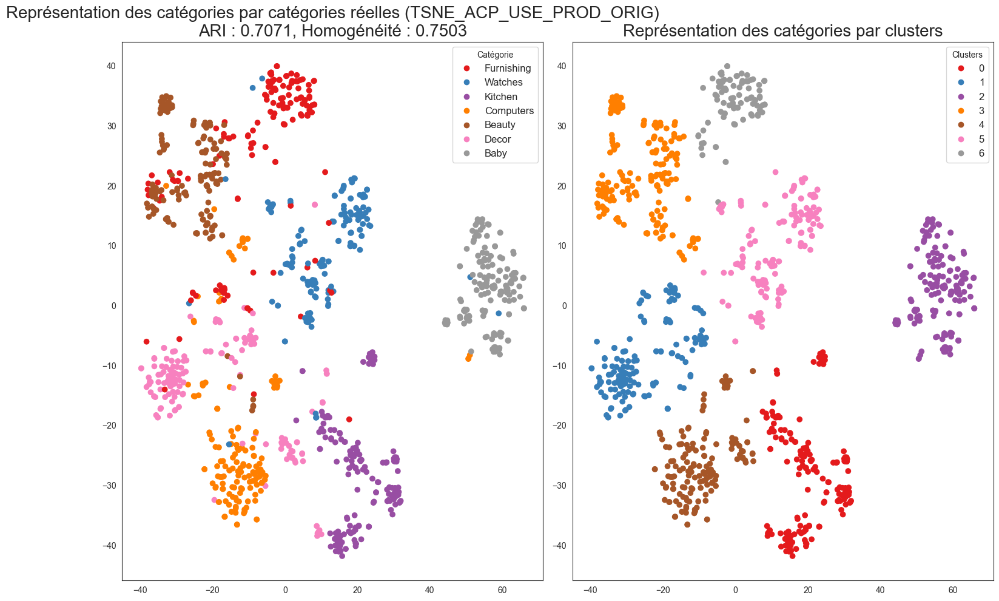

In [459]:
title = 'TSNE_ACP_USE_PROD_ORIG'
df_use_prod_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_use_prod_tf_tsne, data_cat) 
fonctions_data.affiche_projection_par_clusters(df_use_prod_tf_tsne_km, labels, ARI, Homogeneite, title)

- Le score ARI est très bon (**0.71**), ainsi que le degré d'homogénéité (**0.75**)
- La combinaison **USE + TfIdfVectorizer + ACP + nom_produit + original**, parvient à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (85%).

Clusters,Nombre,%
0,164,15.620000
1,152,14.480000
2,155,14.760000
3,187,17.810000
4,149,14.190000
5,151,14.380000
6,92,8.760000


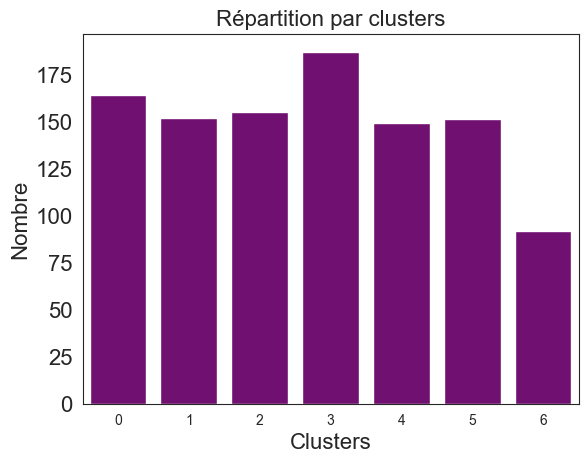

In [460]:
fonctions_data.affiche_repartition_par_clusters(labels)

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,0.967391,0.593333,0.735537,150.000000
1,0.926667,0.926667,0.926667,150.000000
2,0.896341,0.980000,0.936306,150.000000
3,0.763514,0.753333,0.758389,150.000000
4,0.765957,0.960000,0.852071,150.000000
5,0.712418,0.726667,0.719472,150.000000
6,0.967742,1.000000,0.983607,150.000000
accuracy,0.848571,0.848571,0.848571,0.848571
macro avg,0.857147,0.848571,0.844578,1050.000000
weighted avg,0.857147,0.848571,0.844578,1050.000000


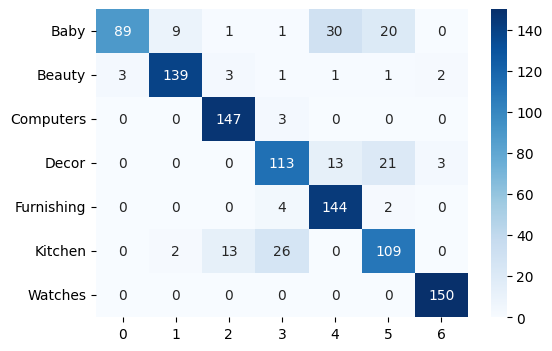

In [340]:
fonctions_data.conf_mat_metrics(df_use_prod_tf_tsne_km)

**produit_specifications** - lemmatisée

**Modelisation**

In [204]:
vector_use_prods_lem = use_model_prod_orig(df_prods_lem)

In [205]:
vector_use_prods_lem_outputs = vector_use_prods_lem['outputs'].numpy()
vector_use_prods_lem_outputs

array([[-0.02822893, -0.05866568, -0.02234631, ...,  0.03051771,
         0.02722263, -0.05520183],
       [-0.00571687, -0.05579138, -0.04014564, ...,  0.01834492,
        -0.03161055, -0.05485104],
       [-0.01173704, -0.05631636, -0.0303089 , ..., -0.01738444,
        -0.01790421, -0.05552733],
       ...,
       [-0.04879308, -0.05809372, -0.04506187, ..., -0.01770598,
        -0.04770849, -0.05779939],
       [-0.05273878, -0.05523444, -0.04375966, ..., -0.03739665,
        -0.02708524, -0.05505388],
       [-0.02401044, -0.06926043, -0.03277843, ..., -0.03027704,
        -0.01612329, -0.0470394 ]], dtype=float32)

**Reduction de dimension (TSNE)**

In [206]:
# Dataframe pour réduction de dimension
df_vector_use_prods_lem_outputs = pd.DataFrame(vector_use_prods_lem_outputs)

df_vector_bert_prods_lem_acp = fonctions_data.acp(df_vector_use_prods_lem_outputs)

tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_use_tf_prods_lem = tsne_red.fit_transform(df_vector_bert_prods_lem_acp)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_use_tf_prods_lem.shape[1]+1, 1)]
df_use_prods_use_tf_tsne = pd.DataFrame(X_tsne_use_tf_prods_lem, index=data_work.index, columns=columns)

Nombre de features après réduction ACP pour 99.0% de variance : 261


-----------------------------------------
 ARI  : 0.6375
 Homogénéité  : 0.7136
-----------------------------------------


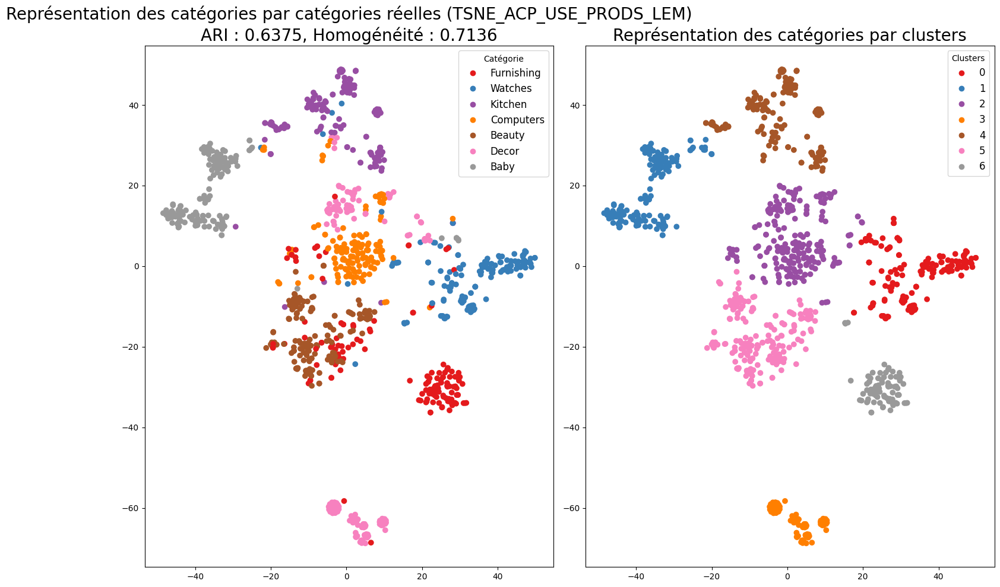

In [207]:
title = 'TSNE_ACP_USE_PRODS_LEM'
df_use_prods_lem_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_use_prods_use_tf_tsne, data_cat) 
fonctions_data.affiche_projection_par_clusters(df_use_prods_lem_tf_tsne_km, labels, ARI, Homogeneite, title)

- Le score ARI est assez bon (0.64), ainsi que le degré d'homogénéité (0.71)
- La combinaison Word2Vec + TfIdfVectorizer + ACP + description + lemmatisés , parvient à peu près à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (81%).

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,0.943182,0.553333,0.697479,150.000000
1,0.840764,0.880000,0.859935,150.000000
2,0.902597,0.926667,0.914474,150.000000
3,0.588496,0.886667,0.707447,150.000000
4,0.746193,0.980000,0.847262,150.000000
5,0.973684,0.493333,0.654867,150.000000
6,0.940789,0.953333,0.947020,150.000000
accuracy,0.810476,0.810476,0.810476,0.810476
macro avg,0.847958,0.810476,0.804069,1050.000000
weighted avg,0.847958,0.810476,0.804069,1050.000000


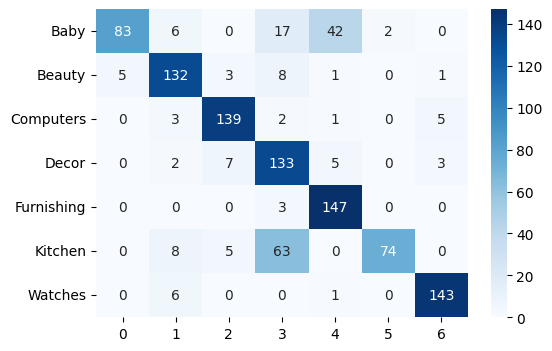

In [187]:
fonctions_data.conf_mat_metrics(df_use_prods_lem_tf_tsne_km)

**produit_specifications** - racinisée

**Modélisation**

In [183]:
vector_use_prods_stem = use_model_prod_orig(df_prods_stem)

In [184]:
vector_use_prods_stem_outputs = vector_use_prods_stem['outputs'].numpy()
vector_use_prods_stem_outputs

array([[-0.06058725, -0.06253048, -0.00987435, ..., -0.04779598,
         0.04090021, -0.05406416],
       [-0.05445528, -0.05512849, -0.00959209, ..., -0.04017502,
         0.02098398, -0.0502905 ],
       [-0.05538512, -0.05824359,  0.00124697, ..., -0.05235316,
         0.03564195, -0.05632622],
       ...,
       [-0.06246294, -0.06260453, -0.01501263, ..., -0.03743516,
        -0.04009168, -0.06115977],
       [-0.0585923 , -0.05816854, -0.00144888, ..., -0.03643528,
         0.01375531, -0.05596569],
       [-0.04108105, -0.0686003 , -0.00526175, ..., -0.0486479 ,
        -0.01494744, -0.03819256]], dtype=float32)

In [188]:
# Dataframe pour réduction de dimension
df_vector_use_prods_stem_outputs = pd.DataFrame(vector_use_prods_stem_outputs)

df_vector_bert_prods_stem_acp = fonctions_data.acp(df_vector_use_prods_stem_outputs)

tsne_red = TSNE(n_components=2, n_iter=2000, random_state=0, perplexity=30)
X_tsne_use_tf_prods_stem = tsne_red.fit_transform(vector_use_prods_stem_outputs)
    
columns = ['DIM' + str(c) for c in range(1, X_tsne_use_tf_prods_stem.shape[1]+1, 1)]
df_use_prods_use_tf_tsne = pd.DataFrame(X_tsne_use_tf_prods_stem, index=data_work.index, columns=columns)

Nombre de features après réduction ACP pour 99.0% de variance : 258


-----------------------------------------
 ARI  : 0.5896
 Homogénéité  : 0.713
-----------------------------------------


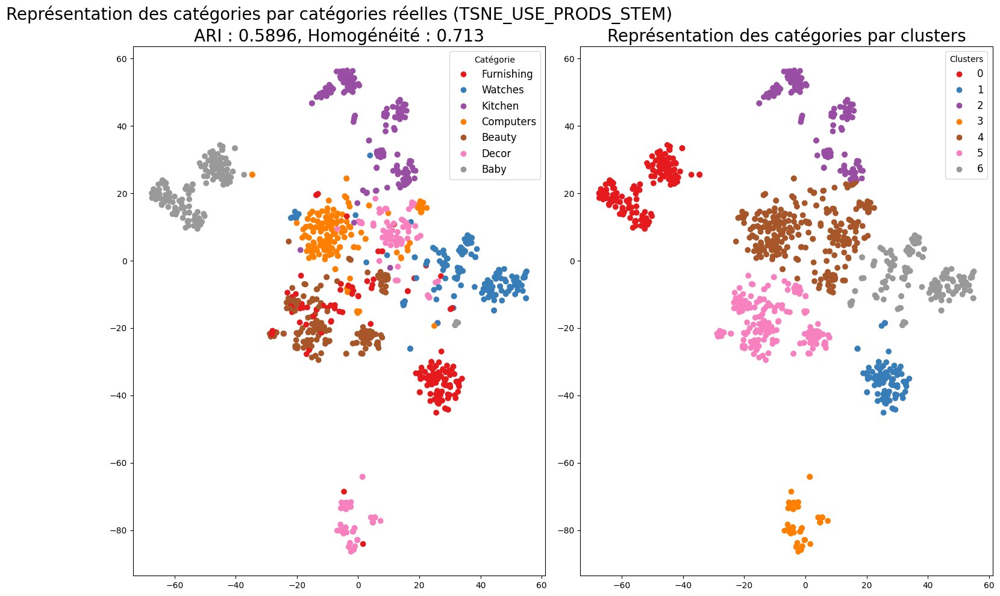

In [189]:
title = 'TSNE_USE_PRODS_STEM'
df_use_prods_stem_tf_tsne_km, ARI, Homogeneite, labels =  fonctions_data.kmeans(df_use_prods_use_tf_tsne, data_cat) 
fonctions_data.affiche_projection_par_clusters(df_use_prods_stem_tf_tsne_km, labels, ARI, Homogeneite, title)

- Le score ARI est assez bon (0.59), ainsi que le degré d'homogénéité (0.71)
- La combinaison Word2Vec + TfIdfVectorizer + ACP + description + lemmatisés , ne parvient pas exactement à retrouver les 7 catégories comme le souhaite notre client. Il reste à mesurer la qualité de cette catégorisation (79 %).

**Matrice de confusion (permutation groupes*Clusters) avec l'accuracy**

,precision,recall,f1-score,support
0,0.912088,0.553333,0.688797,150.000000
1,0.869281,0.886667,0.877888,150.000000
2,0.992308,0.860000,0.921429,150.000000
3,0.512915,0.926667,0.660333,150.000000
4,0.700000,0.840000,0.763636,150.000000
5,0.974359,0.506667,0.666667,150.000000
6,0.986395,0.966667,0.976431,150.000000
accuracy,0.791429,0.791429,0.791429,0.791429
macro avg,0.849621,0.791429,0.793597,1050.000000
weighted avg,0.849621,0.791429,0.793597,1050.000000


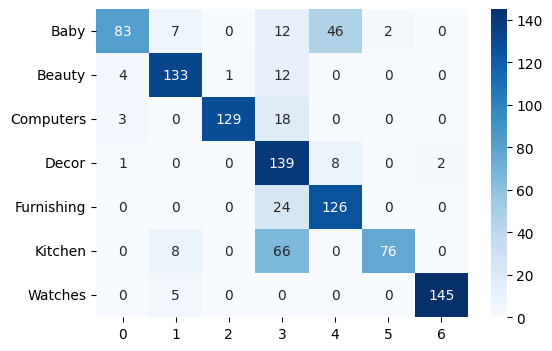

In [202]:
fonctions_data.conf_mat_metrics(df_use_prods_stem_tf_tsne_km)

**Bilan Classifiaction - Partie Texte (NLP)**

En se basant sur ‘product-name’, le meilleur résultat obtenu avec USE5 : ARI 0.70, accuracy 0.85

## <span style='background:PowderBlue'>5. IMAGES - Données Images</span>

### <span style='background:orange'>5.1. Analyse des données images</span>

In [109]:
data.head(2)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."


Ajout d'une nouvelle variable **image_loc** contenant le chemin du répertoire de stockage des images ainsi que du nom du fichier image 

In [262]:
path = 'Data/Flipkart/Images/'
data['image_loc'] = [path + row for row in data['image']]

**Récupération de la 1ère strate de catégorie**

In [263]:
# Découpe les sous-catégories dans des nouvelles variables du dataframe
work = data['product_category_tree'].str.split(' >> ', expand=True)
data['Categorie_1'] = work[0]
# Nettoye les [" et "]
data.replace('\\["', '', regex=True, inplace=True)
data.replace('"\\]', '', regex=True, inplace=True)

In [119]:
data.head(2)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,image_loc,Categorie_1
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,Home Furnishing >> Curtains & Accessories >> C...,CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Data/Flipkart/Images/55b85ea15a1536d46b7190ad6...,Home Furnishing
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,Baby Care >> Baby Bath & Skin >> Baby Bath Tow...,BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa...",Data/Flipkart/Images/7b72c92c2f6c40268628ec5f1...,Baby Care


**Dataframe spécifique pour traitement des images**

Pour la classifiaction des catégories, on gardera la variable **image**, **image_loc**, et **Categorie_1** 

In [264]:
data_imc = data.copy()
data_imc = data_imc[['product_name', 'image', 'image_loc', 'Categorie_1']]
data_imc.head(3)

,product_name,image,image_loc,Categorie_1
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Data/Flipkart/Images/55b85ea15a1536d46b7190ad6...,Home Furnishing
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Data/Flipkart/Images/7b72c92c2f6c40268628ec5f1...,Baby Care
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Data/Flipkart/Images/64d5d4a258243731dc7bbb1ee...,Baby Care


**Analyse exploratoire**

In [233]:
df_im_cat = data_imc.groupby('Categorie_1').agg({'image' : 'count'})
df_im_cat

,image
Categorie_1,
Baby Care,150
Beauty and Personal Care,150
Computers,150
Home Decor & Festive Needs,150
Home Furnishing,150
Kitchen & Dining,150
Watches,150


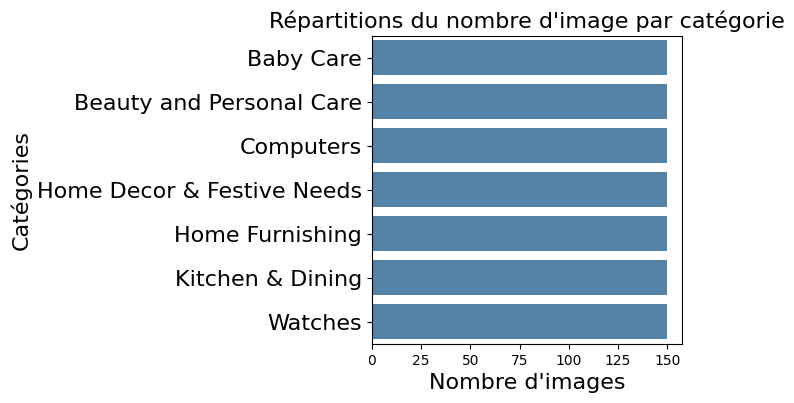

In [234]:
plt.figure(figsize=(4, 4))
sns.barplot(y=df_im_cat.index, x=df_im_cat.image,
            data=df_im_cat, color='SteelBlue')
plt.title('Répartitions du nombre d\'image par catégorie', fontsize=16)
plt.xlabel('Nombre d\'images', fontsize=16)
plt.ylabel('Catégories', fontsize=16)
plt.yticks(fontsize=16)
plt.grid(False)
plt.show()

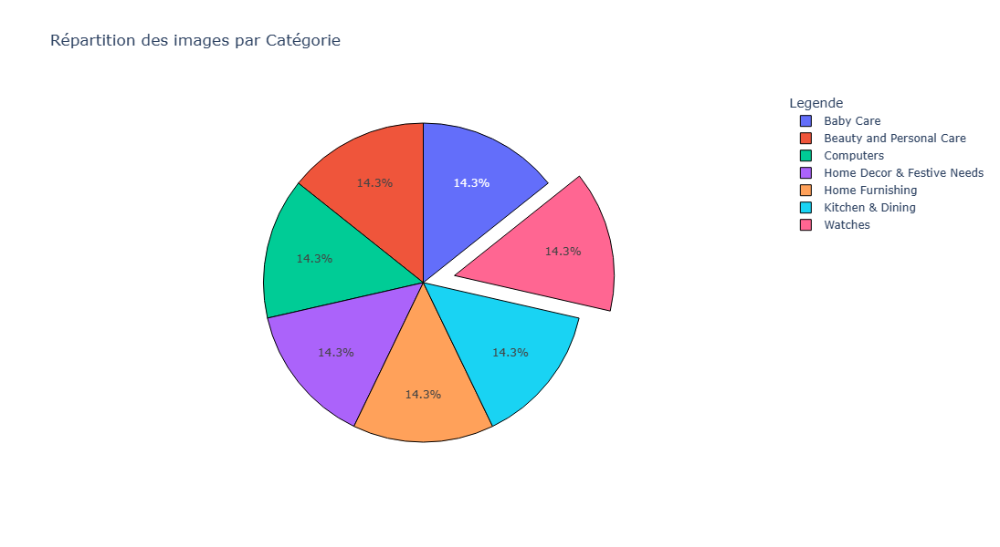

In [77]:
df_visu = df_im_cat.reset_index()
fonctions_data.trace_pieplot(df_visu, 'Categorie_1',
                          'Répartition des images par Catégorie',
                          'Legende', 6)

- Répartition équilibrée de 150 images

**Visualisation d'images**

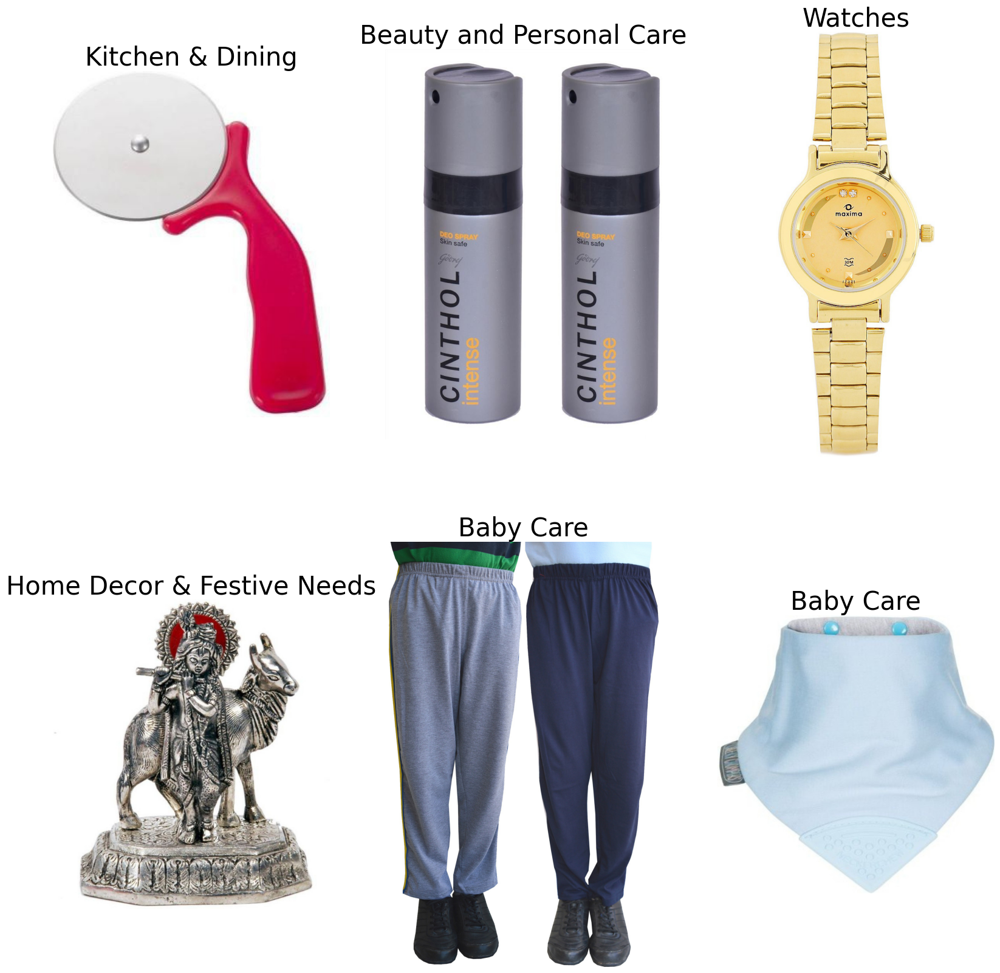

In [69]:
# Sélection de 6 images au hasard
df_visu_img = data.sample(6).reset_index()
plt.figure(figsize=(20, 20))
for i in range(6):
    plt.subplot(2, 3, i + 1)
    # Charge l'image comme matrice de pixels
    img = np.array(Image.open(df_visu_img['image_loc'][i]))
    plt.imshow(img)
    plt.title(df_visu_img['Categorie_1'][i], fontsize=30)
    plt.axis('off')

**Distribution sur le dimensionnement des images**

In [75]:
# Largeur des images
data_imc['Largeur_img'] = [Image.open(row).size[0] for row in data['image_loc']]
# Hauteur des images
data_imc['Hauteur_img'] = [Image.open(row).size[1] for row in data['image_loc']]
# Taille des images
data_imc['Taille_img'] = [(Image.open(row).size[0])*(Image.open(row).size[1]) for row in data['image_loc']]

In [78]:
# Statistiques descriptives
fonctions_data.stat_descriptives(data_imc, ['Taille_img', 'Largeur_img',
                                     'Hauteur_img'])

,Variable name,Mean,Median,Skew,Kurtosis,Variance,Stdev,min,25%,50%,75%,max
0,Taille_img,1.916300e+06,1015850.0,13.457143,289.371778,1.534575e+13,3.917365e+06,58000,672375.00,1015850.0,1553940.00,93680328
1,Largeur_img,1.196570e+03,1100.0,2.845790,11.646568,7.459176e+05,8.636652e+02,145,747.25,1100.0,1214.25,8484
2,Hauteur_img,1.220038e+03,1100.0,3.661225,31.760927,5.542603e+05,7.444866e+02,160,844.00,1100.0,1360.00,11042


**Distribution de la largeur, hauteur, et taille des images**

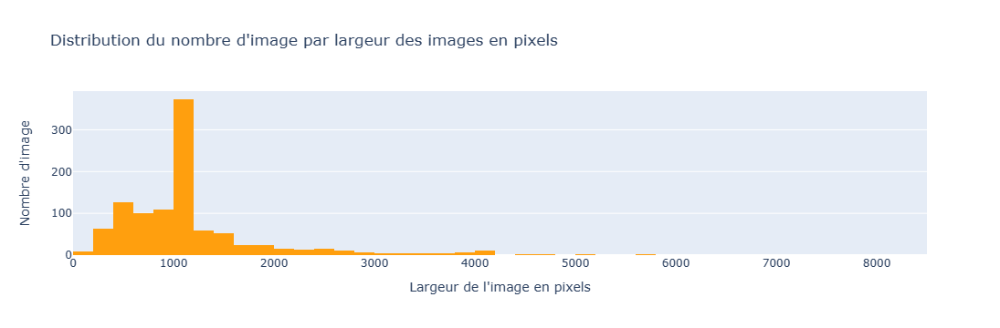

In [84]:
import plotly.express as px

# Répartition du nombre d'images par taille de l'image en pixel
fig = px.histogram(data_imc, x='Largeur_img', color_discrete_sequence=['#ff9f0e'], nbins=50, 
                   title='Distribution du nombre d\'image par largeur des images en pixels',
                   labels={'Largeur_img': 'Largeur de l\'image en pixels', 'count': 'Nombre d\'image'})
fig.update_layout(xaxis=dict(range=[0, 8500]), yaxis=dict(title='Nombre d\'image'), height=600)
fig.show()

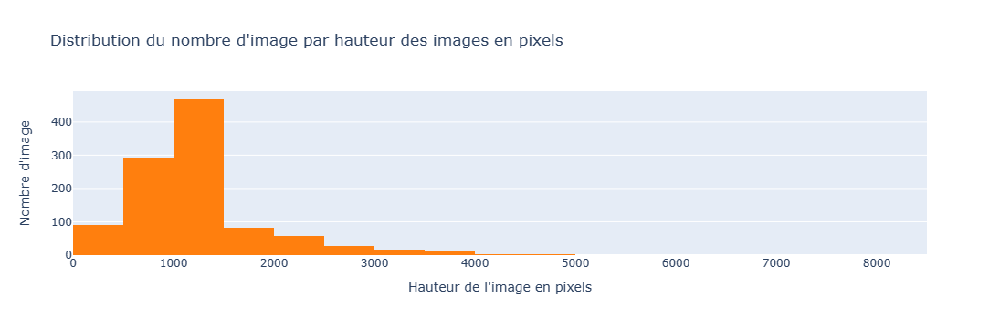

In [81]:
# Répartition du nombre d'images par taille de l'image en pixel
fig = px.histogram(data_imc, x='Hauteur_img', color_discrete_sequence=['#ff7f0e'], nbins=50, 
                   title='Distribution du nombre d\'image par hauteur des images en pixels',
                   labels={'Hauteur_img': 'Hauteur de l\'image en pixels', 'count': 'Nombre d\'image'})
fig.update_layout(xaxis=dict(range=[0, 8500]), yaxis=dict(title='Nombre d\'image'), height=600)
fig.show()

**Taille**

In [111]:
# Utilisation de la fonction pour obtenir les données
df_visu_taille = distribution_variables_plages(data_imc, 'Taille_img', [0, 500000, 1000000, 5000000, 10000000,
                         100000000])

In [112]:
df_visu_taille

,Plage,nb_données,%_données
0,"(0, 500000]",165,15.714286
1,"(500000, 1000000]",353,33.619048
2,"(1000000, 5000000]",447,42.571429
3,"(5000000, 10000000]",52,4.952381
4,"(10000000, 100000000]",33,3.142857


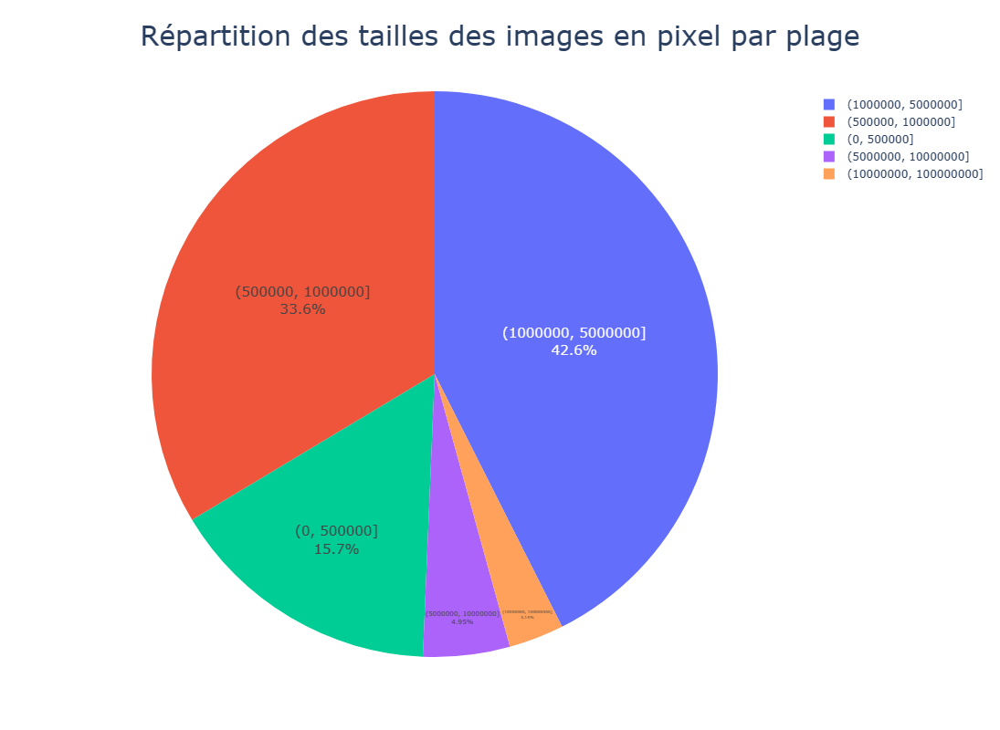

In [118]:
# Création du Pieplot avec Plotly
fig = px.pie(df_visu_taille, values='nb_données', names='Plage', title='Répartition des tailles des images en pixel par plage')

# Personnalisation de la mise en page
fig.update_layout(title_font_size=30, title_x=0.5)  # Ajustement de la taille et de la position du titre
fig.update_traces(textinfo='percent+label', textposition='inside', 
                  insidetextorientation='horizontal', textfont_size=15)  # Positionnement et formatage du texte

# Ajustement de la taille de la figure
fig.update_layout(height=800, width=1000)

fig.show()



### <span style='background:orange'>5.2. Pré-traitement images</span>

#### <span style='background:wheat'>5.2.1 Exemple image</span>

In [205]:
# Chargement de l'image originale comme matrice de pixels
img_orig = Image_PIL.open('Data/Flipkart/Images/fc93a41f31c4e997fbfcc5bd0a63ee65.jpg')

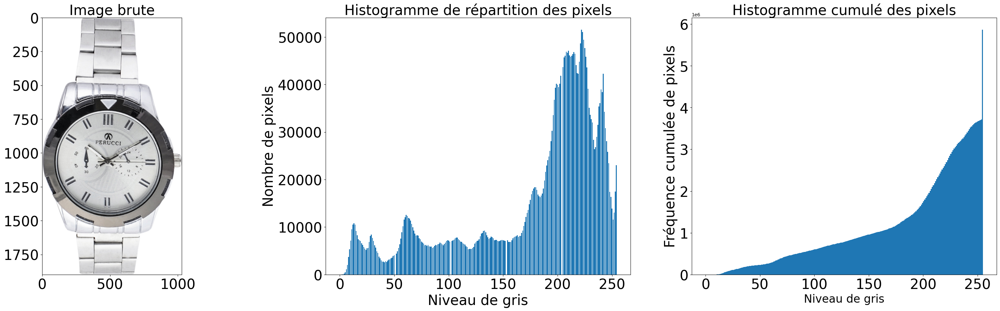

In [280]:
fonctions_data.display_image_histopixel(img_orig, 'Image brute')


**Correction de l'exposition (étirement d'histogramme)**

Image sur-exposée ==> histogramme concentré à droite vers les niveaux de gris faible (255 = blanc, image trop claire).   
Image sous-exposée ==> histogramme concentré à gauche vers les niveaux de gris fort (0 = noir, image trop sombre).

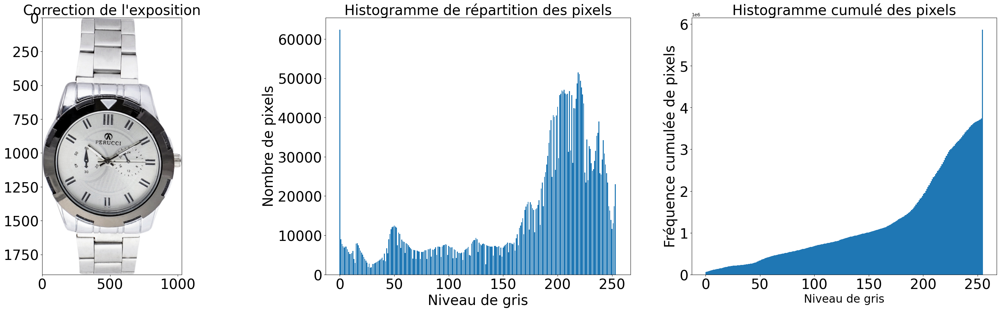

In [281]:
# Correction de l'exposition PILS
img_expo = ImageOps.autocontrast(img_orig, 1)
fonctions_data.display_image_histopixel(img_expo, 'Correction de l\'exposition')

**Correction du contraste (égalisation d'histogramme)**

Le contraste caractérise la répartition de lumière dans une image : plus une image est contrastée, plus la différence de luminosité entre ses zones claires et sombres est importante. 

**PILS**

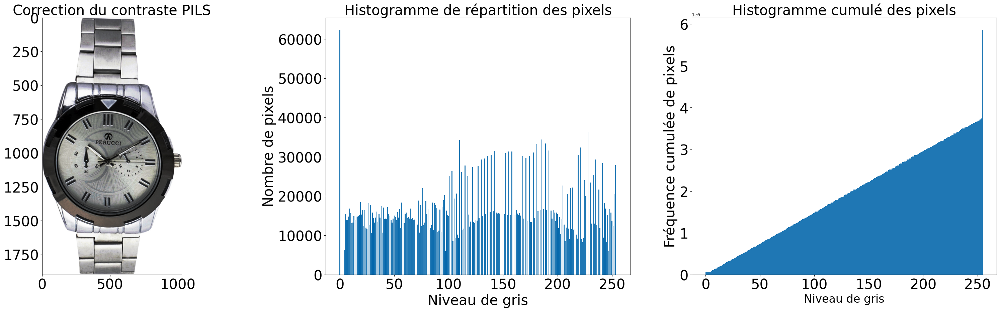

In [282]:
# Correction du contraste PILS
img_contr_pils = ImageOps.equalize(img_expo)
fonctions_data.display_image_histopixel(img_contr_pils, 'Correction du contraste PILS')

**OpenCV**

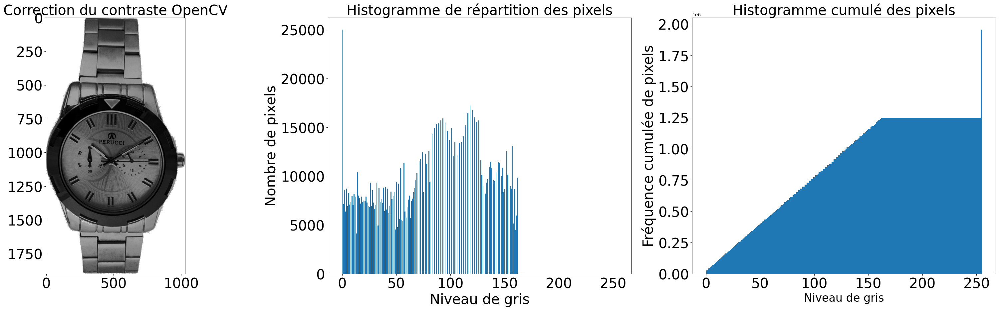

In [283]:
# Correction du contraste OpenCV méthode 1 : equalizeHist
img_expo_gris = cv2.cvtColor(np.array(img_expo), cv2.COLOR_BGR2GRAY)
img_contr_opencv = cv2.equalizeHist(img_expo_gris)
fonctions_data.display_image_histopixel(img_contr_opencv, 'Correction du contraste OpenCV')

**CLAHE** (Contrast Limited Adaptive Histogram Equalization) : l'image est divisée en petits blocs appelés "tiles" (tileSize est 8x8 par défaut dans OpenCV). Chacun de ces blocs est égalisé en histogramme comme d'habitude. Ainsi, dans une petite zone, l'histogramme se limitera à une petite région (sauf s'il y a du bruit). Si le bruit est présent, il sera amplifié. Pour éviter cela, une limitation du contraste est appliquée. Si une case de l'histogramme est au-dessus de la limite de contraste spécifiée (par défaut 40 dans OpenCV), ces pixels sont coupés et distribués uniformément aux autres cases avant d'appliquer l'égalisation de l'histogramme. Après l'égalisation, l'interpolation bilinéaire est appliquée pour supprimer les artefacts sur les bords des 'tiles'. (Source opencv)

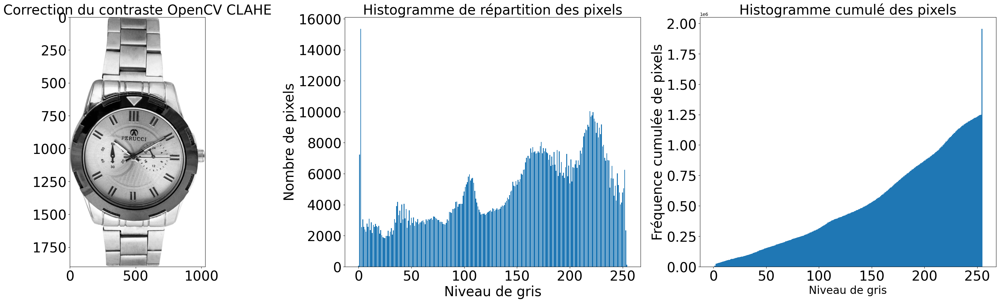

In [284]:
# Correction du contraste OpenCV méthode 2 : CLAHE
# img_expo_gris = cv2.cvtColor(np.array(img_expo), cv2.COLOR_BGR2GRAY)
clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(3, 3))
img_contr_clahe = clahe.apply(img_expo_gris)
fonctions_data.display_image_histopixel(img_contr_clahe, 'Correction du contraste OpenCV CLAHE')

#### <span style='background:wheat'>5.2.2 Redimensionnement 224*224</span>

En entrées des réseaux de neurones, les images doivent avoir la taille 224 * 224

In [285]:
dim = (224, 224)

**PILS**

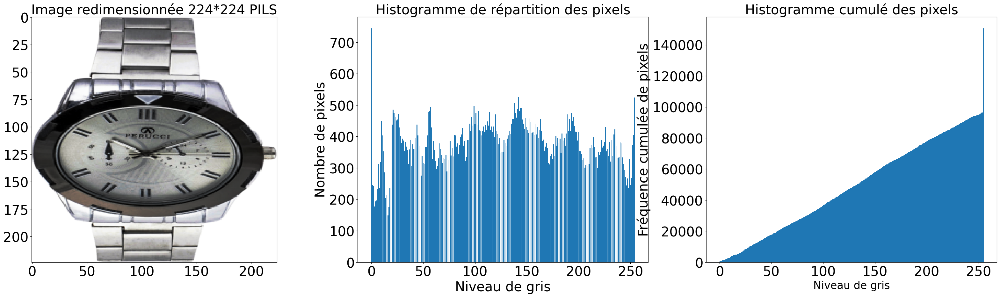

In [286]:
# Redimensionnement image contraste PILS
img_rdim_pils = cv2.resize(np.array(img_contr_pils), dim,
                            interpolation=cv2.INTER_AREA)
fonctions_data.display_image_histopixel(img_rdim_pils, 'Image redimensionnée 224*224 PILS')

**OpenCV**

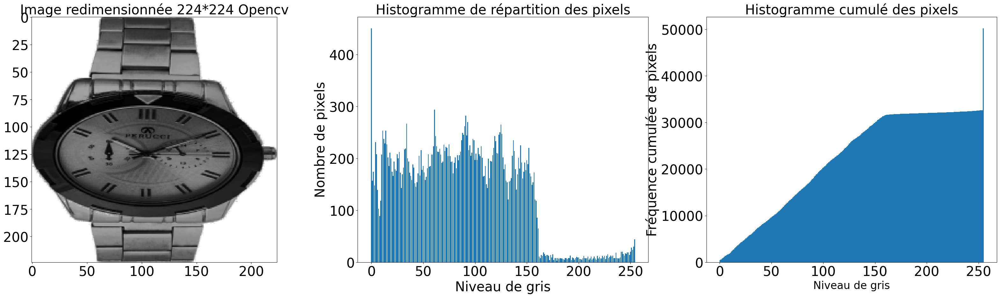

In [287]:
# Redimensionnement image contraste OpenCV
img_rdim_opencv = cv2.resize(np.array(img_contr_opencv), dim,
                              interpolation=cv2.INTER_AREA)
fonctions_data.display_image_histopixel(img_rdim_opencv, 'Image redimensionnée 224*224 Opencv')

**CLAHE**

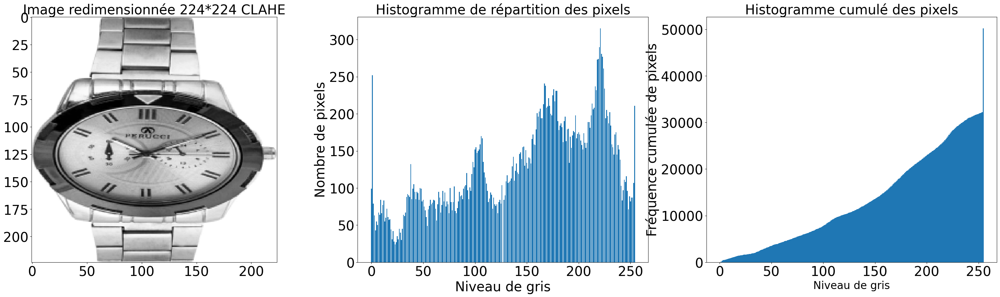

In [288]:
# Redimensionnement image contraste OpenCV CLAHE
img_rdim_clahe = cv2.resize(np.array(img_contr_clahe), dim,
                             interpolation=cv2.INTER_AREA)
fonctions_data.display_image_histopixel(img_rdim_clahe, 'Image redimensionnée 224*224 CLAHE')

#### <span style='background:wheat'>5.2.3 Conversion de l'image en niveau de gris</span>

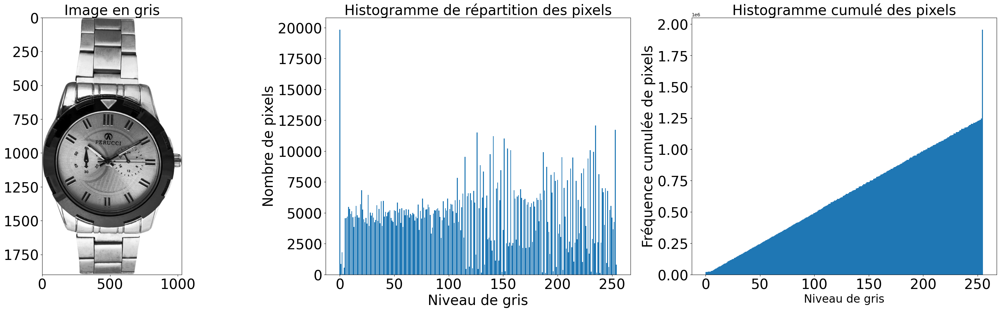

In [289]:
# Conversion de l'image en niveau de gris pour SIFT
img_gris = cv2.cvtColor(np.array(img_contr_pils), cv2.COLOR_RGB2GRAY)
fonctions_data.display_image_histopixel(img_gris,  'Image en gris')

#### <span style='background:wheat'>5.2.4 Réduction de bruit</span>

Pour améliorer la qualité des images, 3 filtres différents seront testés :
- 
un** filtre gaussie**  : nfiltre linéaire dont les éléments du noyau de convolution sont déterminés selon la densité d'une loi gaussienne centrée à 2 dimensions.
,- 
u**fn iltre par lissage par moyenna**ge la valeur de chaque pixel est remplacée par la moyenne de son voisinag.
)- ou **un filtre par lissage méd**ian (la valeur de chaque pixel est remplacée par la médiane de son voisinage).

**PILS**

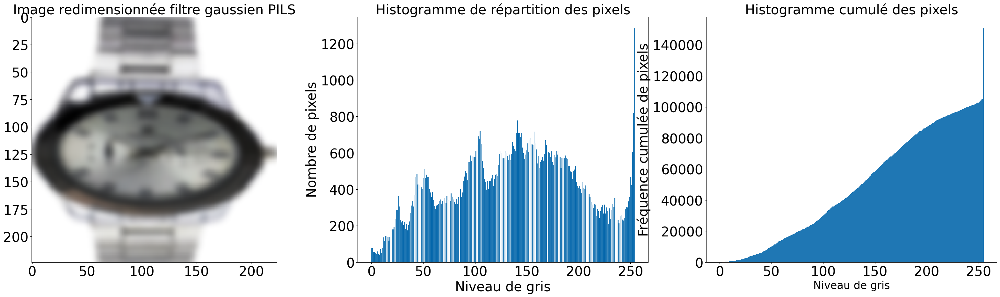

In [291]:
# Réduction du bruit filtre gaussien sur image correction contraste PILS
img_rdim_pils_rgb = Image.fromarray(img_rdim_pils, 'RGB')
img_gaus_pils = img_rdim_pils_rgb.filter(ImageFilter.GaussianBlur(radius=3))
fonctions_data.display_image_histopixel(img_gaus_pils, 'Image redimensionnée filtre gaussien PILS')

**OpenCV**

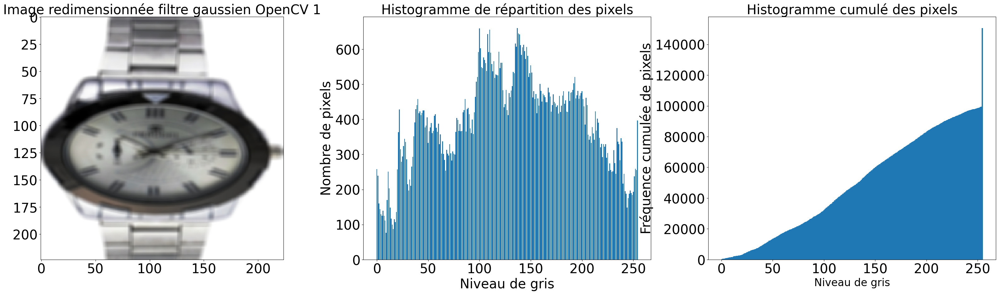

In [292]:
# Réduction du bruit filtre gaussien sur image correction contraste PILS
img_gaus_pils = cv2.GaussianBlur(img_rdim_pils, (5, 5), cv2.BORDER_DEFAULT)
fonctions_data.display_image_histopixel(img_gaus_pils, 'Image redimensionnée filtre gaussien OpenCV 1')

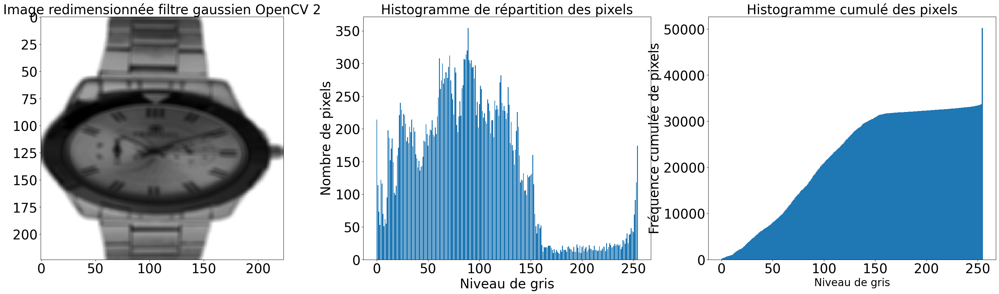

In [293]:
# Réduction du bruit filtre gaussien sur image correction contraste OpenCV
img_gaus_opencv = cv2.GaussianBlur(img_rdim_opencv, (5, 5),
                                   cv2.BORDER_DEFAULT)
fonctions_data.display_image_histopixel(img_gaus_opencv, 'Image redimensionnée filtre gaussien OpenCV 2')

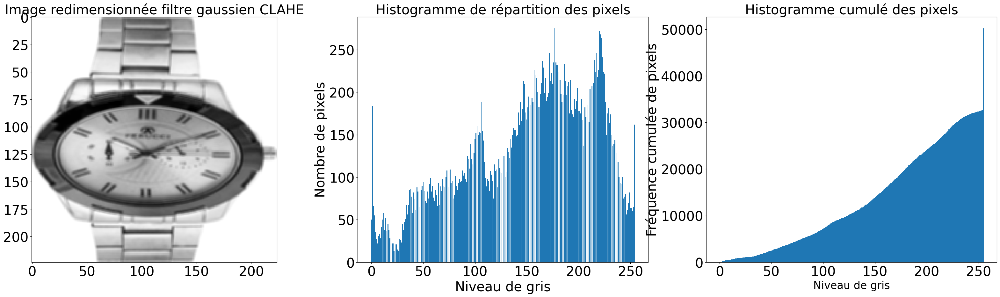

In [295]:
# Réduction du bruit filtre gaussien sur image correction contraste OpenCV
img_gaus_clahe = cv2.GaussianBlur(img_rdim_clahe, (3, 3), cv2.BORDER_DEFAULT)
fonctions_data.display_image_histopixel(img_gaus_clahe,  'Image redimensionnée filtre gaussien CLAHE')

**Scipy**

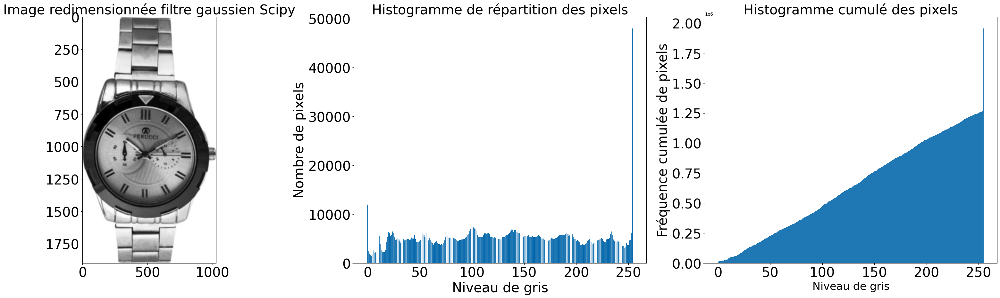

In [296]:
img_gaus_scipy = gaussian_filter(img_gris, sigma=3)
fonctions_data.display_image_histopixel(img_gaus_scipy, 'Image redimensionnée filtre gaussien Scipy')

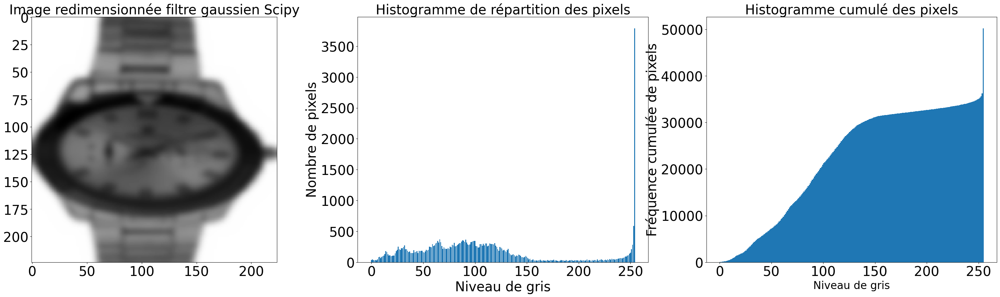

In [298]:
img_gaus_scipy2 = gaussian_filter(img_rdim_opencv, sigma=3)
fonctions_data.display_image_histopixel(img_gaus_scipy2, 'Image redimensionnée filtre gaussien Scipy')

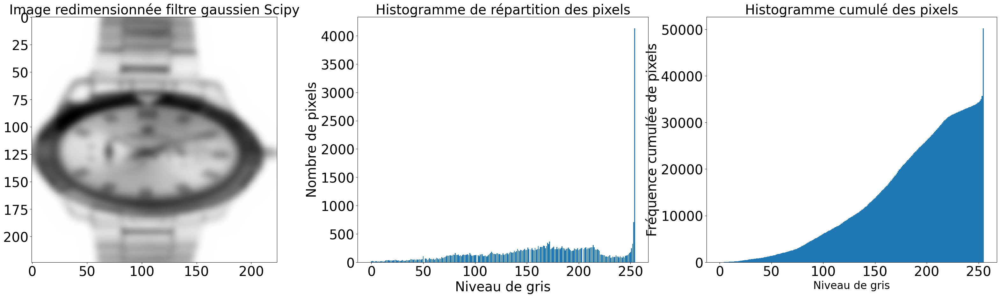

In [300]:
img_gaus_scipy2 = gaussian_filter(img_rdim_clahe, sigma=3)
fonctions_data.display_image_histopixel(img_gaus_scipy2, 'Image redimensionnée filtre gaussien Scipy')

**Réduction du bruit par un filtre médian**

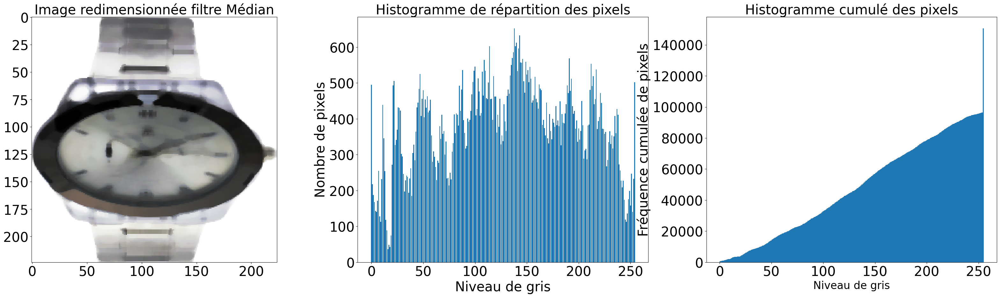

In [301]:
# Réduction du bruit filtre médian sur image correction contraste OpenCV
img_rdim_pils_rgb = Image.fromarray(img_rdim_pils, 'RGB')
img_median = img_rdim_pils_rgb.filter(ImageFilter.MedianFilter(size=7))
fonctions_data.display_image_histopixel(img_median, 'Image redimensionnée filtre Médian')

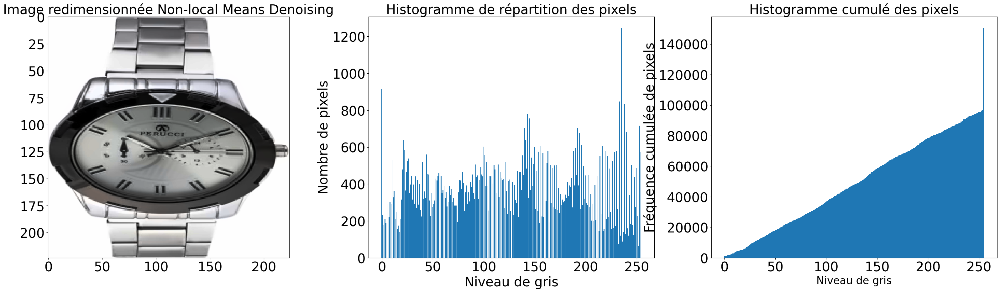

In [302]:
# Réduction du bruit avec l'algorithme  Non-local Means Denoising d'OpenCV
img_fast_pils = cv2.fastNlMeansDenoisingColored(img_rdim_pils, None, 5, 5, 7,
                                                21)
fonctions_data.display_image_histopixel(img_fast_pils, 'Image redimensionnée Non-local Means Denoising')

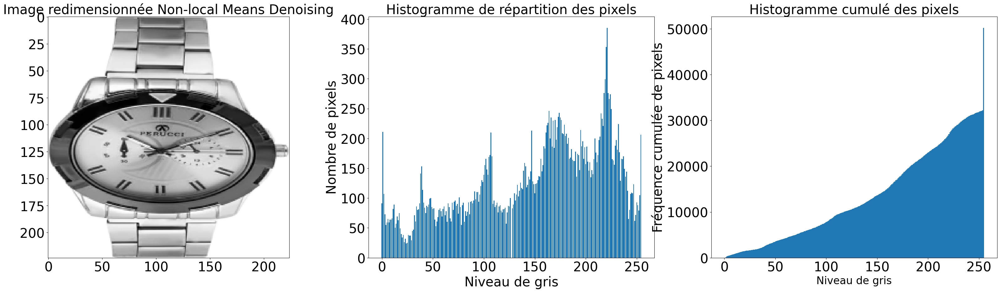

In [303]:
# Réduction du bruit filtre gaussien avec l'algorithme
# Non-local Means Denoising d'OpenCV
img_fast_clahe = cv2.fastNlMeansDenoising(img_rdim_clahe, None, 5, 7, 21)
fonctions_data.display_image_histopixel(img_fast_clahe, 'Image redimensionnée Non-local Means Denoising')

**Bilan** :

La réduction du bruit avec l'agorithme Non-local Means Denoising d'OpenCV donne un histogramme cumulé plus régulier, il sera utilisé dans le cadre du pré-traitement sur toutes les images.

In [446]:
# dataframe avec les images traités
data_imc_t = data_imc.copy()

data_imc_t['image_proces'] = data_imc_t['image_loc'].apply(preprocess_image)

In [449]:
# Pré-traitement de toutes les images PILS/OPENCV
data_imc_t['image_process2'] = \
    data_imc_t['image_loc'].apply(process_image_opencv)

### <span style='background:orange'>5.3. Features Extraction</span>

#### <span style='background:wheat'>5.3.1 Algorithme SIFT</span>

**Exemple avec l'image précédente**

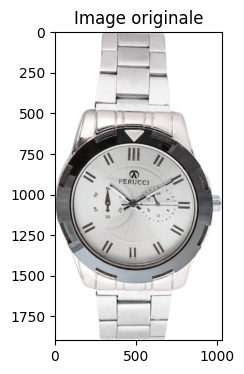

In [219]:
# Chargement de l'image précédemment traitée
montre = cv2.imread('Data/Flipkart/Images/fc93a41f31c4e997fbfcc5bd0a63ee65.jpg')
# Visualisation de l'image
plt.figure(figsize=(4, 4))
plt.title('Image originale')
plt.imshow(montre)
plt.show()

##### <span style='background:gold'>5.3.1.1 Extraction des features (BOVW-Bag of Visual Words)</span>

In [220]:
# Transformation del'image en matrice de pixels pour OpenCV
montre = np.array(montre)
# Instanciation de SIFT
sift = cv2.xfeatures2d.SIFT_create()
# Extraction des points d'intérêt et des descripteurs
sift_keypoints, sift_descripteurs = sift.detectAndCompute(montre, None)
nb_feat = sift_descripteurs.shape[0]
nb_desc = sift_descripteurs.shape[1]
print(f'SIFT Montre - Nombre de features={nb_feat} pour {nb_desc} descripteurs')

SIFT Montre - Nombre de features=2054 pour 128 descripteurs


In [221]:
sift_descripteurs

array([[ 24.,   3.,   1., ...,   0.,   0.,   0.],
       [  1.,   2.,   2., ...,   0.,   0.,   7.],
       [ 73.,  56.,   1., ...,   0.,  34.,  70.],
       ...,
       [  0.,  44.,  49., ...,   0.,   0.,   4.],
       [  6.,  29.,  79., ...,   0.,   1.,   2.],
       [  0.,  36., 142., ...,  55.,  27.,  10.]], dtype=float32)

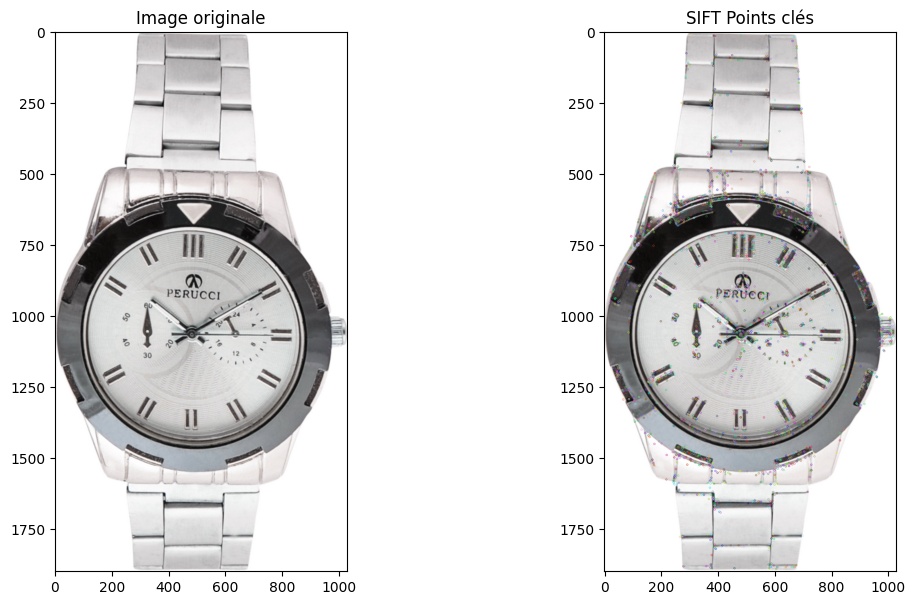

In [222]:
# Visualisation des points d'intérêt
sift_montre_keypoints = cv2.drawKeypoints(montre, sift_keypoints, None)

plt.figure(figsize=(13, 7))

# Image originale
plt.subplot(1, 2, 1)
plt.title('Image originale')
plt.imshow(montre)

# Image avec les points clés
plt.subplot(1, 2, 2)
plt.imshow(sift_montre_keypoints)
plt.title('SIFT Points clés')
plt.show()

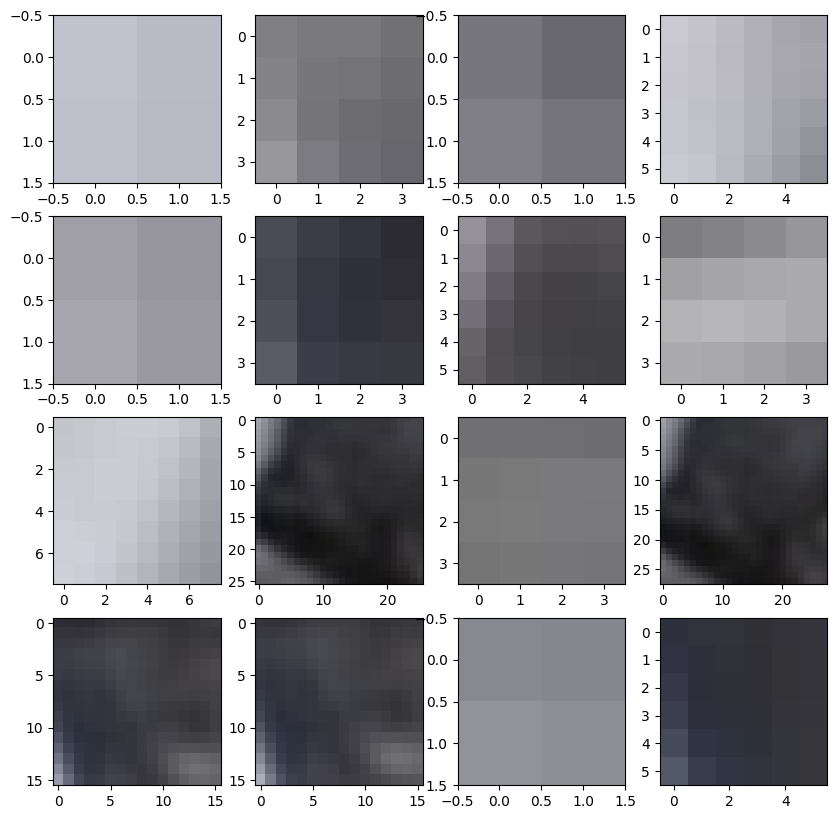

In [228]:
# Visualisation des 'Visual words'
fonctions_data.afficher_vwords(montre, sift_keypoints)

##### <span style='background:gold'>5.3.1.2 SIFT pour les 200 images du dataframe</span>

**E1 - Chargement des images prétraités**

In [230]:
# Chargement des images pré-traitées dans le dictionnaire images

dico_img = fonctions_data.charger_images_repertoire('Data/Flipkart/Images', nombre_images=300)
#charger_image_repertoire('Data/Flipkart/Images')
print(f'{len(dico_img)} images chargées')

300 images chargées


**E2 - Extraction des features - Visual Words**

In [232]:
sifts = fonctions_data.sift_extraire_features(dico_img)

In [233]:
# # Liste des descripteurs = tous les 'visual words' de toutes les images
sift_list_descripteurs = sifts[0]
len(sift_list_descripteurs)

2801055

In [234]:
# Liste des vecteurs par images (dictionnaires clé=nom_image, vecteur)
sift_all_bovw_features = sifts[1]
len(sift_all_bovw_features)

300

**E3 - Création du dictionnaire de visual words : Bag of Visual Words (BoVW)**

In [ ]:
# Initialisation du dataframe de sauvegarde des métriques kmeans
df_kmeans_metrics = pd.DataFrame({})
nb_clusters = [100, 300, 500, 1000, 2000, 3000, 4000, 5000]

df_kmeans_metrics = fonctions_data.calcul_metrics_kmeans(sift_list_descripteurs,
                                        df_kmeans_metrics,
                                        'SIFT', nb_clusters)

'Paramètre 100 terminé'

'Paramètre 300 terminé'

KeyboardInterrupt: 

Exception ignored in: 'sklearn.cluster._k_means_common._relocate_empty_clusters_dense'
Traceback (most recent call last):
  File "<__array_function__ internals>", line 179, in where
KeyboardInterrupt: 


**Méthode Elbow**

In [ ]:
# Trace le graphique des dispersions, pour visualiser le coude
plt.figure(figsize=(12, 5))

plt.title('La méthode Elbow', fontsize=16)
plt.plot([i for i in nb_clusters],
         df_kmeans_metrics['dispersion'].to_list(),
         marker='o')
plt.grid(True)
plt.xlabel('Nombre de groupes', fontsize=14)
plt.ylabel('Score de dispersion', fontsize=15)
plt.xticks([i for i in nb_clusters], fontsize=14)
plt.yticks(fontsize=15)

plt.show()

In [236]:
# Creation des clusters via MiniBatch et Constitution du dictionnaire de bag of words
sift_kmeans = MiniBatchKMeans(n_clusters=1000,
                     random_state=0, n_init=10)
sift_kmeans.fit(sift_list_descripteurs)
sift_visual_words = sift_kmeans.cluster_centers_

In [237]:
sift_visual_words

array([[27.42684856, 26.31198102, 22.91083432, ..., 15.38770265,
        14.37584025, 14.44998023],
       [38.21799249, 19.46773643,  7.75674292, ...,  1.56111301,
         1.36497098, 16.45373848],
       [24.9466062 , 15.93373318, 12.03335284, ..., 15.07665301,
        12.27296665, 13.16939731],
       ...,
       [41.50912176, 17.4427238 , 11.17628341, ...,  5.99724226,
         6.71616462,  7.34641493],
       [95.50560678, 51.71168702, 18.3511089 , ..., 34.88711687,
        12.69100424,  7.19063045],
       [32.66683884, 33.59194215, 28.94163223, ..., 27.31818182,
        29.94860537, 13.32463843]])

**E4 - Construction de l'histogramme pour chaque image**

In [239]:
sift_bovw = fonctions_data.image_class(sift_all_bovw_features, sift_visual_words)

In [240]:
len(sift_bovw)

300

In [268]:
# Dataframe  des BoVW SIFT
df_sift_bovw = pd.DataFrame({'image': sift_bovw.keys(),'sift_bovw': sift_bovw.values()})

# Ajout des BOVW en np.array d'une liste
df_sift_bovw['Histogramme'] = [row[0] for row in df_sift_bovw['sift_bovw']] 
# Ajout de la catégorie
df_sift_bovw = df_sift_bovw.merge(data_imc[['image', 'image_loc',
                                        'Categorie_1']], how='left', on='image')

# Constituer le dataframe de vecteurs de BOVW
df_sift_vectors = fonctions_data.constituer_dataframe_vectors(df_sift_bovw, 'Histogramme')

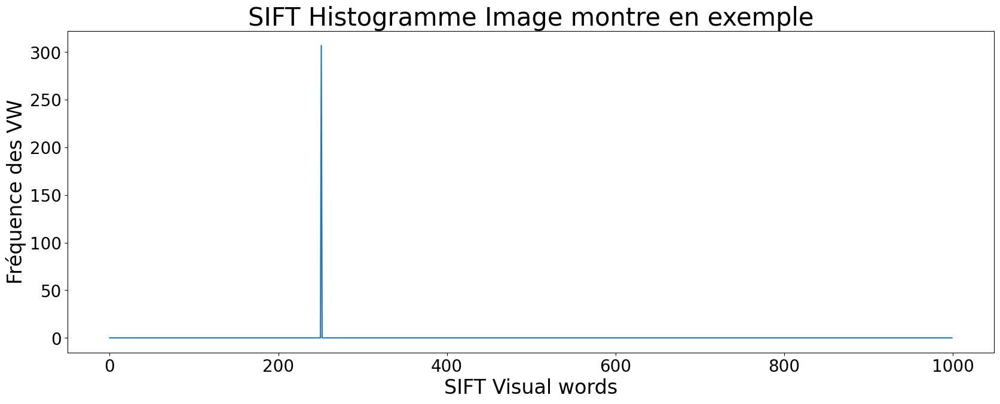

In [269]:
# Visualisation de l'histogramme pour l'image exemple de l'elephant

# Récupération de l'historgramme
df_visu = df_sift_bovw[df_sift_bovw['image'] ==
                       '00e966a5049a262cfc72e6bbf68b80e7.jpg']['sift_bovw']   
histo_eleph = df_visu.to_list()[0][0]
plt.figure(figsize=(20, 7))
plt.title('SIFT Histogramme Image montre en exemple', fontsize=30)
plt.xlabel("SIFT Visual words", fontsize=24)
plt.ylabel("Fréquence des VW", fontsize=24)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.grid(False)
plt.plot(histo_eleph)
plt.savefig('histogram elephant',dpi=200, bbox_inches='tight')
plt.show()

**E5 - Réduction de dimension**

In [169]:
df_sift_vectors.shape[1]

1000

-----------------------------------------
 ARI  : 0.0037
 Homogénéité  : 0.0465
-----------------------------------------


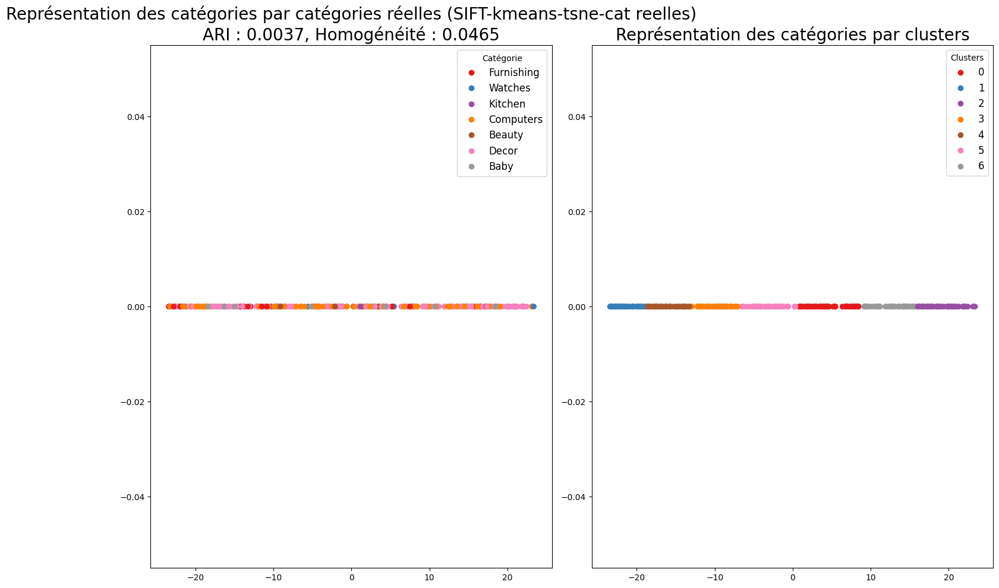

In [271]:
title = 'SIFT-kmeans-tsne-cat reelles'

# TSNE/Kmeans/visualisation

# Calcul des composantes TSNE

df_sift_vectors_tsne = fonctions_data.tsne(df_sift_vectors, 40)

# kmeans
df_sift_vectors_tsne_km, ARI, Homogeneite, labels = fonctions_data.kmeans(df_sift_vectors_tsne, data_cat)

# Visualisation
fonctions_data.affiche_projection_par_clusters(df_sift_vectors_tsne_km, labels, ARI, Homogeneite, title)

In [288]:
# Les catégories par clusters
df_sift_vectors_tsne_km.groupby('cluster_id')['categories'].value_counts().to_frame()

categories
cluster_id categories            
0          Kitchen             17
           Decor               13
           Watches             10
           Baby                 5
           Furnishing           4
           Beauty               2
           Computers            2
1          Kitchen             14
           Decor               12
           Baby                 6
           Watches              5
           Beauty               2
           Computers            1
2          Kitchen             21
           Baby                 7
           Decor                7
           Beauty               4
           Watches              3
           Computers            1
           Furnishing           1
3          Kitchen             14
           Decor               10
           Computers            5
           Baby                 4
           Beauty               4
           Furnishing           2
           Watches              2
4          Kitchen             15
           Watches              8
           Decor                5
           Baby                 3
           Furnishing           3
           Beauty               1
5          Decor               17
           Kitchen             12
           Furnishing           6
           Baby                 2
           Beauty               2
           Watches              2
           Computers            1
6          Kitchen             19
           Decor               11
           Watches              6
           Furnishing           5
           Beauty               3
           Baby                 1

Clusters,Nombre,%
0,53,17.670000
1,40,13.330000
2,44,14.670000
3,41,13.670000
4,35,11.670000
5,42,14.000000
6,45,15.000000


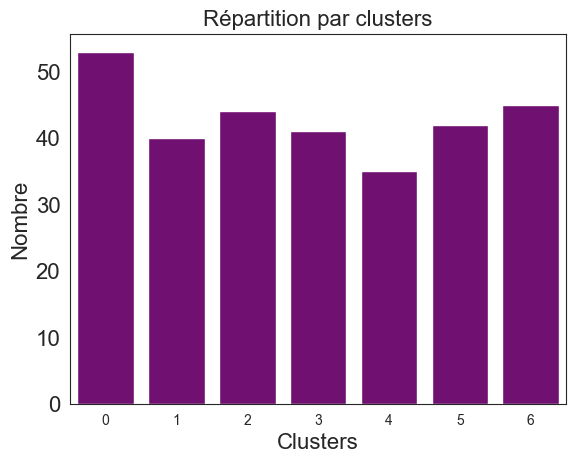

In [305]:
fonctions_data.affiche_repartition_par_clusters(labels)

,precision,recall,f1-score,support
0,0.000000,0.000000,0.000000,28.00
1,0.000000,0.000000,0.000000,18.00
2,0.000000,0.000000,0.000000,10.00
3,0.404762,0.226667,0.290598,75.00
4,0.000000,0.000000,0.000000,21.00
5,0.387597,0.892857,0.540541,112.00
6,0.000000,0.000000,0.000000,36.00
accuracy,0.390000,0.390000,0.390000,0.39
macro avg,0.113194,0.159932,0.118734,300.00
weighted avg,0.245893,0.390000,0.274451,300.00


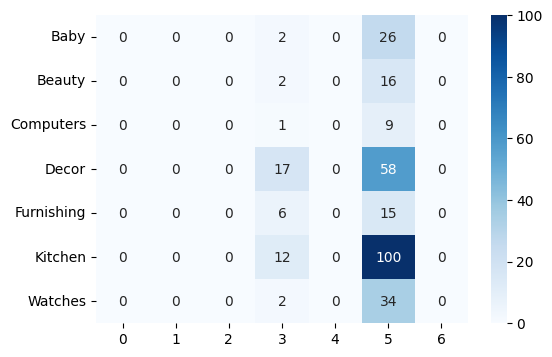

In [273]:
fonctions_data.conf_mat_metrics(df_sift_vectors_tsne_km)

#### <span style='background:wheat'>5.3.2 Algorithme ORB</span>

**Exemple avec l'image précédente**

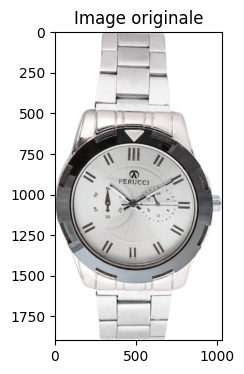

In [217]:
# Chargement de l'image précédemment traitée
montre = cv2.imread('Data/Flipkart/Images/fc93a41f31c4e997fbfcc5bd0a63ee65.jpg')
# Visualisation de l'image
plt.figure(figsize=(4, 4))
plt.title('Image originale')
plt.imshow(montre)
plt.show()

##### <span style='background:gold'>5.3.2.1 Extraction des features (BOVW-Bag of Visual Words)</span>

In [343]:
# Transformation del'image en matrice de pixels pour OpenCV
montre = np.array(montre)
# Instanciation de ORB
orb = cv2.ORB_create()
# Extraction des points d'intérêt et des descripteurs
orb_keypoints, orb_descripteurs = orb.detectAndCompute(montre, None)
nb_feat = orb_descripteurs.shape[0]
nb_desc = orb_descripteurs.shape[1]
print(f'ORB Montre - Nombre de features={nb_feat} pour {nb_desc} descripteurs')

ORB Montre - Nombre de features=500 pour 32 descripteurs


In [344]:
orb_descripteurs

array([[ 26,  10, 230, ..., 108,  61, 138],
       [ 42, 132,  44, ...,  12, 221, 138],
       [ 30,  92, 224, ..., 223,  60, 246],
       ...,
       [185, 201,  71, ..., 187, 112, 172],
       [147, 203,  66, ..., 156, 249, 157],
       [ 51,  11,  66, ..., 143, 112, 204]], dtype=uint8)

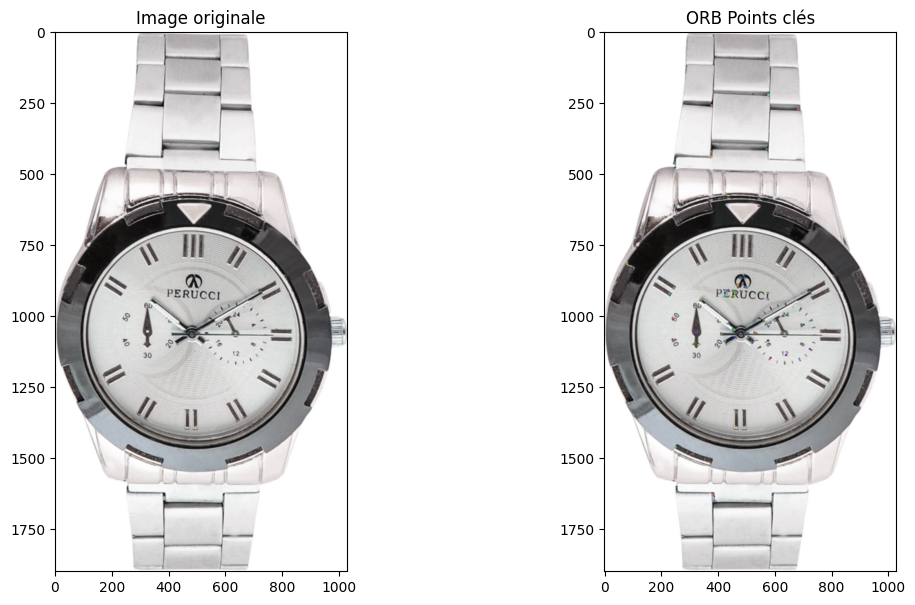

In [307]:
# Visualisation des points d'intérêt
orb_montre_keypoints = cv2.drawKeypoints(montre, orb_keypoints, None)

plt.figure(figsize=(13, 7))

# Image originale
plt.subplot(1, 2, 1)
plt.title('Image originale')
plt.imshow(montre)

# Image avec les points clés
plt.subplot(1, 2, 2)
plt.imshow(orb_montre_keypoints)
plt.title('ORB Points clés')
plt.show()

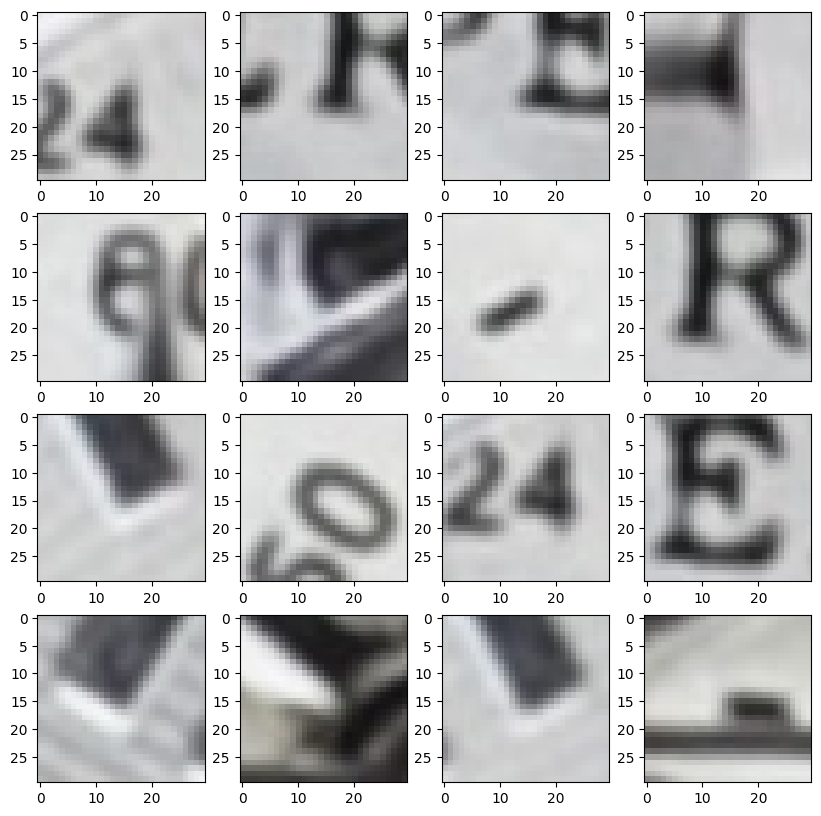

In [308]:
# Visualisation des 'Visual words'
fonctions_data.afficher_vwords(montre, orb_keypoints)

##### <span style='background:gold'>5.3.2.2 ORB pour les 1000 images du dataframe</span>

**E1 - Chargement des images prétraités**

In [182]:
# Chargement des images pré-traitées dans le dictionnaire images

dico_img_orb = fonctions_data.charger_images_repertoire('Data/Flipkart/Images', nombre_images=1000)
#charger_image_repertoire('Data/Flipkart/Images')
print(f'{len(dico_img_orb)} images chargées')

1000 images chargées


**E2 - Extraction des features - Visual Words**

In [217]:
orb_list_descripteurs, orb_lien_img_des = fonctions_data.orb_extract_features(data_imc_t['image_process2'])

In [218]:
orb_list_descripteurs.shape

(735579, 32)

In [219]:
len(orb_lien_img_des)

735579

**E3 - Création du dictionnaire de visual words : Bag of Visual Words (BoVW)**

- Pour créer le "dictionnaire" de visual words, il suffit d'appliquer un algorithme de clustering aux descripteurs de features construits à l'étape 1, comme l'algorithme MiniBatchKMeans, par exemple. 
- Les visual words correspondent alors aux centres des clusters trouvés.

In [224]:
# Test du MiniBatchKMeans mis à disposition

# Création d'un objet MiniBatchKMeans avec le nombre de clusters désiré
kmeans = MiniBatchKMeans(n_clusters=1000)

# Entraînement du modèle sur les données
kmeans.fit(orb_list_descripteurs)

MiniBatchKMeans(n_clusters=1000)

In [230]:
#  Obtenir les labels des clusters pour chaque descripteur
orb_labels = kmeans.predict(orb_list_descripteurs)

In [231]:
orb_labels.shape

(735579,)

**E4 - Construction de l'histogramme pour chaque image**

- Pour chaque image, on crée un histogramme qui indique la fréquence d'apparition de chaque visual word dans l'image.- 
Le bag-of-features d'une image est le vecteur dans lequel on a stocké les valeurs de l'histogramme et qu'on a normalisé (en divisant par la norme euclidienne).

In [235]:
# Extraction des BOVW ORB
df_orb_vectors = fonctions_data.orb_constituter_bovw(data_imc_t, 'image_process2', 'orb_bovw',
                                   orb_labels, orb_lien_img_des)

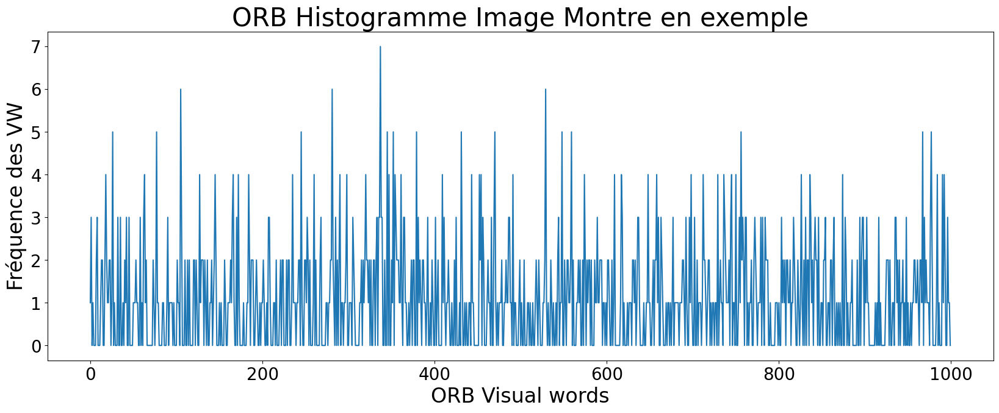

In [237]:
# Visualisation de l'histogramme pour notre image exemple
# Récupération de l'historgramme
df_visu_orb = data_imc_t[data_imc_t['image'] ==
                   'fc93a41f31c4e997fbfcc5bd0a63ee65.jpg']['orb_bovw']
histo_montre = df_visu_orb.to_list()[0]
plt.figure(figsize=(20, 7))
plt.title('ORB Histogramme Image Montre en exemple', fontsize=30)
plt.xlabel('ORB Visual words', fontsize=24)
plt.ylabel('Fréquence des VW', fontsize=24)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.grid(False)
plt.plot(histo_mug)
plt.show()

In [238]:
# Dataframe de sauvegarde des BOVW ORB
df_orb_bovw = data_imc_t[['image', 'image_loc', 'Categorie_1', 'orb_bovw']]
# Constituer le dataframe de vecteurs de BOVW
df_orb_vectors = fonctions_data.constituer_dataframe_vectors(df_orb_bovw, 'orb_bovw')

In [241]:
df_orb_vectors

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
0,0.0,0.0,0.0,0.0,7.0,0.0,0.0,0.0,0.0,0.0,...,0.0,2.0,2.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
1,2.0,0.0,1.0,0.0,0.0,6.0,1.0,2.0,2.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1.0,0.0,1.0,1.0,0.0,1.0,0.0,2.0,0.0,1.0,...,1.0,0.0,0.0,2.0,1.0,0.0,1.0,0.0,0.0,2.0
3,0.0,1.0,2.0,3.0,0.0,0.0,1.0,0.0,0.0,0.0,...,2.0,0.0,3.0,0.0,2.0,0.0,2.0,1.0,2.0,1.0
4,7.0,2.0,2.0,2.0,2.0,0.0,2.0,1.0,0.0,1.0,...,0.0,0.0,0.0,4.0,1.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,2.0,1.0,2.0,5.0,0.0,0.0,2.0,1.0,4.0,0.0,...,0.0,0.0,0.0,1.0,0.0,1.0,2.0,0.0,0.0,1.0
1046,0.0,0.0,0.0,2.0,1.0,0.0,1.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1047,1.0,0.0,0.0,0.0,0.0,1.0,3.0,0.0,2.0,0.0,...,4.0,0.0,1.0,3.0,2.0,0.0,0.0,1.0,5.0,1.0
1048,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,2.0,1.0,...,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0


**E5 - Réduction de dimension**

In [239]:
df_orb_vectors.shape[1]

1000

Nombre de features après réduction ACP pour 99.0% de variance : 701
-----------------------------------------
 ARI  : 0.0349
 Homogénéité  : 0.0635
-----------------------------------------


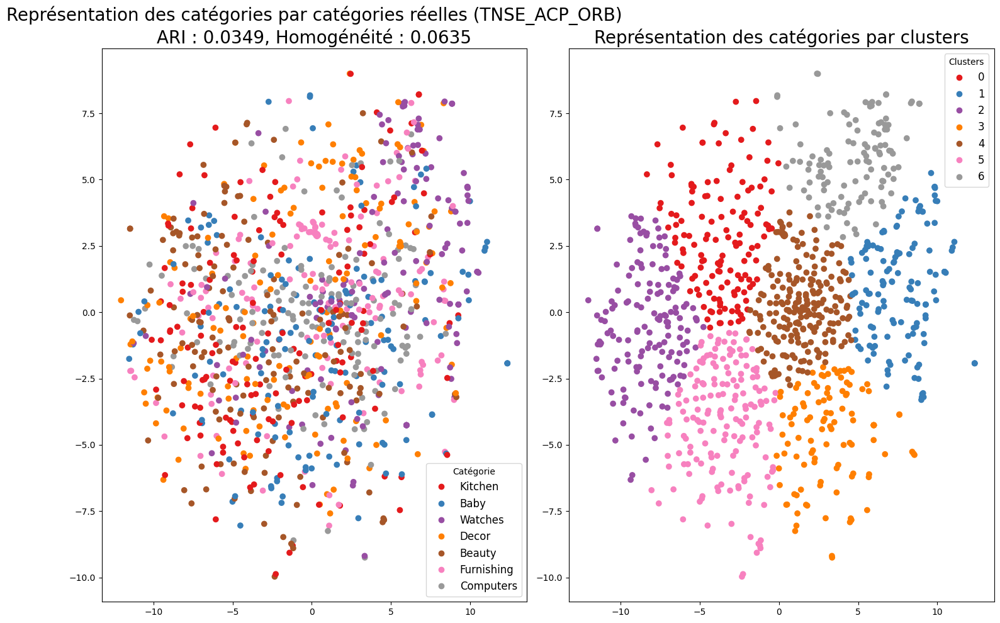

In [255]:
# Reduction ACP/TSNE/Kmeans/visualisation
title = 'TNSE_ACP_ORB'

# reduction ACP (99% de variance)
df_orb_vectors_acp = fonctions_data.acp(df_orb_vectors)

# Calcul des composantes TSNE

df_orb_vectors_acp_tsne = fonctions_data.tsne(df_orb_vectors_acp, 40)

# kmeans
df_orb_vectors_acp_tsne_km, ARI, Homogeneite, labels = fonctions_data.kmeans(df_orb_vectors_acp_tsne, data_cat)

# visualisation
fonctions_data.affiche_projection_par_clusters(df_orb_vectors_acp_tsne_km, labels, ARI, Homogeneite, title)

In [256]:
# Les catégories par clusters
df_orb_vectors_acp_tsne_km.groupby('cluster_id')['categories'].value_counts().to_frame()

categories
cluster_id categories            
0          Furnishing          26
           Baby                24
           Kitchen             24
           Watches             24
           Decor               18
           Beauty              16
           Computers            5
1          Computers           45
           Kitchen             22
           Beauty              21
           Watches             20
           Decor               18
           Furnishing           7
           Baby                 5
2          Furnishing          42
           Decor               33
           Baby                32
           Kitchen             16
           Watches             16
           Beauty              13
           Computers            5
3          Beauty              25
           Computers           19
           Decor               17
           Furnishing          16
           Watches             16
           Baby                 9
           Kitchen              9
4          Kitchen             53
           Watches             50
           Beauty              33
           Computers           29
           Baby                25
           Decor               17
           Furnishing          16
5          Baby                40
           Furnishing          39
           Beauty              31
           Decor               21
           Watches             15
           Kitchen             12
           Computers           11
6          Computers           36
           Decor               26
           Baby                15
           Kitchen             14
           Beauty              11
           Watches              9
           Furnishing           4

,precision,recall,f1-score,support
0,0.236686,0.266667,0.250784,150.000000
1,0.225225,0.166667,0.191571,150.000000
2,0.320158,0.540000,0.401985,150.000000
3,0.000000,0.000000,0.000000,150.000000
4,0.231293,0.453333,0.306306,150.000000
5,0.237668,0.353333,0.284182,150.000000
6,0.000000,0.000000,0.000000,150.000000
accuracy,0.254286,0.254286,0.254286,0.254286
macro avg,0.178719,0.254286,0.204975,1050.000000
weighted avg,0.178719,0.254286,0.204975,1050.000000


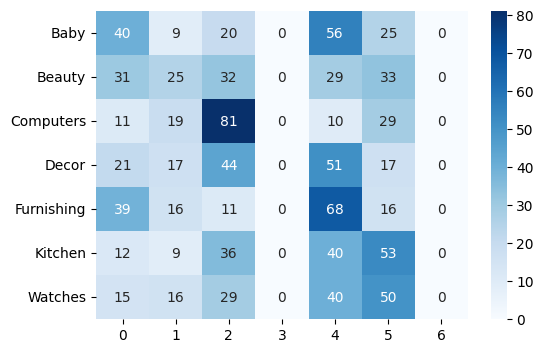

In [257]:
fonctions_data.conf_mat_metrics(df_orb_vectors_acp_tsne_km)

La visualisation ainsi que l'indice de similarité montrent clairement qu'on arrive pas à séparer les catégories et par conséquent les classifier en utilisant l'algorithme ORB pour l'extraction des features des images et le calcul des descripteurs

### <span style='background:orange'>5.4. Convolutional Neural Networks (CNN) transfer learning</span>

#### <span style='background:wheat'>5.4.1 VGG16</span>

In [441]:
# Utilisation de VGG16 pré-entraîné sur ImageNet avec les images d'origine non traitées

top_depart = time.time()

# Liste
vgg16_all_features = []

# Pre-Trained Model as Feature Extractor in Model

model_vgg16  = VGG16(weights='imagenet', include_top=False,  classes=7, pooling='avg', input_shape=(224,224,3)) 

# Résumé de l'architecture du modèle
model_vgg16.summary()

for rep_image in data_imc_t['image_loc']:

    # Charger l'image et la redimensionner à la taille requise de 224×224 pixels
    img = image.load_img(rep_image, target_size=(224, 224))
    
    # Convertir les pixels en un tableau NumPy afin de pouvoir travailler dans Keras
    img = image.img_to_array(img)
    
    # Redimensionnement
    img = np.expand_dims(img, axis=0)
    
    # Préparer de nouvelles entrées pour le réseau
    img = preprocess_input(img)

    # obtenir une prédiction de la probabilité d'appartenance de l'image à chacun des 1000 types d'objets connus
    vgg16_feature = model_vgg16.predict(img)
    
    # Ajouter la feature prédite en nparray à la liste 
    vgg16_all_features.append(np.array(vgg16_feature).flatten()) # Conversion des matrices 3D en vecteur 1D

vgg16_all_features = np.array(vgg16_all_features)

print(f"Temps d'execution : {round((time.time()-top_depart)/60, 3)} minutes")

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_10 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [442]:
vgg16_all_features.shape 

(1050, 512)

In [443]:
# Dataframe de sauvegarde des BOVW VGG16
# Association des features à chaque image
data_imc_t['vgg16_bovw'] = [vgg16_all_features[i] for i in range(data_imc_t.shape[0])]
# Dataframe de travail
df_vgg16_bovw = data_imc_t[['image', 'image_loc', 'Categorie_1', 'vgg16_bovw']]
# Constituer le dataframe de vecteurs de BOVW VGG16
df_vgg16_vectors = pd.DataFrame.from_records(vgg16_all_features)

**Réduction de dimension**

**ACP/TSNE/kmeans** 

Nombre de features après réduction ACP pour 99.0% de variance : 351
-----------------------------------------
 ARI  : 0.4755
 Homogénéité  : 0.557
-----------------------------------------


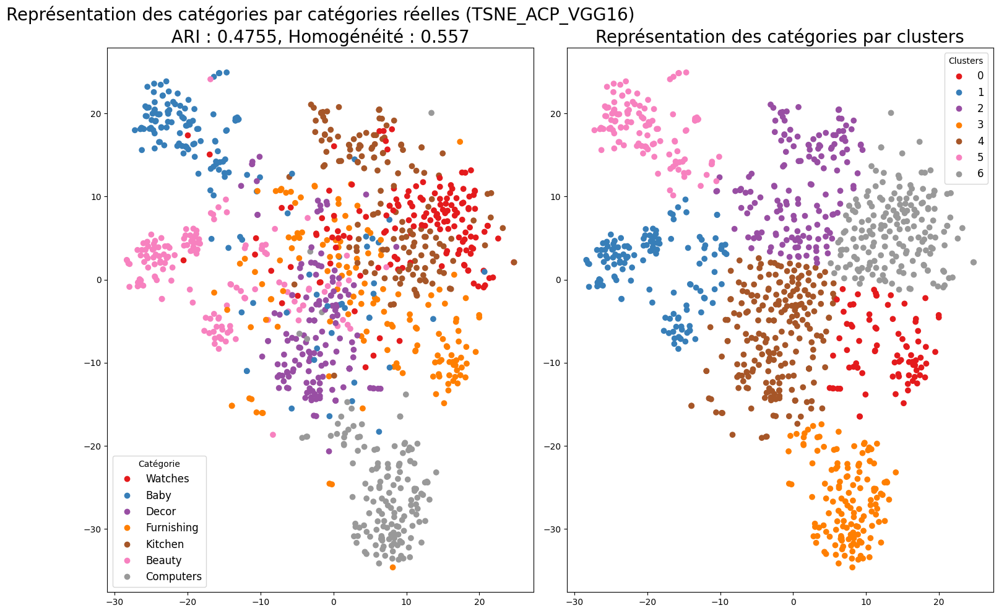

In [444]:
title = 'TSNE_ACP_VGG16'
# Réduction ACP pour 99% de variance

df_vgg16_vectors_acp = fonctions_data.acp(df_vgg16_vectors)

# Calcul des composantes TSNE.
df_vgg16_vectors_acp_tsne = fonctions_data.tsne(df_vgg16_vectors_acp, 50)

# kmeans
df_vgg16_vectors_acp_tsne_km, ARI, Homogeneite, labels = fonctions_data.kmeans(df_vgg16_vectors_acp_tsne, data_cat)

# Visualisation
fonctions_data.affiche_projection_par_clusters(df_vgg16_vectors_acp_tsne_km, labels, ARI, Homogeneite, title)

**Sans l'étape de réduction d'ACP**

-----------------------------------------
 ARI  : 0.3846
 Homogénéité  : 0.498
-----------------------------------------


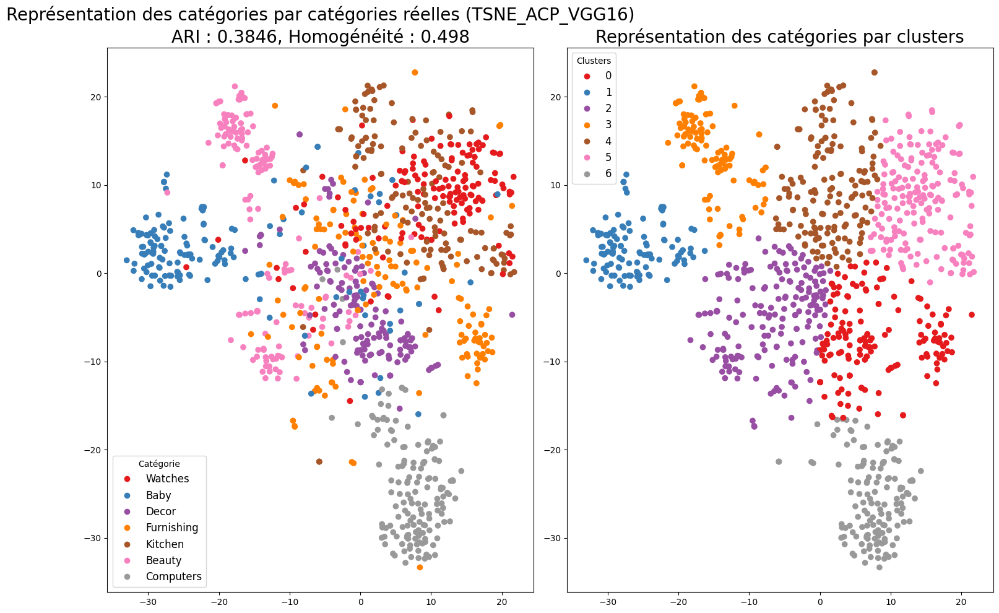

In [449]:
# Calcul des composantes TSNE
df_vgg16_vectors_tsne = fonctions_data.tsne(df_vgg16_vectors, 50)

# kmeans
df_vgg16_vectors_tsne_km, ARI, Homogeneite, labels = fonctions_data.kmeans(df_vgg16_vectors_tsne, data_cat)

# visualisation
fonctions_data.affiche_projection_par_clusters(df_vgg16_vectors_tsne_km, labels, ARI, Homogeneite, title)

,precision,recall,f1-score,support
0,0.580645,0.720000,0.642857,150.000000
1,0.923729,0.726667,0.813433,150.000000
2,0.552632,0.840000,0.666667,150.000000
3,0.756098,0.413333,0.534483,150.000000
4,0.474359,0.493333,0.483660,150.000000
5,0.878571,0.820000,0.848276,150.000000
6,0.964286,0.900000,0.931034,150.000000
accuracy,0.701905,0.701905,0.701905,0.701905
macro avg,0.732903,0.701905,0.702916,1050.000000
weighted avg,0.732903,0.701905,0.702916,1050.000000


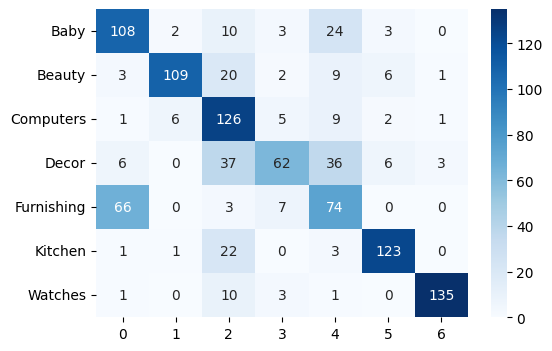

In [451]:
fonctions_data.conf_mat_metrics(df_vgg16_vectors_acp_tsne_km)

#### <span style='background:wheat'>5.4.2 VGG19</span>

In [455]:
from keras.applications.vgg19 import VGG19

# Utilisation de VGG16 pré-entraîné sur ImageNet avec les images d'origine non traitées

top_depart = time.time()

# Liste
vgg19_all_features = []

# Pre-Trained Model as Feature Extractor in Model

model_vgg19  = VGG19(weights='imagenet', include_top=False,  classes=7, pooling='avg', input_shape=(224,224,3)) 

# Résumé de l'architecture du modèle
model_vgg19.summary()

for rep_image in data_imc_t['image_loc']:

    # Charger l'image et la redimensionner à la taille requise de 224×224 pixels
    img = image.load_img(rep_image, target_size=(224, 224))
    
    # Convertir les pixels en un tableau NumPy afin de pouvoir travailler dans Keras
    img = image.img_to_array(img)
    
    # Redimensionnement
    img = np.expand_dims(img, axis=0)
    
    # Préparer de nouvelles entrées pour le réseau
    img = preprocess_input(img)

    # obtenir une prédiction de la probabilité d'appartenance de l'image à chacun des 1000 types d'objets connus
    vgg19_feature = model_vgg19.predict(img)
    
    # Ajouter la feature prédite en nparray à la liste 
    vgg19_all_features.append(np.array(vgg19_feature).flatten()) # Conversion des matrices 3D en vecteur 1D

vgg19_all_features = np.array(vgg19_all_features)

print(f"Temps d'execution : {round((time.time()-top_depart)/60, 3)} minutes")

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_11 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [456]:
vgg19_all_features.shape 

(1050, 512)

In [458]:
# Dataframe de sauvegarde des BOVW VGG16
# Association des features à chaque image
data_imc_t['vgg19_bovw'] = [vgg19_all_features[i] for i in range(data_imc_t.shape[0])]
# Dataframe de travail
df_vgg19_bovw = data_imc_t[['image', 'image_loc', 'Categorie_1', 'vgg19_bovw']]
# Constituer le dataframe de vecteurs de BOVW VGG16
df_vgg19_vectors = pd.DataFrame.from_records(vgg19_all_features)

**Réduction de dimension**

**ACP/TSNE/kmeans**

Nombre de features après réduction ACP pour 99.0% de variance : 347
-----------------------------------------
 ARI  : 0.4597
 Homogénéité  : 0.5479
-----------------------------------------


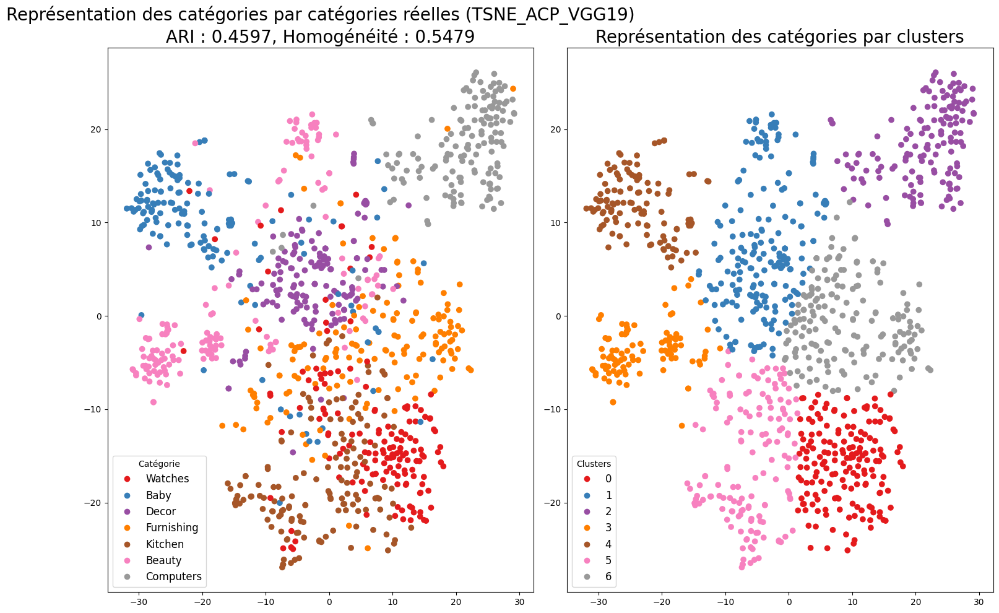

In [461]:
title = 'TSNE_ACP_VGG19'
# Réduction ACP pour 99% de variance

df_vgg19_vectors_acp = fonctions_data.acp(df_vgg19_vectors)

# Calcul des composantes TSNE.
df_vgg19_vectors_acp_tsne = fonctions_data.tsne(df_vgg19_vectors_acp, 50)

# kmeans
df_vgg19_vectors_acp_tsne_km, ARI, Homogeneite, labels = fonctions_data.kmeans(df_vgg19_vectors_acp_tsne, data_cat)

# visualisation
fonctions_data.affiche_projection_par_clusters(df_vgg19_vectors_acp_tsne_km, labels, ARI, Homogeneite, title)

**Sans l'étape de réduction d'ACP**

-----------------------------------------
 ARI  : 0.4501
 Homogénéité  : 0.5326
-----------------------------------------


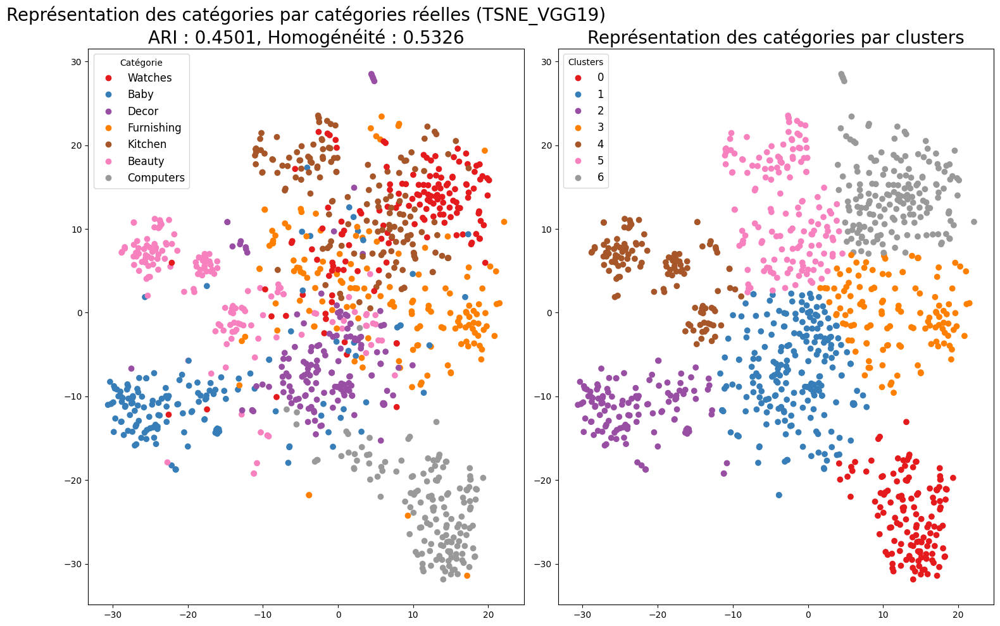

In [463]:
title = 'TSNE_VGG19'
# Calcul des composantes TSNE
df_vgg19_vectors_tsne = fonctions_data.tsne(df_vgg19_vectors, 50)

# kmeans
df_vgg19_vectors_tsne_km, ARI, Homogeneite, labels = fonctions_data.kmeans(df_vgg19_vectors_tsne, data_cat)

# visualisation
fonctions_data.affiche_projection_par_clusters(df_vgg19_vectors_tsne_km, labels, ARI, Homogeneite, title)

,precision,recall,f1-score,support
0,0.603550,0.680000,0.639498,150.000000
1,0.949153,0.746667,0.835821,150.000000
2,0.551020,0.720000,0.624277,150.000000
3,0.554913,0.640000,0.594427,150.000000
4,0.557823,0.546667,0.552189,150.000000
5,0.836735,0.546667,0.661290,150.000000
6,0.966443,0.960000,0.963211,150.000000
accuracy,0.691429,0.691429,0.691429,0.691429
macro avg,0.717091,0.691429,0.695816,1050.000000
weighted avg,0.717091,0.691429,0.695816,1050.000000


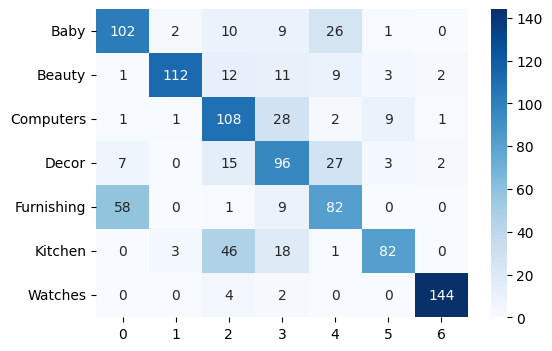

In [464]:
fonctions_data.conf_mat_metrics(df_vgg19_vectors_acp_tsne_km)

#### <span style='background:wheat'>5.4.3 InceptionV3</span>

In [451]:
# Utilisation de InceptionV3 pré-entraîné sur ImageNet avec les images
# d'origine
# InceptionV3 imports
from keras.applications.inception_v3 import preprocess_input
from keras.applications import InceptionV3


top_depart = time.time()

# Liste
incep_all_features = []

# Instanciation du modèle
model_incep = InceptionV3(weights='imagenet', include_top=False,  pooling='avg')#classes=7,
# Résumé de l'architecture du modèle
model_incep.summary()

for rep_image in data_imc_t['image_loc']:

    # Charger l'image et la redimensionner à la taille
    # requise de 299x299 pixels. le redimensionnement 224x224 a donné meilleur resultat
    img = image.load_img(rep_image, target_size=(224, 224))
    # Convertir les pixels en un tableau NumPy afin de pouvoir travailler
    # avec dans Keras
    img = image.img_to_array(img)
    # Redimensionnement
    img = np.expand_dims(img, axis=0)
    # Préparer de nouvelles entrées pour le réseau.
    img = preprocess_input(img)

    # obtenir une prédiction de la probabilité d'appartenance
    # de l'image à chacun des 1000 types d'objets connus.
    incep_feature = model_incep.predict(img)
    # Ajouter la feature prédite en nparray à la liste
    incep_all_features.append(np.array(incep_feature).flatten())

incep_all_features = np.array(incep_all_features)    
print(f"Temps d'execution : {round((time.time()-top_depart)/60, 3)} minutes")

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, None, None, 32)       864       ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, None, None, 32)       96        ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 activation (Activation)     (None, None, None, 32)       0         ['batch_normalizati

In [452]:
incep_all_features.shape

(1050, 2048)

In [453]:
# Dataframe de sauvegarde des BOVW InceptionV3
# Association des features à chaque image
data_imc_t['incep_bovw'] = \
    [incep_all_features[i] for i in range(data_imc_t.shape[0])]
# Dataframe de travail
df_incep_bovw = data_imc_t[['image', 'image_loc', 'Categorie_1', 'incep_bovw']]
 
# Constituer le dataframe de vecteurs de BOVW InceptionV3
df_incep_vectors = pd.DataFrame.from_records(incep_all_features)

**Réduction de dimension**

**TSNE/Kmeans**

Nombre de features après réduction ACP pour 99.0% de variance : 715
-----------------------------------------
 ARI  : 0.5434
 Homogénéité  : 0.5855
-----------------------------------------


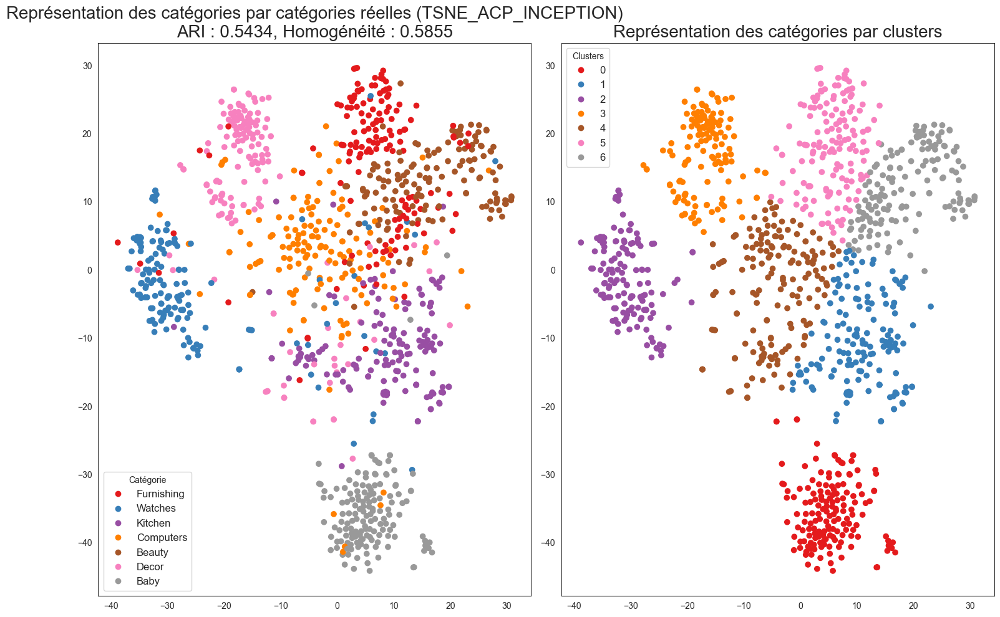

In [455]:
title = 'TSNE_ACP_INCEPTION'

# Réduction ACP pour 99% de variance

df_incep_vectors_acp_tsne = fonctions_data.acp(df_incep_vectors)

# Calcul des composantes TSNE
df_incep_vectors_acp_tsne = fonctions_data.tsne(df_incep_vectors_acp_tsne, 40)

# kmeans
df_incep_vectors_acp_tsne_km, ARI, Homogeneite, labels = fonctions_data.kmeans(df_incep_vectors_acp_tsne, data_cat)

# visualisation
fonctions_data.affiche_projection_par_clusters(df_incep_vectors_acp_tsne_km, labels, ARI, Homogeneite, title)

**Sans l'étape de réduction d'ACP**

-----------------------------------------
 ARI  : 0.5323
 Homogénéité  : 0.5892
-----------------------------------------


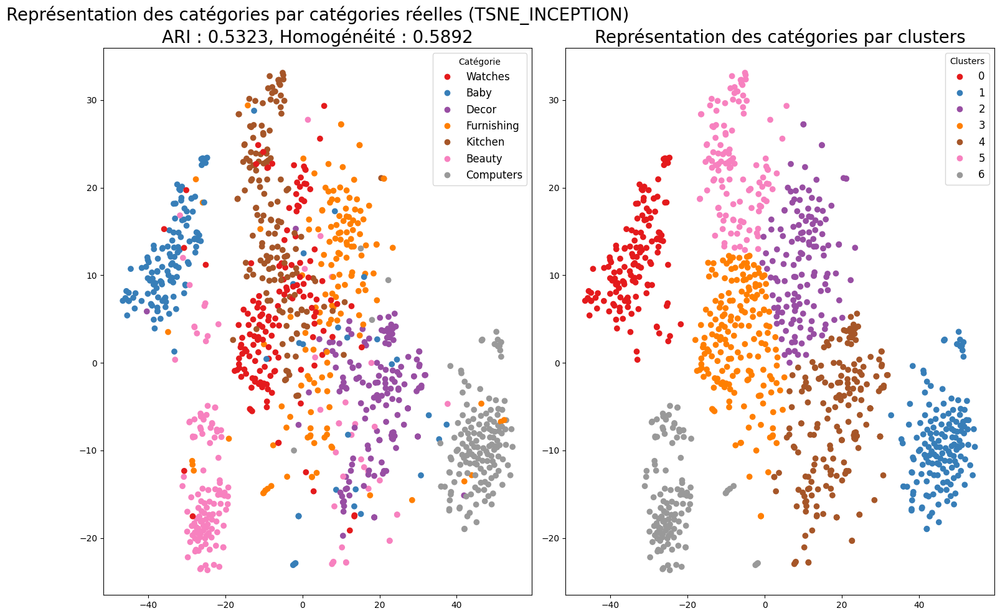

In [571]:
title = 'TSNE_INCEPTION'
# Calcul des composantes TSNE
df_incep_vectors_tsne = fonctions_data.tsne(df_incep_vectors, 40)

# kmeans
df_incep_vectors_tsne_km, ARI, Homogeneite, labels = fonctions_data.kmeans(df_incep_vectors_tsne, data_cat)

# visualisation
fonctions_data.affiche_projection_par_clusters(df_incep_vectors_tsne_km, labels, ARI, Homogeneite, title)

,precision,recall,f1-score,support
0,0.600000,0.600000,0.600000,150.000000
1,0.890511,0.813333,0.850174,150.000000
2,0.770701,0.806667,0.788274,150.000000
3,0.569697,0.626667,0.596825,150.000000
4,0.688742,0.693333,0.691030,150.000000
5,0.877863,0.766667,0.818505,150.000000
6,0.918239,0.973333,0.944984,150.000000
accuracy,0.754286,0.754286,0.754286,0.754286
macro avg,0.759393,0.754286,0.755685,1050.000000
weighted avg,0.759393,0.754286,0.755685,1050.000000


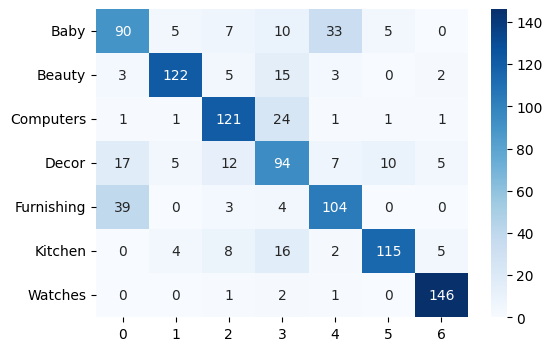

In [479]:
fonctions_data.conf_mat_metrics(df_incep_vectors_acp_tsne_km)

#### <span style='background:wheat'>5.4.4 Combinaison des meilleurs résultats des approches texte et image</span>

**InceptionV3 et TFIDF amélioré (Déscription)**

-----------------------------------------
 ARI  : 0.5539
 Homogénéité  : 0.679
-----------------------------------------


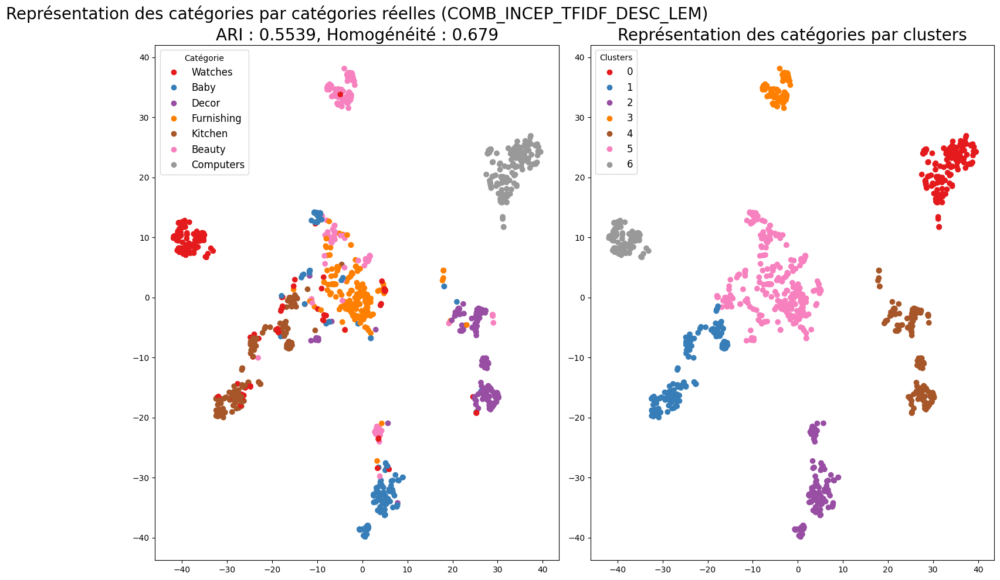

In [573]:
# Concaténation des matrices denses réduites des données textuelles et des images ARI 0.6334
# si jamais on n'a que la variable description et pas le nom du produit :

title = 'COMB_INCEP_TFIDF_DESC_LEM'

df_incep_vectors_tsne.rename(columns = {'DIM1':'VAR1', 'DIM2':'VAR2'}, inplace = True)
df_comb_incep_tfidf_desc = pd.concat([df_desc_lem_tf_tsne_freq, df_incep_vectors_acp_tsne],
                    axis=1) #, ignore_index=True)
 
# Calcul des composantes TSNE
df_comb_incep_tfidf_desc_tsne = fonctions_data.tsne(df_comb_incep_tfidf_desc, 40)

# kmeans
df_comb_incep_tfidf_desc_tsne_km, ARI, Homogeneite, labels = fonctions_data.kmeans(df_comb_incep_tfidf_desc_tsne, data_cat)


# visualisation
fonctions_data.affiche_projection_par_clusters(df_comb_incep_tfidf_desc_tsne_km, labels, ARI, Homogeneite, title)

,precision,recall,f1-score,support
0,1.000000,0.573333,0.728814,150.00
1,0.781022,0.713333,0.745645,150.00
2,0.831250,0.886667,0.858065,150.00
3,0.498221,0.933333,0.649652,150.00
4,0.801242,0.860000,0.829582,150.00
5,0.986667,0.493333,0.657778,150.00
6,1.000000,1.000000,1.000000,150.00
accuracy,0.780000,0.780000,0.780000,0.78
macro avg,0.842629,0.780000,0.781362,1050.00
weighted avg,0.842629,0.780000,0.781362,1050.00


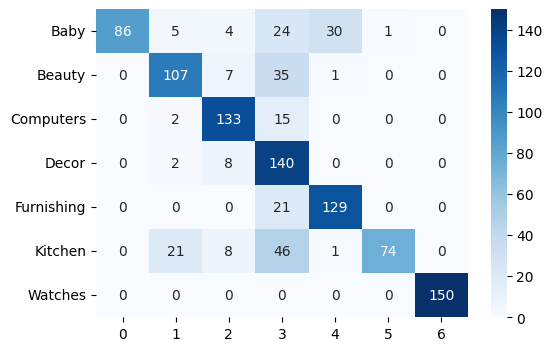

In [574]:
fonctions_data.conf_mat_metrics(df_comb_incep_tfidf_desc_tsne_km)

**USE5 (product_name) et InceptionV3**

-----------------------------------------
 ARI  : 0.6475
 Homogénéité  : 0.7289
-----------------------------------------


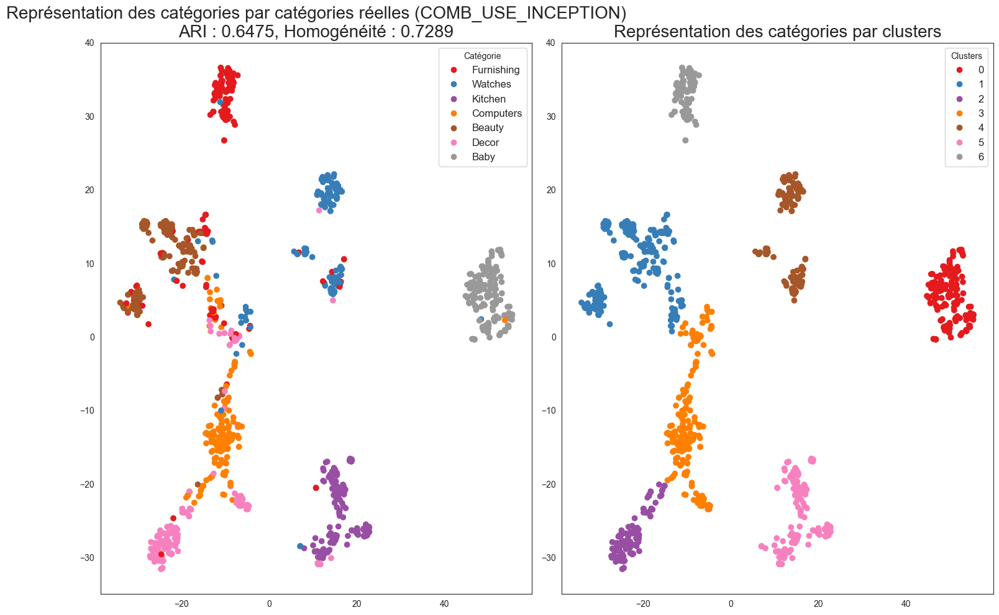

In [456]:
# Concaténation des matrices denses réduites des données textuelles et des images ARI 0.6334
# si jamais on n'a que la variable description et pas le nom du produit :
title = 'COMB_USE_INCEPTION'

df_incep_vectors_acp_tsne.rename(columns = {'DIM1':'VAR1', 'DIM2':'VAR2'}, inplace = True)
df_comb_use_incep = pd.concat([df_use_prod_tf_tsne, df_incep_vectors_acp_tsne],
                    axis=1) #, ignore_index=True)
 
# Calcul des composantes TSNE
df_comb_use_incep_tsne = fonctions_data.tsne(df_comb_use_incep, 40)

# kmeans
df_comb_use_incep_tsne_km, ARI, Homogeneite, labels = fonctions_data.kmeans(df_comb_use_incep_tsne, data_cat)


# visualisation
fonctions_data.affiche_projection_par_clusters(df_comb_use_incep_tsne_km, labels, ARI, Homogeneite, title)

Clusters,Nombre,%
0,155,14.760000
1,223,21.240000
2,102,9.710000
3,192,18.290000
4,134,12.760000
5,161,15.330000
6,83,7.900000


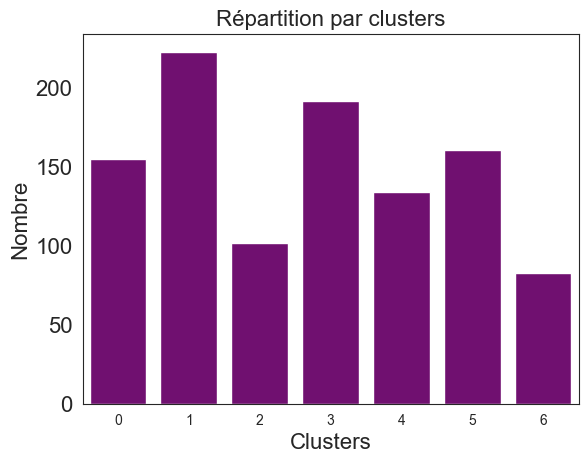

In [457]:
fonctions_data.affiche_repartition_par_clusters(labels)

,precision,recall,f1-score,support
0,0.987952,0.546667,0.703863,150.000000
1,0.932836,0.833333,0.880282,150.000000
2,0.931677,1.000000,0.964630,150.000000
3,0.609375,0.780000,0.684211,150.000000
4,0.645740,0.960000,0.772118,150.000000
5,0.862745,0.586667,0.698413,150.000000
6,0.967742,1.000000,0.983607,150.000000
accuracy,0.815238,0.815238,0.815238,0.815238
macro avg,0.848295,0.815238,0.812446,1050.000000
weighted avg,0.848295,0.815238,0.812446,1050.000000


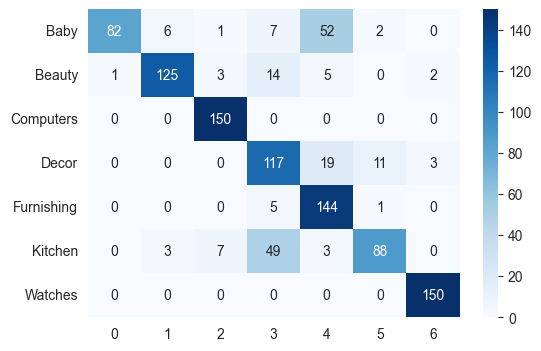

In [458]:
fonctions_data.conf_mat_metrics(df_comb_use_incep_tsne_km)

**Bilan**:

La classification automatique est bien possible à partir des données textes et des données images (avec les réseaux de neurones) avec des bons résultats de classification. La combinaison des deux approches texte et image a donné une meilleure performance sur l'ensemble des classes (matrice de confusion) avec **ARI = 65%**, un degré d'**homogénéité** de **75%**, et une **accuracy** de **81%**. L'utilisation d'une classification supervisée permettra d'obtenir encore une meilleure performance

## <span style='background:PowderBlue'>6. Classification Supervisée</span>

### <span style='background:orange'>6.1. NLP : Word & Text Embeddings</span>

### <span> **Fonction d'évaluation des modèles de classification (supervisée)** </span>

Afin de comparer les modèles de classification, nous avons évalué quatre indicateurs :

>- **Précision** : capacité à prédire correctement les tags associés à chaque document
> - **Recall** : capacité à retourner pour chaque tags tous les documents qui y sont associés
>- **F1 Score** : moyenne harmonique de ces deux indicateurs

Etant face à une classification multi-classes nous utilisons les version micro de ces indicateurs. Concrètement, cette version des indicateurs est calculée par classe puis agrégés là où les indicateurs macro sont calculés globalement. Lors de l’évaluation nous nous intéressons à la précision et au temps d’entraînement. 

In [318]:
models_performance = {}

#### <span style='background:wheat'>6.1.1 BERT</span>

#### <span style='background:gold'> 6.1.1.1 RoBERTa large model(nli-mean-tokens)</span>

<span style='background:orange'>**6.1.1.1.1 description** - originale (non nettoyée)</span>

In [315]:
cols = ['VAR1', 'VAR2']

In [623]:
# Variable dont on veut extraire les features
data_work['description'] = \
    data_work['description'].fillna('').astype(str)
data_desc_orig = data_work['description']

In [625]:
data_work.columns

Index(['category', 'product_name', 'brand', 'image', 'product_category_tree',
       'description', 'product_specifications', 'label', 'desc_clean',
       'pname_clean', 'brand_clean', 'prod_spec_clean', 'desc_lem',
       'pname_lem', 'brand_lem', 'prod_spec_lem', 'desc_stem', 'pname_stem',
       'brand_stem', 'prod_spec_stem', 'desc_lem_token'],
      dtype='object')

In [614]:
type_donnee = 'TSNE_ROBERTA_DESC_ORIG_LEM'

**Modélisation**

In [615]:
# Instanciation du modèle
bert_desc_orig = SentenceTransformer('roberta-large-nli-mean-tokens')

# Encodage
vector_roberta_desc_orig = \
    bert_desc_orig.encode(data_desc_orig, show_progress_bar=False)

In [617]:
# Réduction de dimension tsne
tsne_roberta_desc_orig = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_roberta_desc_orig = \
    tsne_roberta_desc_orig.fit_transform(vector_roberta_desc_orig)
# Dataframe pour clustering
df_tsne_roberta_desc_orig = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_desc_orig[:, 0],
                                          'VAR2' : X_proj_tsne_roberta_desc_orig[:, 1],
                                          'CATEGORIE' : data['Categorie_1']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.120s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 5.997525
[t-SNE] KL divergence after 250 iterations with early exaggeration: 60.106369
[t-SNE] KL divergence after 4750 iterations: 0.622526


**Jeu d'entrainement, et test**

In [627]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_desc_orig[cols], data_work.label, test_size=0.15, stratify=data_work.label, random_state=1944)

**Evaluation des modèles de classification supervisée**

**Algorithme KNN**

In [634]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.8991
Precision:
  - Macro: 0.8999
  - Micro: 0.8991
Recall:
  - Macro: 0.8991
  - Micro: 0.8991
F1-measure:
  - Macro: 0.8986
  - Micro: 0.8991


{'knn': {'micro_precision': 0.899103139013453,
  'micro_recall': 0.899103139013453,
  'micro_f1': 0.899103139013453}}

**Algorithme SVM**

In [635]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.4406
Precision:
  - Macro: 0.3709
  - Micro: 0.4406
Recall:
  - Macro: 0.4403
  - Micro: 0.4406
F1-measure:
  - Macro: 0.3766
  - Micro: 0.4406


{'knn': {'micro_precision': 0.899103139013453,
  'micro_recall': 0.899103139013453,
  'micro_f1': 0.899103139013453},
 'svm': {'micro_precision': 0.4405829596412556,
  'micro_recall': 0.4405829596412556,
  'micro_f1': 0.4405829596412556}}

**Algorithme Random Forest**

In [636]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.899103139013453,
  'micro_recall': 0.899103139013453,
  'micro_f1': 0.899103139013453},
 'svm': {'micro_precision': 0.4405829596412556,
  'micro_recall': 0.4405829596412556,
  'micro_f1': 0.4405829596412556},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Algorithme Gradient Boosting**

In [640]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9709
Precision:
  - Macro: 0.9718
  - Micro: 0.9709
Recall:
  - Macro: 0.9709
  - Micro: 0.9709
F1-measure:
  - Macro: 0.9708
  - Micro: 0.9709


{'knn': {'micro_precision': 0.899103139013453,
  'micro_recall': 0.899103139013453,
  'micro_f1': 0.899103139013453},
 'svm': {'micro_precision': 0.4405829596412556,
  'micro_recall': 0.4405829596412556,
  'micro_f1': 0.4405829596412556},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9708520179372198,
  'micro_recall': 0.9708520179372198,
  'micro_f1': 0.9708520179372198}}

**Algorithme Naive Bayes**

In [641]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.6345
Precision:
  - Macro: 0.6273
  - Micro: 0.6345
Recall:
  - Macro: 0.6348
  - Micro: 0.6345
F1-measure:
  - Macro: 0.6038
  - Micro: 0.6345


{'knn': {'micro_precision': 0.899103139013453,
  'micro_recall': 0.899103139013453,
  'micro_f1': 0.899103139013453},
 'svm': {'micro_precision': 0.4405829596412556,
  'micro_recall': 0.4405829596412556,
  'micro_f1': 0.4405829596412556},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9708520179372198,
  'micro_recall': 0.9708520179372198,
  'micro_f1': 0.9708520179372198},
 'Naive Bayes': {'micro_precision': 0.6345291479820628,
  'micro_recall': 0.6345291479820628,
  'micro_f1': 0.6345291479820628}}

**Extra Trees Classifier**

In [642]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.899103139013453,
  'micro_recall': 0.899103139013453,
  'micro_f1': 0.899103139013453},
 'svm': {'micro_precision': 0.4405829596412556,
  'micro_recall': 0.4405829596412556,
  'micro_f1': 0.4405829596412556},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9708520179372198,
  'micro_recall': 0.9708520179372198,
  'micro_f1': 0.9708520179372198},
 'Naive Bayes': {'micro_precision': 0.6345291479820628,
  'micro_recall': 0.6345291479820628,
  'micro_f1': 0.6345291479820628},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [643]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.899103,0.899103,0.899103
svm,0.440583,0.440583,0.440583
Random Forest,1.000000,1.000000,1.000000
Gradient Boosting,0.970852,0.970852,0.970852
Naive Bayes,0.634529,0.634529,0.634529
extra tree classifier,1.000000,1.000000,1.000000


Au vue des résulats des précisions des métriques, nous allons retenir l'algorithme 'Extra Tree Classifier'

**Entrainement du modèle**

In [644]:
from sklearn.ensemble import ExtraTreesClassifier

etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.861


In [647]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_desc_lem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_desc_lem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY TSNE_ROBERTA_DESC_ORIG_LEM (Test): {:.3}".format(accuracy_tsne_roberta_desc_lem_test))
print("ACCURACY TSNE_ROBERTA_DESC_ORIG_LEM (Train): {:.3}".format(accuracy_tsne_roberta_desc_lem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[19  1  0  0  3  0  0]
 [ 2 16  1  2  1  0  0]
 [ 0  0 23  0  0  0  0]
 [ 1  0  0 21  0  1  0]
 [ 3  0  0  2 18  0  0]
 [ 0  0  0  4  1 17  0]
 [ 0  0  0  0  0  0 22]]
Correspondance des clusters :  [0 1 2 3 4 5 6]
Correspondance des clusters :  [0 1 2 3 4 5 6]

ACCURACY TSNE_ROBERTA_DESC_ORIG_LEM (Test): 0.861
ACCURACY TSNE_ROBERTA_DESC_ORIG_LEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.76      0.83      0.79        23
           1       0.94      0.73      0.82        22
           2       0.96      1.00      0.98        23
           3       0.72      0.91      0.81        23
           4       0.78      0.78      0.78        23
           5       0.94      0.77      0.85        22
           6       1.00      1.00      1.00        22

    accuracy                           0.86       158
   macro avg       0.87      0.86      0.86       158
weighted avg       0.87      0.86      0.86       158



In [334]:
list_labels = ["Furnishing", "Baby", "Watches", "Decor", "Kitchen", \
               "Beauty", "Computers"]

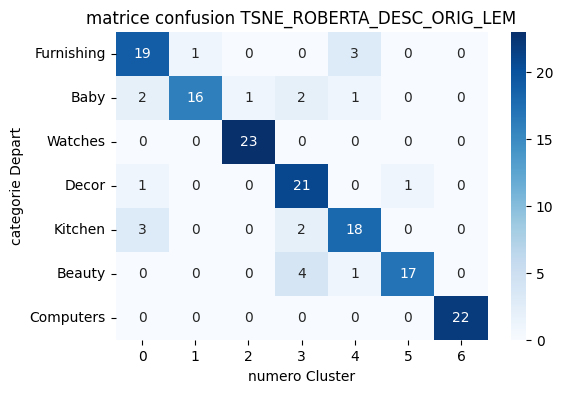

In [648]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.1.1.2 description** - nettoyée (lemmatisée)</span>

In [649]:
# Variable dont on veut extraire les features
data_work['desc_lem'] = \
    data_work['desc_lem'].fillna('').astype(str)
data_desc_lem = data_work['desc_lem']

In [650]:
type_donnee = 'TSNE_ROBERTA_DESC_LEM'

# Instanciation du modèle
bert_desc_lem = SentenceTransformer('roberta-large-nli-mean-tokens')

In [651]:
# Encodage
vector_roberta_desc_lem = \
    bert_desc_lem.encode(data_desc_lem, show_progress_bar=False)

In [654]:
# Réduction de dimension tsne
tsne_roberta_desc_lem = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_roberta_desc_lem = \
    tsne_roberta_desc_lem.fit_transform(vector_roberta_desc_lem)
# Dataframe pour clustering
df_tsne_roberta_desc_lem = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_desc_lem[:, 0],
                                           'VAR2' : X_proj_tsne_roberta_desc_lem[:, 1],
                                           'CATEGORIE' : data_work['category']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.004s...
[t-SNE] Computed neighbors for 1050 samples in 0.172s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 6.040918
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.387718
[t-SNE] KL divergence after 3150 iterations: 0.581791


**Jeu d'entrainement, et test**

In [655]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_desc_lem[cols], data_work.label, test_size=0.15, stratify=data_work.label, random_state=1944)

**Evaluation des modèles de classification supervisée**

**Algorithme KNN**

In [656]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.8969
Precision:
  - Macro: 0.8972
  - Micro: 0.8969
Recall:
  - Macro: 0.8967
  - Micro: 0.8969
F1-measure:
  - Macro: 0.8962
  - Micro: 0.8969


{'knn': {'micro_precision': 0.8968609865470852,
  'micro_recall': 0.8968609865470852,
  'micro_f1': 0.8968609865470852},
 'svm': {'micro_precision': 0.4405829596412556,
  'micro_recall': 0.4405829596412556,
  'micro_f1': 0.4405829596412556},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9708520179372198,
  'micro_recall': 0.9708520179372198,
  'micro_f1': 0.9708520179372198},
 'Naive Bayes': {'micro_precision': 0.6345291479820628,
  'micro_recall': 0.6345291479820628,
  'micro_f1': 0.6345291479820628},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Algorithme SVM**

In [657]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.3475
Precision:
  - Macro: 0.3046
  - Micro: 0.3475
Recall:
  - Macro: 0.3475
  - Micro: 0.3475
F1-measure:
  - Macro: 0.2980
  - Micro: 0.3475


{'knn': {'micro_precision': 0.8968609865470852,
  'micro_recall': 0.8968609865470852,
  'micro_f1': 0.8968609865470852},
 'svm': {'micro_precision': 0.3475336322869955,
  'micro_recall': 0.3475336322869955,
  'micro_f1': 0.3475336322869955},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9708520179372198,
  'micro_recall': 0.9708520179372198,
  'micro_f1': 0.9708520179372198},
 'Naive Bayes': {'micro_precision': 0.6345291479820628,
  'micro_recall': 0.6345291479820628,
  'micro_f1': 0.6345291479820628},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Algorithme RandomForest**

In [658]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8968609865470852,
  'micro_recall': 0.8968609865470852,
  'micro_f1': 0.8968609865470852},
 'svm': {'micro_precision': 0.3475336322869955,
  'micro_recall': 0.3475336322869955,
  'micro_f1': 0.3475336322869955},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9708520179372198,
  'micro_recall': 0.9708520179372198,
  'micro_f1': 0.9708520179372198},
 'Naive Bayes': {'micro_precision': 0.6345291479820628,
  'micro_recall': 0.6345291479820628,
  'micro_f1': 0.6345291479820628},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Algorithme Naive Bayes**

In [659]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.6177
Precision:
  - Macro: 0.6439
  - Micro: 0.6177
Recall:
  - Macro: 0.6174
  - Micro: 0.6177
F1-measure:
  - Macro: 0.6135
  - Micro: 0.6177


{'knn': {'micro_precision': 0.8968609865470852,
  'micro_recall': 0.8968609865470852,
  'micro_f1': 0.8968609865470852},
 'svm': {'micro_precision': 0.3475336322869955,
  'micro_recall': 0.3475336322869955,
  'micro_f1': 0.3475336322869955},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9708520179372198,
  'micro_recall': 0.9708520179372198,
  'micro_f1': 0.9708520179372198},
 'Naive Bayes': {'micro_precision': 0.6177130044843049,
  'micro_recall': 0.6177130044843049,
  'micro_f1': 0.6177130044843049},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Algorithme Gradient Boosting**

In [660]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9720
Precision:
  - Macro: 0.9731
  - Micro: 0.9720
Recall:
  - Macro: 0.9719
  - Micro: 0.9720
F1-measure:
  - Macro: 0.9719
  - Micro: 0.9720


{'knn': {'micro_precision': 0.8968609865470852,
  'micro_recall': 0.8968609865470852,
  'micro_f1': 0.8968609865470852},
 'svm': {'micro_precision': 0.3475336322869955,
  'micro_recall': 0.3475336322869955,
  'micro_f1': 0.3475336322869955},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9719730941704036,
  'micro_recall': 0.9719730941704036,
  'micro_f1': 0.9719730941704036},
 'Naive Bayes': {'micro_precision': 0.6177130044843049,
  'micro_recall': 0.6177130044843049,
  'micro_f1': 0.6177130044843049},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Extra Trees Classifier**

In [661]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8968609865470852,
  'micro_recall': 0.8968609865470852,
  'micro_f1': 0.8968609865470852},
 'svm': {'micro_precision': 0.3475336322869955,
  'micro_recall': 0.3475336322869955,
  'micro_f1': 0.3475336322869955},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9719730941704036,
  'micro_recall': 0.9719730941704036,
  'micro_f1': 0.9719730941704036},
 'Naive Bayes': {'micro_precision': 0.6177130044843049,
  'micro_recall': 0.6177130044843049,
  'micro_f1': 0.6177130044843049},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [662]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.896861,0.896861,0.896861
svm,0.347534,0.347534,0.347534
Random Forest,1.000000,1.000000,1.000000
Gradient Boosting,0.971973,0.971973,0.971973
Naive Bayes,0.617713,0.617713,0.617713
extra tree classifier,1.000000,1.000000,1.000000


On retient l'algo Extra Tree Classifier

**Entrainement du modèle**

In [663]:
from sklearn.ensemble import ExtraTreesClassifier

etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.861


In [664]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_desc_lem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_desc_lem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY TSNE_ROBERTA_DESC_LEM (Test): {:.3}".format(accuracy_tsne_roberta_desc_lem_test))
print("ACCURACY TSNE_ROBERTA_DESC_LEM (Train): {:.3}".format(accuracy_tsne_roberta_desc_lem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[21  0  1  0  1  0  0]
 [ 2 15  0  2  2  1  0]
 [ 0  0 22  1  0  0  0]
 [ 0  0  0 21  0  2  0]
 [ 5  0  0  1 17  0  0]
 [ 1  0  0  3  0 18  0]
 [ 0  0  0  0  0  0 22]]
Correspondance des clusters :  [0 1 2 3 4 5 6]
Correspondance des clusters :  [0 1 2 3 4 5 6]

ACCURACY TSNE_ROBERTA_DESC_LEM (Test): 0.861
ACCURACY TSNE_ROBERTA_DESC_LEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.72      0.91      0.81        23
           1       1.00      0.68      0.81        22
           2       0.96      0.96      0.96        23
           3       0.75      0.91      0.82        23
           4       0.85      0.74      0.79        23
           5       0.86      0.82      0.84        22
           6       1.00      1.00      1.00        22

    accuracy                           0.86       158
   macro avg       0.88      0.86      0.86       158
weighted avg       0.88      0.86      0.86       158



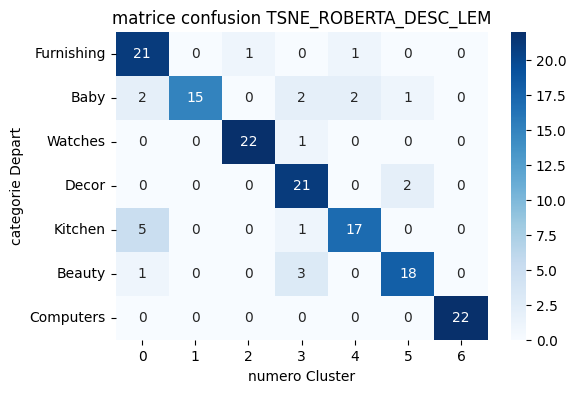

In [665]:
list_labels = ["Furnishing", "Baby", "Watches", "Decor", "Kitchen", \
               "Beauty", "Computers"]

df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.1.1.3 description** - nettoyée (racinisée)</span>

In [666]:
# Variable dont on veut extraire les features
data_work['desc_stem'] = \
    data_work['desc_stem'].fillna('').astype(str)
data_desc_stem = data_work['desc_stem']

In [667]:
type_donnee = 'TSNE_ROBERTA_DESC_STEM'

# Instanciation du modèle
bert_desc_stem = SentenceTransformer('roberta-large-nli-mean-tokens')

In [668]:
# Encodage
vector_roberta_desc_stem = \
    bert_desc_orig.encode(data_desc_stem, show_progress_bar=False)

In [670]:
# Réduction de dimension tsne
tsne_roberta_desc_stem = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_roberta_desc_stem = \
    tsne_roberta_desc_stem.fit_transform(vector_roberta_desc_stem)
# Dataframe pour clustering
df_tsne_roberta_desc_stem = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_desc_stem[:, 0],
                                           'VAR2' : X_proj_tsne_roberta_desc_stem[:, 1],
                                           'CATEGORIE' : data_work['category']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.251s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 6.399504
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.936996
[t-SNE] KL divergence after 3750 iterations: 0.635992


**Entrainement du modèle**

In [671]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_desc_stem[cols], data_work.label, test_size=0.15, stratify=data_work.label, random_state=1944)

In [672]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.9025
Precision:
  - Macro: 0.9031
  - Micro: 0.9025
Recall:
  - Macro: 0.9024
  - Micro: 0.9025
F1-measure:
  - Macro: 0.9022
  - Micro: 0.9025


{'knn': {'micro_precision': 0.9024663677130045,
  'micro_recall': 0.9024663677130045,
  'micro_f1': 0.9024663677130045},
 'svm': {'micro_precision': 0.3475336322869955,
  'micro_recall': 0.3475336322869955,
  'micro_f1': 0.3475336322869955},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9719730941704036,
  'micro_recall': 0.9719730941704036,
  'micro_f1': 0.9719730941704036},
 'Naive Bayes': {'micro_precision': 0.6177130044843049,
  'micro_recall': 0.6177130044843049,
  'micro_f1': 0.6177130044843049},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [673]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.4417
Precision:
  - Macro: 0.3350
  - Micro: 0.4417
Recall:
  - Macro: 0.4418
  - Micro: 0.4417
F1-measure:
  - Macro: 0.3626
  - Micro: 0.4417


{'knn': {'micro_precision': 0.9024663677130045,
  'micro_recall': 0.9024663677130045,
  'micro_f1': 0.9024663677130045},
 'svm': {'micro_precision': 0.44170403587443946,
  'micro_recall': 0.44170403587443946,
  'micro_f1': 0.44170403587443946},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9719730941704036,
  'micro_recall': 0.9719730941704036,
  'micro_f1': 0.9719730941704036},
 'Naive Bayes': {'micro_precision': 0.6177130044843049,
  'micro_recall': 0.6177130044843049,
  'micro_f1': 0.6177130044843049},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [674]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9024663677130045,
  'micro_recall': 0.9024663677130045,
  'micro_f1': 0.9024663677130045},
 'svm': {'micro_precision': 0.44170403587443946,
  'micro_recall': 0.44170403587443946,
  'micro_f1': 0.44170403587443946},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9719730941704036,
  'micro_recall': 0.9719730941704036,
  'micro_f1': 0.9719730941704036},
 'Naive Bayes': {'micro_precision': 0.6177130044843049,
  'micro_recall': 0.6177130044843049,
  'micro_f1': 0.6177130044843049},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [675]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.6121
Precision:
  - Macro: 0.6237
  - Micro: 0.6121
Recall:
  - Macro: 0.6119
  - Micro: 0.6121
F1-measure:
  - Macro: 0.6067
  - Micro: 0.6121


{'knn': {'micro_precision': 0.9024663677130045,
  'micro_recall': 0.9024663677130045,
  'micro_f1': 0.9024663677130045},
 'svm': {'micro_precision': 0.44170403587443946,
  'micro_recall': 0.44170403587443946,
  'micro_f1': 0.44170403587443946},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9719730941704036,
  'micro_recall': 0.9719730941704036,
  'micro_f1': 0.9719730941704036},
 'Naive Bayes': {'micro_precision': 0.6121076233183856,
  'micro_recall': 0.6121076233183856,
  'micro_f1': 0.6121076233183856},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [676]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9809
Precision:
  - Macro: 0.9810
  - Micro: 0.9809
Recall:
  - Macro: 0.9809
  - Micro: 0.9809
F1-measure:
  - Macro: 0.9809
  - Micro: 0.9809


{'knn': {'micro_precision': 0.9024663677130045,
  'micro_recall': 0.9024663677130045,
  'micro_f1': 0.9024663677130045},
 'svm': {'micro_precision': 0.44170403587443946,
  'micro_recall': 0.44170403587443946,
  'micro_f1': 0.44170403587443946},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9809417040358744,
  'micro_recall': 0.9809417040358744,
  'micro_f1': 0.9809417040358744},
 'Naive Bayes': {'micro_precision': 0.6121076233183856,
  'micro_recall': 0.6121076233183856,
  'micro_f1': 0.6121076233183856},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [677]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9024663677130045,
  'micro_recall': 0.9024663677130045,
  'micro_f1': 0.9024663677130045},
 'svm': {'micro_precision': 0.44170403587443946,
  'micro_recall': 0.44170403587443946,
  'micro_f1': 0.44170403587443946},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9809417040358744,
  'micro_recall': 0.9809417040358744,
  'micro_f1': 0.9809417040358744},
 'Naive Bayes': {'micro_precision': 0.6121076233183856,
  'micro_recall': 0.6121076233183856,
  'micro_f1': 0.6121076233183856},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [678]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.902466,0.902466,0.902466
svm,0.441704,0.441704,0.441704
Random Forest,1.000000,1.000000,1.000000
Gradient Boosting,0.980942,0.980942,0.980942
Naive Bayes,0.612108,0.612108,0.612108
extra tree classifier,1.000000,1.000000,1.000000


In [679]:
from sklearn.ensemble import ExtraTreesClassifier

etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.854


In [681]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_desc_lem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_desc_lem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY TSNE_ROBERTA_DESC_STEM (Test): {:.3}".format(accuracy_tsne_roberta_desc_lem_test))
print("ACCURACY TSNE_ROBERTA_DESC_STEM (Train): {:.3}".format(accuracy_tsne_roberta_desc_lem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[18  1  0  0  4  0  0]
 [ 1 16  1  1  2  1  0]
 [ 0  1 21  0  0  1  0]
 [ 2  1  0 20  0  0  0]
 [ 2  0  0  1 20  0  0]
 [ 1  0  2  1  0 18  0]
 [ 0  0  0  0  0  0 22]]
Correspondance des clusters :  [0 1 2 3 4 5 6]
Correspondance des clusters :  [0 1 2 3 4 5 6]

ACCURACY TSNE_ROBERTA_DESC_STEM (Test): 0.854
ACCURACY TSNE_ROBERTA_DESC_STEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.75      0.78      0.77        23
           1       0.84      0.73      0.78        22
           2       0.88      0.91      0.89        23
           3       0.87      0.87      0.87        23
           4       0.77      0.87      0.82        23
           5       0.90      0.82      0.86        22
           6       1.00      1.00      1.00        22

    accuracy                           0.85       158
   macro avg       0.86      0.85      0.85       158
weighted avg       0.86      0.85      0.85       158



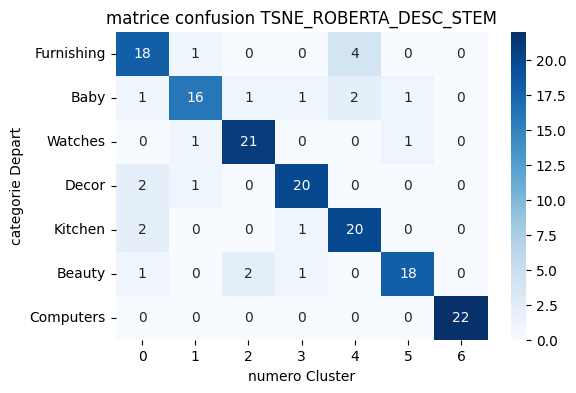

In [682]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.1.1.4 produit_specifications** - originale (non nettoyée)</span>

In [117]:
# Variable dont on veut extraire les features
data_work['product_specifications'] = \
    data_work['product_specifications'].fillna('').astype(str)
data_prods_orig = data_work['product_specifications']

type_donnee = 'TSNE_ROBERTA_PRODS_ORIG'

In [108]:
data_work.head(2)

,category,product_name,brand,image,product_category_tree,description,product_specifications,label,desc_clean,pname_clean,brand_clean,prod_spec_clean,desc_lem,pname_lem,brand_lem,prod_spec_lem,desc_stem,pname_stem,brand_stem,prod_spec_stem
0,Furnishing,Elegance Polyester Multicolor Abstract Eyelet ...,Elegance,55b85ea15a1536d46b7190ad6fff8ce7.jpg,"[""Home Furnishing >> Curtains & Accessories >>...",Key Features of Elegance Polyester Multicolor ...,"{""product_specification""=>[{""key""=>""Brand"", ""v...",4,key elegance polyester multicolor abstract eye...,elegance polyester multicolor abstract eyelet ...,elegance,product specification key brand value elegance...,key elegance polyester multicolor abstract eye...,elegance polyester multicolor abstract eyelet ...,elegance,product specification key brand value elegance...,key eleg polyest multicolor abstract eyelet do...,eleg polyest multicolor abstract eyelet door c...,eleg,product specif key brand valu eleg key valu do...
1,Baby,Sathiyas Cotton Bath Towel,Sathiyas,7b72c92c2f6c40268628ec5f14c6d590.jpg,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Specifications of Sathiyas Cotton Bath Towel (...,"{""product_specification""=>[{""key""=>""Machine Wa...",0,sathiyas cotton bath towel bath towel yellow b...,sathiyas cotton bath towel,sathiyas,product specification key machine washable val...,sathiyas cotton bath towel bath towel yellow b...,sathiyas cotton bath towel,sathiyas,product specification key machine washable val...,sathiya cotton bath towel bath towel yellow bl...,sathiya cotton bath towel,sathiya,product specif key machin washabl valu key mat...


In [684]:
# Instanciation du modèle
bert_prods_orig = SentenceTransformer('roberta-large-nli-mean-tokens')

# Encodage
vector_roberta_prods_orig = \
    bert_prods_orig.encode(data_prods_orig, show_progress_bar=False)

In [687]:
# Réduction de dimension tsne
tsne_roberta_prods_orig = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_roberta_prods_orig = \
    tsne_roberta_prods_orig.fit_transform(vector_roberta_prods_orig)
# Dataframe pour clustering
df_tsne_roberta_prods_orig = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_prods_orig[:, 0],
                                           'VAR2' : X_proj_tsne_roberta_prods_orig[:, 1],
                                           'CATEGORIE' : data_work['category']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.002s...
[t-SNE] Computed neighbors for 1050 samples in 0.070s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 6.637494
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.342308
[t-SNE] KL divergence after 2500 iterations: 0.790125


In [688]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_prods_orig[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [689]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.8988
Precision:
  - Macro: 0.8997
  - Micro: 0.8988
Recall:
  - Macro: 0.8988
  - Micro: 0.8988
F1-measure:
  - Macro: 0.8987
  - Micro: 0.8988


{'knn': {'micro_precision': 0.8988095238095238,
  'micro_recall': 0.8988095238095238,
  'micro_f1': 0.8988095238095238},
 'svm': {'micro_precision': 0.44170403587443946,
  'micro_recall': 0.44170403587443946,
  'micro_f1': 0.44170403587443946},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9809417040358744,
  'micro_recall': 0.9809417040358744,
  'micro_f1': 0.9809417040358744},
 'Naive Bayes': {'micro_precision': 0.6121076233183856,
  'micro_recall': 0.6121076233183856,
  'micro_f1': 0.6121076233183856},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [690]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.5024
Precision:
  - Macro: 0.4611
  - Micro: 0.5024
Recall:
  - Macro: 0.5024
  - Micro: 0.5024
F1-measure:
  - Macro: 0.4474
  - Micro: 0.5024


{'knn': {'micro_precision': 0.8988095238095238,
  'micro_recall': 0.8988095238095238,
  'micro_f1': 0.8988095238095238},
 'svm': {'micro_precision': 0.5023809523809524,
  'micro_recall': 0.5023809523809524,
  'micro_f1': 0.5023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9809417040358744,
  'micro_recall': 0.9809417040358744,
  'micro_f1': 0.9809417040358744},
 'Naive Bayes': {'micro_precision': 0.6121076233183856,
  'micro_recall': 0.6121076233183856,
  'micro_f1': 0.6121076233183856},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [691]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8988095238095238,
  'micro_recall': 0.8988095238095238,
  'micro_f1': 0.8988095238095238},
 'svm': {'micro_precision': 0.5023809523809524,
  'micro_recall': 0.5023809523809524,
  'micro_f1': 0.5023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9809417040358744,
  'micro_recall': 0.9809417040358744,
  'micro_f1': 0.9809417040358744},
 'Naive Bayes': {'micro_precision': 0.6121076233183856,
  'micro_recall': 0.6121076233183856,
  'micro_f1': 0.6121076233183856},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [692]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.7083
Precision:
  - Macro: 0.7121
  - Micro: 0.7083
Recall:
  - Macro: 0.7083
  - Micro: 0.7083
F1-measure:
  - Macro: 0.7056
  - Micro: 0.7083


{'knn': {'micro_precision': 0.8988095238095238,
  'micro_recall': 0.8988095238095238,
  'micro_f1': 0.8988095238095238},
 'svm': {'micro_precision': 0.5023809523809524,
  'micro_recall': 0.5023809523809524,
  'micro_f1': 0.5023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9809417040358744,
  'micro_recall': 0.9809417040358744,
  'micro_f1': 0.9809417040358744},
 'Naive Bayes': {'micro_precision': 0.7083333333333334,
  'micro_recall': 0.7083333333333334,
  'micro_f1': 0.7083333333333334},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [693]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9762
Precision:
  - Macro: 0.9768
  - Micro: 0.9762
Recall:
  - Macro: 0.9762
  - Micro: 0.9762
F1-measure:
  - Macro: 0.9764
  - Micro: 0.9762


{'knn': {'micro_precision': 0.8988095238095238,
  'micro_recall': 0.8988095238095238,
  'micro_f1': 0.8988095238095238},
 'svm': {'micro_precision': 0.5023809523809524,
  'micro_recall': 0.5023809523809524,
  'micro_f1': 0.5023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9761904761904762,
  'micro_recall': 0.9761904761904762,
  'micro_f1': 0.9761904761904762},
 'Naive Bayes': {'micro_precision': 0.7083333333333334,
  'micro_recall': 0.7083333333333334,
  'micro_f1': 0.7083333333333334},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [694]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8988095238095238,
  'micro_recall': 0.8988095238095238,
  'micro_f1': 0.8988095238095238},
 'svm': {'micro_precision': 0.5023809523809524,
  'micro_recall': 0.5023809523809524,
  'micro_f1': 0.5023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Gradient Boosting': {'micro_precision': 0.9761904761904762,
  'micro_recall': 0.9761904761904762,
  'micro_f1': 0.9761904761904762},
 'Naive Bayes': {'micro_precision': 0.7083333333333334,
  'micro_recall': 0.7083333333333334,
  'micro_f1': 0.7083333333333334},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [695]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.898810,0.898810,0.898810
svm,0.502381,0.502381,0.502381
Random Forest,1.000000,1.000000,1.000000
Gradient Boosting,0.976190,0.976190,0.976190
Naive Bayes,0.708333,0.708333,0.708333
extra tree classifier,1.000000,1.000000,1.000000


In [696]:
from sklearn.ensemble import ExtraTreesClassifier

etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.838


In [698]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_desc_lem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_desc_lem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_desc_lem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_desc_lem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[22  2  0  0  5  1  0]
 [ 1 22  3  1  0  3  0]
 [ 0  1 27  0  0  2  0]
 [ 0  1  0 27  1  1  0]
 [ 5  0  0  1 24  0  0]
 [ 0  0  1  3  0 26  0]
 [ 0  0  0  2  0  0 28]]
Correspondance des clusters :  [0 1 2 3 4 5 6]
Correspondance des clusters :  [0 1 2 3 4 5 6]

ACCURACY TSNE_ROBERTA_PRODS_ORIG (Test): 0.838
ACCURACY TSNE_ROBERTA_PRODS_ORIG (Train): 1.0


              precision    recall  f1-score   support

           0       0.79      0.73      0.76        30
           1       0.85      0.73      0.79        30
           2       0.87      0.90      0.89        30
           3       0.79      0.90      0.84        30
           4       0.80      0.80      0.80        30
           5       0.79      0.87      0.83        30
           6       1.00      0.93      0.97        30

    accuracy                           0.84       210
   macro avg       0.84      0.84      0.84       210
weighted avg       0.84      0.84      0.84       210



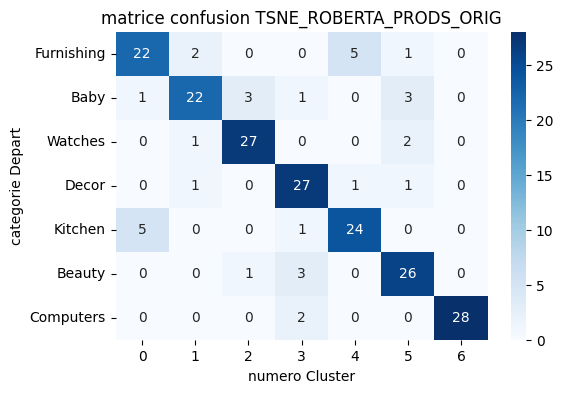

In [699]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.1.1.5 product_specifications** - nettoyé (non racinisé et non lemmatisé)</span>

In [27]:
# Variable dont on veut extraire les features
data_work['prod_spec_clean'] = \
    data_work['prod_spec_clean'].fillna('').astype(str)
data_prods_clean = data_work['prod_spec_clean']

In [28]:
type_donnee = 'TSNE_ROBERTA_PRODS_CLEAN'

# Instanciation du modèle
bert_prods_clean = SentenceTransformer('roberta-large-nli-mean-tokens')

# Encodage
vector_roberta_prods_clean = \
    bert_prods_clean.encode(data_prods_clean, show_progress_bar=False)

In [30]:
# Réduction de dimension tsne
tsne_roberta_prods_clean = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_roberta_prods_clean = \
    tsne_roberta_prods_clean.fit_transform(vector_roberta_prods_clean)
# Dataframe pour clustering
df_tsne_roberta_prods_clean = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_prods_clean[:, 0],
                                           'VAR2' : X_proj_tsne_roberta_prods_clean[:, 1],
                                           'CATEGORIE' : data_work['category']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.003s...
[t-SNE] Computed neighbors for 1050 samples in 0.082s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 7.370405
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.607796
[t-SNE] KL divergence after 2350 iterations: 0.668781


**Entrainement du modèle**

In [33]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_prods_clean[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [36]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.8857
Precision:
  - Macro: 0.8878
  - Micro: 0.8857
Recall:
  - Macro: 0.8857
  - Micro: 0.8857
F1-measure:
  - Macro: 0.8852
  - Micro: 0.8857


{'knn': {'micro_precision': 0.8857142857142857,
  'micro_recall': 0.8857142857142857,
  'micro_f1': 0.8857142857142857}}

In [37]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.6262
Precision:
  - Macro: 0.5836
  - Micro: 0.6262
Recall:
  - Macro: 0.6262
  - Micro: 0.6262
F1-measure:
  - Macro: 0.5700
  - Micro: 0.6262


{'knn': {'micro_precision': 0.8857142857142857,
  'micro_recall': 0.8857142857142857,
  'micro_f1': 0.8857142857142857},
 'svm': {'micro_precision': 0.6261904761904762,
  'micro_recall': 0.6261904761904762,
  'micro_f1': 0.6261904761904762}}

In [38]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8857142857142857,
  'micro_recall': 0.8857142857142857,
  'micro_f1': 0.8857142857142857},
 'svm': {'micro_precision': 0.6261904761904762,
  'micro_recall': 0.6261904761904762,
  'micro_f1': 0.6261904761904762},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [39]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.8024
Precision:
  - Macro: 0.8043
  - Micro: 0.8024
Recall:
  - Macro: 0.8024
  - Micro: 0.8024
F1-measure:
  - Macro: 0.8022
  - Micro: 0.8024


{'knn': {'micro_precision': 0.8857142857142857,
  'micro_recall': 0.8857142857142857,
  'micro_f1': 0.8857142857142857},
 'svm': {'micro_precision': 0.6261904761904762,
  'micro_recall': 0.6261904761904762,
  'micro_f1': 0.6261904761904762},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.8023809523809524,
  'micro_recall': 0.8023809523809524,
  'micro_f1': 0.8023809523809524}}

In [40]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9762
Precision:
  - Macro: 0.9768
  - Micro: 0.9762
Recall:
  - Macro: 0.9762
  - Micro: 0.9762
F1-measure:
  - Macro: 0.9761
  - Micro: 0.9762


{'knn': {'micro_precision': 0.8857142857142857,
  'micro_recall': 0.8857142857142857,
  'micro_f1': 0.8857142857142857},
 'svm': {'micro_precision': 0.6261904761904762,
  'micro_recall': 0.6261904761904762,
  'micro_f1': 0.6261904761904762},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.8023809523809524,
  'micro_recall': 0.8023809523809524,
  'micro_f1': 0.8023809523809524},
 'Gradient Boosting': {'micro_precision': 0.9761904761904762,
  'micro_recall': 0.9761904761904762,
  'micro_f1': 0.9761904761904762}}

In [41]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8857142857142857,
  'micro_recall': 0.8857142857142857,
  'micro_f1': 0.8857142857142857},
 'svm': {'micro_precision': 0.6261904761904762,
  'micro_recall': 0.6261904761904762,
  'micro_f1': 0.6261904761904762},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.8023809523809524,
  'micro_recall': 0.8023809523809524,
  'micro_f1': 0.8023809523809524},
 'Gradient Boosting': {'micro_precision': 0.9761904761904762,
  'micro_recall': 0.9761904761904762,
  'micro_f1': 0.9761904761904762},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [42]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.885714,0.885714,0.885714
svm,0.626190,0.626190,0.626190
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.802381,0.802381,0.802381
Gradient Boosting,0.976190,0.976190,0.976190
extra tree classifier,1.000000,1.000000,1.000000


In [43]:
from sklearn.ensemble import ExtraTreesClassifier

etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.881


In [51]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_prods_clean_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_prods_clean_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_prods_clean_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_prods_clean_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[23  1  1  0  5  0  0]
 [ 0 24  2  1  0  1  2]
 [ 1  0 28  0  1  0  0]
 [ 0  0  0 27  0  3  0]
 [ 2  0  0  2 26  0  0]
 [ 0  0  0  2  0 27  1]
 [ 0  0  0  0  0  0 30]]

ACCURACY TSNE_ROBERTA_PRODS_CLEAN (Test): 0.881
ACCURACY TSNE_ROBERTA_PRODS_CLEAN (Train): 1.0


              precision    recall  f1-score   support

           0       0.88      0.77      0.82        30
           1       0.96      0.80      0.87        30
           2       0.90      0.93      0.92        30
           3       0.84      0.90      0.87        30
           4       0.81      0.87      0.84        30
           5       0.87      0.90      0.89        30
           6       0.91      1.00      0.95        30

    accuracy                           0.88       210
   macro avg       0.88      0.88      0.88       210
weighted avg       0.88      0.88      0.88       210



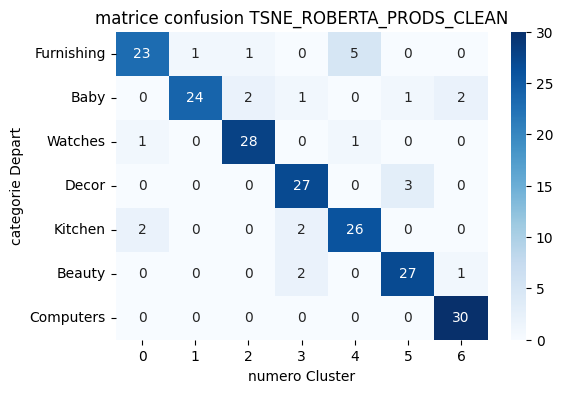

In [55]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.1.1.6  produit_specifications** - nettoyée (lemmatisée)</span>

In [57]:
# Variable dont on veut extraire les features
data_work['prod_spec_lem'] = \
    data_work['prod_spec_lem'].fillna('').astype(str)
data_prods_lem = data_work['prod_spec_lem']

In [58]:
type_donnee = 'TSNE_ROBERTA_PRODS_LEM'

# Instanciation du modèle
bert_prods_lem = SentenceTransformer('roberta-large-nli-mean-tokens')

# Encodage
vector_roberta_prods_lem = \
    bert_prods_lem.encode(data_prods_lem, show_progress_bar=False)

In [60]:
# Réduction de dimension tsne
tsne_roberta_prods_lem = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_roberta_prods_lem = \
    tsne_roberta_prods_lem.fit_transform(vector_roberta_prods_lem)
# Dataframe pour clustering
df_tsne_roberta_prods_lem = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_prods_lem[:, 0],
                                           'VAR2' : X_proj_tsne_roberta_prods_lem[:, 1],
                                           'CATEGORIE' : data_work['category']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.002s...
[t-SNE] Computed neighbors for 1050 samples in 0.071s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 7.370405
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.607830
[t-SNE] KL divergence after 3550 iterations: 0.668928


**Entrainement du modèle**

In [62]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_prods_lem[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [63]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.8869
Precision:
  - Macro: 0.8900
  - Micro: 0.8869
Recall:
  - Macro: 0.8869
  - Micro: 0.8869
F1-measure:
  - Macro: 0.8865
  - Micro: 0.8869


{'knn': {'micro_precision': 0.8869047619047619,
  'micro_recall': 0.8869047619047619,
  'micro_f1': 0.8869047619047619}}

In [64]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.5417
Precision:
  - Macro: 0.6515
  - Micro: 0.5417
Recall:
  - Macro: 0.5417
  - Micro: 0.5417
F1-measure:
  - Macro: 0.5133
  - Micro: 0.5417


{'knn': {'micro_precision': 0.8869047619047619,
  'micro_recall': 0.8869047619047619,
  'micro_f1': 0.8869047619047619},
 'svm': {'micro_precision': 0.5416666666666666,
  'micro_recall': 0.5416666666666666,
  'micro_f1': 0.5416666666666666}}

In [65]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8869047619047619,
  'micro_recall': 0.8869047619047619,
  'micro_f1': 0.8869047619047619},
 'svm': {'micro_precision': 0.5416666666666666,
  'micro_recall': 0.5416666666666666,
  'micro_f1': 0.5416666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [66]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.8071
Precision:
  - Macro: 0.8103
  - Micro: 0.8071
Recall:
  - Macro: 0.8071
  - Micro: 0.8071
F1-measure:
  - Macro: 0.8073
  - Micro: 0.8071


{'knn': {'micro_precision': 0.8869047619047619,
  'micro_recall': 0.8869047619047619,
  'micro_f1': 0.8869047619047619},
 'svm': {'micro_precision': 0.5416666666666666,
  'micro_recall': 0.5416666666666666,
  'micro_f1': 0.5416666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.8071428571428572,
  'micro_recall': 0.8071428571428572,
  'micro_f1': 0.8071428571428572}}

In [67]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9714
Precision:
  - Macro: 0.9719
  - Micro: 0.9714
Recall:
  - Macro: 0.9714
  - Micro: 0.9714
F1-measure:
  - Macro: 0.9713
  - Micro: 0.9714


{'knn': {'micro_precision': 0.8869047619047619,
  'micro_recall': 0.8869047619047619,
  'micro_f1': 0.8869047619047619},
 'svm': {'micro_precision': 0.5416666666666666,
  'micro_recall': 0.5416666666666666,
  'micro_f1': 0.5416666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.8071428571428572,
  'micro_recall': 0.8071428571428572,
  'micro_f1': 0.8071428571428572},
 'Gradient Boosting': {'micro_precision': 0.9714285714285714,
  'micro_recall': 0.9714285714285714,
  'micro_f1': 0.9714285714285714}}

In [68]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8869047619047619,
  'micro_recall': 0.8869047619047619,
  'micro_f1': 0.8869047619047619},
 'svm': {'micro_precision': 0.5416666666666666,
  'micro_recall': 0.5416666666666666,
  'micro_f1': 0.5416666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.8071428571428572,
  'micro_recall': 0.8071428571428572,
  'micro_f1': 0.8071428571428572},
 'Gradient Boosting': {'micro_precision': 0.9714285714285714,
  'micro_recall': 0.9714285714285714,
  'micro_f1': 0.9714285714285714},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [69]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.886905,0.886905,0.886905
svm,0.541667,0.541667,0.541667
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.807143,0.807143,0.807143
Gradient Boosting,0.971429,0.971429,0.971429
extra tree classifier,1.000000,1.000000,1.000000


In [70]:
from sklearn.ensemble import ExtraTreesClassifier

etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.857


In [72]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_prods_lem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_prods_lem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_prods_lem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_prods_lem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[23  1  1  0  5  0  0]
 [ 0 24  2  1  0  2  1]
 [ 1  0 28  0  1  0  0]
 [ 0  0  0 25  1  4  0]
 [ 2  0  0  2 26  0  0]
 [ 0  0  0  2  0 27  1]
 [ 0  0  0  3  0  0 27]]
Correspondance des clusters :  [0 1 2 3 4 5 6]
Correspondance des clusters :  [0 1 2 3 4 5 6]

ACCURACY TSNE_ROBERTA_PRODS_LEM (Test): 0.857
ACCURACY TSNE_ROBERTA_PRODS_LEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.88      0.77      0.82        30
           1       0.96      0.80      0.87        30
           2       0.90      0.93      0.92        30
           3       0.76      0.83      0.79        30
           4       0.79      0.87      0.83        30
           5       0.82      0.90      0.86        30
           6       0.93      0.90      0.92        30

    accuracy                           0.86       210
   macro avg       0.86      0.86      0.86       210
weighted avg       0.86      0.86      0.86       210



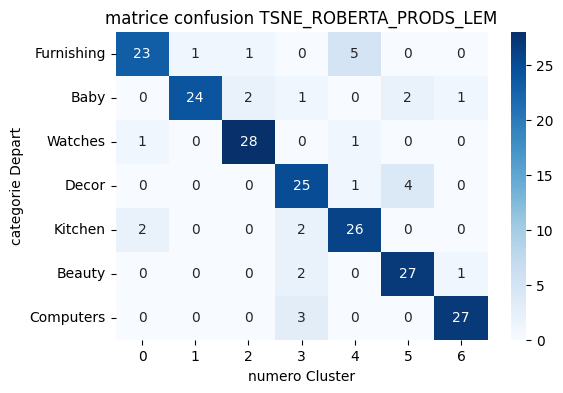

In [73]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.1.1.7   product_specifications** - stemmatisé</span>

In [74]:
# Variable dont on veut extraire les features
data_work['prod_spec_stem'] = \
    data_work['prod_spec_stem'].fillna('').astype(str)
data_prods_stem = data_work['prod_spec_stem']

In [75]:
type_donnee = 'TSNE_ROBERTA_PRODS_STEM'

# Instanciation du modèle
bert_prods_stem = SentenceTransformer('roberta-large-nli-mean-tokens')

# Encodage
vector_roberta_prods_stem = \
    bert_prods_stem.encode(data_prods_stem, show_progress_bar=False)

In [77]:
# Réduction de dimension tsne
tsne_roberta_prods_stem = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_roberta_prods_stem = \
    tsne_roberta_prods_stem.fit_transform(vector_roberta_prods_stem)
# Dataframe pour clustering
df_tsne_roberta_prods_stem = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_prods_stem[:, 0],
                                           'VAR2' : X_proj_tsne_roberta_prods_stem[:, 1],
                                           'CATEGORIE' : data_work['category']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.002s...
[t-SNE] Computed neighbors for 1050 samples in 0.079s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 6.761661
[t-SNE] KL divergence after 250 iterations with early exaggeration: 63.695503
[t-SNE] KL divergence after 5000 iterations: 0.699418


**Entrainement du modèle**

In [79]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_prods_stem[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [80]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.8702
Precision:
  - Macro: 0.8712
  - Micro: 0.8702
Recall:
  - Macro: 0.8702
  - Micro: 0.8702
F1-measure:
  - Macro: 0.8701
  - Micro: 0.8702


{'knn': {'micro_precision': 0.8702380952380953,
  'micro_recall': 0.8702380952380953,
  'micro_f1': 0.8702380952380953},
 'svm': {'micro_precision': 0.5416666666666666,
  'micro_recall': 0.5416666666666666,
  'micro_f1': 0.5416666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.8071428571428572,
  'micro_recall': 0.8071428571428572,
  'micro_f1': 0.8071428571428572},
 'Gradient Boosting': {'micro_precision': 0.9714285714285714,
  'micro_recall': 0.9714285714285714,
  'micro_f1': 0.9714285714285714},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [81]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.5024
Precision:
  - Macro: 0.4679
  - Micro: 0.5024
Recall:
  - Macro: 0.5024
  - Micro: 0.5024
F1-measure:
  - Macro: 0.4309
  - Micro: 0.5024


{'knn': {'micro_precision': 0.8702380952380953,
  'micro_recall': 0.8702380952380953,
  'micro_f1': 0.8702380952380953},
 'svm': {'micro_precision': 0.5023809523809524,
  'micro_recall': 0.5023809523809524,
  'micro_f1': 0.5023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.8071428571428572,
  'micro_recall': 0.8071428571428572,
  'micro_f1': 0.8071428571428572},
 'Gradient Boosting': {'micro_precision': 0.9714285714285714,
  'micro_recall': 0.9714285714285714,
  'micro_f1': 0.9714285714285714},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [82]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8702380952380953,
  'micro_recall': 0.8702380952380953,
  'micro_f1': 0.8702380952380953},
 'svm': {'micro_precision': 0.5023809523809524,
  'micro_recall': 0.5023809523809524,
  'micro_f1': 0.5023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.8071428571428572,
  'micro_recall': 0.8071428571428572,
  'micro_f1': 0.8071428571428572},
 'Gradient Boosting': {'micro_precision': 0.9714285714285714,
  'micro_recall': 0.9714285714285714,
  'micro_f1': 0.9714285714285714},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [83]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.7560
Precision:
  - Macro: 0.7565
  - Micro: 0.7560
Recall:
  - Macro: 0.7560
  - Micro: 0.7560
F1-measure:
  - Macro: 0.7547
  - Micro: 0.7560


{'knn': {'micro_precision': 0.8702380952380953,
  'micro_recall': 0.8702380952380953,
  'micro_f1': 0.8702380952380953},
 'svm': {'micro_precision': 0.5023809523809524,
  'micro_recall': 0.5023809523809524,
  'micro_f1': 0.5023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7559523809523809,
  'micro_recall': 0.7559523809523809,
  'micro_f1': 0.7559523809523809},
 'Gradient Boosting': {'micro_precision': 0.9714285714285714,
  'micro_recall': 0.9714285714285714,
  'micro_f1': 0.9714285714285714},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [84]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9667
Precision:
  - Macro: 0.9676
  - Micro: 0.9667
Recall:
  - Macro: 0.9667
  - Micro: 0.9667
F1-measure:
  - Macro: 0.9667
  - Micro: 0.9667


{'knn': {'micro_precision': 0.8702380952380953,
  'micro_recall': 0.8702380952380953,
  'micro_f1': 0.8702380952380953},
 'svm': {'micro_precision': 0.5023809523809524,
  'micro_recall': 0.5023809523809524,
  'micro_f1': 0.5023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7559523809523809,
  'micro_recall': 0.7559523809523809,
  'micro_f1': 0.7559523809523809},
 'Gradient Boosting': {'micro_precision': 0.9666666666666667,
  'micro_recall': 0.9666666666666667,
  'micro_f1': 0.9666666666666667},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [85]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8702380952380953,
  'micro_recall': 0.8702380952380953,
  'micro_f1': 0.8702380952380953},
 'svm': {'micro_precision': 0.5023809523809524,
  'micro_recall': 0.5023809523809524,
  'micro_f1': 0.5023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7559523809523809,
  'micro_recall': 0.7559523809523809,
  'micro_f1': 0.7559523809523809},
 'Gradient Boosting': {'micro_precision': 0.9666666666666667,
  'micro_recall': 0.9666666666666667,
  'micro_f1': 0.9666666666666667},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [86]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.870238,0.870238,0.870238
svm,0.502381,0.502381,0.502381
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.755952,0.755952,0.755952
Gradient Boosting,0.966667,0.966667,0.966667
extra tree classifier,1.000000,1.000000,1.000000


In [87]:
from sklearn.ensemble import ExtraTreesClassifier

etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.848


In [89]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_prods_stem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_prods_stem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_prods_stem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_prods_stem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[23  1  0  1  5  0  0]
 [ 1 22  2  0  1  2  2]
 [ 0  0 28  1  0  1  0]
 [ 2  1  1 23  1  1  1]
 [ 4  0  0  3 23  0  0]
 [ 0  0  0  1  0 29  0]
 [ 0  0  0  0  0  0 30]]
Correspondance des clusters :  [0 1 2 3 4 5 6]
Correspondance des clusters :  [0 1 2 3 4 5 6]

ACCURACY TSNE_ROBERTA_PRODS_STEM (Test): 0.848
ACCURACY TSNE_ROBERTA_PRODS_STEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.77      0.77      0.77        30
           1       0.92      0.73      0.81        30
           2       0.90      0.93      0.92        30
           3       0.79      0.77      0.78        30
           4       0.77      0.77      0.77        30
           5       0.88      0.97      0.92        30
           6       0.91      1.00      0.95        30

    accuracy                           0.85       210
   macro avg       0.85      0.85      0.85       210
weighted avg       0.85      0.85      0.85       210



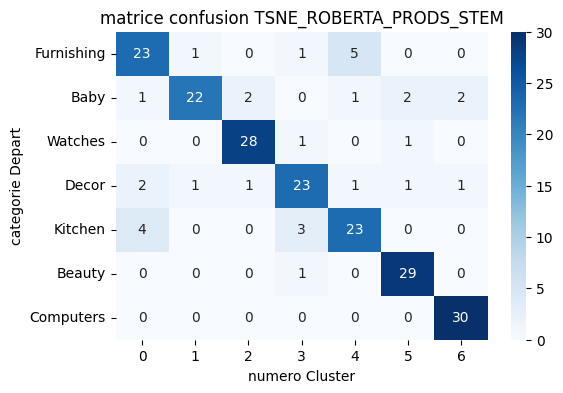

In [90]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.1.1.8  product_name** - original (non nettoyé)</span>

In [91]:
# Variable dont on veut extraire les features
data_work['product_name'] = \
    data_work['product_name'].fillna('').astype(str)
data_prod_orig = data_work['product_name']

In [92]:
type_donnee = 'TSNE_ROBERTA_PROD_ORIG'

# Instanciation du modèle
bert_prod_orig = SentenceTransformer('roberta-large-nli-mean-tokens')

# Encodage
vector_roberta_prod_orig = \
    bert_prod_orig.encode(data_prod_orig, show_progress_bar=False)

In [94]:
# Réduction de dimension tsne
tsne_roberta_prod_orig = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_roberta_prod_orig = \
    tsne_roberta_prod_orig.fit_transform(vector_roberta_prod_orig)
# Dataframe pour clustering
df_tsne_roberta_prod_orig = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_prod_orig[:, 0],
                                           'VAR2' : X_proj_tsne_roberta_prod_orig[:, 1],
                                           'CATEGORIE' : data_work['category']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.002s...
[t-SNE] Computed neighbors for 1050 samples in 0.073s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 9.775567
[t-SNE] KL divergence after 250 iterations with early exaggeration: 62.976471
[t-SNE] KL divergence after 5000 iterations: 0.830490


**Entrainement du modèle**

In [95]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_prod_orig[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [96]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.8869
Precision:
  - Macro: 0.8870
  - Micro: 0.8869
Recall:
  - Macro: 0.8869
  - Micro: 0.8869
F1-measure:
  - Macro: 0.8863
  - Micro: 0.8869


{'knn': {'micro_precision': 0.8869047619047619,
  'micro_recall': 0.8869047619047619,
  'micro_f1': 0.8869047619047619},
 'svm': {'micro_precision': 0.5023809523809524,
  'micro_recall': 0.5023809523809524,
  'micro_f1': 0.5023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7559523809523809,
  'micro_recall': 0.7559523809523809,
  'micro_f1': 0.7559523809523809},
 'Gradient Boosting': {'micro_precision': 0.9666666666666667,
  'micro_recall': 0.9666666666666667,
  'micro_f1': 0.9666666666666667},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [97]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.5417
Precision:
  - Macro: 0.5317
  - Micro: 0.5417
Recall:
  - Macro: 0.5417
  - Micro: 0.5417
F1-measure:
  - Macro: 0.4844
  - Micro: 0.5417


{'knn': {'micro_precision': 0.8869047619047619,
  'micro_recall': 0.8869047619047619,
  'micro_f1': 0.8869047619047619},
 'svm': {'micro_precision': 0.5416666666666666,
  'micro_recall': 0.5416666666666666,
  'micro_f1': 0.5416666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7559523809523809,
  'micro_recall': 0.7559523809523809,
  'micro_f1': 0.7559523809523809},
 'Gradient Boosting': {'micro_precision': 0.9666666666666667,
  'micro_recall': 0.9666666666666667,
  'micro_f1': 0.9666666666666667},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [98]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8869047619047619,
  'micro_recall': 0.8869047619047619,
  'micro_f1': 0.8869047619047619},
 'svm': {'micro_precision': 0.5416666666666666,
  'micro_recall': 0.5416666666666666,
  'micro_f1': 0.5416666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7559523809523809,
  'micro_recall': 0.7559523809523809,
  'micro_f1': 0.7559523809523809},
 'Gradient Boosting': {'micro_precision': 0.9666666666666667,
  'micro_recall': 0.9666666666666667,
  'micro_f1': 0.9666666666666667},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [99]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.6548
Precision:
  - Macro: 0.6274
  - Micro: 0.6548
Recall:
  - Macro: 0.6548
  - Micro: 0.6548
F1-measure:
  - Macro: 0.6022
  - Micro: 0.6548


{'knn': {'micro_precision': 0.8869047619047619,
  'micro_recall': 0.8869047619047619,
  'micro_f1': 0.8869047619047619},
 'svm': {'micro_precision': 0.5416666666666666,
  'micro_recall': 0.5416666666666666,
  'micro_f1': 0.5416666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6547619047619048,
  'micro_recall': 0.6547619047619048,
  'micro_f1': 0.6547619047619048},
 'Gradient Boosting': {'micro_precision': 0.9666666666666667,
  'micro_recall': 0.9666666666666667,
  'micro_f1': 0.9666666666666667},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [100]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9810
Precision:
  - Macro: 0.9812
  - Micro: 0.9810
Recall:
  - Macro: 0.9810
  - Micro: 0.9810
F1-measure:
  - Macro: 0.9809
  - Micro: 0.9810


{'knn': {'micro_precision': 0.8869047619047619,
  'micro_recall': 0.8869047619047619,
  'micro_f1': 0.8869047619047619},
 'svm': {'micro_precision': 0.5416666666666666,
  'micro_recall': 0.5416666666666666,
  'micro_f1': 0.5416666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6547619047619048,
  'micro_recall': 0.6547619047619048,
  'micro_f1': 0.6547619047619048},
 'Gradient Boosting': {'micro_precision': 0.9809523809523809,
  'micro_recall': 0.9809523809523809,
  'micro_f1': 0.9809523809523809},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [101]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8869047619047619,
  'micro_recall': 0.8869047619047619,
  'micro_f1': 0.8869047619047619},
 'svm': {'micro_precision': 0.5416666666666666,
  'micro_recall': 0.5416666666666666,
  'micro_f1': 0.5416666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6547619047619048,
  'micro_recall': 0.6547619047619048,
  'micro_f1': 0.6547619047619048},
 'Gradient Boosting': {'micro_precision': 0.9809523809523809,
  'micro_recall': 0.9809523809523809,
  'micro_f1': 0.9809523809523809},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [102]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.886905,0.886905,0.886905
svm,0.541667,0.541667,0.541667
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.654762,0.654762,0.654762
Gradient Boosting,0.980952,0.980952,0.980952
extra tree classifier,1.000000,1.000000,1.000000


In [103]:
from sklearn.ensemble import ExtraTreesClassifier

etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.852


In [105]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_prod_orig_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_prod_orig_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_prod_orig_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_prod_orig_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[24  2  0  0  4  0  0]
 [ 2 21  2  0  3  2  0]
 [ 0  0 28  0  0  1  1]
 [ 0  1  0 27  0  2  0]
 [ 6  0  0  0 24  0  0]
 [ 2  1  0  2  0 25  0]
 [ 0  0  0  0  0  0 30]]
Correspondance des clusters :  [0 1 2 3 4 5 6]
Correspondance des clusters :  [0 1 2 3 4 5 6]

ACCURACY TSNE_ROBERTA_PROD_ORIG (Test): 0.852
ACCURACY TSNE_ROBERTA_PROD_ORIG (Train): 1.0


              precision    recall  f1-score   support

           0       0.71      0.80      0.75        30
           1       0.84      0.70      0.76        30
           2       0.93      0.93      0.93        30
           3       0.93      0.90      0.92        30
           4       0.77      0.80      0.79        30
           5       0.83      0.83      0.83        30
           6       0.97      1.00      0.98        30

    accuracy                           0.85       210
   macro avg       0.86      0.85      0.85       210
weighted avg       0.86      0.85      0.85       210



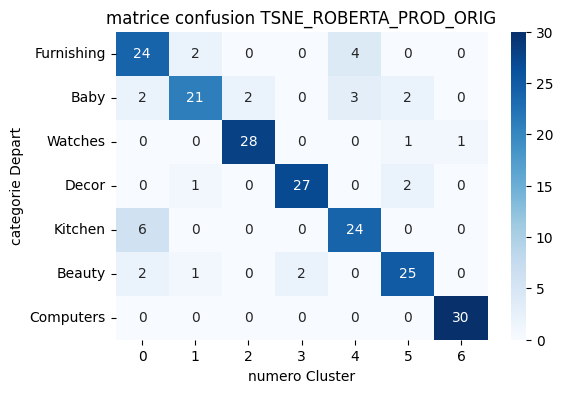

In [106]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.1.1.9  product_name** - lemmatisé</span>

In [72]:
# Variable dont on veut extraire les features
data_work['pname_lem'] = \
    data_work['pname_lem'].fillna('').astype(str)
data_prod_lem = data_work['pname_lem']

In [109]:
type_donnee = 'TSNE_ROBERTA_PROD_LEM'

# Instanciation du modèle
bert_prod_lem = SentenceTransformer('roberta-large-nli-mean-tokens')

# Encodage
vector_roberta_prod_lem = \
    bert_prod_lem.encode(data_prod_lem, show_progress_bar=False)

In [111]:
# Réduction de dimension tsne
tsne_roberta_prod_lem = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_roberta_prod_lem = \
    tsne_roberta_prod_lem.fit_transform(vector_roberta_prod_lem)
# Dataframe pour clustering
df_tsne_roberta_prod_lem = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_prod_lem[:, 0],
                                           'VAR2' : X_proj_tsne_roberta_prod_lem[:, 1],
                                           'CATEGORIE' : data_work['category']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.002s...
[t-SNE] Computed neighbors for 1050 samples in 0.075s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 9.674495
[t-SNE] KL divergence after 50 iterations with early exaggeration: 64.175507
[t-SNE] KL divergence after 5000 iterations: 0.855997


In [112]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_prod_lem[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [113]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.8393
Precision:
  - Macro: 0.8389
  - Micro: 0.8393
Recall:
  - Macro: 0.8393
  - Micro: 0.8393
F1-measure:
  - Macro: 0.8380
  - Micro: 0.8393


{'knn': {'micro_precision': 0.8392857142857143,
  'micro_recall': 0.8392857142857143,
  'micro_f1': 0.8392857142857143},
 'svm': {'micro_precision': 0.5416666666666666,
  'micro_recall': 0.5416666666666666,
  'micro_f1': 0.5416666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6547619047619048,
  'micro_recall': 0.6547619047619048,
  'micro_f1': 0.6547619047619048},
 'Gradient Boosting': {'micro_precision': 0.9809523809523809,
  'micro_recall': 0.9809523809523809,
  'micro_f1': 0.9809523809523809},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [114]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.3917
Precision:
  - Macro: 0.5142
  - Micro: 0.3917
Recall:
  - Macro: 0.3917
  - Micro: 0.3917
F1-measure:
  - Macro: 0.3087
  - Micro: 0.3917


{'knn': {'micro_precision': 0.8392857142857143,
  'micro_recall': 0.8392857142857143,
  'micro_f1': 0.8392857142857143},
 'svm': {'micro_precision': 0.39166666666666666,
  'micro_recall': 0.39166666666666666,
  'micro_f1': 0.39166666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6547619047619048,
  'micro_recall': 0.6547619047619048,
  'micro_f1': 0.6547619047619048},
 'Gradient Boosting': {'micro_precision': 0.9809523809523809,
  'micro_recall': 0.9809523809523809,
  'micro_f1': 0.9809523809523809},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [115]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8392857142857143,
  'micro_recall': 0.8392857142857143,
  'micro_f1': 0.8392857142857143},
 'svm': {'micro_precision': 0.39166666666666666,
  'micro_recall': 0.39166666666666666,
  'micro_f1': 0.39166666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6547619047619048,
  'micro_recall': 0.6547619047619048,
  'micro_f1': 0.6547619047619048},
 'Gradient Boosting': {'micro_precision': 0.9809523809523809,
  'micro_recall': 0.9809523809523809,
  'micro_f1': 0.9809523809523809},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [116]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.6750
Precision:
  - Macro: 0.6694
  - Micro: 0.6750
Recall:
  - Macro: 0.6750
  - Micro: 0.6750
F1-measure:
  - Macro: 0.6670
  - Micro: 0.6750


{'knn': {'micro_precision': 0.8392857142857143,
  'micro_recall': 0.8392857142857143,
  'micro_f1': 0.8392857142857143},
 'svm': {'micro_precision': 0.39166666666666666,
  'micro_recall': 0.39166666666666666,
  'micro_f1': 0.39166666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.675,
  'micro_recall': 0.675,
  'micro_f1': 0.675},
 'Gradient Boosting': {'micro_precision': 0.9809523809523809,
  'micro_recall': 0.9809523809523809,
  'micro_f1': 0.9809523809523809},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [117]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9643
Precision:
  - Macro: 0.9654
  - Micro: 0.9643
Recall:
  - Macro: 0.9643
  - Micro: 0.9643
F1-measure:
  - Macro: 0.9641
  - Micro: 0.9643


{'knn': {'micro_precision': 0.8392857142857143,
  'micro_recall': 0.8392857142857143,
  'micro_f1': 0.8392857142857143},
 'svm': {'micro_precision': 0.39166666666666666,
  'micro_recall': 0.39166666666666666,
  'micro_f1': 0.39166666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.675,
  'micro_recall': 0.675,
  'micro_f1': 0.675},
 'Gradient Boosting': {'micro_precision': 0.9642857142857143,
  'micro_recall': 0.9642857142857143,
  'micro_f1': 0.9642857142857143},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [118]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8392857142857143,
  'micro_recall': 0.8392857142857143,
  'micro_f1': 0.8392857142857143},
 'svm': {'micro_precision': 0.39166666666666666,
  'micro_recall': 0.39166666666666666,
  'micro_f1': 0.39166666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.675,
  'micro_recall': 0.675,
  'micro_f1': 0.675},
 'Gradient Boosting': {'micro_precision': 0.9642857142857143,
  'micro_recall': 0.9642857142857143,
  'micro_f1': 0.9642857142857143},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [119]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.839286,0.839286,0.839286
svm,0.391667,0.391667,0.391667
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.675000,0.675000,0.675000
Gradient Boosting,0.964286,0.964286,0.964286
extra tree classifier,1.000000,1.000000,1.000000


In [120]:
from sklearn.ensemble import ExtraTreesClassifier

etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.843


In [122]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_prod_lem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_prod_lem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_prod_lem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_prod_lem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[22  3  0  0  4  1  0]
 [ 2 23  1  2  2  0  0]
 [ 0  2 27  1  0  0  0]
 [ 1  1  0 27  1  0  0]
 [ 5  1  0  0 24  0  0]
 [ 2  0  1  1  1 25  0]
 [ 0  1  0  0  0  0 29]]
Correspondance des clusters :  [0 1 2 3 4 5 6]
Correspondance des clusters :  [0 1 2 3 4 5 6]

ACCURACY TSNE_ROBERTA_PROD_LEM (Test): 0.843
ACCURACY TSNE_ROBERTA_PROD_LEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.69      0.73      0.71        30
           1       0.74      0.77      0.75        30
           2       0.93      0.90      0.92        30
           3       0.87      0.90      0.89        30
           4       0.75      0.80      0.77        30
           5       0.96      0.83      0.89        30
           6       1.00      0.97      0.98        30

    accuracy                           0.84       210
   macro avg       0.85      0.84      0.84       210
weighted avg       0.85      0.84      0.84       210



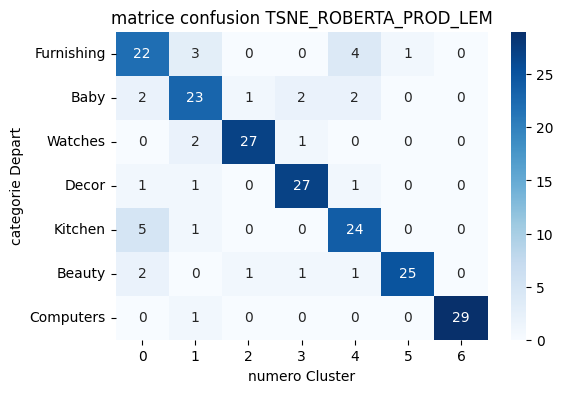

In [123]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.1.1.10  product_name** - racinisée</span>

In [124]:
# Variable dont on veut extraire les features
data_work['pname_stem'] = \
    data_work['pname_stem'].fillna('').astype(str)
data_prod_stem = data_work['pname_stem']

In [125]:
type_donnee = 'TSNE_ROBERTA_PROD_STEM'

# Instanciation du modèle
bert_prod_stem = SentenceTransformer('roberta-large-nli-mean-tokens')

# Encodage
vector_roberta_prod_stem = \
    bert_prod_stem.encode(data_prod_stem, show_progress_bar=False)

In [126]:
# Réduction de dimension tsne
tsne_roberta_prod_stem = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_roberta_prod_stem = \
    tsne_roberta_prod_stem.fit_transform(vector_roberta_prod_stem)
# Dataframe pour clustering
df_tsne_roberta_prod_stem = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_prod_stem[:, 0],
                                           'VAR2' : X_proj_tsne_roberta_prod_stem[:, 1],
                                           'CATEGORIE' : data_work['category']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.006s...
[t-SNE] Computed neighbors for 1050 samples in 0.140s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 9.270936
[t-SNE] KL divergence after 100 iterations with early exaggeration: 63.956734
[t-SNE] KL divergence after 5000 iterations: 0.936765


**Entrainement du modèle**

In [127]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_prod_stem[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [129]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.8607
Precision:
  - Macro: 0.8598
  - Micro: 0.8607
Recall:
  - Macro: 0.8607
  - Micro: 0.8607
F1-measure:
  - Macro: 0.8598
  - Micro: 0.8607


{'knn': {'micro_precision': 0.8607142857142858,
  'micro_recall': 0.8607142857142858,
  'micro_f1': 0.8607142857142858},
 'svm': {'micro_precision': 0.39166666666666666,
  'micro_recall': 0.39166666666666666,
  'micro_f1': 0.39166666666666666},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.675,
  'micro_recall': 0.675,
  'micro_f1': 0.675},
 'Gradient Boosting': {'micro_precision': 0.9642857142857143,
  'micro_recall': 0.9642857142857143,
  'micro_f1': 0.9642857142857143},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [130]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.4333
Precision:
  - Macro: 0.4593
  - Micro: 0.4333
Recall:
  - Macro: 0.4333
  - Micro: 0.4333
F1-measure:
  - Macro: 0.3443
  - Micro: 0.4333


{'knn': {'micro_precision': 0.8607142857142858,
  'micro_recall': 0.8607142857142858,
  'micro_f1': 0.8607142857142858},
 'svm': {'micro_precision': 0.43333333333333335,
  'micro_recall': 0.43333333333333335,
  'micro_f1': 0.43333333333333335},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.675,
  'micro_recall': 0.675,
  'micro_f1': 0.675},
 'Gradient Boosting': {'micro_precision': 0.9642857142857143,
  'micro_recall': 0.9642857142857143,
  'micro_f1': 0.9642857142857143},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [131]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 0.9988
Precision:
  - Macro: 0.9988
  - Micro: 0.9988
Recall:
  - Macro: 0.9988
  - Micro: 0.9988
F1-measure:
  - Macro: 0.9988
  - Micro: 0.9988


{'knn': {'micro_precision': 0.8607142857142858,
  'micro_recall': 0.8607142857142858,
  'micro_f1': 0.8607142857142858},
 'svm': {'micro_precision': 0.43333333333333335,
  'micro_recall': 0.43333333333333335,
  'micro_f1': 0.43333333333333335},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.675,
  'micro_recall': 0.675,
  'micro_f1': 0.675},
 'Gradient Boosting': {'micro_precision': 0.9642857142857143,
  'micro_recall': 0.9642857142857143,
  'micro_f1': 0.9642857142857143},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [132]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.5595
Precision:
  - Macro: 0.5258
  - Micro: 0.5595
Recall:
  - Macro: 0.5595
  - Micro: 0.5595
F1-measure:
  - Macro: 0.5217
  - Micro: 0.5595


{'knn': {'micro_precision': 0.8607142857142858,
  'micro_recall': 0.8607142857142858,
  'micro_f1': 0.8607142857142858},
 'svm': {'micro_precision': 0.43333333333333335,
  'micro_recall': 0.43333333333333335,
  'micro_f1': 0.43333333333333335},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5595238095238095,
  'micro_recall': 0.5595238095238095,
  'micro_f1': 0.5595238095238095},
 'Gradient Boosting': {'micro_precision': 0.9642857142857143,
  'micro_recall': 0.9642857142857143,
  'micro_f1': 0.9642857142857143},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [133]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9369
Precision:
  - Macro: 0.9408
  - Micro: 0.9369
Recall:
  - Macro: 0.9369
  - Micro: 0.9369
F1-measure:
  - Macro: 0.9368
  - Micro: 0.9369


{'knn': {'micro_precision': 0.8607142857142858,
  'micro_recall': 0.8607142857142858,
  'micro_f1': 0.8607142857142858},
 'svm': {'micro_precision': 0.43333333333333335,
  'micro_recall': 0.43333333333333335,
  'micro_f1': 0.43333333333333335},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5595238095238095,
  'micro_recall': 0.5595238095238095,
  'micro_f1': 0.5595238095238095},
 'Gradient Boosting': {'micro_precision': 0.9369047619047619,
  'micro_recall': 0.9369047619047619,
  'micro_f1': 0.9369047619047619},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [134]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 0.9988
Precision:
  - Macro: 0.9988
  - Micro: 0.9988
Recall:
  - Macro: 0.9988
  - Micro: 0.9988
F1-measure:
  - Macro: 0.9988
  - Micro: 0.9988


{'knn': {'micro_precision': 0.8607142857142858,
  'micro_recall': 0.8607142857142858,
  'micro_f1': 0.8607142857142858},
 'svm': {'micro_precision': 0.43333333333333335,
  'micro_recall': 0.43333333333333335,
  'micro_f1': 0.43333333333333335},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5595238095238095,
  'micro_recall': 0.5595238095238095,
  'micro_f1': 0.5595238095238095},
 'Gradient Boosting': {'micro_precision': 0.9369047619047619,
  'micro_recall': 0.9369047619047619,
  'micro_f1': 0.9369047619047619},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

In [135]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.860714,0.860714,0.860714
svm,0.433333,0.433333,0.433333
Random Forest,0.998810,0.998810,0.998810
Naive Bayes,0.559524,0.559524,0.559524
Gradient Boosting,0.936905,0.936905,0.936905
extra tree classifier,0.998810,0.998810,0.998810


In [136]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.81


In [138]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_prod_stem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_prod_stem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_prod_stem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_prod_stem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[20  4  0  3  2  1  0]
 [ 1 20  0  2  5  2  0]
 [ 0  1 26  1  1  1  0]
 [ 1  1  1 25  2  0  0]
 [ 5  0  1  0 24  0  0]
 [ 3  0  1  0  1 25  0]
 [ 0  0  0  0  0  0 30]]
Correspondance des clusters :  [0 1 2 3 4 5 6]
Correspondance des clusters :  [0 1 2 3 4 5 6]

ACCURACY TSNE_ROBERTA_PROD_STEM (Test): 0.81
ACCURACY TSNE_ROBERTA_PROD_STEM (Train): 0.999


              precision    recall  f1-score   support

           0       0.67      0.67      0.67        30
           1       0.77      0.67      0.71        30
           2       0.90      0.87      0.88        30
           3       0.81      0.83      0.82        30
           4       0.69      0.80      0.74        30
           5       0.86      0.83      0.85        30
           6       1.00      1.00      1.00        30

    accuracy                           0.81       210
   macro avg       0.81      0.81      0.81       210
weighted avg       0.81      0.81      0.81       210



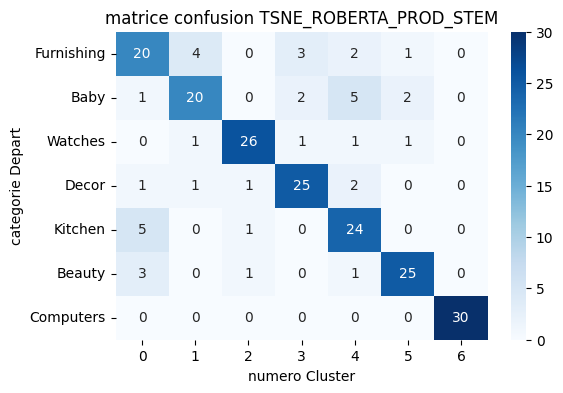

In [139]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.1.1.11   Mixte** - variables originales</span>

In [120]:
# Variable dont on veut extraire les features
data_work['var_orig'] = data_work['product_name'] + data_work['brand']
+ data_work['description'] + data_work['product_specifications']
data_work['var_orig'] = \
    data_work['var_orig'].fillna('').astype(str)
data_var_orig = data_work['var_orig']

In [121]:
type_donnee = 'TSNE_ROBERTA_VAR_ORIG'

# Instanciation du modèle
bert_var_orig = SentenceTransformer('roberta-large-nli-mean-tokens')

# Encodage
vector_roberta_var_orig = \
    bert_var_orig.encode(data_var_orig, show_progress_bar=False)

In [122]:
# Réduction de dimension tsne
tsne_roberta_var_orig = TSNE(verbose=1, perplexity=40, n_iter=5000)
X_proj_tsne_roberta_var_orig = \
    tsne_roberta_var_orig.fit_transform(vector_roberta_var_orig)
# Dataframe pour clustering
df_tsne_roberta_var_orig = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_var_orig[:, 0],
                                           'VAR2' : X_proj_tsne_roberta_var_orig[:, 1],
                                           'CATEGORIE' : data_work['category']})

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.014s...
[t-SNE] Computed neighbors for 1050 samples in 1.162s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 9.082983
[t-SNE] KL divergence after 250 iterations with early exaggeration: 65.149902
[t-SNE] KL divergence after 5000 iterations: 0.913736


**Entrainement du modèle**

In [144]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_var_orig[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [145]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.8679
Precision:
  - Macro: 0.8684
  - Micro: 0.8679
Recall:
  - Macro: 0.8679
  - Micro: 0.8679
F1-measure:
  - Macro: 0.8674
  - Micro: 0.8679


{'knn': {'micro_precision': 0.8678571428571429,
  'micro_recall': 0.8678571428571429,
  'micro_f1': 0.8678571428571429},
 'svm': {'micro_precision': 0.43333333333333335,
  'micro_recall': 0.43333333333333335,
  'micro_f1': 0.43333333333333335},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5595238095238095,
  'micro_recall': 0.5595238095238095,
  'micro_f1': 0.5595238095238095},
 'Gradient Boosting': {'micro_precision': 0.9369047619047619,
  'micro_recall': 0.9369047619047619,
  'micro_f1': 0.9369047619047619},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

In [146]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.5000
Precision:
  - Macro: 0.4048
  - Micro: 0.5000
Recall:
  - Macro: 0.5000
  - Micro: 0.5000
F1-measure:
  - Macro: 0.4111
  - Micro: 0.5000


{'knn': {'micro_precision': 0.8678571428571429,
  'micro_recall': 0.8678571428571429,
  'micro_f1': 0.8678571428571429},
 'svm': {'micro_precision': 0.5, 'micro_recall': 0.5, 'micro_f1': 0.5},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5595238095238095,
  'micro_recall': 0.5595238095238095,
  'micro_f1': 0.5595238095238095},
 'Gradient Boosting': {'micro_precision': 0.9369047619047619,
  'micro_recall': 0.9369047619047619,
  'micro_f1': 0.9369047619047619},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

In [147]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8678571428571429,
  'micro_recall': 0.8678571428571429,
  'micro_f1': 0.8678571428571429},
 'svm': {'micro_precision': 0.5, 'micro_recall': 0.5, 'micro_f1': 0.5},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.5595238095238095,
  'micro_recall': 0.5595238095238095,
  'micro_f1': 0.5595238095238095},
 'Gradient Boosting': {'micro_precision': 0.9369047619047619,
  'micro_recall': 0.9369047619047619,
  'micro_f1': 0.9369047619047619},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

In [148]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.6583
Precision:
  - Macro: 0.6457
  - Micro: 0.6583
Recall:
  - Macro: 0.6583
  - Micro: 0.6583
F1-measure:
  - Macro: 0.6189
  - Micro: 0.6583


{'knn': {'micro_precision': 0.8678571428571429,
  'micro_recall': 0.8678571428571429,
  'micro_f1': 0.8678571428571429},
 'svm': {'micro_precision': 0.5, 'micro_recall': 0.5, 'micro_f1': 0.5},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6583333333333333,
  'micro_recall': 0.6583333333333333,
  'micro_f1': 0.6583333333333333},
 'Gradient Boosting': {'micro_precision': 0.9369047619047619,
  'micro_recall': 0.9369047619047619,
  'micro_f1': 0.9369047619047619},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

In [149]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9738
Precision:
  - Macro: 0.9743
  - Micro: 0.9738
Recall:
  - Macro: 0.9738
  - Micro: 0.9738
F1-measure:
  - Macro: 0.9737
  - Micro: 0.9738


{'knn': {'micro_precision': 0.8678571428571429,
  'micro_recall': 0.8678571428571429,
  'micro_f1': 0.8678571428571429},
 'svm': {'micro_precision': 0.5, 'micro_recall': 0.5, 'micro_f1': 0.5},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6583333333333333,
  'micro_recall': 0.6583333333333333,
  'micro_f1': 0.6583333333333333},
 'Gradient Boosting': {'micro_precision': 0.9738095238095238,
  'micro_recall': 0.9738095238095238,
  'micro_f1': 0.9738095238095238},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

In [150]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.8678571428571429,
  'micro_recall': 0.8678571428571429,
  'micro_f1': 0.8678571428571429},
 'svm': {'micro_precision': 0.5, 'micro_recall': 0.5, 'micro_f1': 0.5},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6583333333333333,
  'micro_recall': 0.6583333333333333,
  'micro_f1': 0.6583333333333333},
 'Gradient Boosting': {'micro_precision': 0.9738095238095238,
  'micro_recall': 0.9738095238095238,
  'micro_f1': 0.9738095238095238},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [151]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.867857,0.867857,0.867857
svm,0.500000,0.500000,0.500000
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.658333,0.658333,0.658333
Gradient Boosting,0.973810,0.973810,0.973810
extra tree classifier,1.000000,1.000000,1.000000


In [152]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.819


In [154]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_var_orig_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_var_orig_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_orig_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_orig_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[22  0  0  1  6  1  0]
 [ 2 19  4  2  1  2  0]
 [ 0  0 29  0  0  0  1]
 [ 0  1  0 26  0  3  0]
 [ 6  0  0  0 24  0  0]
 [ 3  1  2  2  0 22  0]
 [ 0  0  0  0  0  0 30]]
Correspondance des clusters :  [0 1 2 3 4 5 6]
Correspondance des clusters :  [0 1 2 3 4 5 6]

ACCURACY TSNE_ROBERTA_VAR_ORIG (Test): 0.819
ACCURACY TSNE_ROBERTA_VAR_ORIG (Train): 1.0


              precision    recall  f1-score   support

           0       0.67      0.73      0.70        30
           1       0.90      0.63      0.75        30
           2       0.83      0.97      0.89        30
           3       0.84      0.87      0.85        30
           4       0.77      0.80      0.79        30
           5       0.79      0.73      0.76        30
           6       0.97      1.00      0.98        30

    accuracy                           0.82       210
   macro avg       0.82      0.82      0.82       210
weighted avg       0.82      0.82      0.82       210



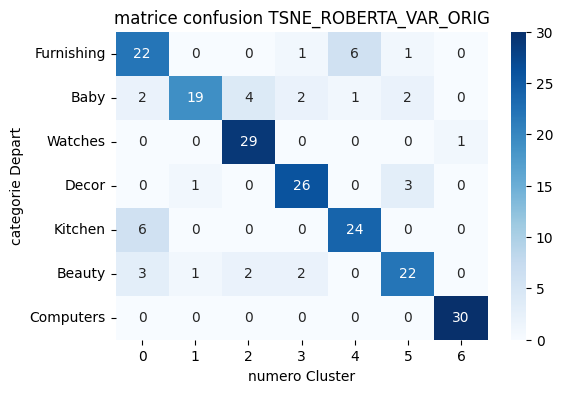

In [155]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.1.1.12  Mixte** - stemmatisée</span>

In [157]:
# Variable dont on veut extraire les features
data_work['var_stem'] = data_work['pname_stem'] + data_work['brand_stem']
+ data_work['desc_stem'] + data_work['prod_spec_stem']
data_work['var_stem'] = \
    data_work['var_stem'].fillna('').astype(str)
data_var_stem = data_work['var_stem']

In [158]:
type_donnee = 'TSNE_ROBERTA_VAR_STEM'

# Instanciation du modèle
bert_var_stem = SentenceTransformer('roberta-large-nli-mean-tokens')

# Encodage
vector_roberta_var_stem = \
    bert_var_stem.encode(data_var_stem, show_progress_bar=False)

In [160]:
# Réduction de dimension tsne
tsne_roberta_var_stem = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_roberta_var_stem = \
    tsne_roberta_var_stem.fit_transform(vector_roberta_var_stem)
# Dataframe pour clustering
df_tsne_roberta_var_stem = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_var_stem[:, 0],
                                           'VAR2' : X_proj_tsne_roberta_var_stem[:, 1],
                                           'CATEGORIE' : data_work['category']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.000s...
[t-SNE] Computed neighbors for 1050 samples in 0.151s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 8.559208
[t-SNE] KL divergence after 50 iterations with early exaggeration: 63.461143
[t-SNE] KL divergence after 3650 iterations: 0.968158


**Entrainement du modèle**

In [161]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_var_stem[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [162]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.8119
Precision:
  - Macro: 0.8129
  - Micro: 0.8119
Recall:
  - Macro: 0.8119
  - Micro: 0.8119
F1-measure:
  - Macro: 0.8112
  - Micro: 0.8119


{'knn': {'micro_precision': 0.8119047619047619,
  'micro_recall': 0.8119047619047619,
  'micro_f1': 0.8119047619047619},
 'svm': {'micro_precision': 0.5, 'micro_recall': 0.5, 'micro_f1': 0.5},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6583333333333333,
  'micro_recall': 0.6583333333333333,
  'micro_f1': 0.6583333333333333},
 'Gradient Boosting': {'micro_precision': 0.9738095238095238,
  'micro_recall': 0.9738095238095238,
  'micro_f1': 0.9738095238095238},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [163]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.3429
Precision:
  - Macro: 0.3569
  - Micro: 0.3429
Recall:
  - Macro: 0.3429
  - Micro: 0.3429
F1-measure:
  - Macro: 0.3172
  - Micro: 0.3429


{'knn': {'micro_precision': 0.8119047619047619,
  'micro_recall': 0.8119047619047619,
  'micro_f1': 0.8119047619047619},
 'svm': {'micro_precision': 0.34285714285714286,
  'micro_recall': 0.34285714285714286,
  'micro_f1': 0.34285714285714286},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6583333333333333,
  'micro_recall': 0.6583333333333333,
  'micro_f1': 0.6583333333333333},
 'Gradient Boosting': {'micro_precision': 0.9738095238095238,
  'micro_recall': 0.9738095238095238,
  'micro_f1': 0.9738095238095238},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [164]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 0.9988
Precision:
  - Macro: 0.9988
  - Micro: 0.9988
Recall:
  - Macro: 0.9988
  - Micro: 0.9988
F1-measure:
  - Macro: 0.9988
  - Micro: 0.9988


{'knn': {'micro_precision': 0.8119047619047619,
  'micro_recall': 0.8119047619047619,
  'micro_f1': 0.8119047619047619},
 'svm': {'micro_precision': 0.34285714285714286,
  'micro_recall': 0.34285714285714286,
  'micro_f1': 0.34285714285714286},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.6583333333333333,
  'micro_recall': 0.6583333333333333,
  'micro_f1': 0.6583333333333333},
 'Gradient Boosting': {'micro_precision': 0.9738095238095238,
  'micro_recall': 0.9738095238095238,
  'micro_f1': 0.9738095238095238},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [165]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.5619
Precision:
  - Macro: 0.5568
  - Micro: 0.5619
Recall:
  - Macro: 0.5619
  - Micro: 0.5619
F1-measure:
  - Macro: 0.5413
  - Micro: 0.5619


{'knn': {'micro_precision': 0.8119047619047619,
  'micro_recall': 0.8119047619047619,
  'micro_f1': 0.8119047619047619},
 'svm': {'micro_precision': 0.34285714285714286,
  'micro_recall': 0.34285714285714286,
  'micro_f1': 0.34285714285714286},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5619047619047619,
  'micro_recall': 0.5619047619047619,
  'micro_f1': 0.5619047619047619},
 'Gradient Boosting': {'micro_precision': 0.9738095238095238,
  'micro_recall': 0.9738095238095238,
  'micro_f1': 0.9738095238095238},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [166]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9310
Precision:
  - Macro: 0.9330
  - Micro: 0.9310
Recall:
  - Macro: 0.9310
  - Micro: 0.9310
F1-measure:
  - Macro: 0.9308
  - Micro: 0.9310


{'knn': {'micro_precision': 0.8119047619047619,
  'micro_recall': 0.8119047619047619,
  'micro_f1': 0.8119047619047619},
 'svm': {'micro_precision': 0.34285714285714286,
  'micro_recall': 0.34285714285714286,
  'micro_f1': 0.34285714285714286},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5619047619047619,
  'micro_recall': 0.5619047619047619,
  'micro_f1': 0.5619047619047619},
 'Gradient Boosting': {'micro_precision': 0.930952380952381,
  'micro_recall': 0.930952380952381,
  'micro_f1': 0.930952380952381},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [167]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 0.9988
Precision:
  - Macro: 0.9988
  - Micro: 0.9988
Recall:
  - Macro: 0.9988
  - Micro: 0.9988
F1-measure:
  - Macro: 0.9988
  - Micro: 0.9988


{'knn': {'micro_precision': 0.8119047619047619,
  'micro_recall': 0.8119047619047619,
  'micro_f1': 0.8119047619047619},
 'svm': {'micro_precision': 0.34285714285714286,
  'micro_recall': 0.34285714285714286,
  'micro_f1': 0.34285714285714286},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5619047619047619,
  'micro_recall': 0.5619047619047619,
  'micro_f1': 0.5619047619047619},
 'Gradient Boosting': {'micro_precision': 0.930952380952381,
  'micro_recall': 0.930952380952381,
  'micro_f1': 0.930952380952381},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

In [168]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.811905,0.811905,0.811905
svm,0.342857,0.342857,0.342857
Random Forest,0.998810,0.998810,0.998810
Naive Bayes,0.561905,0.561905,0.561905
Gradient Boosting,0.930952,0.930952,0.930952
extra tree classifier,0.998810,0.998810,0.998810


In [169]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.748


In [172]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_var_stem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_var_stem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_stem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_stem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[22  0  0  2  5  1  0]
 [ 1 21  0  0  2  5  1]
 [ 0  2 26  1  0  1  0]
 [ 3  2  0 22  2  1  0]
 [ 8  0  0  2 19  1  0]
 [ 5  0  3  2  1 19  0]
 [ 0  0  1  0  1  0 28]]
Correspondance des clusters :  [0 1 2 3 4 5 6]
Correspondance des clusters :  [0 1 2 3 4 5 6]

ACCURACY TSNE_ROBERTA_VAR_STEM (Test): 0.748
ACCURACY TSNE_ROBERTA_VAR_STEM (Train): 0.999


              precision    recall  f1-score   support

           0       0.56      0.73      0.64        30
           1       0.84      0.70      0.76        30
           2       0.87      0.87      0.87        30
           3       0.76      0.73      0.75        30
           4       0.63      0.63      0.63        30
           5       0.68      0.63      0.66        30
           6       0.97      0.93      0.95        30

    accuracy                           0.75       210
   macro avg       0.76      0.75      0.75       210
weighted avg       0.76      0.75      0.75       210



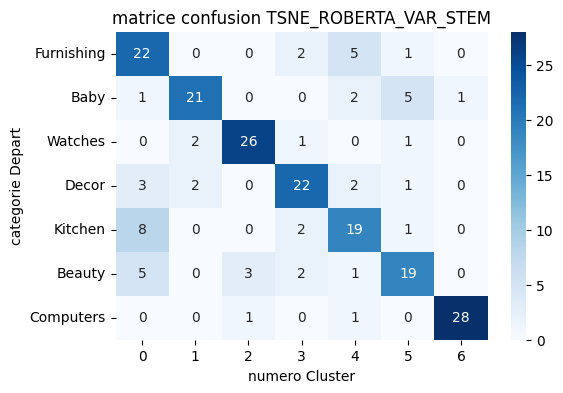

In [173]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.1.1.12  Mixte** - nom du produit et produit spécification stemmatisés</span> 

In [67]:
# Variable dont on veut extraire les features
data_work['var_prod_stem'] = data_work['pname_stem']
+ data_work['prod_spec_stem']
data_work['var_prod_stem'] = \
    data_work['var_prod_stem'].fillna('').astype(str)
data_var_prod_stem = data_work['var_prod_stem']

In [175]:
type_donnee = 'TSNE_ROBERTA_VAR_PROD_STEM'

# Instanciation du modèle
bert_var_prod_stem = SentenceTransformer('roberta-large-nli-mean-tokens')

# Encodage
vector_roberta_var_prod_stem = \
    bert_var_prod_stem.encode(data_var_prod_stem, show_progress_bar=False)

In [176]:
# Réduction de dimension tsne
tsne_roberta_var_prod_stem = TSNE(verbose=1, perplexity=50, n_iter=5000)
X_proj_tsne_roberta_var_prod_stem = \
    tsne_roberta_var_prod_stem.fit_transform(vector_roberta_var_prod_stem)
# Dataframe pour clustering
df_tsne_roberta_var_prod_stem = pd.DataFrame({'VAR1' : X_proj_tsne_roberta_var_prod_stem[:, 0],
                                           'VAR2' : X_proj_tsne_roberta_var_prod_stem[:, 1],
                                           'CATEGORIE' : data_work['category']})

[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.026s...
[t-SNE] Computed neighbors for 1050 samples in 0.211s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 9.270936
[t-SNE] KL divergence after 100 iterations with early exaggeration: 63.956825
[t-SNE] KL divergence after 5000 iterations: 0.896341


**Entraienement du modèle**

In [177]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_roberta_var_prod_stem[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [178]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.8464
Precision:
  - Macro: 0.8468
  - Micro: 0.8464
Recall:
  - Macro: 0.8464
  - Micro: 0.8464
F1-measure:
  - Macro: 0.8458
  - Micro: 0.8464


{'knn': {'micro_precision': 0.8464285714285714,
  'micro_recall': 0.8464285714285714,
  'micro_f1': 0.8464285714285714},
 'svm': {'micro_precision': 0.34285714285714286,
  'micro_recall': 0.34285714285714286,
  'micro_f1': 0.34285714285714286},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5619047619047619,
  'micro_recall': 0.5619047619047619,
  'micro_f1': 0.5619047619047619},
 'Gradient Boosting': {'micro_precision': 0.930952380952381,
  'micro_recall': 0.930952380952381,
  'micro_f1': 0.930952380952381},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

In [179]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.4679
Precision:
  - Macro: 0.3861
  - Micro: 0.4679
Recall:
  - Macro: 0.4679
  - Micro: 0.4679
F1-measure:
  - Macro: 0.3997
  - Micro: 0.4679


{'knn': {'micro_precision': 0.8464285714285714,
  'micro_recall': 0.8464285714285714,
  'micro_f1': 0.8464285714285714},
 'svm': {'micro_precision': 0.46785714285714286,
  'micro_recall': 0.46785714285714286,
  'micro_f1': 0.46785714285714286},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5619047619047619,
  'micro_recall': 0.5619047619047619,
  'micro_f1': 0.5619047619047619},
 'Gradient Boosting': {'micro_precision': 0.930952380952381,
  'micro_recall': 0.930952380952381,
  'micro_f1': 0.930952380952381},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

In [180]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 0.9988
Precision:
  - Macro: 0.9988
  - Micro: 0.9988
Recall:
  - Macro: 0.9988
  - Micro: 0.9988
F1-measure:
  - Macro: 0.9988
  - Micro: 0.9988


{'knn': {'micro_precision': 0.8464285714285714,
  'micro_recall': 0.8464285714285714,
  'micro_f1': 0.8464285714285714},
 'svm': {'micro_precision': 0.46785714285714286,
  'micro_recall': 0.46785714285714286,
  'micro_f1': 0.46785714285714286},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5619047619047619,
  'micro_recall': 0.5619047619047619,
  'micro_f1': 0.5619047619047619},
 'Gradient Boosting': {'micro_precision': 0.930952380952381,
  'micro_recall': 0.930952380952381,
  'micro_f1': 0.930952380952381},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

In [181]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.5905
Precision:
  - Macro: 0.5834
  - Micro: 0.5905
Recall:
  - Macro: 0.5905
  - Micro: 0.5905
F1-measure:
  - Macro: 0.5755
  - Micro: 0.5905


{'knn': {'micro_precision': 0.8464285714285714,
  'micro_recall': 0.8464285714285714,
  'micro_f1': 0.8464285714285714},
 'svm': {'micro_precision': 0.46785714285714286,
  'micro_recall': 0.46785714285714286,
  'micro_f1': 0.46785714285714286},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5904761904761905,
  'micro_recall': 0.5904761904761905,
  'micro_f1': 0.5904761904761905},
 'Gradient Boosting': {'micro_precision': 0.930952380952381,
  'micro_recall': 0.930952380952381,
  'micro_f1': 0.930952380952381},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

In [182]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9345
Precision:
  - Macro: 0.9399
  - Micro: 0.9345
Recall:
  - Macro: 0.9345
  - Micro: 0.9345
F1-measure:
  - Macro: 0.9352
  - Micro: 0.9345


{'knn': {'micro_precision': 0.8464285714285714,
  'micro_recall': 0.8464285714285714,
  'micro_f1': 0.8464285714285714},
 'svm': {'micro_precision': 0.46785714285714286,
  'micro_recall': 0.46785714285714286,
  'micro_f1': 0.46785714285714286},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5904761904761905,
  'micro_recall': 0.5904761904761905,
  'micro_f1': 0.5904761904761905},
 'Gradient Boosting': {'micro_precision': 0.9345238095238095,
  'micro_recall': 0.9345238095238095,
  'micro_f1': 0.9345238095238095},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

In [183]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 0.9988
Precision:
  - Macro: 0.9988
  - Micro: 0.9988
Recall:
  - Macro: 0.9988
  - Micro: 0.9988
F1-measure:
  - Macro: 0.9988
  - Micro: 0.9988


{'knn': {'micro_precision': 0.8464285714285714,
  'micro_recall': 0.8464285714285714,
  'micro_f1': 0.8464285714285714},
 'svm': {'micro_precision': 0.46785714285714286,
  'micro_recall': 0.46785714285714286,
  'micro_f1': 0.46785714285714286},
 'Random Forest': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'Naive Bayes': {'micro_precision': 0.5904761904761905,
  'micro_recall': 0.5904761904761905,
  'micro_f1': 0.5904761904761905},
 'Gradient Boosting': {'micro_precision': 0.9345238095238095,
  'micro_recall': 0.9345238095238095,
  'micro_f1': 0.9345238095238095},
 'extra tree classifier': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238}}

**Synthèse des résultats**

In [184]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.846429,0.846429,0.846429
svm,0.467857,0.467857,0.467857
Random Forest,0.998810,0.998810,0.998810
Naive Bayes,0.590476,0.590476,0.590476
Gradient Boosting,0.934524,0.934524,0.934524
extra tree classifier,0.998810,0.998810,0.998810


In [185]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.829


In [186]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)

labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_var_prod_stem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_var_prod_stem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[20  3  1  0  3  3  0]
 [ 1 21  0  1  5  2  0]
 [ 0  2 27  0  0  1  0]
 [ 0  2  0 25  3  0  0]
 [ 3  1  0  1 25  0  0]
 [ 2  0  1  0  1 26  0]
 [ 0  0  0  0  0  0 30]]
Correspondance des clusters :  [0 1 2 3 4 5 6]
Correspondance des clusters :  [0 1 2 3 4 5 6]

ACCURACY TSNE_ROBERTA_VAR_PROD_STEM (Test): 0.829
ACCURACY TSNE_ROBERTA_VAR_PROD_STEM (Train): 0.999


              precision    recall  f1-score   support

           0       0.77      0.67      0.71        30
           1       0.72      0.70      0.71        30
           2       0.93      0.90      0.92        30
           3       0.93      0.83      0.88        30
           4       0.68      0.83      0.75        30
           5       0.81      0.87      0.84        30
           6       1.00      1.00      1.00        30

    accuracy                           0.83       210
   macro avg       0.83      0.83      0.83       210
weighted avg       0.83      0.83      0.83       210



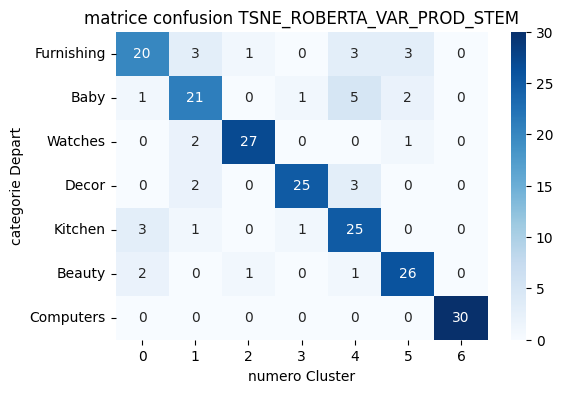

In [187]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

#### <span style='background:wheat'>6.1.2 CountVectorizer</span>

<span style='background:orange'>**6.1.2.1. produit_specifications** - lemmatisée </span>

**Sans réduction ACP**

In [307]:
# Variable dont on veut extraire les features
data_work['prod_spec_lem'] = \
    data_work['prod_spec_lem'].fillna('').astype(str)
data_prods_lem = data_work['prod_spec_lem']

In [331]:
type_donnee = 'TSNE_CV_PRODS_LEM'

In [320]:
df_prods_lem_cv = vectorize_text_data(data_prods_lem, CountVectorizer())
df_prods_lem_cv_tsne = tsne(df_prods_lem_cv, 40)

(1050, 2638)


In [321]:
# Dataframe pour clustering
df_prods_lem_cv_tsne = pd.DataFrame({'VAR1' : df_prods_lem_cv_tsne['DIM1'],
                                           'VAR2' : df_prods_lem_cv_tsne['DIM2'],
                                           'CATEGORIE' : data_work['category']})

**Entraienement du modèle**

In [316]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_prods_lem_cv_tsne[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [319]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.9131
Precision:
  - Macro: 0.9139
  - Micro: 0.9131
Recall:
  - Macro: 0.9131
  - Micro: 0.9131
F1-measure:
  - Macro: 0.9131
  - Micro: 0.9131


{'knn': {'micro_precision': 0.9130952380952381,
  'micro_recall': 0.9130952380952381,
  'micro_f1': 0.913095238095238}}

In [322]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.4583
Precision:
  - Macro: 0.3007
  - Micro: 0.4583
Recall:
  - Macro: 0.4583
  - Micro: 0.4583
F1-measure:
  - Macro: 0.3488
  - Micro: 0.4583


{'knn': {'micro_precision': 0.9130952380952381,
  'micro_recall': 0.9130952380952381,
  'micro_f1': 0.913095238095238},
 'svm': {'micro_precision': 0.4583333333333333,
  'micro_recall': 0.4583333333333333,
  'micro_f1': 0.4583333333333333}}

In [323]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9130952380952381,
  'micro_recall': 0.9130952380952381,
  'micro_f1': 0.913095238095238},
 'svm': {'micro_precision': 0.4583333333333333,
  'micro_recall': 0.4583333333333333,
  'micro_f1': 0.4583333333333333},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [324]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.6405
Precision:
  - Macro: 0.6716
  - Micro: 0.6405
Recall:
  - Macro: 0.6405
  - Micro: 0.6405
F1-measure:
  - Macro: 0.6275
  - Micro: 0.6405


{'knn': {'micro_precision': 0.9130952380952381,
  'micro_recall': 0.9130952380952381,
  'micro_f1': 0.913095238095238},
 'svm': {'micro_precision': 0.4583333333333333,
  'micro_recall': 0.4583333333333333,
  'micro_f1': 0.4583333333333333},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6404761904761904,
  'micro_recall': 0.6404761904761904,
  'micro_f1': 0.6404761904761904}}

In [325]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9869
Precision:
  - Macro: 0.9871
  - Micro: 0.9869
Recall:
  - Macro: 0.9869
  - Micro: 0.9869
F1-measure:
  - Macro: 0.9868
  - Micro: 0.9869


{'knn': {'micro_precision': 0.9130952380952381,
  'micro_recall': 0.9130952380952381,
  'micro_f1': 0.913095238095238},
 'svm': {'micro_precision': 0.4583333333333333,
  'micro_recall': 0.4583333333333333,
  'micro_f1': 0.4583333333333333},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6404761904761904,
  'micro_recall': 0.6404761904761904,
  'micro_f1': 0.6404761904761904},
 'Gradient Boosting': {'micro_precision': 0.986904761904762,
  'micro_recall': 0.986904761904762,
  'micro_f1': 0.986904761904762}}

In [326]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9130952380952381,
  'micro_recall': 0.9130952380952381,
  'micro_f1': 0.913095238095238},
 'svm': {'micro_precision': 0.4583333333333333,
  'micro_recall': 0.4583333333333333,
  'micro_f1': 0.4583333333333333},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6404761904761904,
  'micro_recall': 0.6404761904761904,
  'micro_f1': 0.6404761904761904},
 'Gradient Boosting': {'micro_precision': 0.986904761904762,
  'micro_recall': 0.986904761904762,
  'micro_f1': 0.986904761904762},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [327]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.913095,0.913095,0.913095
svm,0.458333,0.458333,0.458333
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.640476,0.640476,0.640476
Gradient Boosting,0.986905,0.986905,0.986905
extra tree classifier,1.000000,1.000000,1.000000


In [328]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.867


In [332]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)

labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_var_prod_stem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_var_prod_stem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[20  2  2  2  4  0  0]
 [ 1 25  3  0  0  1  0]
 [ 0  0 27  0  0  3  0]
 [ 0  0  0 27  0  3  0]
 [ 5  0  0  0 25  0  0]
 [ 0  1  0  1  0 28  0]
 [ 0  0  0  0  0  0 30]]

ACCURACY TSNE_CV_PRODS_LEM (Test): 0.867
ACCURACY TSNE_CV_PRODS_LEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.77      0.67      0.71        30
           1       0.89      0.83      0.86        30
           2       0.84      0.90      0.87        30
           3       0.90      0.90      0.90        30
           4       0.86      0.83      0.85        30
           5       0.80      0.93      0.86        30
           6       1.00      1.00      1.00        30

    accuracy                           0.87       210
   macro avg       0.87      0.87      0.87       210
weighted avg       0.87      0.87      0.87       210



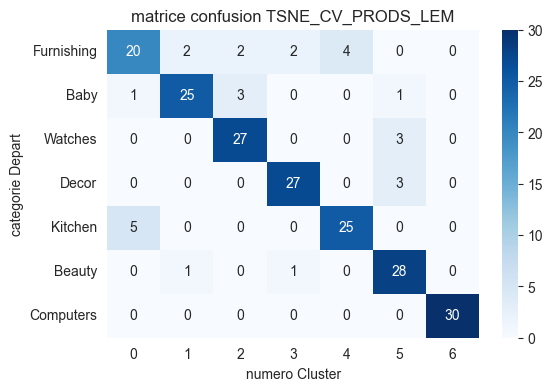

In [335]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

**Avec réduction ACP**

In [367]:
type_donnee = 'TSNE_ACP_CV_PRODS_LEM'

df_data_prods_lem_cv = vectorize_text_data(data_prods_lem, CountVectorizer())
df_data_prods_lem_cv_acp = acp(df_data_prods_lem_cv)
df_data_prods_lem_cv_acp_tsne = tsne(df_data_prods_lem_cv_acp, 40)

(1050, 2638)
Nombre de features après réduction ACP pour 99.0% de variance : 393


In [355]:
# Dataframe pour clustering
df_data_prods_lem_cv_acp_tsne = pd.DataFrame({'VAR1' : df_data_prods_lem_cv_acp_tsne['DIM1'],
                                           'VAR2' : df_data_prods_lem_cv_acp_tsne['DIM2'],
                                           'CATEGORIE' : data_work['category']})

**Entrainement du modèle**

In [356]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_data_prods_lem_cv_acp_tsne[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [357]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.9179
Precision:
  - Macro: 0.9186
  - Micro: 0.9179
Recall:
  - Macro: 0.9179
  - Micro: 0.9179
F1-measure:
  - Macro: 0.9177
  - Micro: 0.9179


{'knn': {'micro_precision': 0.9178571428571428,
  'micro_recall': 0.9178571428571428,
  'micro_f1': 0.9178571428571429},
 'svm': {'micro_precision': 0.5166666666666667,
  'micro_recall': 0.5166666666666667,
  'micro_f1': 0.5166666666666667},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6416666666666667,
  'micro_recall': 0.6416666666666667,
  'micro_f1': 0.6416666666666667},
 'Gradient Boosting': {'micro_precision': 0.9821428571428571,
  'micro_recall': 0.9821428571428571,
  'micro_f1': 0.9821428571428571},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [358]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.4119
Precision:
  - Macro: 0.2865
  - Micro: 0.4119
Recall:
  - Macro: 0.4119
  - Micro: 0.4119
F1-measure:
  - Macro: 0.3079
  - Micro: 0.4119


{'knn': {'micro_precision': 0.9178571428571428,
  'micro_recall': 0.9178571428571428,
  'micro_f1': 0.9178571428571429},
 'svm': {'micro_precision': 0.4119047619047619,
  'micro_recall': 0.4119047619047619,
  'micro_f1': 0.4119047619047619},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6416666666666667,
  'micro_recall': 0.6416666666666667,
  'micro_f1': 0.6416666666666667},
 'Gradient Boosting': {'micro_precision': 0.9821428571428571,
  'micro_recall': 0.9821428571428571,
  'micro_f1': 0.9821428571428571},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [359]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9178571428571428,
  'micro_recall': 0.9178571428571428,
  'micro_f1': 0.9178571428571429},
 'svm': {'micro_precision': 0.4119047619047619,
  'micro_recall': 0.4119047619047619,
  'micro_f1': 0.4119047619047619},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6416666666666667,
  'micro_recall': 0.6416666666666667,
  'micro_f1': 0.6416666666666667},
 'Gradient Boosting': {'micro_precision': 0.9821428571428571,
  'micro_recall': 0.9821428571428571,
  'micro_f1': 0.9821428571428571},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [360]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.6143
Precision:
  - Macro: 0.6427
  - Micro: 0.6143
Recall:
  - Macro: 0.6143
  - Micro: 0.6143
F1-measure:
  - Macro: 0.5984
  - Micro: 0.6143


{'knn': {'micro_precision': 0.9178571428571428,
  'micro_recall': 0.9178571428571428,
  'micro_f1': 0.9178571428571429},
 'svm': {'micro_precision': 0.4119047619047619,
  'micro_recall': 0.4119047619047619,
  'micro_f1': 0.4119047619047619},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6142857142857143,
  'micro_recall': 0.6142857142857143,
  'micro_f1': 0.6142857142857143},
 'Gradient Boosting': {'micro_precision': 0.9821428571428571,
  'micro_recall': 0.9821428571428571,
  'micro_f1': 0.9821428571428571},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [361]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9905
Precision:
  - Macro: 0.9906
  - Micro: 0.9905
Recall:
  - Macro: 0.9905
  - Micro: 0.9905
F1-measure:
  - Macro: 0.9905
  - Micro: 0.9905


{'knn': {'micro_precision': 0.9178571428571428,
  'micro_recall': 0.9178571428571428,
  'micro_f1': 0.9178571428571429},
 'svm': {'micro_precision': 0.4119047619047619,
  'micro_recall': 0.4119047619047619,
  'micro_f1': 0.4119047619047619},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6142857142857143,
  'micro_recall': 0.6142857142857143,
  'micro_f1': 0.6142857142857143},
 'Gradient Boosting': {'micro_precision': 0.9904761904761905,
  'micro_recall': 0.9904761904761905,
  'micro_f1': 0.9904761904761905},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [362]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9178571428571428,
  'micro_recall': 0.9178571428571428,
  'micro_f1': 0.9178571428571429},
 'svm': {'micro_precision': 0.4119047619047619,
  'micro_recall': 0.4119047619047619,
  'micro_f1': 0.4119047619047619},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6142857142857143,
  'micro_recall': 0.6142857142857143,
  'micro_f1': 0.6142857142857143},
 'Gradient Boosting': {'micro_precision': 0.9904761904761905,
  'micro_recall': 0.9904761904761905,
  'micro_f1': 0.9904761904761905},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [363]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.917857,0.917857,0.917857
svm,0.411905,0.411905,0.411905
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.614286,0.614286,0.614286
Gradient Boosting,0.990476,0.990476,0.990476
extra tree classifier,1.000000,1.000000,1.000000


In [364]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.871


In [365]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)

labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_var_prod_stem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_var_prod_stem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[22  1  1  3  3  0  0]
 [ 2 25  3  0  0  0  0]
 [ 0  0 27  1  1  1  0]
 [ 0  0  1 26  0  3  0]
 [ 4  0  0  2 24  0  0]
 [ 0  1  0  0  0 29  0]
 [ 0  0  0  0  0  0 30]]

ACCURACY TSNE_CV_PRODS_STEM (Test): 0.871
ACCURACY TSNE_CV_PRODS_STEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.79      0.73      0.76        30
           1       0.93      0.83      0.88        30
           2       0.84      0.90      0.87        30
           3       0.81      0.87      0.84        30
           4       0.86      0.80      0.83        30
           5       0.88      0.97      0.92        30
           6       1.00      1.00      1.00        30

    accuracy                           0.87       210
   macro avg       0.87      0.87      0.87       210
weighted avg       0.87      0.87      0.87       210



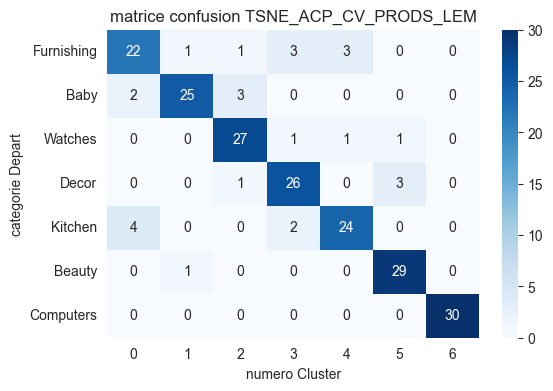

In [372]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.2.2. produit_specifications** - racinisée </span>

**Sans réduction ACP**

In [336]:
# Variable dont on veut extraire les features
data_work['prod_spec_stem'] = \
    data_work['prod_spec_stem'].fillna('').astype(str)
data_prods_stem = data_work['prod_spec_stem']

In [337]:
type_donnee = 'TSNE_CV_PRODS_STEM'

df_prods_stem_cv = vectorize_text_data(data_prods_stem, CountVectorizer())
df_prods_stem_cv_tsne = tsne(df_prods_stem_cv, 40)

(1050, 2544)


In [338]:
# Dataframe pour clustering
df_prods_stem_cv_tsne = pd.DataFrame({'VAR1' : df_prods_stem_cv_tsne['DIM1'],
                                           'VAR2' : df_prods_stem_cv_tsne['DIM2'],
                                           'CATEGORIE' : data_work['category']})

**Entrainement du modèle**

In [340]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_prods_stem_cv_tsne[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [341]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.9107
Precision:
  - Macro: 0.9111
  - Micro: 0.9107
Recall:
  - Macro: 0.9107
  - Micro: 0.9107
F1-measure:
  - Macro: 0.9106
  - Micro: 0.9107


{'knn': {'micro_precision': 0.9107142857142857,
  'micro_recall': 0.9107142857142857,
  'micro_f1': 0.9107142857142857},
 'svm': {'micro_precision': 0.4583333333333333,
  'micro_recall': 0.4583333333333333,
  'micro_f1': 0.4583333333333333},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6404761904761904,
  'micro_recall': 0.6404761904761904,
  'micro_f1': 0.6404761904761904},
 'Gradient Boosting': {'micro_precision': 0.986904761904762,
  'micro_recall': 0.986904761904762,
  'micro_f1': 0.986904761904762},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [342]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.5167
Precision:
  - Macro: 0.4787
  - Micro: 0.5167
Recall:
  - Macro: 0.5167
  - Micro: 0.5167
F1-measure:
  - Macro: 0.4605
  - Micro: 0.5167


{'knn': {'micro_precision': 0.9107142857142857,
  'micro_recall': 0.9107142857142857,
  'micro_f1': 0.9107142857142857},
 'svm': {'micro_precision': 0.5166666666666667,
  'micro_recall': 0.5166666666666667,
  'micro_f1': 0.5166666666666667},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6404761904761904,
  'micro_recall': 0.6404761904761904,
  'micro_f1': 0.6404761904761904},
 'Gradient Boosting': {'micro_precision': 0.986904761904762,
  'micro_recall': 0.986904761904762,
  'micro_f1': 0.986904761904762},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [343]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9107142857142857,
  'micro_recall': 0.9107142857142857,
  'micro_f1': 0.9107142857142857},
 'svm': {'micro_precision': 0.5166666666666667,
  'micro_recall': 0.5166666666666667,
  'micro_f1': 0.5166666666666667},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6404761904761904,
  'micro_recall': 0.6404761904761904,
  'micro_f1': 0.6404761904761904},
 'Gradient Boosting': {'micro_precision': 0.986904761904762,
  'micro_recall': 0.986904761904762,
  'micro_f1': 0.986904761904762},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [344]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.6417
Precision:
  - Macro: 0.6740
  - Micro: 0.6417
Recall:
  - Macro: 0.6417
  - Micro: 0.6417
F1-measure:
  - Macro: 0.6304
  - Micro: 0.6417


{'knn': {'micro_precision': 0.9107142857142857,
  'micro_recall': 0.9107142857142857,
  'micro_f1': 0.9107142857142857},
 'svm': {'micro_precision': 0.5166666666666667,
  'micro_recall': 0.5166666666666667,
  'micro_f1': 0.5166666666666667},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6416666666666667,
  'micro_recall': 0.6416666666666667,
  'micro_f1': 0.6416666666666667},
 'Gradient Boosting': {'micro_precision': 0.986904761904762,
  'micro_recall': 0.986904761904762,
  'micro_f1': 0.986904761904762},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [345]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9821
Precision:
  - Macro: 0.9824
  - Micro: 0.9821
Recall:
  - Macro: 0.9821
  - Micro: 0.9821
F1-measure:
  - Macro: 0.9822
  - Micro: 0.9821


{'knn': {'micro_precision': 0.9107142857142857,
  'micro_recall': 0.9107142857142857,
  'micro_f1': 0.9107142857142857},
 'svm': {'micro_precision': 0.5166666666666667,
  'micro_recall': 0.5166666666666667,
  'micro_f1': 0.5166666666666667},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6416666666666667,
  'micro_recall': 0.6416666666666667,
  'micro_f1': 0.6416666666666667},
 'Gradient Boosting': {'micro_precision': 0.9821428571428571,
  'micro_recall': 0.9821428571428571,
  'micro_f1': 0.9821428571428571},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [346]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9107142857142857,
  'micro_recall': 0.9107142857142857,
  'micro_f1': 0.9107142857142857},
 'svm': {'micro_precision': 0.5166666666666667,
  'micro_recall': 0.5166666666666667,
  'micro_f1': 0.5166666666666667},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6416666666666667,
  'micro_recall': 0.6416666666666667,
  'micro_f1': 0.6416666666666667},
 'Gradient Boosting': {'micro_precision': 0.9821428571428571,
  'micro_recall': 0.9821428571428571,
  'micro_f1': 0.9821428571428571},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [347]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.910714,0.910714,0.910714
svm,0.516667,0.516667,0.516667
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.641667,0.641667,0.641667
Gradient Boosting,0.982143,0.982143,0.982143
extra tree classifier,1.000000,1.000000,1.000000


In [348]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.857


In [349]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)

labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_var_prod_stem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_var_prod_stem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[19  2  3  2  3  1  0]
 [ 1 24  2  1  0  1  1]
 [ 0  0 27  1  0  2  0]
 [ 0  0  0 28  0  2  0]
 [ 3  0  0  1 25  1  0]
 [ 0  1  0  2  0 27  0]
 [ 0  0  0  0  0  0 30]]

ACCURACY TSNE_CV_PRODS_STEM (Test): 0.857
ACCURACY TSNE_CV_PRODS_STEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.83      0.63      0.72        30
           1       0.89      0.80      0.84        30
           2       0.84      0.90      0.87        30
           3       0.80      0.93      0.86        30
           4       0.89      0.83      0.86        30
           5       0.79      0.90      0.84        30
           6       0.97      1.00      0.98        30

    accuracy                           0.86       210
   macro avg       0.86      0.86      0.85       210
weighted avg       0.86      0.86      0.85       210



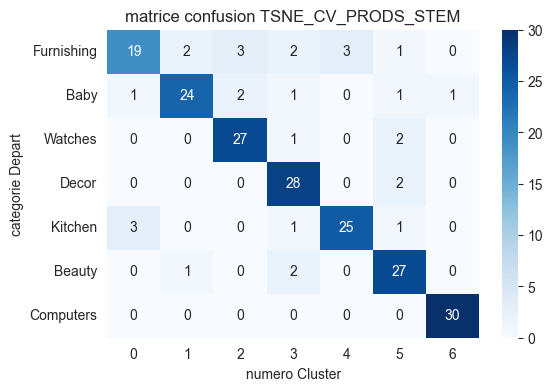

In [350]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

**Avec réduction ACP**

In [373]:
type_donnee = 'TSNE_ACP_CV_PRODS_STEM'

df_data_prods_stem_cv = vectorize_text_data(data_prods_stem, CountVectorizer())
df_data_prods_stem_cv_acp = acp(df_data_prods_stem_cv)
df_data_prods_stem_cv_acp_tsne = tsne(df_data_prods_stem_cv_acp, 40)

(1050, 2544)
Nombre de features après réduction ACP pour 99.0% de variance : 388


In [374]:
# Dataframe pour clustering
df_data_prods_stem_cv_acp_tsne = pd.DataFrame({'VAR1' : df_data_prods_stem_cv_acp_tsne['DIM1'],
                                           'VAR2' : df_data_prods_stem_cv_acp_tsne['DIM2'],
                                           'CATEGORIE' : data_work['category']})

**Entrainement du modèle**

In [375]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_data_prods_stem_cv_acp_tsne[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [376]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.9143
Precision:
  - Macro: 0.9148
  - Micro: 0.9143
Recall:
  - Macro: 0.9143
  - Micro: 0.9143
F1-measure:
  - Macro: 0.9140
  - Micro: 0.9143


{'knn': {'micro_precision': 0.9142857142857143,
  'micro_recall': 0.9142857142857143,
  'micro_f1': 0.9142857142857143},
 'svm': {'micro_precision': 0.4119047619047619,
  'micro_recall': 0.4119047619047619,
  'micro_f1': 0.4119047619047619},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6142857142857143,
  'micro_recall': 0.6142857142857143,
  'micro_f1': 0.6142857142857143},
 'Gradient Boosting': {'micro_precision': 0.9904761904761905,
  'micro_recall': 0.9904761904761905,
  'micro_f1': 0.9904761904761905},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [377]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.4024
Precision:
  - Macro: 0.3894
  - Micro: 0.4024
Recall:
  - Macro: 0.4024
  - Micro: 0.4024
F1-measure:
  - Macro: 0.3526
  - Micro: 0.4024


{'knn': {'micro_precision': 0.9142857142857143,
  'micro_recall': 0.9142857142857143,
  'micro_f1': 0.9142857142857143},
 'svm': {'micro_precision': 0.4023809523809524,
  'micro_recall': 0.4023809523809524,
  'micro_f1': 0.4023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6142857142857143,
  'micro_recall': 0.6142857142857143,
  'micro_f1': 0.6142857142857143},
 'Gradient Boosting': {'micro_precision': 0.9904761904761905,
  'micro_recall': 0.9904761904761905,
  'micro_f1': 0.9904761904761905},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [378]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9142857142857143,
  'micro_recall': 0.9142857142857143,
  'micro_f1': 0.9142857142857143},
 'svm': {'micro_precision': 0.4023809523809524,
  'micro_recall': 0.4023809523809524,
  'micro_f1': 0.4023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6142857142857143,
  'micro_recall': 0.6142857142857143,
  'micro_f1': 0.6142857142857143},
 'Gradient Boosting': {'micro_precision': 0.9904761904761905,
  'micro_recall': 0.9904761904761905,
  'micro_f1': 0.9904761904761905},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [379]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.6167
Precision:
  - Macro: 0.6439
  - Micro: 0.6167
Recall:
  - Macro: 0.6167
  - Micro: 0.6167
F1-measure:
  - Macro: 0.6002
  - Micro: 0.6167


{'knn': {'micro_precision': 0.9142857142857143,
  'micro_recall': 0.9142857142857143,
  'micro_f1': 0.9142857142857143},
 'svm': {'micro_precision': 0.4023809523809524,
  'micro_recall': 0.4023809523809524,
  'micro_f1': 0.4023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6166666666666667,
  'micro_recall': 0.6166666666666667,
  'micro_f1': 0.6166666666666667},
 'Gradient Boosting': {'micro_precision': 0.9904761904761905,
  'micro_recall': 0.9904761904761905,
  'micro_f1': 0.9904761904761905},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [380]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9905
Precision:
  - Macro: 0.9906
  - Micro: 0.9905
Recall:
  - Macro: 0.9905
  - Micro: 0.9905
F1-measure:
  - Macro: 0.9905
  - Micro: 0.9905


{'knn': {'micro_precision': 0.9142857142857143,
  'micro_recall': 0.9142857142857143,
  'micro_f1': 0.9142857142857143},
 'svm': {'micro_precision': 0.4023809523809524,
  'micro_recall': 0.4023809523809524,
  'micro_f1': 0.4023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6166666666666667,
  'micro_recall': 0.6166666666666667,
  'micro_f1': 0.6166666666666667},
 'Gradient Boosting': {'micro_precision': 0.9904761904761905,
  'micro_recall': 0.9904761904761905,
  'micro_f1': 0.9904761904761905},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [381]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9142857142857143,
  'micro_recall': 0.9142857142857143,
  'micro_f1': 0.9142857142857143},
 'svm': {'micro_precision': 0.4023809523809524,
  'micro_recall': 0.4023809523809524,
  'micro_f1': 0.4023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6166666666666667,
  'micro_recall': 0.6166666666666667,
  'micro_f1': 0.6166666666666667},
 'Gradient Boosting': {'micro_precision': 0.9904761904761905,
  'micro_recall': 0.9904761904761905,
  'micro_f1': 0.9904761904761905},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [382]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.914286,0.914286,0.914286
svm,0.402381,0.402381,0.402381
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.616667,0.616667,0.616667
Gradient Boosting,0.990476,0.990476,0.990476
extra tree classifier,1.000000,1.000000,1.000000


In [383]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.862


In [384]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)

labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_var_prod_stem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_var_prod_stem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[20  1  1  3  4  1  0]
 [ 2 25  2  0  0  0  1]
 [ 0  0 27  1  0  2  0]
 [ 0  0  0 28  0  2  0]
 [ 4  0  0  1 24  1  0]
 [ 0  0  0  3  0 27  0]
 [ 0  0  0  0  0  0 30]]

ACCURACY TSNE_ACP_CV_PRODS_STEM (Test): 0.862
ACCURACY TSNE_ACP_CV_PRODS_STEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.77      0.67      0.71        30
           1       0.96      0.83      0.89        30
           2       0.90      0.90      0.90        30
           3       0.78      0.93      0.85        30
           4       0.86      0.80      0.83        30
           5       0.82      0.90      0.86        30
           6       0.97      1.00      0.98        30

    accuracy                           0.86       210
   macro avg       0.86      0.86      0.86       210
weighted avg       0.86      0.86      0.86       210



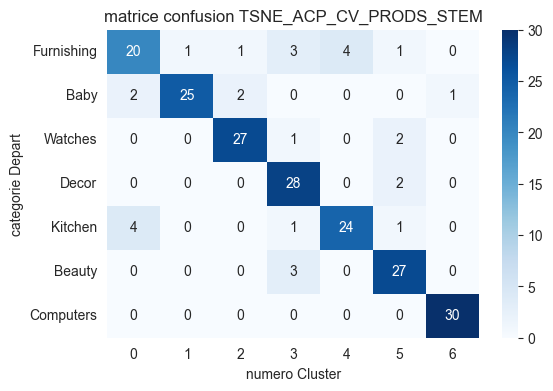

In [385]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

#### <span style='background:wheat'>6.1.3 TfIdfVectorizer</span>

<span style='background:orange'>**6.1.3.1. produit_specifications** - lemmatisée </span>

**Sans réduction ACP**

In [387]:
type_donnee = 'TSNE_TFIDF_PRODS_LEM'

In [386]:
df_prods_lem_tfidf = vectorize_text_data(data_prods_lem, TfidfVectorizer())
df_prods_lem_tfidf_tsne = tsne(df_prods_lem_tfidf, 40)

(1050, 2638)


In [388]:
# Dataframe pour clustering
df_prods_lem_tfidf_tsne = pd.DataFrame({'VAR1' : df_prods_lem_tfidf_tsne['DIM1'],
                                           'VAR2' : df_prods_lem_tfidf_tsne['DIM2'],
                                           'CATEGORIE' : data_work['category']})

**Entraienment du modèle**

In [389]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_prods_lem_tfidf_tsne[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [390]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.9417
Precision:
  - Macro: 0.9421
  - Micro: 0.9417
Recall:
  - Macro: 0.9417
  - Micro: 0.9417
F1-measure:
  - Macro: 0.9416
  - Micro: 0.9417


{'knn': {'micro_precision': 0.9416666666666667,
  'micro_recall': 0.9416666666666667,
  'micro_f1': 0.9416666666666667},
 'svm': {'micro_precision': 0.4023809523809524,
  'micro_recall': 0.4023809523809524,
  'micro_f1': 0.4023809523809524},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6166666666666667,
  'micro_recall': 0.6166666666666667,
  'micro_f1': 0.6166666666666667},
 'Gradient Boosting': {'micro_precision': 0.9904761904761905,
  'micro_recall': 0.9904761904761905,
  'micro_f1': 0.9904761904761905},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [391]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.3048
Precision:
  - Macro: 0.1613
  - Micro: 0.3048
Recall:
  - Macro: 0.3048
  - Micro: 0.3048
F1-measure:
  - Macro: 0.2066
  - Micro: 0.3048


{'knn': {'micro_precision': 0.9416666666666667,
  'micro_recall': 0.9416666666666667,
  'micro_f1': 0.9416666666666667},
 'svm': {'micro_precision': 0.3047619047619048,
  'micro_recall': 0.3047619047619048,
  'micro_f1': 0.3047619047619048},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6166666666666667,
  'micro_recall': 0.6166666666666667,
  'micro_f1': 0.6166666666666667},
 'Gradient Boosting': {'micro_precision': 0.9904761904761905,
  'micro_recall': 0.9904761904761905,
  'micro_f1': 0.9904761904761905},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [392]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9416666666666667,
  'micro_recall': 0.9416666666666667,
  'micro_f1': 0.9416666666666667},
 'svm': {'micro_precision': 0.3047619047619048,
  'micro_recall': 0.3047619047619048,
  'micro_f1': 0.3047619047619048},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.6166666666666667,
  'micro_recall': 0.6166666666666667,
  'micro_f1': 0.6166666666666667},
 'Gradient Boosting': {'micro_precision': 0.9904761904761905,
  'micro_recall': 0.9904761904761905,
  'micro_f1': 0.9904761904761905},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [393]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.7500
Precision:
  - Macro: 0.7686
  - Micro: 0.7500
Recall:
  - Macro: 0.7500
  - Micro: 0.7500
F1-measure:
  - Macro: 0.7494
  - Micro: 0.7500


{'knn': {'micro_precision': 0.9416666666666667,
  'micro_recall': 0.9416666666666667,
  'micro_f1': 0.9416666666666667},
 'svm': {'micro_precision': 0.3047619047619048,
  'micro_recall': 0.3047619047619048,
  'micro_f1': 0.3047619047619048},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.75,
  'micro_recall': 0.75,
  'micro_f1': 0.75},
 'Gradient Boosting': {'micro_precision': 0.9904761904761905,
  'micro_recall': 0.9904761904761905,
  'micro_f1': 0.9904761904761905},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [394]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9929
Precision:
  - Macro: 0.9929
  - Micro: 0.9929
Recall:
  - Macro: 0.9929
  - Micro: 0.9929
F1-measure:
  - Macro: 0.9928
  - Micro: 0.9929


{'knn': {'micro_precision': 0.9416666666666667,
  'micro_recall': 0.9416666666666667,
  'micro_f1': 0.9416666666666667},
 'svm': {'micro_precision': 0.3047619047619048,
  'micro_recall': 0.3047619047619048,
  'micro_f1': 0.3047619047619048},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.75,
  'micro_recall': 0.75,
  'micro_f1': 0.75},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [395]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9416666666666667,
  'micro_recall': 0.9416666666666667,
  'micro_f1': 0.9416666666666667},
 'svm': {'micro_precision': 0.3047619047619048,
  'micro_recall': 0.3047619047619048,
  'micro_f1': 0.3047619047619048},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.75,
  'micro_recall': 0.75,
  'micro_f1': 0.75},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [396]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.941667,0.941667,0.941667
svm,0.304762,0.304762,0.304762
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.750000,0.750000,0.750000
Gradient Boosting,0.992857,0.992857,0.992857
extra tree classifier,1.000000,1.000000,1.000000


In [397]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.905


In [398]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)

labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_var_prod_stem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_var_prod_stem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[22  2  0  1  5  0  0]
 [ 1 25  1  3  0  0  0]
 [ 0  0 28  2  0  0  0]
 [ 0  1  0 28  0  1  0]
 [ 1  0  0  1 28  0  0]
 [ 0  1  0  0  0 29  0]
 [ 0  0  0  0  0  0 30]]

ACCURACY TSNE_TFIDF_PRODS_LEM (Test): 0.905
ACCURACY TSNE_TFIDF_PRODS_LEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.92      0.73      0.81        30
           1       0.86      0.83      0.85        30
           2       0.97      0.93      0.95        30
           3       0.80      0.93      0.86        30
           4       0.85      0.93      0.89        30
           5       0.97      0.97      0.97        30
           6       1.00      1.00      1.00        30

    accuracy                           0.90       210
   macro avg       0.91      0.90      0.90       210
weighted avg       0.91      0.90      0.90       210



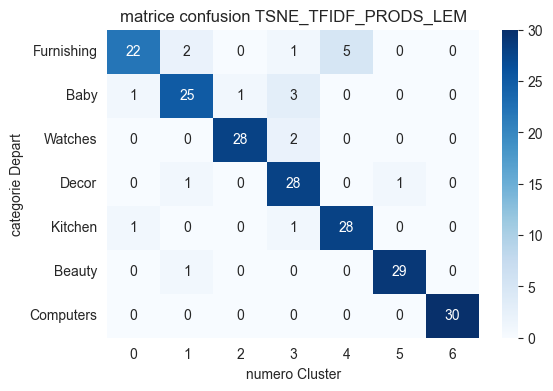

In [399]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

**Avec réduction ACP**

In [401]:
type_donnee = 'TSNE_ACP_TFIDF_PRODS_LEM'

df_data_prods_lem_tfidf = vectorize_text_data(data_prods_lem, TfidfVectorizer())
df_data_prods_lem_tfidf_acp = acp(df_data_prods_lem_tfidf)
df_data_prods_lem_tfidf_acp_tsne = tsne(df_data_prods_lem_tfidf_acp, 40)

(1050, 2638)
Nombre de features après réduction ACP pour 99.0% de variance : 736


In [402]:
# Dataframe pour clustering
df_data_prods_lem_tfidf_acp_tsne = pd.DataFrame({'VAR1' : df_data_prods_lem_tfidf_acp_tsne['DIM1'],
                                           'VAR2' : df_data_prods_lem_tfidf_acp_tsne['DIM2'],
                                           'CATEGORIE' : data_work['category']})

**Entrainement du modèle**

In [403]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_data_prods_lem_tfidf_acp_tsne[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [404]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.9381
Precision:
  - Macro: 0.9383
  - Micro: 0.9381
Recall:
  - Macro: 0.9381
  - Micro: 0.9381
F1-measure:
  - Macro: 0.9381
  - Micro: 0.9381


{'knn': {'micro_precision': 0.9380952380952381,
  'micro_recall': 0.9380952380952381,
  'micro_f1': 0.9380952380952381},
 'svm': {'micro_precision': 0.3047619047619048,
  'micro_recall': 0.3047619047619048,
  'micro_f1': 0.3047619047619048},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.75,
  'micro_recall': 0.75,
  'micro_f1': 0.75},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [405]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.6119
Precision:
  - Macro: 0.5433
  - Micro: 0.6119
Recall:
  - Macro: 0.6119
  - Micro: 0.6119
F1-measure:
  - Macro: 0.5638
  - Micro: 0.6119


{'knn': {'micro_precision': 0.9380952380952381,
  'micro_recall': 0.9380952380952381,
  'micro_f1': 0.9380952380952381},
 'svm': {'micro_precision': 0.611904761904762,
  'micro_recall': 0.611904761904762,
  'micro_f1': 0.611904761904762},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.75,
  'micro_recall': 0.75,
  'micro_f1': 0.75},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [406]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9380952380952381,
  'micro_recall': 0.9380952380952381,
  'micro_f1': 0.9380952380952381},
 'svm': {'micro_precision': 0.611904761904762,
  'micro_recall': 0.611904761904762,
  'micro_f1': 0.611904761904762},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.75,
  'micro_recall': 0.75,
  'micro_f1': 0.75},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [407]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.7762
Precision:
  - Macro: 0.7889
  - Micro: 0.7762
Recall:
  - Macro: 0.7762
  - Micro: 0.7762
F1-measure:
  - Macro: 0.7743
  - Micro: 0.7762


{'knn': {'micro_precision': 0.9380952380952381,
  'micro_recall': 0.9380952380952381,
  'micro_f1': 0.9380952380952381},
 'svm': {'micro_precision': 0.611904761904762,
  'micro_recall': 0.611904761904762,
  'micro_f1': 0.611904761904762},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7761904761904762,
  'micro_recall': 0.7761904761904762,
  'micro_f1': 0.7761904761904762},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [408]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9929
Precision:
  - Macro: 0.9929
  - Micro: 0.9929
Recall:
  - Macro: 0.9929
  - Micro: 0.9929
F1-measure:
  - Macro: 0.9929
  - Micro: 0.9929


{'knn': {'micro_precision': 0.9380952380952381,
  'micro_recall': 0.9380952380952381,
  'micro_f1': 0.9380952380952381},
 'svm': {'micro_precision': 0.611904761904762,
  'micro_recall': 0.611904761904762,
  'micro_f1': 0.611904761904762},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7761904761904762,
  'micro_recall': 0.7761904761904762,
  'micro_f1': 0.7761904761904762},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [409]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9380952380952381,
  'micro_recall': 0.9380952380952381,
  'micro_f1': 0.9380952380952381},
 'svm': {'micro_precision': 0.611904761904762,
  'micro_recall': 0.611904761904762,
  'micro_f1': 0.611904761904762},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7761904761904762,
  'micro_recall': 0.7761904761904762,
  'micro_f1': 0.7761904761904762},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [410]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.938095,0.938095,0.938095
svm,0.611905,0.611905,0.611905
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.776190,0.776190,0.776190
Gradient Boosting,0.992857,0.992857,0.992857
extra tree classifier,1.000000,1.000000,1.000000


In [411]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.862


In [412]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)

labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_var_prod_stem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_var_prod_stem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[19  2  0  2  7  0  0]
 [ 0 24  1  3  0  1  1]
 [ 0  0 28  1  1  0  0]
 [ 0  1  1 26  1  1  0]
 [ 4  0  0  1 25  0  0]
 [ 0  0  0  1  0 29  0]
 [ 0  0  0  0  0  0 30]]

ACCURACY TSNE_ACP_TFIDF_PRODS_LEM (Test): 0.862
ACCURACY TSNE_ACP_TFIDF_PRODS_LEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.83      0.63      0.72        30
           1       0.89      0.80      0.84        30
           2       0.93      0.93      0.93        30
           3       0.76      0.87      0.81        30
           4       0.74      0.83      0.78        30
           5       0.94      0.97      0.95        30
           6       0.97      1.00      0.98        30

    accuracy                           0.86       210
   macro avg       0.86      0.86      0.86       210
weighted avg       0.86      0.86      0.86       210



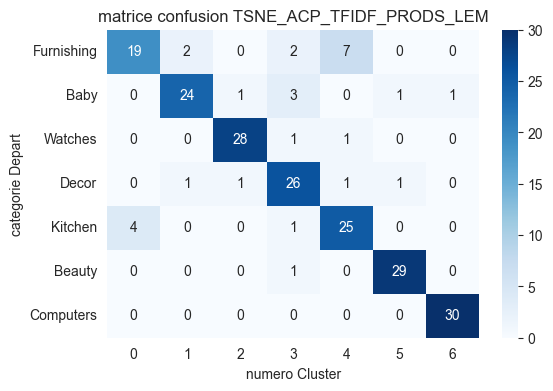

In [413]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

<span style='background:orange'>**6.1.3.2. produit_specifications** - racinisée </span>

**Sans réduction ACP**

In [414]:
type_donnee = 'TSNE_TFIDF_PRODS_STEM'

In [415]:
df_prods_stem_tfidf = vectorize_text_data(data_prods_stem, TfidfVectorizer())
df_prods_stem_tfidf_tsne = tsne(df_prods_stem_tfidf, 40)

(1050, 2544)


In [416]:
# Dataframe pour clustering
df_prods_stem_tfidf_tsne = pd.DataFrame({'VAR1' : df_prods_stem_tfidf_tsne['DIM1'],
                                           'VAR2' : df_prods_stem_tfidf_tsne['DIM2'],
                                           'CATEGORIE' : data_work['category']})

**Entrainement du modèle**

In [418]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_prods_stem_tfidf_tsne[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [419]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.9369
Precision:
  - Macro: 0.9369
  - Micro: 0.9369
Recall:
  - Macro: 0.9369
  - Micro: 0.9369
F1-measure:
  - Macro: 0.9367
  - Micro: 0.9369


{'knn': {'micro_precision': 0.9369047619047619,
  'micro_recall': 0.9369047619047619,
  'micro_f1': 0.9369047619047619},
 'svm': {'micro_precision': 0.611904761904762,
  'micro_recall': 0.611904761904762,
  'micro_f1': 0.611904761904762},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7761904761904762,
  'micro_recall': 0.7761904761904762,
  'micro_f1': 0.7761904761904762},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [420]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.4464
Precision:
  - Macro: 0.2821
  - Micro: 0.4464
Recall:
  - Macro: 0.4464
  - Micro: 0.4464
F1-measure:
  - Macro: 0.3270
  - Micro: 0.4464


{'knn': {'micro_precision': 0.9369047619047619,
  'micro_recall': 0.9369047619047619,
  'micro_f1': 0.9369047619047619},
 'svm': {'micro_precision': 0.44642857142857145,
  'micro_recall': 0.44642857142857145,
  'micro_f1': 0.44642857142857145},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7761904761904762,
  'micro_recall': 0.7761904761904762,
  'micro_f1': 0.7761904761904762},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [421]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9369047619047619,
  'micro_recall': 0.9369047619047619,
  'micro_f1': 0.9369047619047619},
 'svm': {'micro_precision': 0.44642857142857145,
  'micro_recall': 0.44642857142857145,
  'micro_f1': 0.44642857142857145},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7761904761904762,
  'micro_recall': 0.7761904761904762,
  'micro_f1': 0.7761904761904762},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [423]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.7214
Precision:
  - Macro: 0.7436
  - Micro: 0.7214
Recall:
  - Macro: 0.7214
  - Micro: 0.7214
F1-measure:
  - Macro: 0.7183
  - Micro: 0.7214


{'knn': {'micro_precision': 0.9369047619047619,
  'micro_recall': 0.9369047619047619,
  'micro_f1': 0.9369047619047619},
 'svm': {'micro_precision': 0.44642857142857145,
  'micro_recall': 0.44642857142857145,
  'micro_f1': 0.44642857142857145},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7214285714285714,
  'micro_recall': 0.7214285714285714,
  'micro_f1': 0.7214285714285713},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [422]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9929
Precision:
  - Macro: 0.9929
  - Micro: 0.9929
Recall:
  - Macro: 0.9929
  - Micro: 0.9929
F1-measure:
  - Macro: 0.9929
  - Micro: 0.9929


{'knn': {'micro_precision': 0.9369047619047619,
  'micro_recall': 0.9369047619047619,
  'micro_f1': 0.9369047619047619},
 'svm': {'micro_precision': 0.44642857142857145,
  'micro_recall': 0.44642857142857145,
  'micro_f1': 0.44642857142857145},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7761904761904762,
  'micro_recall': 0.7761904761904762,
  'micro_f1': 0.7761904761904762},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [424]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9369047619047619,
  'micro_recall': 0.9369047619047619,
  'micro_f1': 0.9369047619047619},
 'svm': {'micro_precision': 0.44642857142857145,
  'micro_recall': 0.44642857142857145,
  'micro_f1': 0.44642857142857145},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7214285714285714,
  'micro_recall': 0.7214285714285714,
  'micro_f1': 0.7214285714285713},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [425]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.936905,0.936905,0.936905
svm,0.446429,0.446429,0.446429
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.721429,0.721429,0.721429
Gradient Boosting,0.992857,0.992857,0.992857
extra tree classifier,1.000000,1.000000,1.000000


In [426]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.886


In [427]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)

labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_var_prod_stem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_var_prod_stem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[23  1  0  1  5  0  0]
 [ 0 24  1  4  0  0  1]
 [ 0  0 28  2  0  0  0]
 [ 0  1  0 27  0  2  0]
 [ 3  0  0  1 26  0  0]
 [ 0  0  0  2  0 28  0]
 [ 0  0  0  0  0  0 30]]

ACCURACY TSNE_TFIDF_PRODS_STEM (Test): 0.886
ACCURACY TSNE_TFIDF_PRODS_STEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.88      0.77      0.82        30
           1       0.92      0.80      0.86        30
           2       0.97      0.93      0.95        30
           3       0.73      0.90      0.81        30
           4       0.84      0.87      0.85        30
           5       0.93      0.93      0.93        30
           6       0.97      1.00      0.98        30

    accuracy                           0.89       210
   macro avg       0.89      0.89      0.89       210
weighted avg       0.89      0.89      0.89       210



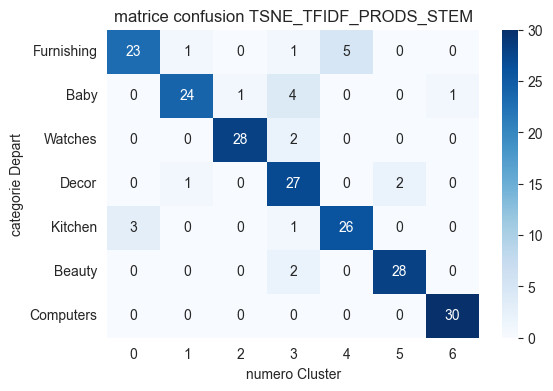

In [428]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

**Avec réduction ACP**

In [429]:
type_donnee = 'TSNE_ACP_TFIDF_PRODS_STEM'

df_data_prods_stem_tfidf = vectorize_text_data(data_prods_stem, TfidfVectorizer())
df_data_prods_stem_tfidf_acp = acp(df_data_prods_stem_tfidf)
df_data_prods_stem_tfidf_acp_tsne = tsne(df_data_prods_stem_tfidf_acp, 40)

(1050, 2544)
Nombre de features après réduction ACP pour 99.0% de variance : 732


In [430]:
# Dataframe pour clustering
df_data_prods_stem_tfidf_acp_tsne = pd.DataFrame({'VAR1' : df_data_prods_stem_tfidf_acp_tsne['DIM1'],
                                           'VAR2' : df_data_prods_stem_tfidf_acp_tsne['DIM2'],
                                           'CATEGORIE' : data_work['category']})

**Entrainement du modèle**

In [431]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_data_prods_stem_tfidf_acp_tsne[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [432]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.9321
Precision:
  - Macro: 0.9318
  - Micro: 0.9321
Recall:
  - Macro: 0.9321
  - Micro: 0.9321
F1-measure:
  - Macro: 0.9317
  - Micro: 0.9321


{'knn': {'micro_precision': 0.9321428571428572,
  'micro_recall': 0.9321428571428572,
  'micro_f1': 0.9321428571428572},
 'svm': {'micro_precision': 0.44642857142857145,
  'micro_recall': 0.44642857142857145,
  'micro_f1': 0.44642857142857145},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7214285714285714,
  'micro_recall': 0.7214285714285714,
  'micro_f1': 0.7214285714285713},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [433]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.2857
Precision:
  - Macro: 0.2017
  - Micro: 0.2857
Recall:
  - Macro: 0.2857
  - Micro: 0.2857
F1-measure:
  - Macro: 0.1582
  - Micro: 0.2857


{'knn': {'micro_precision': 0.9321428571428572,
  'micro_recall': 0.9321428571428572,
  'micro_f1': 0.9321428571428572},
 'svm': {'micro_precision': 0.2857142857142857,
  'micro_recall': 0.2857142857142857,
  'micro_f1': 0.2857142857142857},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7214285714285714,
  'micro_recall': 0.7214285714285714,
  'micro_f1': 0.7214285714285713},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [434]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9321428571428572,
  'micro_recall': 0.9321428571428572,
  'micro_f1': 0.9321428571428572},
 'svm': {'micro_precision': 0.2857142857142857,
  'micro_recall': 0.2857142857142857,
  'micro_f1': 0.2857142857142857},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7214285714285714,
  'micro_recall': 0.7214285714285714,
  'micro_f1': 0.7214285714285713},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [435]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.7393
Precision:
  - Macro: 0.7604
  - Micro: 0.7393
Recall:
  - Macro: 0.7393
  - Micro: 0.7393
F1-measure:
  - Macro: 0.7384
  - Micro: 0.7393


{'knn': {'micro_precision': 0.9321428571428572,
  'micro_recall': 0.9321428571428572,
  'micro_f1': 0.9321428571428572},
 'svm': {'micro_precision': 0.2857142857142857,
  'micro_recall': 0.2857142857142857,
  'micro_f1': 0.2857142857142857},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7392857142857143,
  'micro_recall': 0.7392857142857143,
  'micro_f1': 0.7392857142857143},
 'Gradient Boosting': {'micro_precision': 0.9928571428571429,
  'micro_recall': 0.9928571428571429,
  'micro_f1': 0.9928571428571429},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [436]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9988
Precision:
  - Macro: 0.9988
  - Micro: 0.9988
Recall:
  - Macro: 0.9988
  - Micro: 0.9988
F1-measure:
  - Macro: 0.9988
  - Micro: 0.9988


{'knn': {'micro_precision': 0.9321428571428572,
  'micro_recall': 0.9321428571428572,
  'micro_f1': 0.9321428571428572},
 'svm': {'micro_precision': 0.2857142857142857,
  'micro_recall': 0.2857142857142857,
  'micro_f1': 0.2857142857142857},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7392857142857143,
  'micro_recall': 0.7392857142857143,
  'micro_f1': 0.7392857142857143},
 'Gradient Boosting': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [437]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9321428571428572,
  'micro_recall': 0.9321428571428572,
  'micro_f1': 0.9321428571428572},
 'svm': {'micro_precision': 0.2857142857142857,
  'micro_recall': 0.2857142857142857,
  'micro_f1': 0.2857142857142857},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.7392857142857143,
  'micro_recall': 0.7392857142857143,
  'micro_f1': 0.7392857142857143},
 'Gradient Boosting': {'micro_precision': 0.9988095238095238,
  'micro_recall': 0.9988095238095238,
  'micro_f1': 0.9988095238095238},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [438]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.932143,0.932143,0.932143
svm,0.285714,0.285714,0.285714
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.739286,0.739286,0.739286
Gradient Boosting,0.998810,0.998810,0.998810
extra tree classifier,1.000000,1.000000,1.000000


In [439]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.881


In [440]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)

labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_roberta_var_prod_stem_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_roberta_var_prod_stem_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_roberta_var_prod_stem_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[23  2  0  1  4  0  0]
 [ 0 24  2  4  0  0  0]
 [ 0  0 28  2  0  0  0]
 [ 3  1  0 25  0  1  0]
 [ 3  0  0  1 26  0  0]
 [ 0  0  0  1  0 29  0]
 [ 0  0  0  0  0  0 30]]

ACCURACY TSNE_ACP_TFIDF_PRODS_STEM (Test): 0.881
ACCURACY TSNE_ACP_TFIDF_PRODS_STEM (Train): 1.0


              precision    recall  f1-score   support

           0       0.79      0.77      0.78        30
           1       0.89      0.80      0.84        30
           2       0.93      0.93      0.93        30
           3       0.74      0.83      0.78        30
           4       0.87      0.87      0.87        30
           5       0.97      0.97      0.97        30
           6       1.00      1.00      1.00        30

    accuracy                           0.88       210
   macro avg       0.88      0.88      0.88       210
weighted avg       0.88      0.88      0.88       210



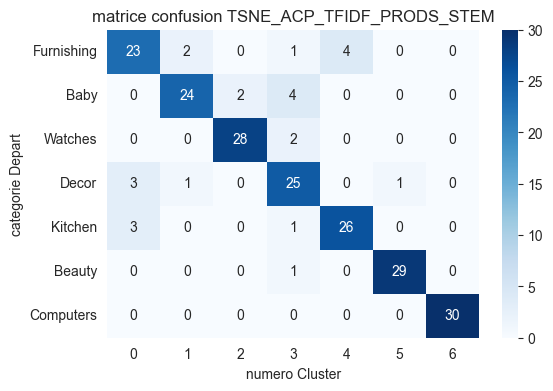

In [441]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

#### <span style='background:wheat'>6.1.4 USE</span>

Le modèle 'universal sentence encoder model' encode les données textuelles dans des vecteurs de haute dimension appelés embeddings qui sont des représentations numériques des données textuelles. Il vise spécifiquement l'apprentissage par transfert à d'autres tâches de NLP, telles que la similarité sémantique, le regroupement, et autres.

In [47]:
# Suppression des waring, info
tf.get_logger().setLevel('ERROR')

#### <span style='background:gold'> 6.1.4.1.  universal-sentence-encoder/3</span>

In [54]:
use_module_url = 'https://tfhub.dev/google/universal-sentence-encoder/3'

<span style='background:orange'>**6.1.4.1.1. produit_specifications** - original </span>

In [158]:
# Variable dont on veut extraire les features
data_work['product_specifications'] = \
    data_work['product_specifications'].fillna('').astype(str)
data_prods_orig = data_work['product_specifications']

In [159]:
type_donnee = 'TSNE_USE_PRODS_ORIG'

# Chargement du modèle
use_model_prods_orig = hub.load(use_module_url)
print('Module %s Chargé' % use_module_url)

vector_use_prods_orig = use_model_prods_orig(data_prods_orig)

Module https://tfhub.dev/google/universal-sentence-encoder/3 Chargé


In [156]:
# Réduction de dimension tsne

# Extraction des vecteurs du dictionnaire et conversion en type array Numpy
vectors_use = np.array(list(vector_use_prods_orig.values()))[0]

tsne_use_prods_orig = TSNE(verbose=1, perplexity=80, n_iter=5000)
X_proj_tsne_use_prods_orig = \
    tsne_use_prods_orig.fit_transform(vectors_use)
# Dataframe pour clustering
df_tsne_use_prods_orig = \
    pd.DataFrame({'VAR1' : X_proj_tsne_use_prods_orig[:, 0],
                  'VAR2' : X_proj_tsne_use_prods_orig[:, 1],
                  'CATEGORIE' : data_work['category']})

[t-SNE] Computing 241 nearest neighbors...
[t-SNE] Indexed 1050 samples in 0.016s...
[t-SNE] Computed neighbors for 1050 samples in 0.164s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1050
[t-SNE] Computed conditional probabilities for sample 1050 / 1050
[t-SNE] Mean sigma: 0.238776
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.666309
[t-SNE] KL divergence after 2000 iterations: 0.428127


**Entrainement du modèle**

In [162]:
Xtrain, Xtest, ytrain, ytest = train_test_split(df_tsne_use_prods_orig[cols], data_work.label, test_size=0.2, stratify=data_work.label, random_state=1944)

In [165]:
knn_clf_sup = KNeighborsClassifier()
knn_clf_sup.fit(Xtrain, ytrain)
knn_predictions = knn_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("knn", ytrain, knn_predictions, models_performance)

------knn Model Metrics-----
Accuracy: 0.9321
Precision:
  - Macro: 0.9353
  - Micro: 0.9321
Recall:
  - Macro: 0.9321
  - Micro: 0.9321
F1-measure:
  - Macro: 0.9316
  - Micro: 0.9321


{'knn': {'micro_precision': 0.9321428571428572,
  'micro_recall': 0.9321428571428572,
  'micro_f1': 0.9321428571428572}}

In [166]:
svm_clf_sup = OneVsRestClassifier(LinearSVC(), n_jobs=-1)
svm_clf_sup.fit(Xtrain, ytrain)
svm_predictions = svm_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("svm", ytrain, svm_predictions, models_performance)

------svm Model Metrics-----
Accuracy: 0.7607
Precision:
  - Macro: 0.7625
  - Micro: 0.7607
Recall:
  - Macro: 0.7607
  - Micro: 0.7607
F1-measure:
  - Macro: 0.7529
  - Micro: 0.7607


{'knn': {'micro_precision': 0.9321428571428572,
  'micro_recall': 0.9321428571428572,
  'micro_f1': 0.9321428571428572},
 'svm': {'micro_precision': 0.7607142857142857,
  'micro_recall': 0.7607142857142857,
  'micro_f1': 0.7607142857142857}}

In [167]:
rf_clf_sup = RandomForestClassifier(n_jobs=-1)
rf_clf_sup.fit(Xtrain, ytrain)
rf_predictions = rf_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Random Forest", ytrain, rf_predictions, models_performance)

------Random Forest Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9321428571428572,
  'micro_recall': 0.9321428571428572,
  'micro_f1': 0.9321428571428572},
 'svm': {'micro_precision': 0.7607142857142857,
  'micro_recall': 0.7607142857142857,
  'micro_f1': 0.7607142857142857},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

In [168]:
gnb_clf_sup = OneVsRestClassifier(GaussianNB())
gnb_clf_sup.fit(Xtrain, ytrain)
gnb_predictions = gnb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Naive Bayes", ytrain, gnb_predictions, models_performance)    

------Naive Bayes Model Metrics-----
Accuracy: 0.8155
Precision:
  - Macro: 0.8243
  - Micro: 0.8155
Recall:
  - Macro: 0.8155
  - Micro: 0.8155
F1-measure:
  - Macro: 0.8106
  - Micro: 0.8155


{'knn': {'micro_precision': 0.9321428571428572,
  'micro_recall': 0.9321428571428572,
  'micro_f1': 0.9321428571428572},
 'svm': {'micro_precision': 0.7607142857142857,
  'micro_recall': 0.7607142857142857,
  'micro_f1': 0.7607142857142857},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.8154761904761905,
  'micro_recall': 0.8154761904761905,
  'micro_f1': 0.8154761904761905}}

In [169]:
gb_clf_sup = OneVsRestClassifier(GradientBoostingClassifier())
gb_clf_sup.fit(Xtrain, ytrain)
gb_predictions = gb_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("Gradient Boosting", ytrain, gb_predictions, models_performance)

------Gradient Boosting Model Metrics-----
Accuracy: 0.9893
Precision:
  - Macro: 0.9894
  - Micro: 0.9893
Recall:
  - Macro: 0.9893
  - Micro: 0.9893
F1-measure:
  - Macro: 0.9893
  - Micro: 0.9893


{'knn': {'micro_precision': 0.9321428571428572,
  'micro_recall': 0.9321428571428572,
  'micro_f1': 0.9321428571428572},
 'svm': {'micro_precision': 0.7607142857142857,
  'micro_recall': 0.7607142857142857,
  'micro_f1': 0.7607142857142857},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.8154761904761905,
  'micro_recall': 0.8154761904761905,
  'micro_f1': 0.8154761904761905},
 'Gradient Boosting': {'micro_precision': 0.9892857142857143,
  'micro_recall': 0.9892857142857143,
  'micro_f1': 0.9892857142857143}}

In [170]:
etc_clf_sup = ExtraTreesClassifier(random_state=0)
etc_clf_sup.fit(Xtrain, ytrain)
etc_predictions = etc_clf_sup.predict(Xtrain)
fonctions_data.metrics_report("extra tree classifier", ytrain, etc_predictions, models_performance)

------extra tree classifier Model Metrics-----
Accuracy: 1.0000
Precision:
  - Macro: 1.0000
  - Micro: 1.0000
Recall:
  - Macro: 1.0000
  - Micro: 1.0000
F1-measure:
  - Macro: 1.0000
  - Micro: 1.0000


{'knn': {'micro_precision': 0.9321428571428572,
  'micro_recall': 0.9321428571428572,
  'micro_f1': 0.9321428571428572},
 'svm': {'micro_precision': 0.7607142857142857,
  'micro_recall': 0.7607142857142857,
  'micro_f1': 0.7607142857142857},
 'Random Forest': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0},
 'Naive Bayes': {'micro_precision': 0.8154761904761905,
  'micro_recall': 0.8154761904761905,
  'micro_f1': 0.8154761904761905},
 'Gradient Boosting': {'micro_precision': 0.9892857142857143,
  'micro_recall': 0.9892857142857143,
  'micro_f1': 0.9892857142857143},
 'extra tree classifier': {'micro_precision': 1.0,
  'micro_recall': 1.0,
  'micro_f1': 1.0}}

**Synthèse des résultats**

In [171]:
result_df = pd.DataFrame.from_dict(models_performance, orient="index")
result_df

,micro_precision,micro_recall,micro_f1
knn,0.932143,0.932143,0.932143
svm,0.760714,0.760714,0.760714
Random Forest,1.000000,1.000000,1.000000
Naive Bayes,0.815476,0.815476,0.815476
Gradient Boosting,0.989286,0.989286,0.989286
extra tree classifier,1.000000,1.000000,1.000000


In [172]:
etc_model = ExtraTreesClassifier(random_state=0).fit(Xtrain, ytrain) 
etc_predictions = etc_model.predict(Xtest) 

# model accuracy for X_test   
accuracy_etc = etc_model.score(Xtest, ytest) 
print("Accuracy de l'algorithme etc :", round(accuracy_etc, 3))

Accuracy de l'algorithme etc : 0.914


In [176]:
conf_mat = confusion_matrix(lab_encod.inverse_transform(ytest), lab_encod.inverse_transform(etc_model.predict(Xtest)))
print(conf_mat)
#test_labels = le.inverse_transform(y_test)
labels_transform_train = fonctions_data.conf_mat_transform(ytrain, etc_model.predict(Xtrain))
labels_transform_test = fonctions_data.conf_mat_transform(ytest, etc_model.predict(Xtest))

accuracy_tsne_use_prods_orig_test = accuracy_score(ytest, labels_transform_test)
accuracy_tsne_use_prods_orig_train = accuracy_score(ytrain, labels_transform_train)

print()
print("ACCURACY {} (Test): {:.3}".format(type_donnee, accuracy_tsne_use_prods_orig_test))
print("ACCURACY {} (Train): {:.3}".format(type_donnee, accuracy_tsne_use_prods_orig_train))
print()

print()
print(classification_report(ytest, labels_transform_test))

[[24  1  0  1  4  0  0]
 [ 0 26  2  2  0  0  0]
 [ 0  0 29  1  0  0  0]
 [ 0  0  0 29  0  1  0]
 [ 4  0  0  1 24  1  0]
 [ 0  0  0  0  0 30  0]
 [ 0  0  0  0  0  0 30]]

ACCURACY TSNE_USE_PRODS_ORIG (Test): 0.914
ACCURACY TSNE_USE_PRODS_ORIG (Train): 1.0


              precision    recall  f1-score   support

           0       0.86      0.80      0.83        30
           1       0.96      0.87      0.91        30
           2       0.94      0.97      0.95        30
           3       0.85      0.97      0.91        30
           4       0.86      0.80      0.83        30
           5       0.94      1.00      0.97        30
           6       1.00      1.00      1.00        30

    accuracy                           0.91       210
   macro avg       0.91      0.91      0.91       210
weighted avg       0.91      0.91      0.91       210



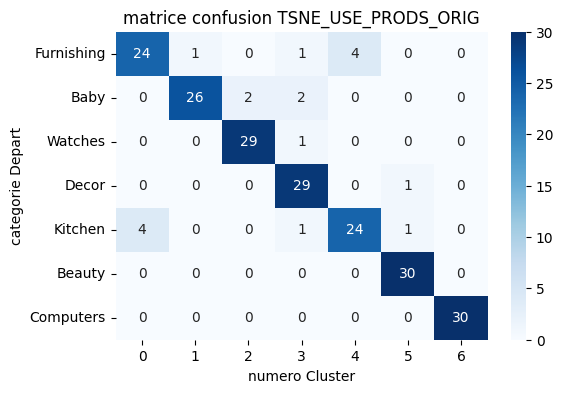

In [179]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")
plt.xlabel('numero Cluster')
plt.ylabel('categorie Depart')
plt.title(f'matrice confusion {type_donnee}')
plt.show()

### <span style='background:orange'>6.2. Convolutional Neural Networks (CNN) transfer learning</span>

#### <span style='background:wheat'>6.2.1 VGG19</span>

**Mise en place du modèle**

In [526]:
# import packages
import keras
from keras import optimizers
from keras.models import Sequential
from tensorflow.keras.callbacks import EarlyStopping
from keras.layers import Conv2D, MaxPooling2D
from tensorflow.keras.models import Model, Sequential
from keras.layers import GlobalAveragePooling2D, GlobalAveragePooling1D, Dense, Flatten, Dropout
#from tensorflow.keras.layers import GlobalAveragePooling2D, GlobalAveragePooling1D, Flatten, Dense, Dropout

from keras.applications.vgg16 import VGG16, preprocess_input, decode_predictions
from keras.preprocessing.image import ImageDataGenerator
from keras.utils import load_img, img_to_array

**Préparation des données**

**1 - Création du Data Generator**

In [499]:
# Créer un générateur d'images
datagen = ImageDataGenerator(rotation_range=20, 
                             width_shift_range=0.2, 
                             height_shift_range=0.2, 
                             shear_range=0.2, 
                             zoom_range=0.2, 
                             horizontal_flip=True)

**2. Séparation du jeu de données**

Nous allons procéder à la séparation de notre jeu de données à travers la méthode du train_test_split.

Toutefois, nous allons séparer notre jeu de données en 3 parties :

jeu d'entrainement : 80% de notre base de données,
jeu de test : 20% de notre base de données
jeu de validation : 25% du jeu de test.

In [513]:
# Sélectionner les caractéristiques et les étiquettes

X = data_imc['image_loc']

y = data_imc['Categorie_1']

# Encoage des categories
lab_encod = LabelEncoder()
data_imc["label"] = lab_encod.fit_transform(data_imc["Categorie_1"])
cat_code = data_imc["label"].to_list()

# Diviser en ensembles d'entraînement et de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Diviser l'ensemble de test en ensembles de test et de validation
X_test, X_val, y_test, y_val = train_test_split(X_test, y_test, test_size=0.25, random_state=42)

**3. Finalisation de la préparation**

Nous allons finaliser notre jeu de données à travers la génération de nouvelles images pour nos différentes séparations du jeu de données.

Pour cela, l'utilisation du Data Generator créé en amont sera nécessaire à cette finalisation

In [515]:
# Générer de nouvelles images pour les ensembles d'entraînement
df_train=pd.DataFrame({"image": X_train, "label": y_train})
train_generator = datagen.flow_from_dataframe(dataframe = df_train,
                                              x_col="image", 
                                              y_col="label", 
                                              target_size=(224,224), 
                                              batch_size=32, 
                                              class_mode="categorical")

# Générer de nouvelles images pour l'ensemble de test
df_test = pd.DataFrame({"image": X_test, "label": y_test})
test_generator = datagen.flow_from_dataframe(dataframe= df_test, 
                                             x_col="image", 
                                             y_col="label", 
                                             target_size=(224,224), 
                                             batch_size=32, 
                                             class_mode="categorical")

# Générer de nouvelles images pour l'ensemble de validation
df_val = pd.DataFrame({"image": X_val, "label": y_val})
val_generator = datagen.flow_from_dataframe(dataframe= df_val, 
                                             x_col="image", 
                                             y_col="label", 
                                             target_size=(224,224), 
                                             batch_size=32, 
                                             class_mode="categorical")

Found 840 validated image filenames belonging to 7 classes.
Found 157 validated image filenames belonging to 7 classes.
Found 53 validated image filenames belonging to 7 classes.


**Modélisation - VGG19**

In [539]:
from tensorflow.keras.layers import Input

top_depart = time.time()

# Charger le modèle pré-entrainé VGG19
inputs = Input(shape=(224, 224, 3))
vgg_model = VGG19(include_top=False, weights=None, input_tensor=inputs, classes = 7)
outputs = vgg_model.output

# Ajouter des couches supplémentaires
x = MaxPooling2D(pool_size=(2, 2))(outputs) # couche de pooling
x = Flatten()(x) # couche de flattening
x = Dense(128, activation='relu')(x) # couche dense avec 128 neurones et une fonction d'activation relu
predictions = Dense(7, activation='softmax')(x) # couche dense de sortie avec 7 neurones et une fonction d'activation softmax

# Construire le modèle complet
model = Model(inputs=inputs, outputs=predictions)

# Compiler le modèle
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Afficher un résumé du modèle
model.summary()

# Entraîner le modèle sur les données d'entraînement
history = model.fit(train_generator,
                    batch_size=32,
                    epochs=10,
                    validation_data=val_generator,
                    validation_batch_size=32,
                    callbacks=[early_stop])


print(f"Temps d'execution : {round((time.time()-top_depart)/60, 3)} minutes")

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_20 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

In [533]:
# Création du Early Stop
early_stop = EarlyStopping(monitor='val_loss',patience=3)

# Définir le nombre d'itérations d'entraînement
epochs = 50
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=5)
callbacks_list = [es]

In [540]:
# Score du dernier epoch

loss, accuracy = model.evaluate(train_generator, verbose=True)
print("Training Accuracy   : {:.4f}".format(accuracy))
print()
loss, accuracy = model.evaluate(val_generator, verbose=True)
print("Validation Accuracy :  {:.4f}".format(accuracy))

27/27 [==============================] - 185s 7s/step - loss: 1.9452 - accuracy: 0.1536
Training Accuracy   : 0.1536

2/2 [==============================] - 14s 5s/step - loss: 1.9507 - accuracy: 0.0943
Validation Accuracy :  0.0943


In [541]:
# Score de l'epoch optimal

#model.load_weights(model_save_path)

loss, accuracy = model.evaluate(val_generator, verbose=False)
print("Validation Accuracy :  {:.4f}".format(accuracy))

loss, accuracy = model.evaluate(test_generator, verbose=False)
print("Test Accuracy       :  {:.4f}".format(accuracy))


Validation Accuracy :  0.0943
Test Accuracy       :  0.1019


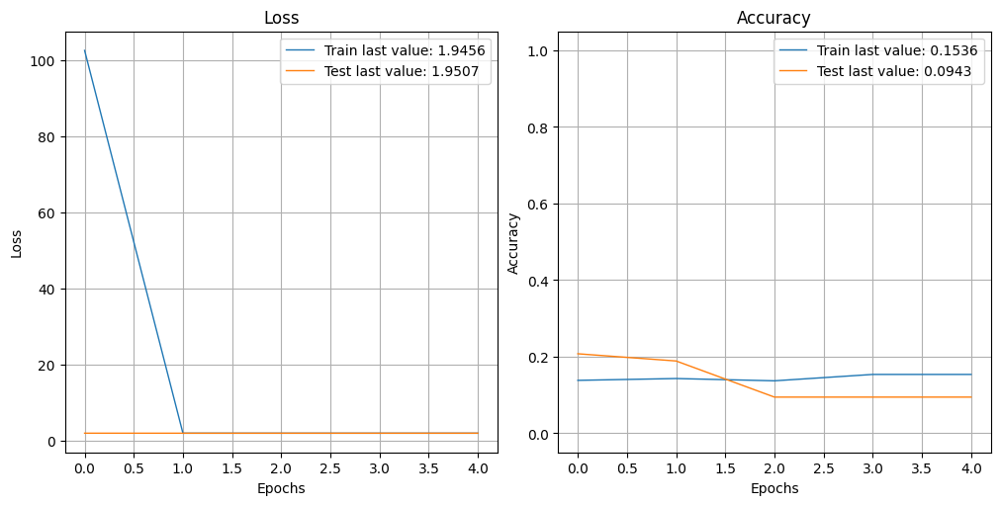

In [544]:
from plot_keras_history import show_history, plot_history
import matplotlib.pyplot as plt

show_history(history)
plot_history(history, path="standard.png")
plt.close()

**Test**
   
Le jeu de test sera utilisé pour cette dernière phase.

Afin d'analyser les résultats obtenus, nous allons utiliser une matrice de confusion et un rapport de classification.

5/5 [==============================] - 31s 6s/step


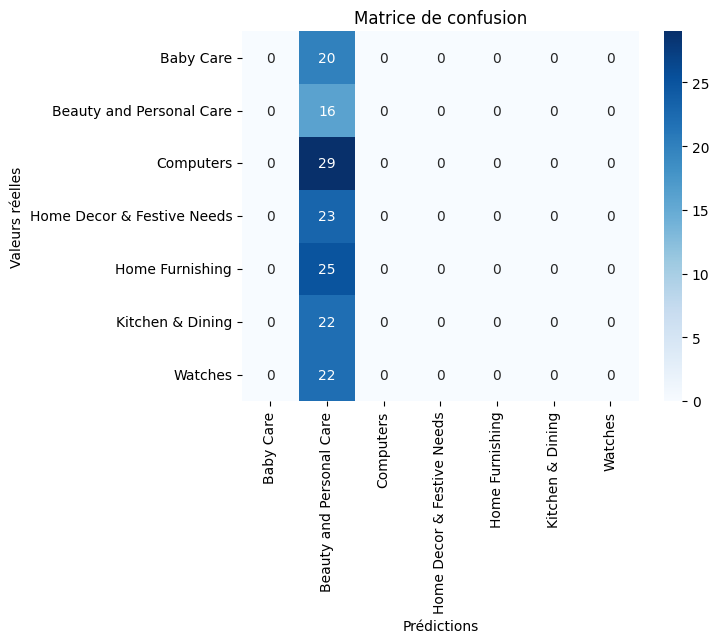

                            precision    recall  f1-score   support

                 Baby Care       0.00      0.00      0.00        20
  Beauty and Personal Care       0.10      1.00      0.18        16
                 Computers       0.00      0.00      0.00        29
Home Decor & Festive Needs       0.00      0.00      0.00        23
           Home Furnishing       0.00      0.00      0.00        25
          Kitchen & Dining       0.00      0.00      0.00        22
                   Watches       0.00      0.00      0.00        22

                  accuracy                           0.10       157
                 macro avg       0.01      0.14      0.03       157
              weighted avg       0.01      0.10      0.02       157



In [542]:
# Appel de notre fonction    
fonctions_data.evaluate_model(model, test_generator)

Ce rapport de classification montre les performances du modèle pour chaque classe et pour l'ensemble des classes. Il montre également l'accuracy globale (précision globale) du modèle pour toutes les classes combinées.

Pour chaque classe, le rapport de classification affiche les mesures de précision, de rappel et de f1-score. La précision mesure la proportion d'images correctement classées dans cette classe parmi toutes les images classées dans cette classe. Le rappel mesure la proportion d'images correctement classées dans cette classe parmi toutes les images réelles de cette classe. Le f1-score est une moyenne harmonique de précision et de rappel.

Le rapport de classification montre que le modèle a des performances très faibles pour toutes les classes, avec des précisions allant de 0 à 0,20, des rappels allant de 0 à 0,23 et des f1-scores allant de 0 à 0,21. Cela suggère que le modèle ne fonctionne pas bien pour la tâche de classification des données de test.

L'accuracy globale est 0e 0,11, ce qui signifie que le modèle n'est correct que 0ans 11% des cas. En conclusion, ce modèle nécessite une amélioration significative pour être utilisé avec succès dans la classification de données.

Voici quelques pistes de réflexion nous permettant d'améliorer notre modèle et par conséquent le test de ce dernier :

Augmenter la quantité de données. Nous avons travaillé avec un jeu de données initial de 1050. Les modèles de Deep Learning sont très attractifs avec plusieurs dizaines voir centaines de milliers de données,

Améliorer la catégorisation des produits. En effet, certains produits ont une catégorie assez similaire et un travail en amont pourrait permettre une meilleure classification,

Utiliser d'autres réseaux de neurones tels que le modèle 'InceptionV3' pour obtenir des résultats plus attractifs.

#### <span style='background:wheat'>6.2.2 InceptionV3</span>

**Modélisation - InceptionV3**

In [551]:
top_depart = time.time()

# Charger le modèle pré-entrainé InceptionV3
incepV3_model = InceptionV3(weights='imagenet', include_top=False, pooling='avg', classes=7)

# Ajouter des couches supplémentaires
x = incepV3_model.output
x = Dense(128, activation='relu')(x) # couche dense avec 128 neurones et une fonction d'activation relu
predictions = Dense(7, activation='softmax')(x) # couche dense de sortie avec 7 neurones et une fonction d'activation softmax

# Construire le modèle complet
model = Model(inputs=incepV3_model.input, outputs=predictions)

# Compiler le modèle
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Afficher un résumé du modèle
model.summary()

# Entraîner le modèle sur les données d'entraînement
top_depart = time.time()
history = model.fit(train_generator,
                    batch_size=32,
                    epochs=10,
                    validation_data=val_generator,
                    validation_batch_size=32,
                    callbacks=[EarlyStopping(patience=3)])

print(f"Temps d'execution : {round((time.time()-top_depart)/60, 3)} minutes")

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_29 (InputLayer)       [(None, None, None, 3)]      0         []                            
                                                                                                  
 conv2d_564 (Conv2D)         (None, None, None, 32)       864       ['input_29[0][0]']            
                                                                                                  
 batch_normalization_564 (B  (None, None, None, 32)       96        ['conv2d_564[0][0]']          
 atchNormalization)                                                                               
                                                                                                  
 activation_564 (Activation  (None, None, None, 32)       0         ['batch_normalization_56

Le modèle **InceptionV3** présente les meilleurs résultats avec un accuracy de 0.80 ce qui représente un très bon score. Ce modèle sera conservé pour notre phase d'analyse et de test.

A présent, nous allons procéder à l'analyse de notre meilleur modè50.

Pour cela, le jeu de validation (val_generator) sera utilisé pour l'évaluation.

Enfin, nous pourrons procéder à la phase de test de notre modèle grâce à notre jeu de test.

In [552]:
# Score du dernier epoch

loss, accuracy = model.evaluate(train_generator, verbose=True)
print("Training Accuracy   : {:.4f}".format(accuracy))
print()
loss, accuracy = model.evaluate(val_generator, verbose=True)
print("Validation Accuracy :  {:.4f}".format(accuracy))

27/27 [==============================] - 42s 2s/step - loss: 2.5294 - accuracy: 0.3893
Training Accuracy   : 0.3893

2/2 [==============================] - 3s 1s/step - loss: 2.8713 - accuracy: 0.3585
Validation Accuracy :  0.3585


In [553]:
# Score de l'epoch optimal

#model.load_weights(model_save_path)

loss, accuracy = model.evaluate(val_generator, verbose=False)
print("Validation Accuracy :  {:.4f}".format(accuracy))

loss, accuracy = model.evaluate(test_generator, verbose=False)
print("Test Accuracy       :  {:.4f}".format(accuracy))


Validation Accuracy :  0.3774
Test Accuracy       :  0.2866


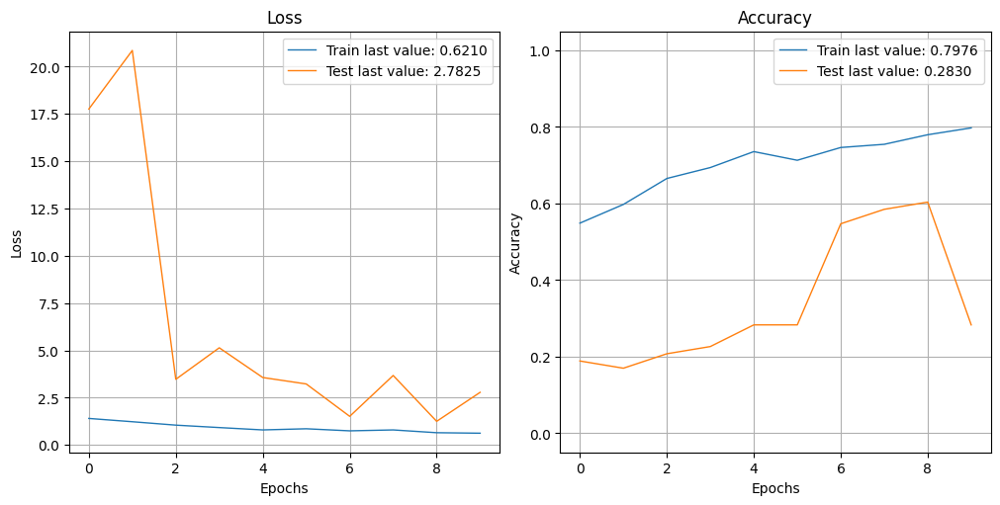

In [554]:
from plot_keras_history import show_history, plot_history
import matplotlib.pyplot as plt

show_history(history)
plot_history(history, path="standard.png")
plt.close()

**Affichage de la matrice de confusion, et du rapport de classification**

5/5 [==============================] - 11s 2s/step


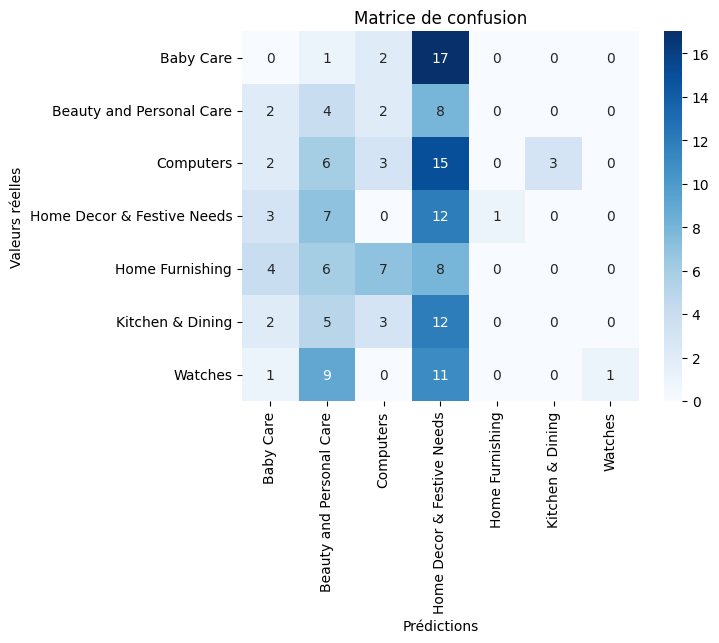

                            precision    recall  f1-score   support

                 Baby Care       0.00      0.00      0.00        20
  Beauty and Personal Care       0.11      0.25      0.15        16
                 Computers       0.18      0.10      0.13        29
Home Decor & Festive Needs       0.14      0.52      0.23        23
           Home Furnishing       0.00      0.00      0.00        25
          Kitchen & Dining       0.00      0.00      0.00        22
                   Watches       1.00      0.05      0.09        22

                  accuracy                           0.13       157
                 macro avg       0.20      0.13      0.08       157
              weighted avg       0.20      0.13      0.08       157



In [555]:
# Appel de notre fonction    
fonctions_data.evaluate_model(model, test_generator)